In [417]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

99


In [418]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [419]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [437]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [438]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [439]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [440]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1748484,North America,North America,NaN,5976.0,292.0,"+3,692",NaN,19187.0,NaN,3494700,175651.0,1570565.0,NaN,NaN
1,NaN,\n,NaN,NaN,865742,South America,South America,NaN,1226.0,56.0,395,NaN,13499.0,NaN,2515360,93741.0,1555877.0,NaN,NaN
2,NaN,\n,NaN,NaN,785044,Asia,Asia,NaN,14335.0,227.0,"+7,884",NaN,19462.0,NaN,2593787,62390.0,1746353.0,NaN,NaN
3,NaN,\n,NaN,NaN,855993,Europe,Europe,NaN,7821.0,173.0,"+4,910",NaN,5563.0,NaN,2485393,193870.0,1435530.0,NaN,NaN
4,NaN,\n,NaN,NaN,238644,Africa,Africa,NaN,330.0,2.0,113,NaN,945.0,NaN,480175,11402.0,230129.0,NaN,NaN


In [441]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,855993,Europe,Total:,NaN,7821.0,173.0,"+4,910",NaN,5563.0,NaN,2485393,193870.0,1435530.0,NaN,NaN
226,NaN,,NaN,NaN,238644,Africa,Total:,NaN,330.0,2.0,113,NaN,945.0,NaN,480175,11402.0,230129.0,NaN,NaN
227,NaN,,NaN,NaN,1088,Australia/Oceania,Total:,NaN,139.0,2.0,21,NaN,7.0,NaN,10233,128.0,9017.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,161088,Europe,European Union,300.439855,594.0,22.0,NaN,NaN,2236.0,66988.025981,1304731,133771.0,630139.0,29826453.0,2930.330138


In [442]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1748484,North America,North America,NaN,5976.0,292.0,"+3,692",NaN,19187.0,NaN,3494700,175651.0,1570565.0,NaN,NaN
1,NaN,\n,NaN,NaN,865742,South America,South America,NaN,1226.0,56.0,395,NaN,13499.0,NaN,2515360,93741.0,1555877.0,NaN,NaN
2,NaN,\n,NaN,NaN,785044,Asia,Asia,NaN,14335.0,227.0,"+7,884",NaN,19462.0,NaN,2593787,62390.0,1746353.0,NaN,NaN
3,NaN,\n,NaN,NaN,855993,Europe,Europe,NaN,7821.0,173.0,"+4,910",NaN,5563.0,NaN,2485393,193870.0,1435530.0,NaN,NaN
4,NaN,\n,NaN,NaN,238644,Africa,Africa,NaN,330.0,2.0,113,NaN,945.0,NaN,480175,11402.0,230129.0,NaN,NaN


In [443]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
119,113.0,"1,478","34,448",6,215,Europe,Lithuania,29.0,5.0,0.0,2,"2,721,417",15.0,162927.0,1841,79.0,1547.0,443391.0,676.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


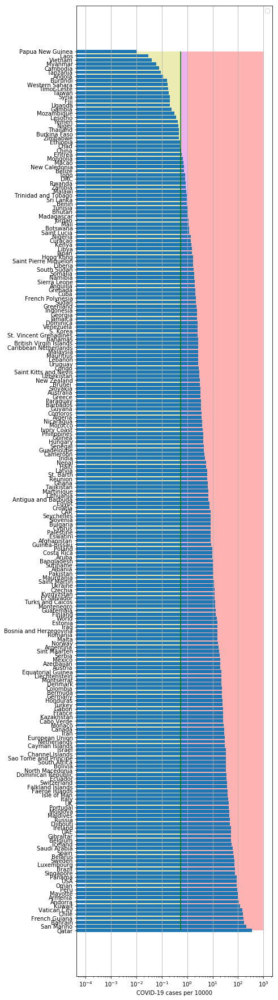

In [444]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


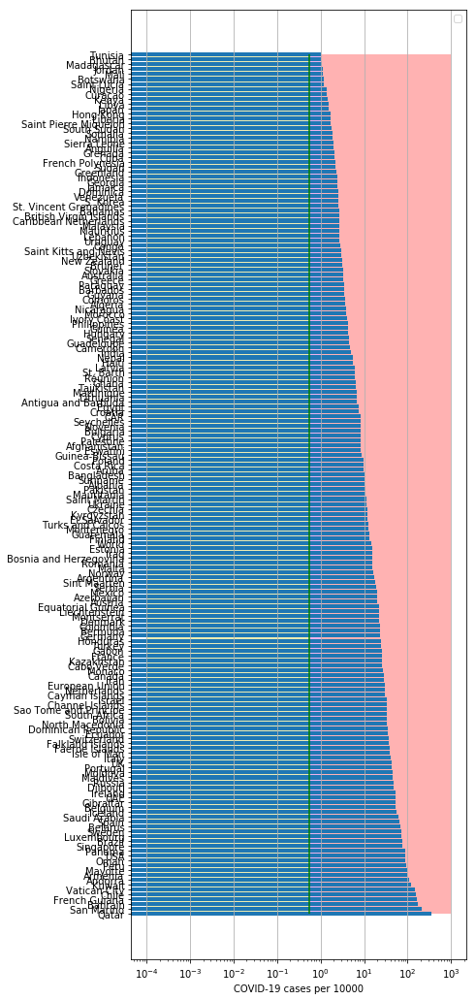

In [445]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

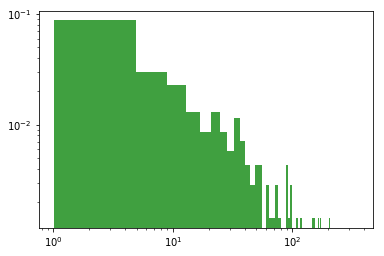

In [446]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [447]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
127 2020-07-01  296739       0  28363.0
128 2020-07-02  297183       0  28368.0
129 2020-07-03  297625       0  28385.0
130 2020-07-04  297625       0  28385.0
131 2020-07-05  297625       0  28385.0
GB
           date   cases  active    death
126 2020-07-01  283006       0  43906.0
127 2020-07-02  283757       0  43995.0
128 2020-07-03  284276       0  44131.0
129 2020-07-04  284900       0  44198.0
130 2020-07-05  285416       0  44220.0
IT
           date   cases  active    death
129 2020-07-01  240760   15255  34788.0
130 2020-07-02  240961   15060  34818.0
131 2020-07-03  241184   14884  34833.0
132 2020-07-04  241419   14621  34854.0
133 2020-07-05  241611   14642  34861.0
LT
           date   cases  active  death     tests
114 2020-07-01  1825.0     211   78.0  432457.0
115 2020-07-02  1828.0     199   78.0  436679.0
116 2020-07-03  1831.0     196   79.0  439451.0
117 2020-07-04  1836.0     201   79.0  442242.0
118 2020-07-05  1841.0  

MX
           date   cases   active    death
115 2020-07-01  231770  64941.0  28510.0
116 2020-07-02  238511  66729.0  29189.0
117 2020-07-03  245251  68203.0  29843.0
118 2020-07-04  252165  69490.0  30366.0
119 2020-07-05  256848  70605.0  30639.0
PM
           date  cases   active  death
113 2020-07-01  34463  17873.0  645.0
114 2020-07-02  35237  18125.0  667.0
115 2020-07-03  35995  18352.0  698.0
116 2020-07-04  36983  18502.0  720.0
117 2020-07-05  38149  19416.0  747.0
PU
           date   cases    active    death
116 2020-07-01  288477  100372.0   9860.0
117 2020-07-02  292004   99862.0  10045.0
118 2020-07-03  295599   99521.0  10226.0
119 2020-07-04  299080   99047.0  10412.0
120 2020-07-05  302718   98172.0  10589.0
SB
           date  cases  active  death
113 2020-07-01  14836  1783.0  281.0
114 2020-07-02  15195  1996.0  287.0
115 2020-07-03  15504  2142.0  298.0
116 2020-07-04  15829  2459.0  306.0
117 2020-07-05  16131  2756.0  311.0
AG
           date    cases   active

In [448]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [449]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5614227668713212
intercept: -0.5106651836333684
slope: [0.04926122]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


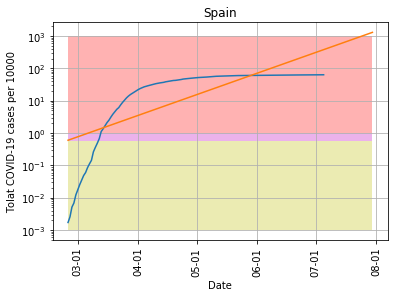

In [450]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-07-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [451]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6996255144612358
intercept: -2.1895370969393246
slope: [0.06079596]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


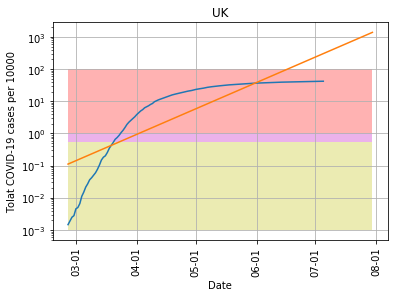

In [452]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-07-30', "pictures/coronaGB.png", model1, 'UK',100)

In [453]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9515756581403312
intercept: 1.432139958484743
slope: [-0.03818184]


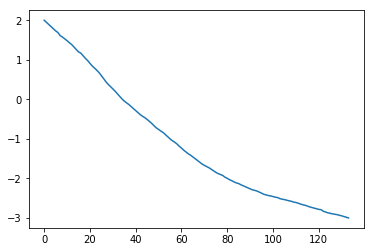

In [454]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


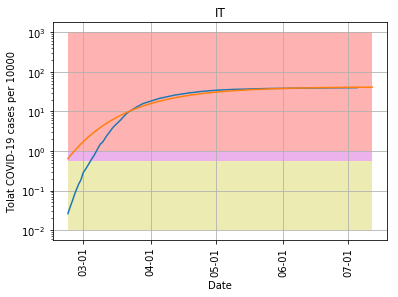

In [455]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [456]:
cs=y_pred11[-1]/10000.*populationIT

In [457]:
cs

248968.9238751522

In [458]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.493479453392114
intercept: -0.8346315855303366
slope: [0.032104]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


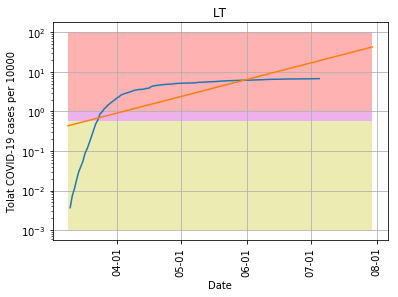

In [459]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-07-30', "pictures/coronaLT.png", model1, 'LT',100)

In [460]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7466096919413472
intercept: -3.9371744220585816
slope: [0.06742025]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


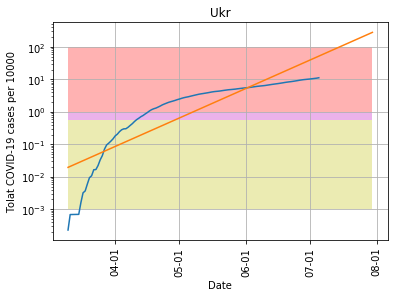

In [461]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-07-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


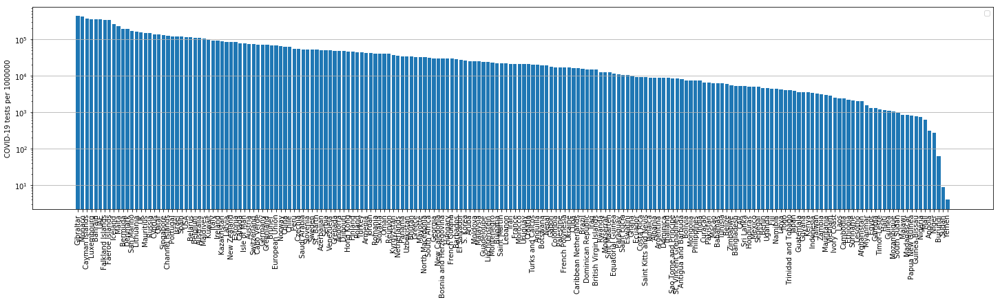

In [462]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [463]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6811516885388079
intercept: -1.5639904085130127
slope: [0.06174004]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


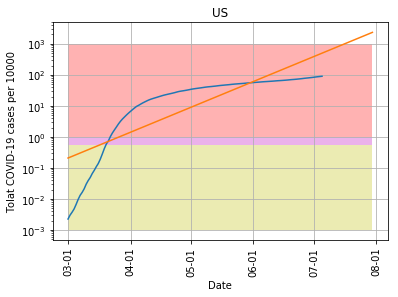

In [464]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-07-30', "pictures/coronaUS.png", model11, 'US',1000)

In [465]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.102528


(0, 0.15)

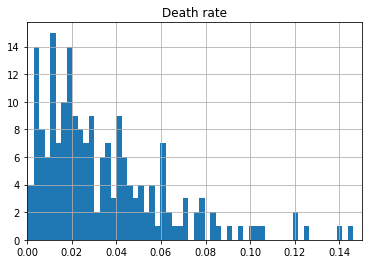

In [466]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

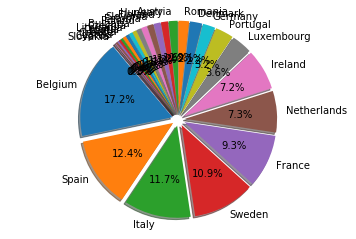

In [467]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [468]:
dfTTh.head()

,Country,Deathsper1Mpop
33,Belgium,843.0
12,Spain,607.0
16,Italy,577.0
30,Sweden,537.0
23,France,458.0


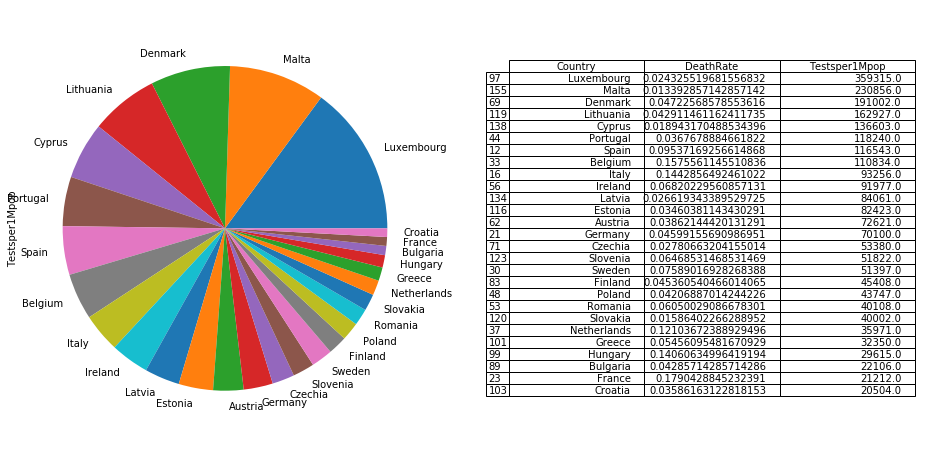

In [469]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

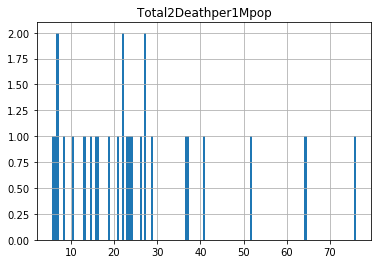

In [470]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [471]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
12,Spain,6366.0,607.0
16,Italy,3996.0,577.0
21,Germany,2358.0,108.0
23,France,2558.0,458.0
30,Sweden,7071.0,537.0


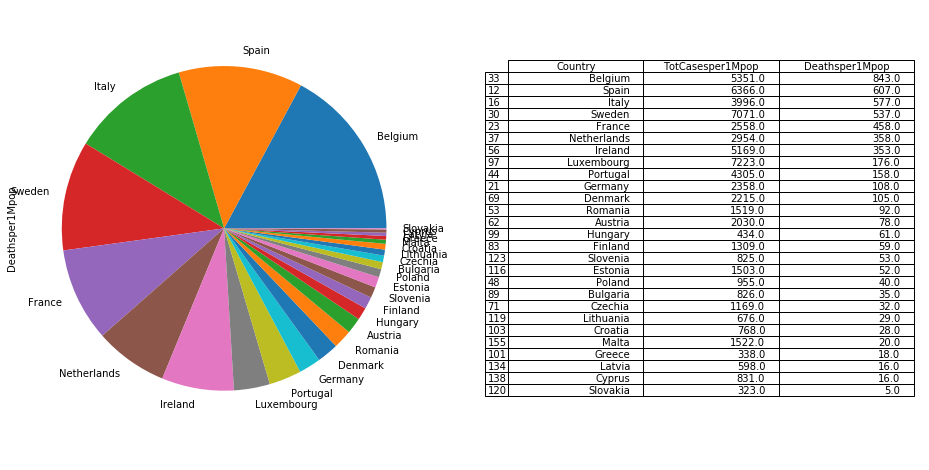

In [472]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [473]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,1748484,North America,North America,0.0,5976.0,292.0,"+3,692",0,19187.0,0.0,3494700,175651.0,1570565.0,0.0,0.0
1,0.0,\n,0,0,865742,South America,South America,0.0,1226.0,56.0,395,0,13499.0,0.0,2515360,93741.0,1555877.0,0.0,0.0
2,0.0,\n,0,0,785044,Asia,Asia,0.0,14335.0,227.0,"+7,884",0,19462.0,0.0,2593787,62390.0,1746353.0,0.0,0.0
3,0.0,\n,0,0,855993,Europe,Europe,0.0,7821.0,173.0,"+4,910",0,5563.0,0.0,2485393,193870.0,1435530.0,0.0,0.0
4,0.0,\n,0,0,238644,Africa,Africa,0.0,330.0,2.0,113,0,945.0,0.0,480175,11402.0,230129.0,0.0,0.0


In [474]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
12,Spain,0.054624
16,Italy,0.042850
21,Germany,0.033638
23,France,0.120592
30,Sweden,0.137576


In [475]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.137576
      France             0.120592
 Netherlands             0.082122
     Ireland             0.056199
       Spain             0.054624
     Belgium             0.048279
       Italy             0.042850
     Romania             0.037873
     Croatia             0.037456
    Bulgaria             0.037365
    Portugal             0.036409
     Germany             0.033638
     Finland             0.028828
     Austria             0.027953
     Czechia             0.021900
      Poland             0.021830
  Luxembourg             0.020102
     Estonia             0.018235
    Slovenia             0.015920
     Hungary             0.014655
     Denmark             0.011597
      Greece             0.010448
    Slovakia             0.008075
      Latvia             0.007114
       Malta             0.006593
      Cyprus             0.006083
   Lithuania             0.004149


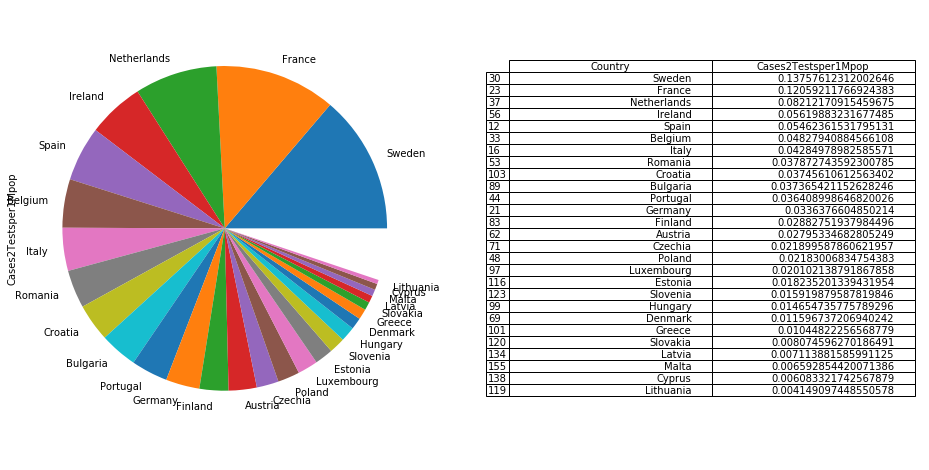

In [476]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [477]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
43,Singapore,0.000578,129509.000000
27,Qatar,0.001283,135848.000000
66,Nepal,0.002154,18801.000000
135,Rwanda,0.002715,12394.000000
94,French Guiana,0.003257,29149.000000
52,Bahrain,0.003303,353901.000000
73,Uzbekistan,0.003451,33496.000000
169,Botswana,0.003610,19320.000000
158,Réunion,0.003656,39557.000000
40,Kazakhstan,0.003870,86280.000000


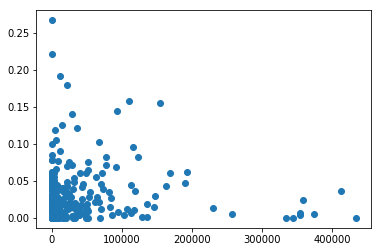

In [478]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


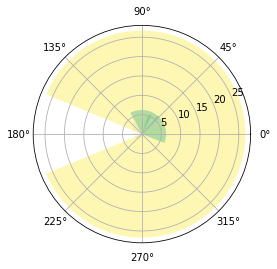

In [479]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

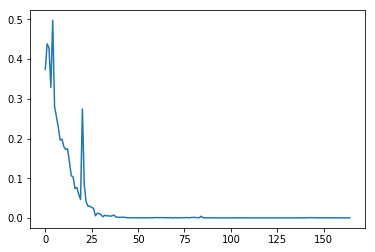

In [480]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [481]:
#np.diff(np.log(dfCN["cases"].values))

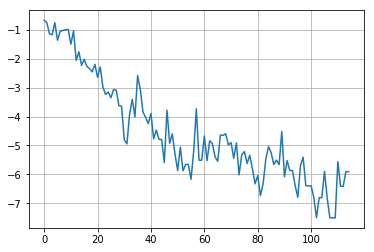

In [482]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

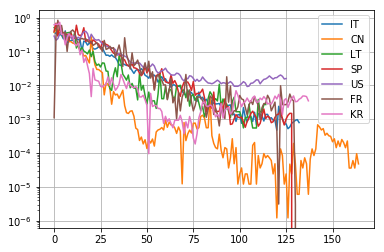

In [483]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

126 126
coefficient of determination: 0.766510806128826
intercept: -10.521304275759288
slope: [-0.08915129]


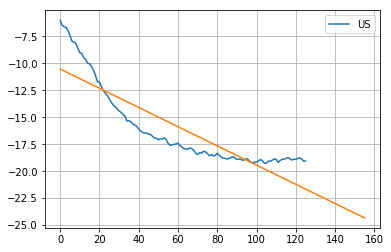

In [484]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [485]:
#np.diff(dfIT["cases"])

133 133
coefficient of determination: 0.8740481608685556
intercept: -10.5835383439291
slope: [-0.08217385]


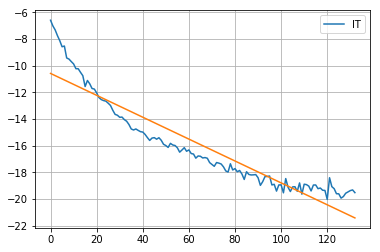

In [486]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [487]:
#model11.coef_

In [488]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

115 115
coefficient of determination: 0.8750605840453022
intercept: -15.579815847158137
slope: [-0.04963635]


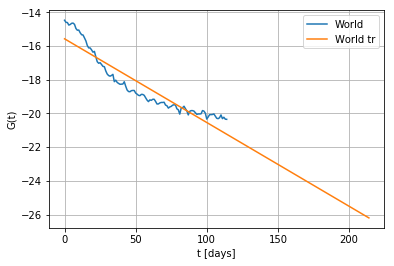

In [489]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

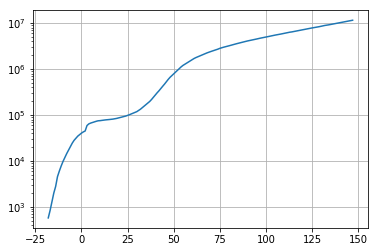

In [490]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [491]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 2.58604267e+07  1.14868124e+00 -1.73015586e+02  1.23572249e-02]


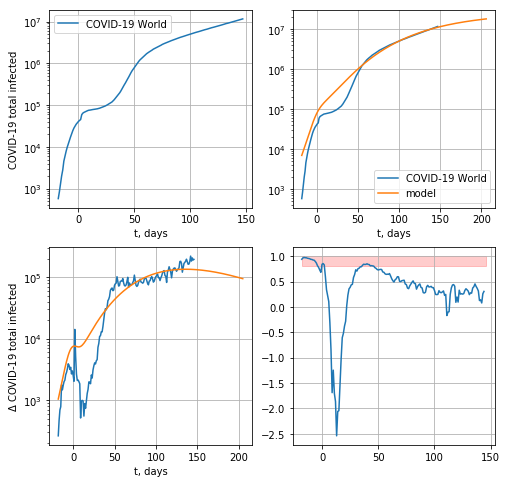

202337.88145172625


In [492]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

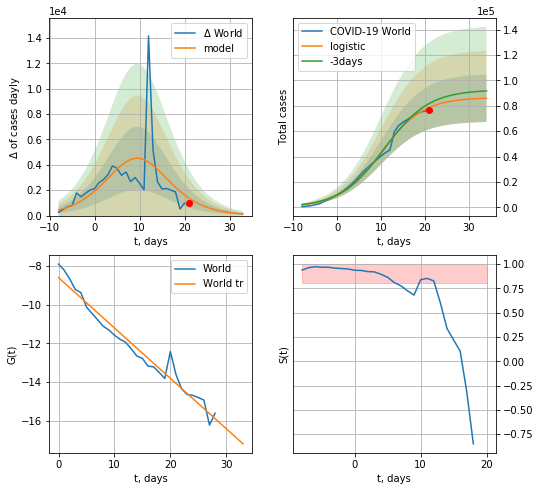

World data at: 2020-07-05
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +13 days
	 deltaDaycases:  129
	 total cases:  85913 ± 18712
	 total death:  3985 ± 2603
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


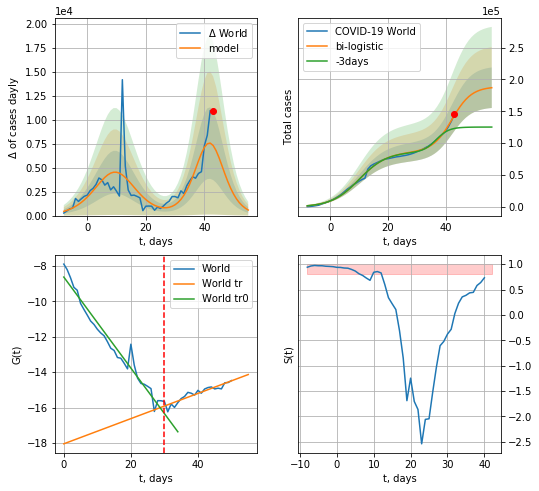

World data at: 2020-07-05
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +13 days
	 deltaDaycases:  579
	 total cases:  186977 ± 31772
	 total death:  8673 ± 4421
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


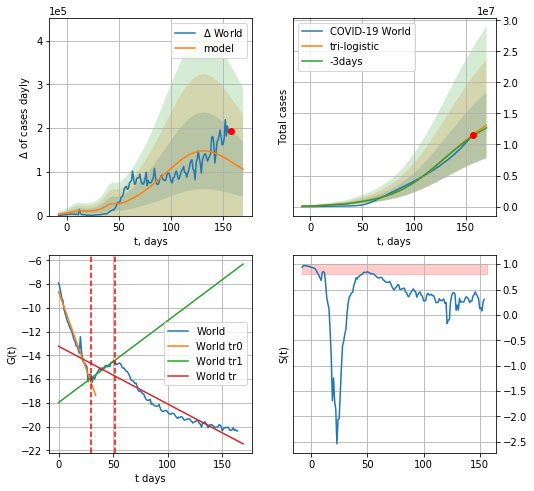

World data at: 2020-07-05
+3 day model MAPE: 0.022716895620590424
model: tri-logistic
coeffs:  [1.42210223e+07 3.87108476e-02 1.28312495e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.40285868538180064
forecast at the end of period: +13 days
	 deltaDaycases:  105639
	 total cases:  13097939 ± 5276618
	 total death:  607594 ± 734323
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.870848
 intercept: -13.226788
 slope: -0.048618


In [494]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*16-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*16-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*16-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

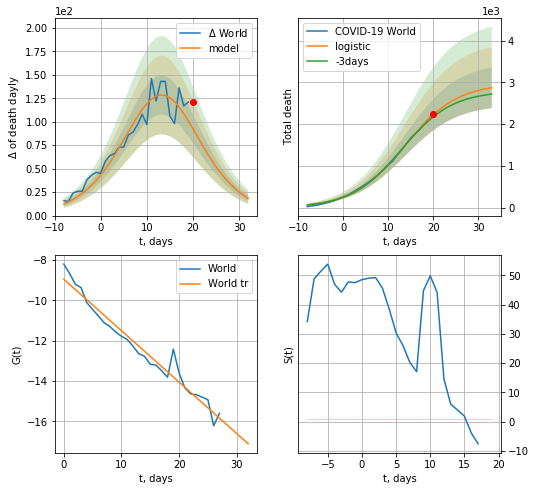

World data at: 2020-07-05
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +13 days
	 total death:  2868 ± 485
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


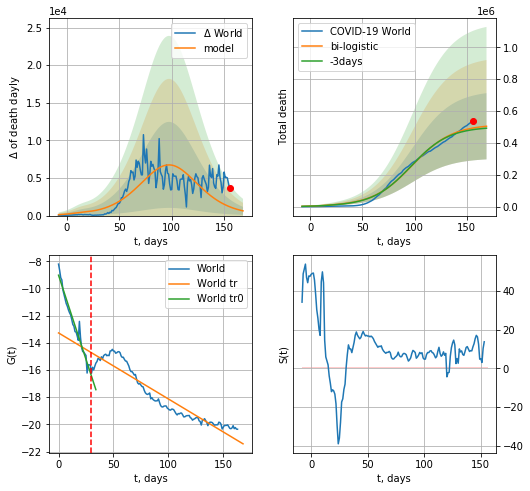

World data at: 2020-07-05
+3 day model MAPE: 0.02129048134488313
model: bi-logistic
coeffs:  [5.13462078e+05 5.25336237e-02 9.78601375e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.41213366619728253
forecast at the end of period: +13 days
	 deltaDaydeath:  628
	 total death:  504485 ± 207915
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.897361
 intercept: -13.271367
 slope: -0.048551


In [495]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*16-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*16-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [496]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


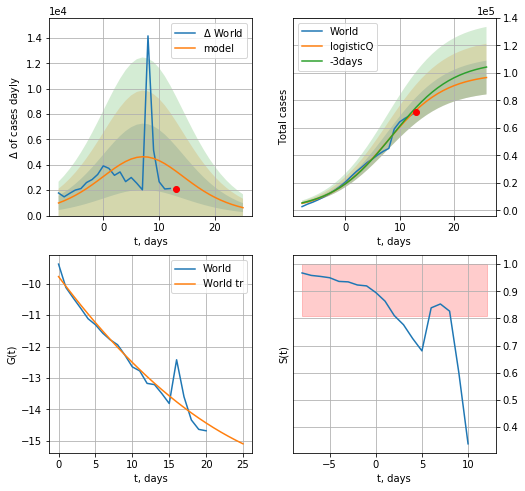

World data at: 2020-07-05
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +13 days
	 deltaDaycases: 624
	 total cases: 96696 ± 12276
	 total death: 4485 ± 1708
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


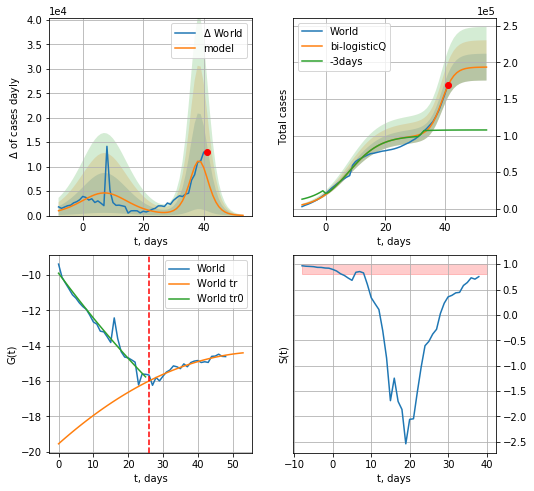

World data at: 2020-07-05
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +13 days
	 deltaDaycases: 46
	 total cases: 193535 ± 18327
	 total death: 8977 ± 2550
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


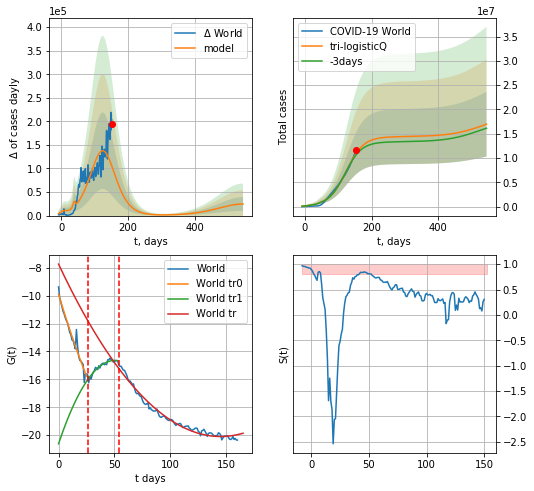

World data at: 2020-07-05
+3 day model MAPE: 0.029744
model: tri-logisticQ
coeffs: [ 1.41965750e+07  2.12436126e-07  1.24256590e+02 -1.82421170e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393378
forecast at the end of period: +391 days
	 deltaDaycases: 24503
	 total cases: 16963404 ± 6673029
	 total death: 786908 ± 928656
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.980451
 intercept_: -7.735776070221519
 coeffs_: [ 0.         -0.17055679  0.0005882 ]


In [498]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*16-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*16-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


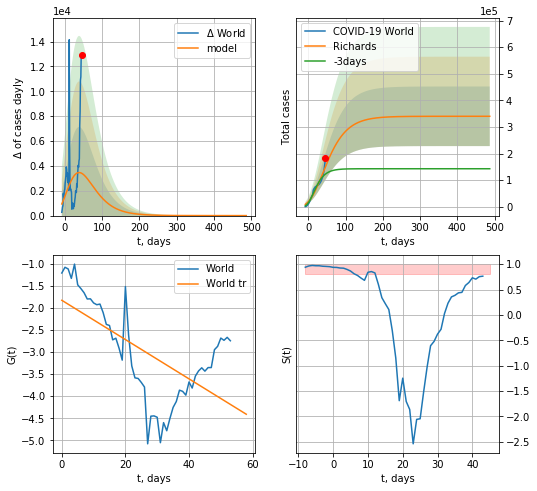

World data at: 2020-07-05
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +441 days
	 deltaDaycases: 0
	 total cases: 340076 ± 111979
	 total death: 15775 ± 15583
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


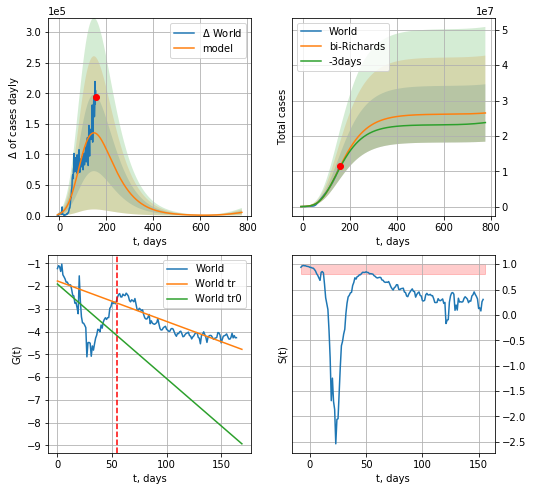

World data at: 2020-07-05
+3 day model MAPE: 0.019140
model: bi-Richards
coeffs: [ 2.58319459e+07  1.29897119e+00 -1.67879779e+02  1.09885051e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.306439
forecast at the end of period: +621 days
	 deltaDaycases: 5232
	 total cases: 26485686 ± 8116251
	 total death: 1228633 ± 1129503
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.357289
 intercept: -1.911917
 slope: -0.041546
trend coefficient of determination: 0.780677
 intercept: -1.779114
 slope: -0.017769


In [499]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

166


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


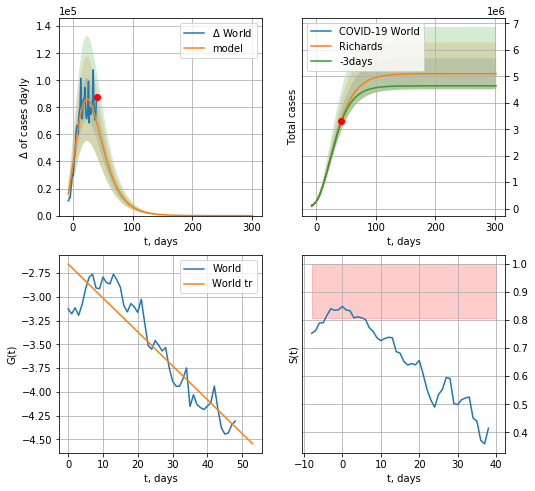

World data at: 2020-07-05
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +261 days
	 deltaDaycases: 0
	 total cases: 5102532 ± 589488
	 total death: 236699 ± 82036
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


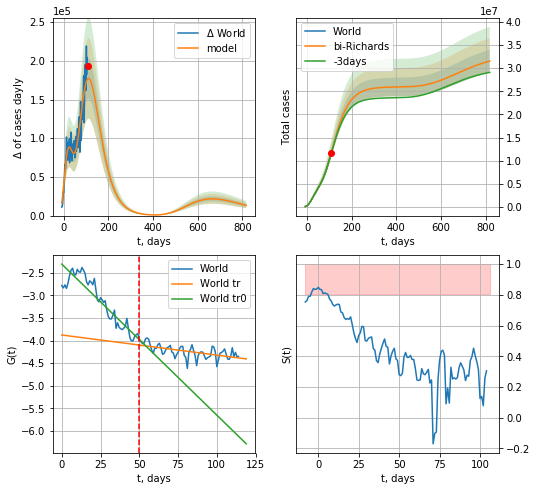

World data at: 2020-07-05
+3 day model MAPE: 0.008318
model: bi-Richards
coeffs: [ 2.08632414e+07  1.42570496e+00 -6.68802280e+01  1.60110097e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.077972
forecast at the end of period: +711 days
	 deltaDaycases: 13262
	 total cases: 31542884 ± 2459472
	 total death: 1463229 ± 342274
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.841491
 intercept: -2.305250
 slope: -0.033470
trend coefficient of determination: 0.343330
 intercept: -3.876349
 slope: -0.004457


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


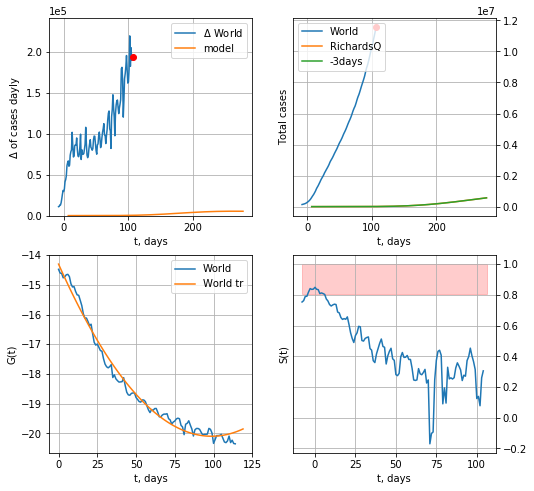

World data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.29689889e+06  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +171 days
	 deltaDaycases: 5292


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [500]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,90*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


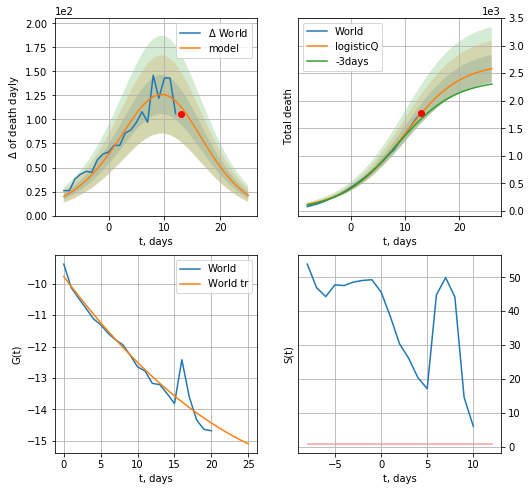

World data at: 2020-07-05
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +13 days
	 total death: 2578 ± 252
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


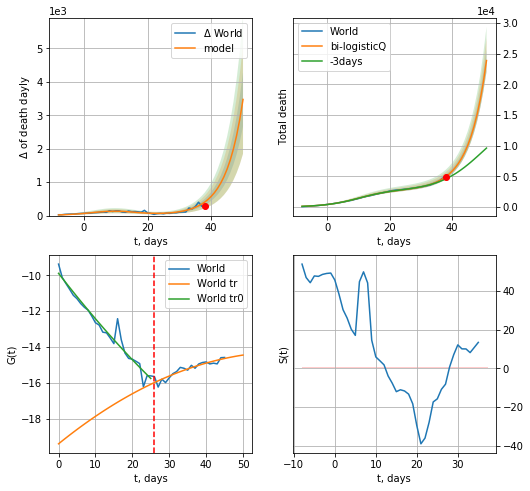

World data at: 2020-07-05
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +13 days
	 total death: 23869 ± 1828
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


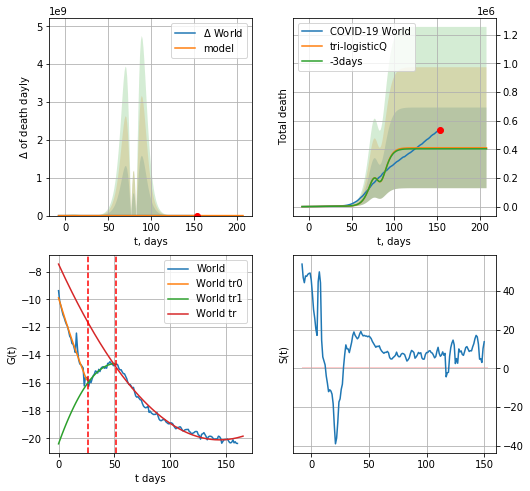

World data at: 2020-07-05
+3 day model MAPE: 0.016858
model: tri-logisticQ
coeffs: [-6.01473915e+06  1.22429372e-03  7.95218229e+01 -1.15706369e+02]
rational stdev: 0.686135
forecast at the end of period: +55 days
	 total death: 409972 ± 281296
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.982718
 intercept_: -7.4648404324575
 coeffs_: [ 0.         -0.17542924  0.00060898]


In [502]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*16-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*16-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


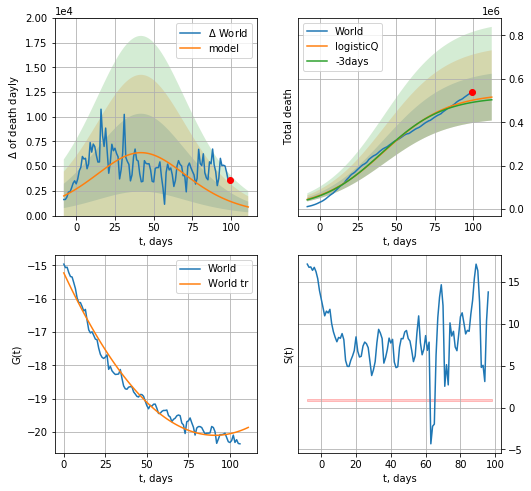

World data at: 2020-07-05
+3 day model MAPE: 0.020243
model: logisticQ
coeffs: [ 5.34144560e+05  2.67554772e-07  4.22316801e+01 -1.78143113e+05]
rational stdev: 0.209057
forecast at the end of period: +13 days
	 total death: 515641 ± 107798
trend coefficient of determination: 0.980451
 intercept_: -15.230032505968108
 coeffs_: [ 0.         -0.10706652  0.00058852]


In [503]:
x = forecastRRR("World",dfW[58:],d1,7*16-dT,1.0,False,cases='death')

In [504]:
#trend(dfSP,'SP',10)

In [505]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
127 2020-07-01  296739       0  28363.0
128 2020-07-02  297183       0  28368.0
129 2020-07-03  297625       0  28385.0
130 2020-07-04  297625       0  28385.0
131 2020-07-05  297625       0  28385.0


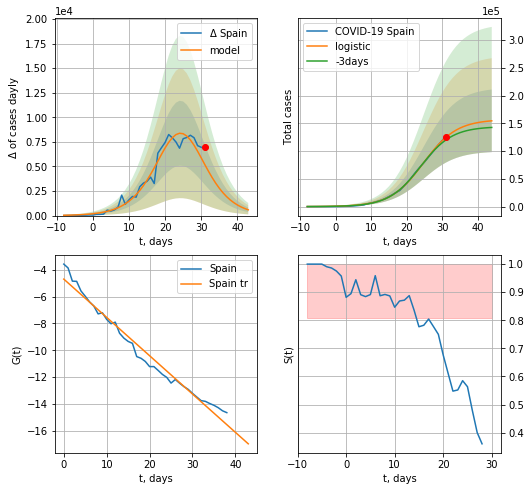

Spain data at: 2020-07-05
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +13 days
	 deltaDaycases:  587
	 total cases:  154443 ± 56355
	 total death:  14729 ± 16123
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

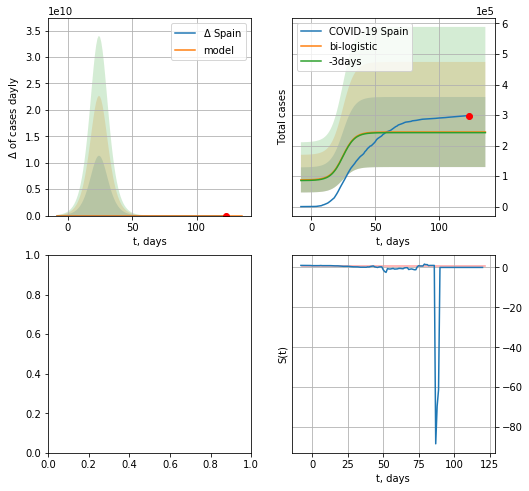

In [507]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*16-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

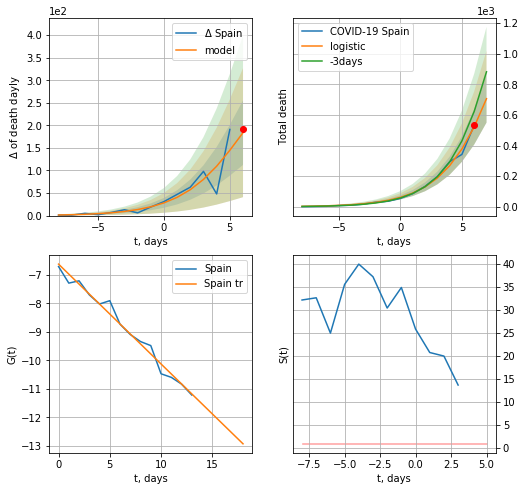

Spain data at: 2020-07-03
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +1 days
	 total death:  706 ± 156
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


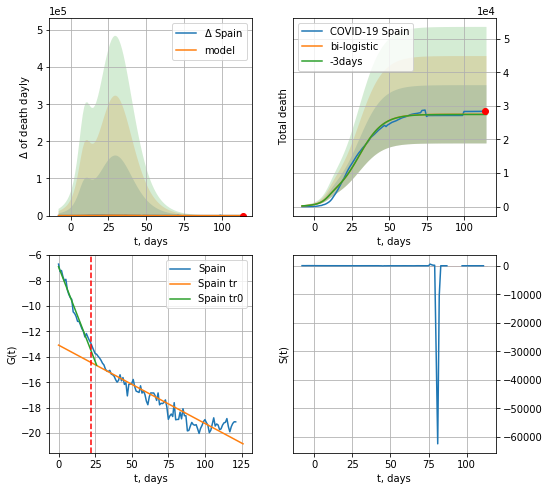

Spain data at: 2020-07-03
+3 day model MAPE: 0.0019384919468481822
model: bi-logistic
coeffs:  [2.47379914e+04 1.25333776e-01 3.00405170e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3155202275077107
forecast at the end of period: +1 days
	 deltaDaydeath:  0
	 total death:  27482 ± 8671
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.890549
 intercept: -13.079072
 slope: -0.061628


In [94]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*14-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


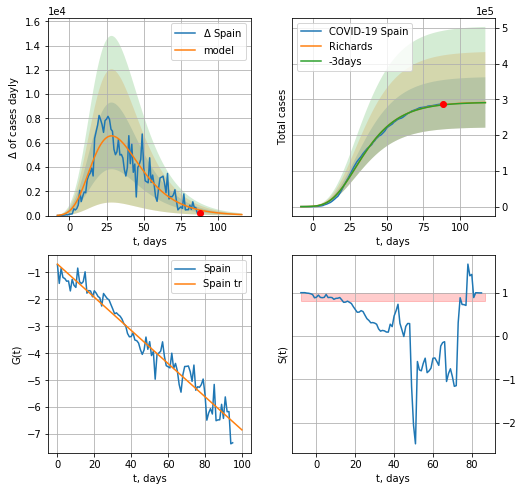

Spain data at: 2020-07-03
+3 day model MAPE: 0.001576
model: Richards
coeffs: [ 2.92623031e+05  8.19006343e+00 -5.10999338e+01  7.47571626e-03]
rational stdev: 0.241957
forecast at the end of period: +29 days
	 deltaDaycases: 83
	 total cases: 291299 ± 70481
	 total death: 27781 ± 20165
trend coefficient of determination: 0.955401
 intercept: -0.697601
 slope: -0.061420


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp


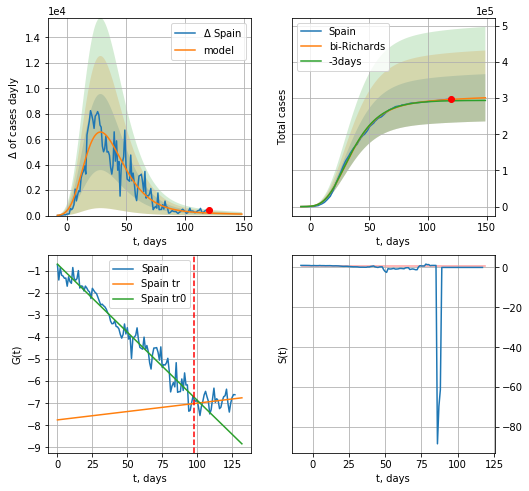

Spain data at: 2020-07-03
+3 day model MAPE: 0.013195
model: bi-Richards
coeffs: [ 1.35990455e+04  3.35965168e+00 -6.05479000e+01  7.96286434e-03]
rational stdev: 0.217131
forecast at the end of period: +29 days
	 deltaDaycases: 118
	 total cases: 301014 ± 65359
	 total death: 28708 ± 18700
bi-Richards approximation splitting point: 98
trend coefficient of determination: 0.957936
 intercept: -0.693249
 slope: -0.061706
trend coefficient of determination: 0.046106
 intercept: -7.754755
 slope: 0.007583


In [95]:
vL = 98+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*18-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


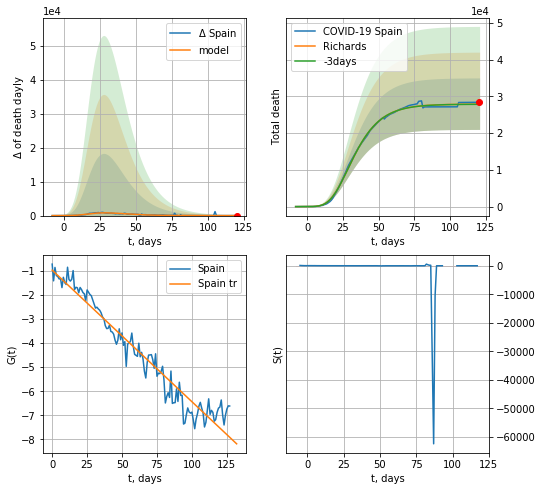

Spain data at: 2020-07-03
+3 day model MAPE: 0.001303
model: Richards
coeffs: [ 2.78766772e+04  1.00437718e+01 -3.24953160e+01  7.89015017e-03]
rational stdev: 0.251399
forecast at the end of period: +1 days
	 total death: 27858 ± 7003
trend coefficient of determination: 0.945253
 intercept: -0.969132
 slope: -0.054641


In [96]:
x = forecastRR('Spain',dfSP[1:],d1,7*14-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


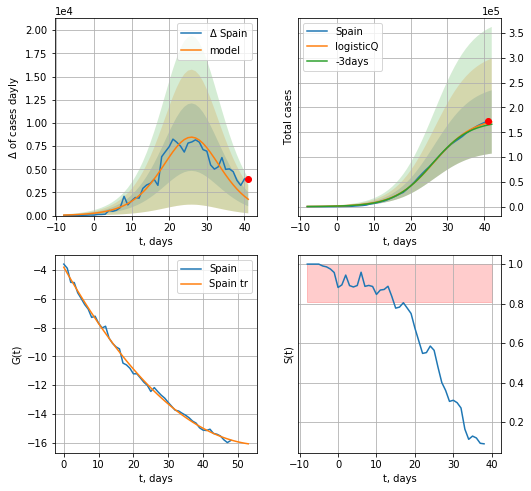

Spain data at: 2020-07-03
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +1 days
	 deltaDaycases: 1762
	 total cases: 170901 ± 63903
	 total death: 16299 ± 18283
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


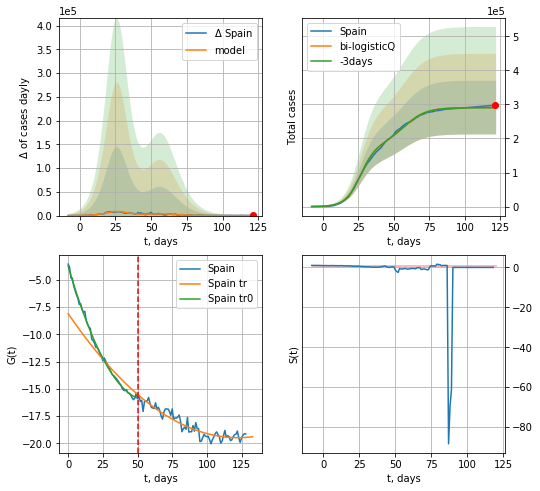

Spain data at: 2020-07-03
+3 day model MAPE: 0.002083
model: bi-logisticQ
coeffs: [ 1.10991052e+05  4.04663607e-07  5.72551831e+01 -3.15732690e+05]
rational stdev: 0.271268
forecast at the end of period: +1 days
	 deltaDaycases: 3
	 total cases: 290907 ± 78913
	 total death: 27744 ± 22578
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.889730
 intercept_: -8.122200607983883
 coeffs_: [ 0.         -0.1854582   0.00075778]


In [97]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


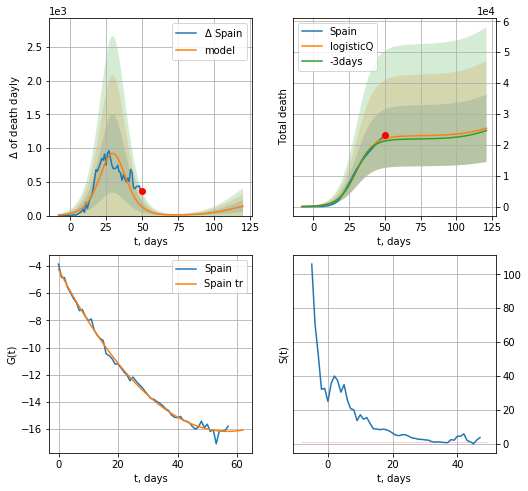

Spain data at: 2020-07-03
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +71 days
	 total death: 25376 ± 10932
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


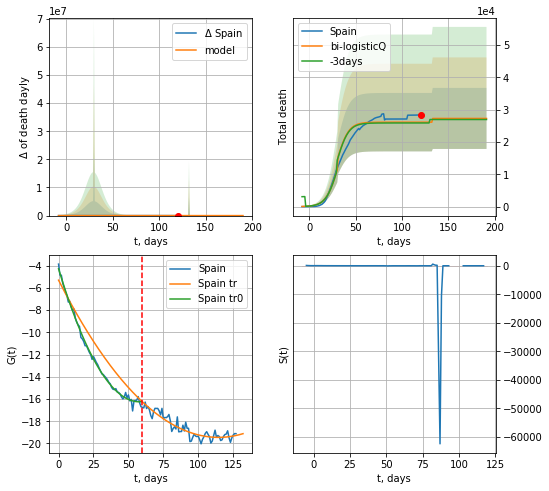

Spain data at: 2020-07-03
+3 day model MAPE: 0.009535
model: bi-logisticQ
coeffs: [3270.58482842   10.3875467    30.41802122  -10.49931835]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.346005
forecast at the end of period: +71 days
	 total death: 27308 ± 9448
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.851150
 intercept_: -5.315730888365636
 coeffs_: [ 0.         -0.24709055  0.00107981]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [98]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


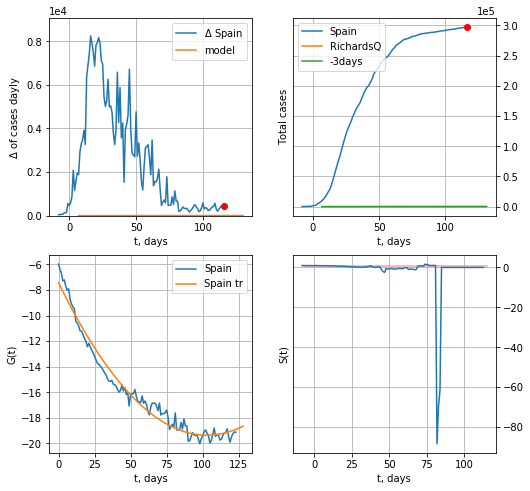

Spain data at: 2020-07-03
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.79976480e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +15 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [99]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

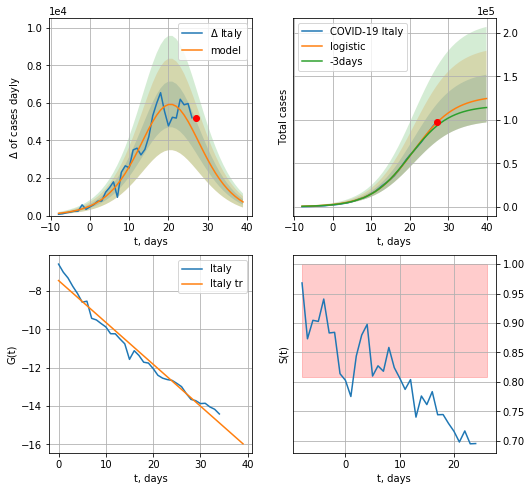

Italy data at: 2020-07-05
+3 day model MAPE: 0.045578378390248614
model: logistic
coeffs:  [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.22065596678975638
forecast at the end of period: +13 days
	 deltaDaycases:  726
	 total cases:  124438 ± 27458
	 total death:  17954 ± 11884
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


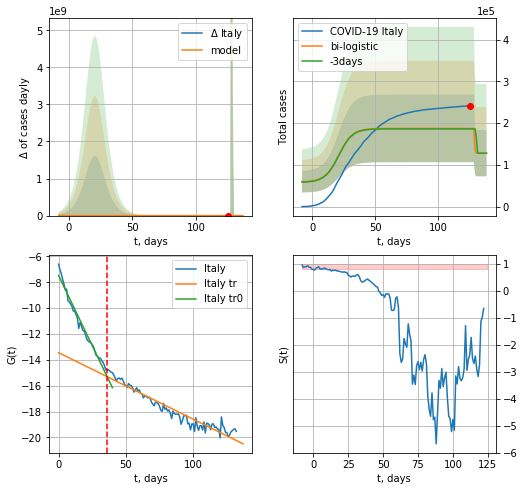

Italy data at: 2020-07-05
+3 day model MAPE: 0.0066186137023685416
model: bi-logistic
coeffs:  [ 5.94161881e+04 -7.72361304e+00  1.28718191e+02] [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.4320215830008734
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  128139 ± 55358
	 total death:  18488 ± 23961
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.927648
 intercept: -13.441601
 slope: -0.051489


In [509]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,16*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,16*7-dT,x,1.0,vL=vL)

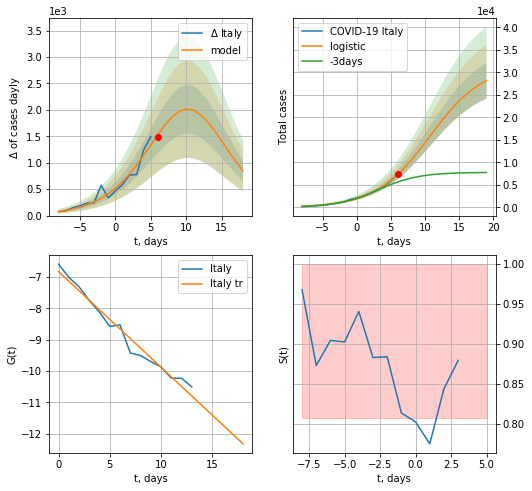

Italy data at: 2020-07-05
+3 day model MAPE: 0.44264442257961345
model: logistic
coeffs:  [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.14147817336323687
forecast at the end of period: +13 days
	 deltaDaycases:  846
	 total cases:  28158 ± 3983
	 total death:  4062 ± 1724
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


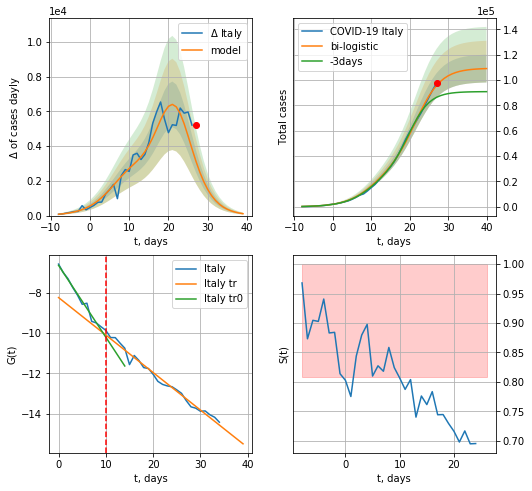

Italy data at: 2020-07-05
+3 day model MAPE: 0.1273932560599292
model: bi-logistic
coeffs:  [7.78644605e+04 3.07215535e-01 2.18188307e+01] [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.10049358500066935
forecast at the end of period: +13 days
	 deltaDaycases:  109
	 total cases:  109054 ± 10959
	 total death:  15734 ± 4743
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


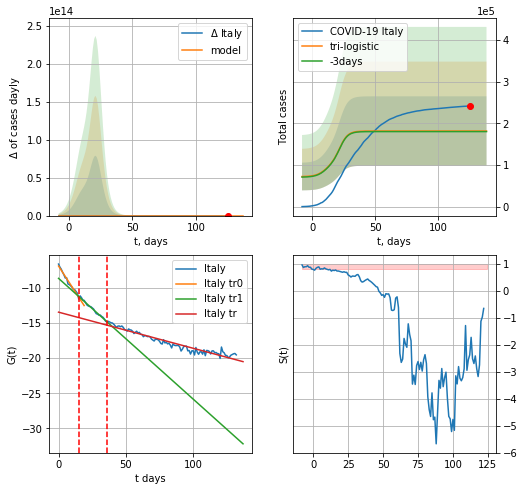

Italy data at: 2020-07-05
+3 day model MAPE: 0.007624807857054253
model: tri-logistic
coeffs:  [ 7.20862618e+04 -5.94085751e+00  1.08681855e+03] [3.14978181e+04 2.56455869e-01 1.06869163e+01 7.78644605e+04
 3.07215535e-01 2.18188307e+01]
forecast rational stdev:  0.45876069337255987
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  181448 ± 83241
	 total death:  26180 ± 36031
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.927648
 intercept: -13.441601
 slope: -0.051489


In [510]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*16-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*16-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*16-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

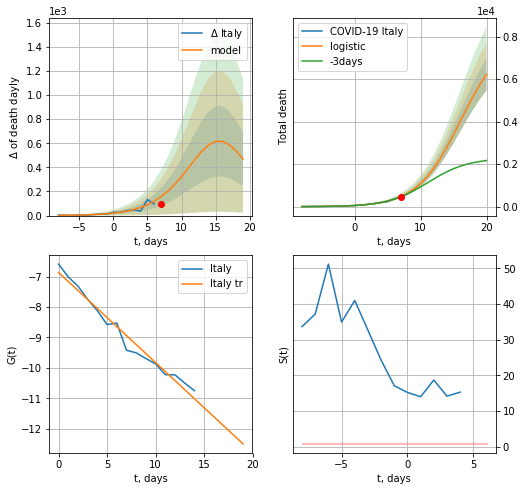

Italy data at: 2020-07-05
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +13 days
	 total death:  6214 ± 746
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


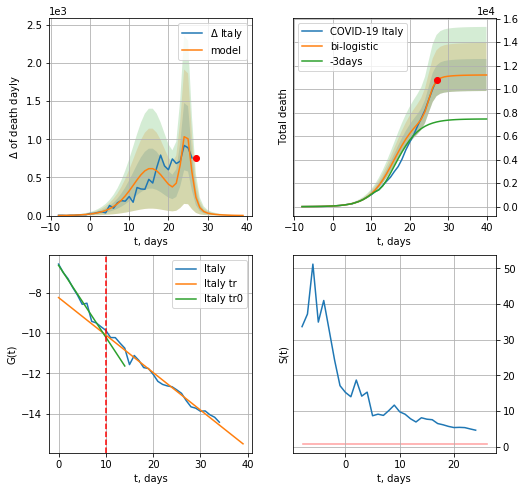

Italy data at: 2020-07-05
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +13 days
	 deltaDaydeath:  1
	 total death:  11206 ± 1364
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


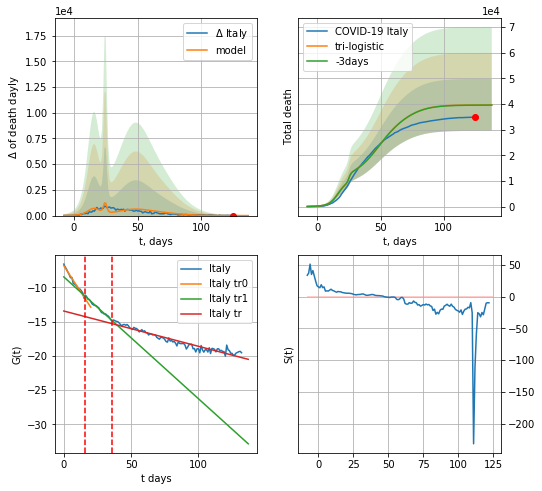

Italy data at: 2020-07-05
+3 day model MAPE: 0.0023193774739793858
model: tri-logistic
coeffs:  [2.27410395e+04 1.02931885e-01 4.78286543e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.25538026563558425
forecast at the end of period: +13 days
	 deltaDaydeath:  0
	 total death:  39629 ± 10120
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.927648
 intercept: -13.441601
 slope: -0.051489


In [511]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*16-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*16-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


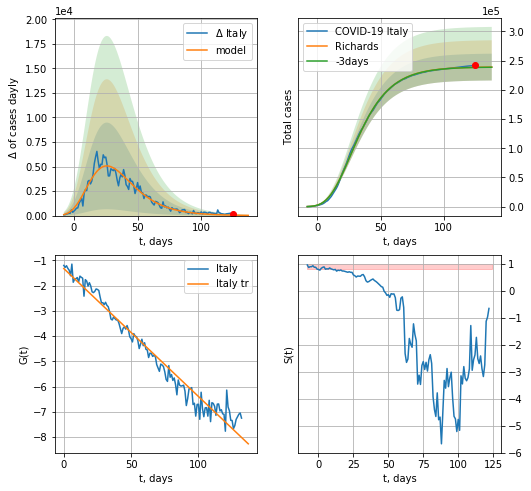

Italy data at: 2020-07-05
+3 day model MAPE: 0.001012
model: Richards
coeffs: [ 2.39185830e+05  6.60340903e+00 -5.57103072e+01  8.75180673e-03]
rational stdev: 0.095896
forecast at the end of period: +13 days
	 deltaDaycases: 22
	 total cases: 238810 ± 22900
	 total death: 34456 ± 9912
trend coefficient of determination: 0.968280
 intercept: -1.328814
 slope: -0.050614


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


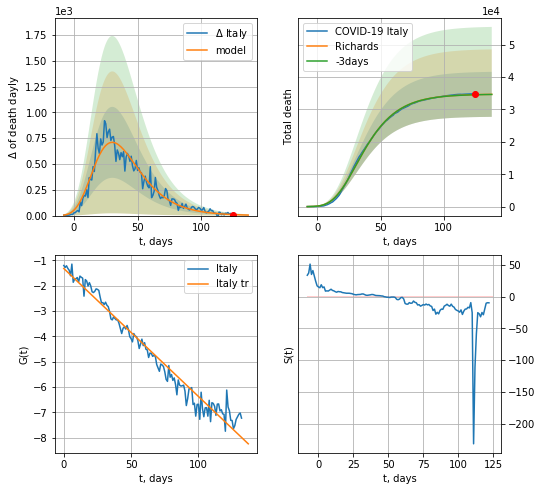

Italy data at: 2020-07-05
+3 day model MAPE: 0.000762
model: Richards
coeffs: [ 3.47469494e+04  7.50936476e+00 -5.74079282e+01  7.41979939e-03]
rational stdev: 0.200306
forecast at the end of period: +13 days
	 total death: 34659 ± 6942
trend coefficient of determination: 0.968306
 intercept: -1.316378
 slope: -0.050572


In [512]:
vL=95
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Italy',dfIT[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


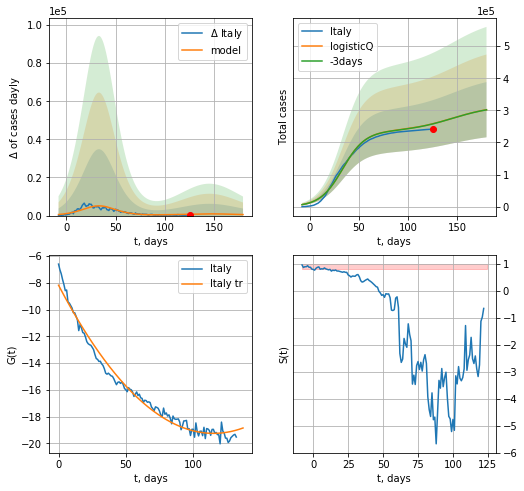

Italy data at: 2020-07-05
+3 day model MAPE: 0.001361
model: logisticQ
coeffs: [ 2.34137730e+05  2.53521177e-07  3.33547601e+01 -3.43608885e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.284664
forecast at the end of period: +55 days
	 deltaDaycases: 543
	 total cases: 302147 ± 86010
	 total death: 43595 ± 37229
trend coefficient of determination: 0.980981
 intercept_: -8.171473164950775
 coeffs_: [ 0.         -0.1926521   0.00083696]


In [513]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


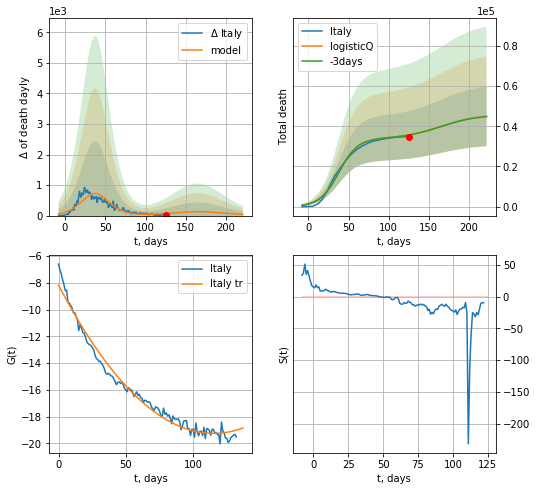

Italy data at: 2020-07-05
+3 day model MAPE: 0.001843
model: logisticQ
coeffs: [ 3.38879399e+04  2.39411950e-07  3.78035937e+01 -3.54584128e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.330762
forecast at the end of period: +97 days
	 total death: 44931 ± 14861
trend coefficient of determination: 0.980981
 intercept_: -8.171473164950775
 coeffs_: [ 0.         -0.1926521   0.00083696]


In [514]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [515]:
dT

99

FR
           date     cases  active    death
137 2020-07-01  165719.0   59319  29861.0
138 2020-07-02  166378.0   59701  29875.0
139 2020-07-03  166960.0   60007  29893.0
140 2020-07-04  166960.3   60007  29893.0
141 2020-07-05  166960.6   60007  29893.0


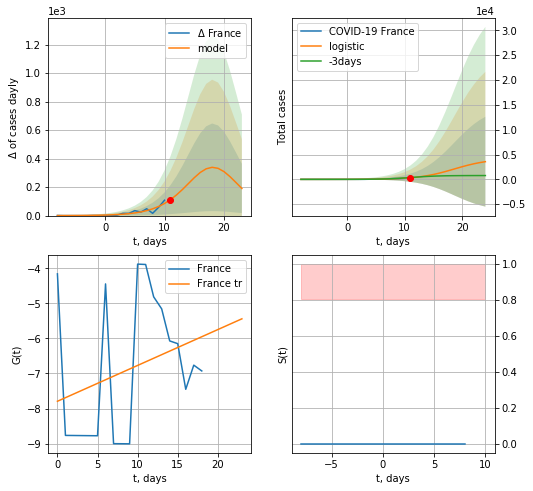

France data at: 2020-07-05
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +13 days
	 deltaDaycases:  190
	 total cases:  3561 ± 9041
	 total death:  637 ± 4852
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


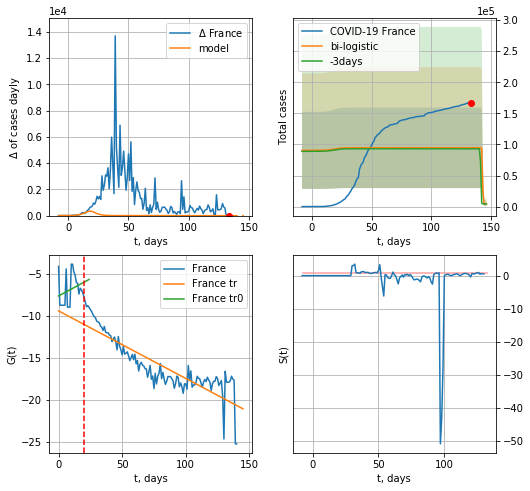

France data at: 2020-07-05
+3 day model MAPE: 0.016785335484871707
model: bi-logistic
coeffs:  [ 9.04275772e+04 -5.44974059e+00  1.42783376e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.6848410738170767
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  4173 ± 2858
	 total death:  747 ± 1534
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.750543
 intercept: -9.443703
 slope: -0.080342


In [517]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,16*7-dT,1.0)
xx = forecast2('France',dfFR,d1,16*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [518]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

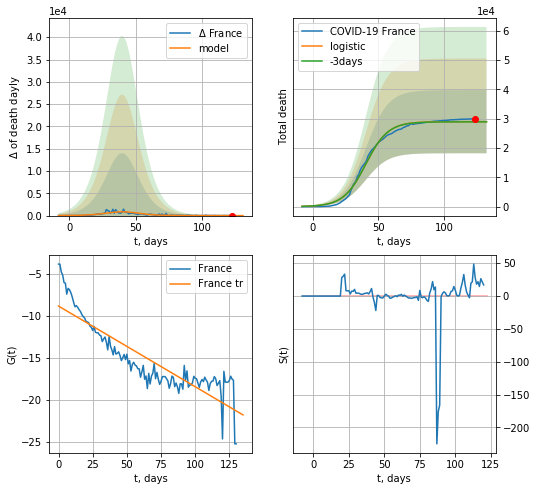

France data at: 2020-07-05
+3 day model MAPE: 0.002136185450872421
model: logistic
coeffs:  [2.89482112e+04 1.18221140e-01 4.03904985e+01]
rational stdev:  0.37184914528850715
forecast at the end of period: +9 days
	 total death:  28947 ± 10764
trend coefficient of determination: 0.777643
 intercept: -8.872177
 slope: -0.095894


In [519]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


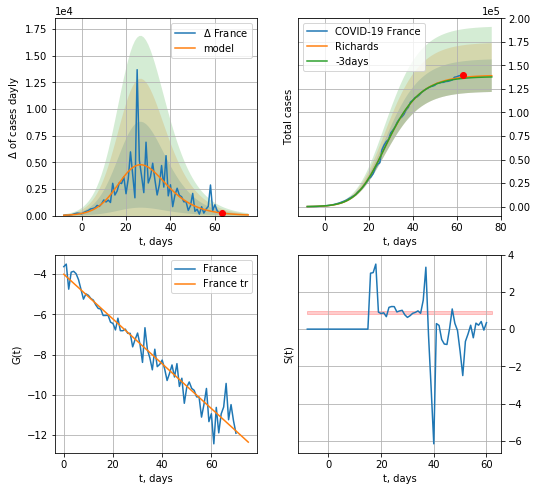

France data at: 2020-07-05
+3 day model MAPE: 0.007986
model: Richards
coeffs: [1.39530079e+05 2.42709630e-01 2.04374273e+01 4.70589839e-01]
rational stdev: 0.124192
forecast at the end of period: +13 days
	 deltaDaycases: 62
	 total cases: 139011 ± 17264
	 total death: 24889 ± 9273
trend coefficient of determination: 0.951177
 intercept: -4.003023
 slope: -0.111381


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


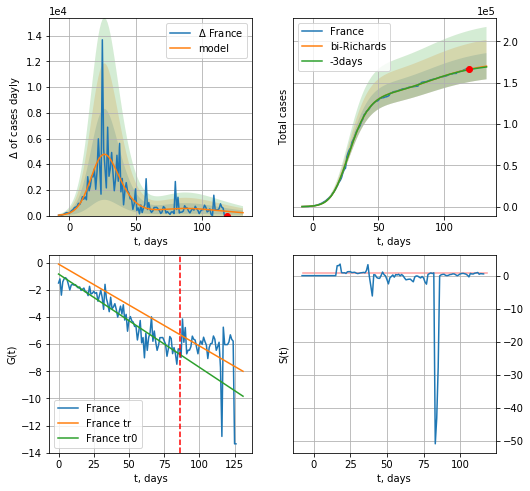

France data at: 2020-07-05
+3 day model MAPE: 0.003368
model: bi-Richards
coeffs: [ 3.65314791e+04  4.26153391e+00 -2.45731995e+01  9.54378200e-03]
rational stdev: 0.093229
forecast at the end of period: +13 days
	 deltaDaycases: 226
	 total cases: 170054 ± 15854
	 total death: 30447 ± 8515
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.903777
 intercept: -0.829630
 slope: -0.068742
trend coefficient of determination: 0.130535
 intercept: -0.097927
 slope: -0.060300


In [521]:
vL = 86+14
x = forecastRR('France',dfFR[14:vL-14],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


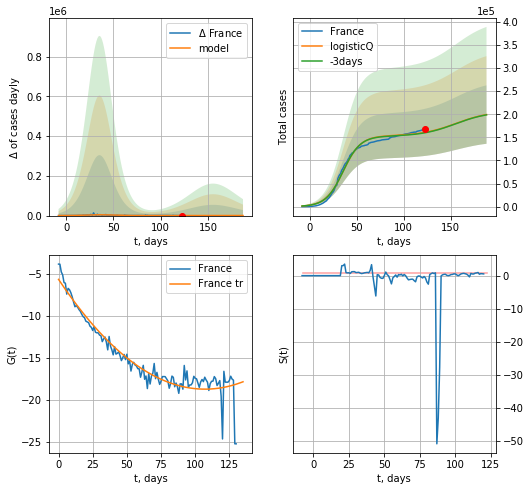

France data at: 2020-07-05
+3 day model MAPE: 0.005305
model: logisticQ
coeffs: [ 1.53092295e+05  2.32593345e-07  3.57369074e+01 -4.64766643e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317390
forecast at the end of period: +65 days
	 deltaDaycases: 378
	 total cases: 199308 ± 63258
	 total death: 35684 ± 33977
trend coefficient of determination: 0.902491
 intercept_: -5.6972911694343225
 coeffs_: [ 0.         -0.24356534  0.00113595]


In [522]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


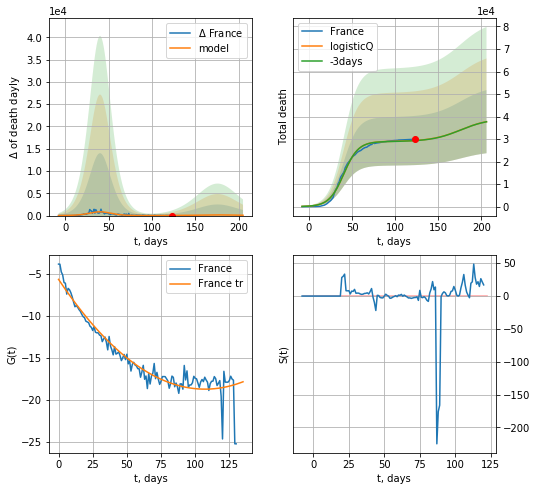

France data at: 2020-07-05
+3 day model MAPE: 0.002154
model: logisticQ
coeffs: [ 2.89481794e+04  3.38541588e-07  4.03911021e+01 -3.49138702e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371873
forecast at the end of period: +83 days
	 total death: 37722 ± 14028
trend coefficient of determination: 0.902491
 intercept_: -5.6972911694343225
 coeffs_: [ 0.         -0.24356534  0.00113595]


In [523]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [524]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [525]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
128 2020-07-01  196324    7463  9061.0
129 2020-07-02  196717    6653  9064.0
130 2020-07-03  197000    6627  9073.0
131 2020-07-04  197418    7037  9081.0
132 2020-07-05  197558    6272  9086.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


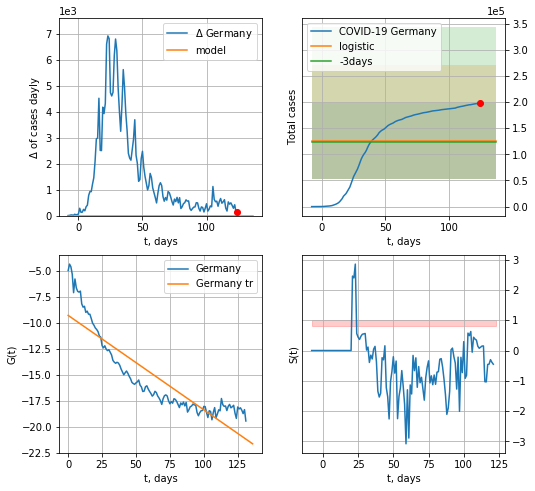

Germany data at: 2020-07-05
+3 day model MAPE: 0.013538820165030642
model: logistic
coeffs:  [ 1.24980789e+05 -4.85071506e+00  1.44611326e+02]
rational stdev:  0.5828944359795869
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  124980 ± 72850
	 total death:  5748 ± 10051
trend coefficient of determination: 0.792047
 intercept: -9.289988
 slope: -0.090805


In [526]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*16-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


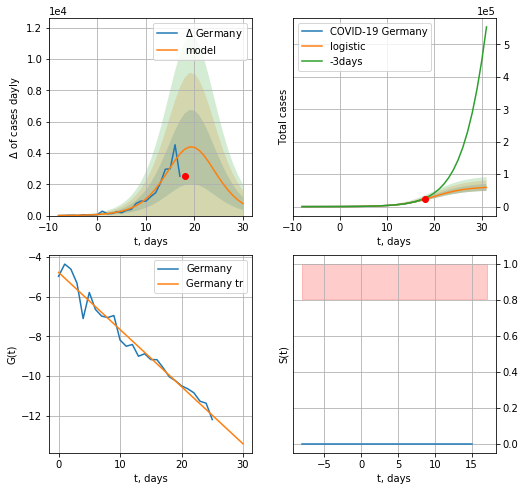

Germany data at: 2020-07-05
+3 day model MAPE: 0.18326880785963318
model: logistic
coeffs:  [6.15503822e+04 2.86340376e-01 1.98405527e+01]
rational stdev:  0.17812668621755098
forecast at the end of period: +13 days
	 deltaDaycases:  761
	 total cases:  59129 ± 10532
	 total death:  2719 ± 1452
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


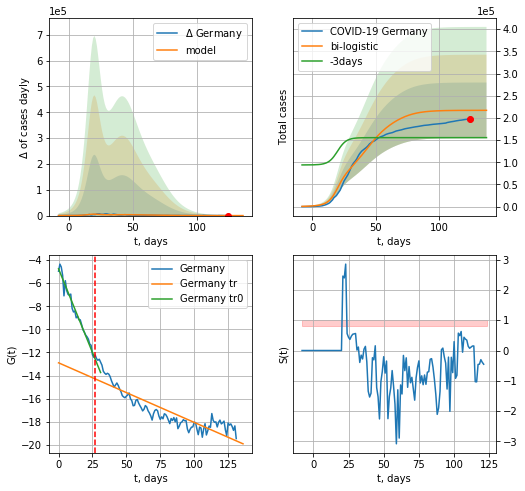

Germany data at: 2020-07-05
+3 day model MAPE: 0.3955508606382209
model: bi-logistic
coeffs:  [1.24444686e+05 1.09958120e-01 4.16023114e+01] [6.15503822e+04 2.86340376e-01 1.98405527e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.28881262642431327
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  217089 ± 62698
	 total death:  9984 ± 8650
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.787974
 intercept: -12.894287
 slope: -0.051511


In [527]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,16*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*16-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
128 2020-07-01  196324    7463  9061.0
129 2020-07-02  196717    6653  9064.0
130 2020-07-03  197000    6627  9073.0
131 2020-07-04  197418    7037  9081.0
132 2020-07-05  197558    6272  9086.0


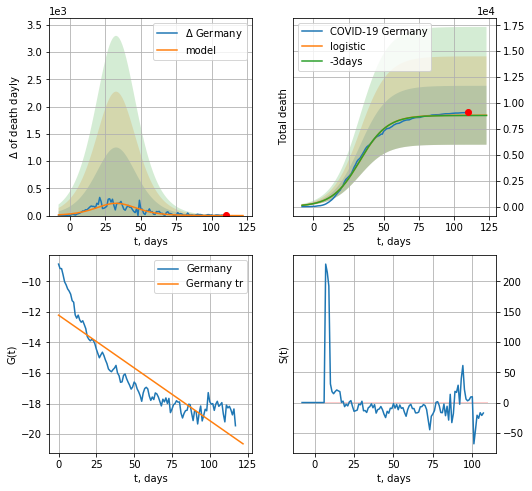

Germany data at: 2020-07-05
+3 day model MAPE: 0.002454056229175719
model: logistic
coeffs:  [8.81605778e+03 1.02312041e-01 3.30129307e+01]
rational stdev:  0.322331925862329
forecast at the end of period: +13 days
	 total death:  8815 ± 2841
trend coefficient of determination: 0.788805
 intercept: -12.215619
 slope: -0.068964


In [529]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


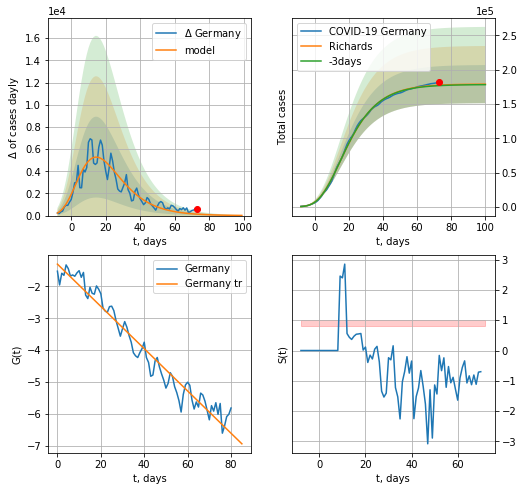

Germany data at: 2020-07-05
+3 day model MAPE: 0.003916
model: Richards
coeffs: [ 1.79110364e+05  9.11571266e+00 -4.38812227e+01  8.82260552e-03]
rational stdev: 0.155516
forecast at the end of period: +27 days
	 deltaDaycases: 16
	 total cases: 178919 ± 27824
	 total death: 8228 ± 3838
trend coefficient of determination: 0.956452
 intercept: -1.304650
 slope: -0.066180


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


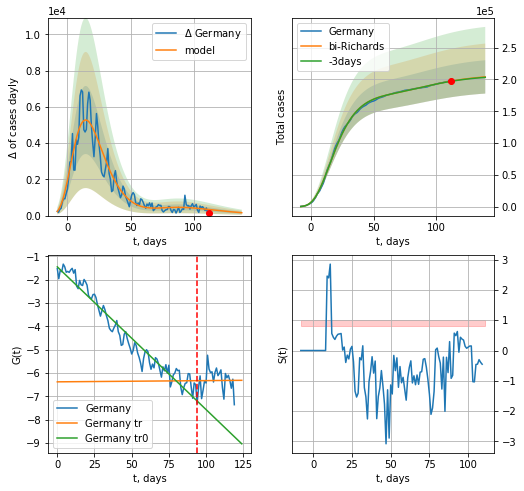

Germany data at: 2020-07-05
+3 day model MAPE: 0.001326
model: bi-Richards
coeffs: [ 2.90794033e+04  4.42133754e+00 -2.59707708e+01  8.99064780e-03]
rational stdev: 0.128253
forecast at the end of period: +27 days
	 deltaDaycases: 158
	 total cases: 203938 ± 26155
	 total death: 9379 ± 3608
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950721
 intercept: -1.448489
 slope: -0.061224
trend coefficient of determination: 0.000063
 intercept: -6.381226
 slope: 0.000522


In [530]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


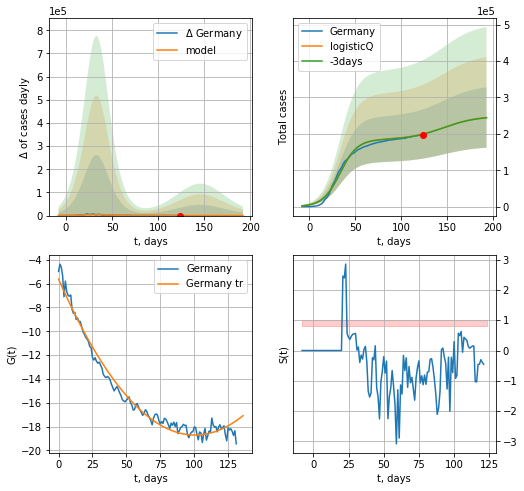

Germany data at: 2020-07-05
+3 day model MAPE: 0.003130
model: logisticQ
coeffs: [ 1.84482310e+05  2.30057952e-07  3.35118648e+01 -4.62070847e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339028
forecast at the end of period: +69 days
	 deltaDaycases: 248
	 total cases: 244911 ± 83031
	 total death: 11263 ± 11455
trend coefficient of determination: 0.979222
 intercept_: -5.613928662206941
 coeffs_: [ 0.         -0.26047222  0.00129518]


In [531]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


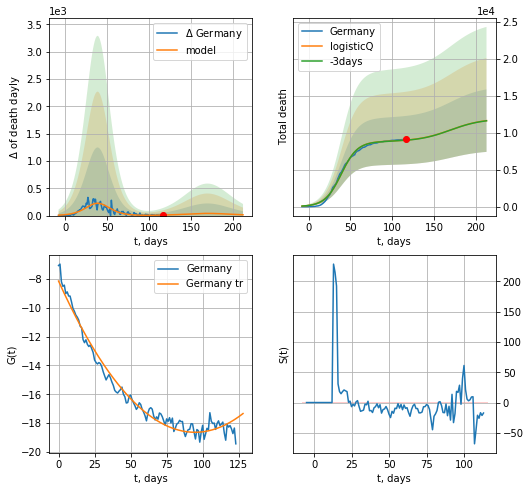

Germany data at: 2020-07-05
+3 day model MAPE: 0.002435
model: logisticQ
coeffs: [ 8.81462447e+03  3.95667034e-07  3.90111288e+01 -2.58921502e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363465
forecast at the end of period: +97 days
	 total death: 11629 ± 4226
trend coefficient of determination: 0.975594
 intercept_: -8.131651887519896
 coeffs_: [ 0.         -0.22212097  0.00117319]


In [532]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
122 2020-07-01  2779953  1484475  130798.0
123 2020-07-02  2837189  1514613  131485.0
124 2020-07-03  2890588  1522999  132101.0
125 2020-07-04  2935770  1543047  132318.0
126 2020-07-05  2983155  1560897  132571.0


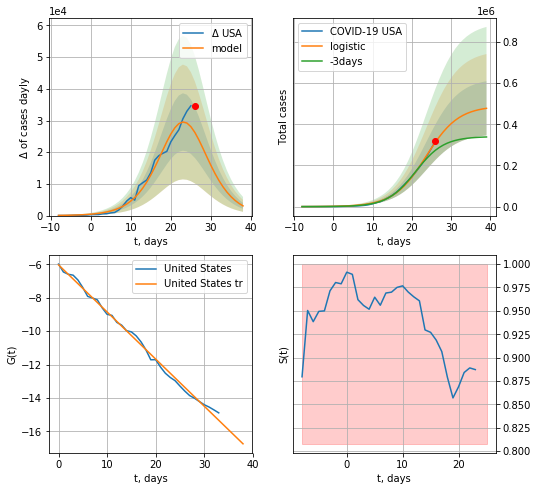

USA data at: 2020-07-05
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +13 days
	 deltaDaycases:  3062
	 total cases:  477494 ± 131821
	 total death:  21219 ± 17573
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


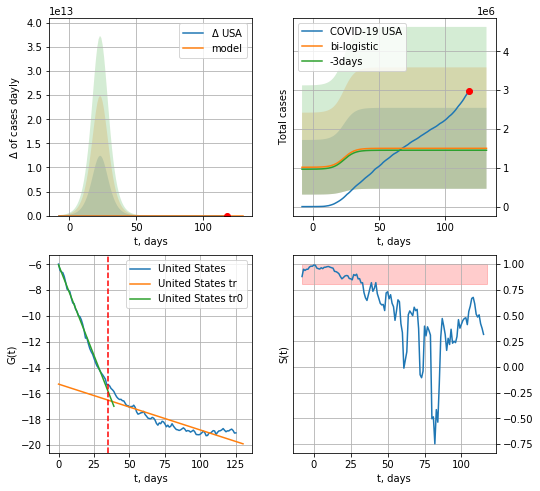

USA data at: 2020-07-05
+3 day model MAPE: 0.03406078067815254
model: bi-logistic
coeffs:  [ 8.10867813e+05 -1.03560395e+01  2.57879487e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6941494617379396
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1502610 ± 1043036
	 total death:  66775 ± 139055
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.803523
 intercept: -15.277522
 slope: -0.035548


In [533]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

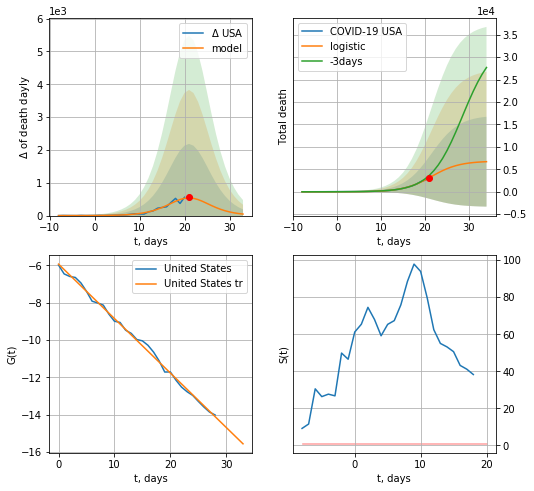

USA data at: 2020-07-05
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +13 days
	 total death:  6705 ± 10010
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


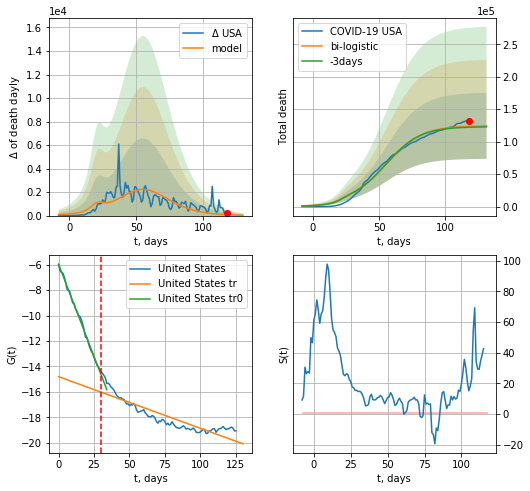

USA data at: 2020-07-05
+3 day model MAPE: 0.011930976611423224
model: bi-logistic
coeffs:  [1.17870819e+05 7.55486077e-02 5.55776604e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.4085865185590283
forecast at the end of period: +13 days
	 deltaDaydeath:  30
	 total death:  124310 ± 50791
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.799219
 intercept: -14.799460
 slope: -0.040618


In [534]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*16-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


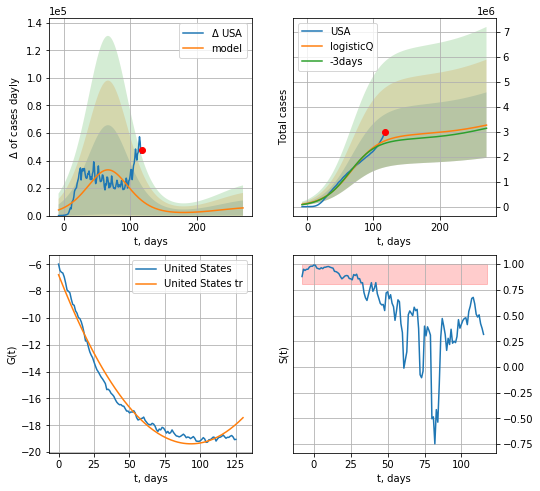

USA data at: 2020-07-05
+3 day model MAPE: 0.041135
model: logisticQ
coeffs: [ 2.87676848e+06  1.41574564e-07  6.68441666e+01 -3.24999474e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.401578
forecast at the end of period: +153 days
	 deltaDaycases: 5577
	 total cases: 3268152 ± 1312417
	 total death: 145236 ± 174970
trend coefficient of determination: 0.980069
 intercept_: -6.784783636707203
 coeffs_: [ 0.         -0.26995395  0.00144643]


In [535]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


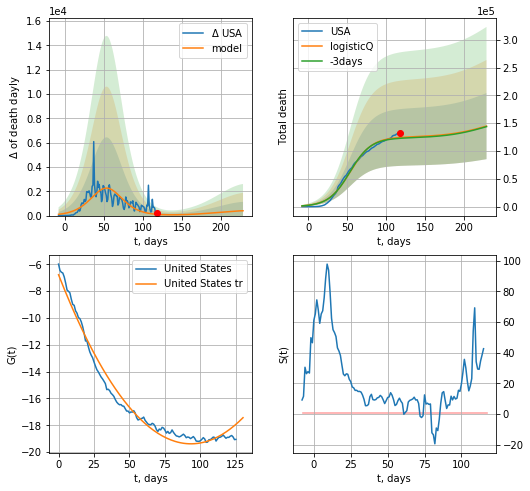

USA data at: 2020-07-05
+3 day model MAPE: 0.011706
model: logisticQ
coeffs: [ 1.24826802e+05  2.19625628e-07  5.37704561e+01 -3.29846988e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410725
forecast at the end of period: +111 days
	 total death: 144777 ± 59463
trend coefficient of determination: 0.980069
 intercept_: -6.784783636707203
 coeffs_: [ 0.         -0.26995395  0.00144643]


In [536]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


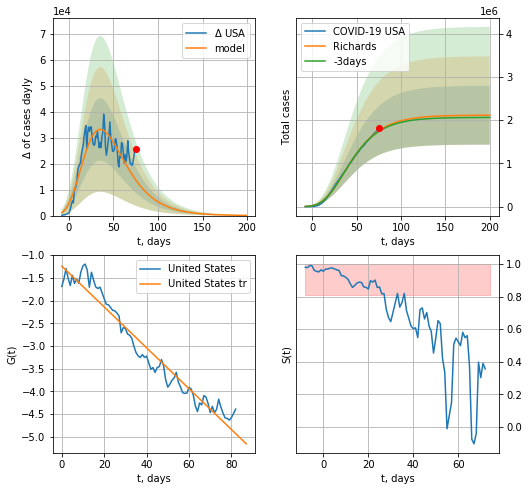

USA data at: 2020-07-05
+3 day model MAPE: 0.011173
model: Richards
coeffs: [ 2.11547108e+06  4.55700208e+00 -7.32276786e+01  9.40292240e-03]
rational stdev: 0.321873
forecast at the end of period: +125 days
	 deltaDaycases: 81
	 total cases: 2113620 ± 680316
	 total death: 93928 ± 90698
trend coefficient of determination: 0.952323
 intercept: -1.242025
 slope: -0.044961


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


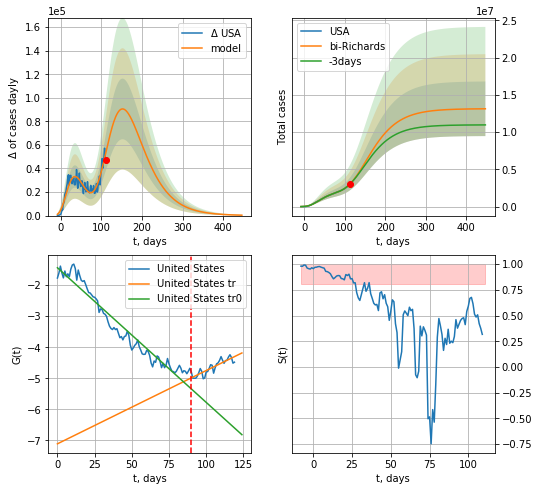

USA data at: 2020-07-05
+3 day model MAPE: 0.005639
model: bi-Richards
coeffs: [ 1.10212986e+07  9.90276791e-01 -1.54526591e+01  2.26631991e-02]
rational stdev: 0.279043
forecast at the end of period: +335 days
	 deltaDaycases: 342
	 total cases: 13121662 ± 3661511
	 total death: 583124 ± 488150
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.944896
 intercept: -1.441076
 slope: -0.043320
trend coefficient of determination: 0.754806
 intercept: -7.106824
 slope: 0.023574


In [537]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*62-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


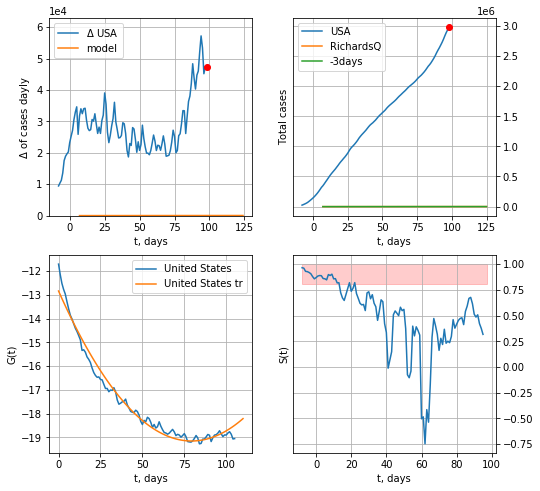

USA data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.52188019e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +27 days
	 deltaDaycases: 30


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [538]:
x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
126 2020-07-01  283006       0  43906.0
127 2020-07-02  283757       0  43995.0
128 2020-07-03  284276       0  44131.0
129 2020-07-04  284900       0  44198.0
130 2020-07-05  285416       0  44220.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


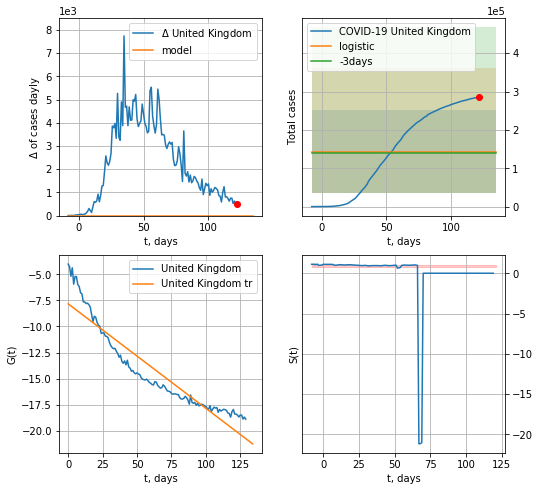

United Kingdom data at: 2020-07-05
+3 day model MAPE: 0.02362196235134437
model: logistic
coeffs:  [ 1.43536374e+05 -8.29245999e+00  2.15688459e+02]
rational stdev:  0.7547549885789918
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  143536 ± 108334
	 total death:  22238 ± 50352
trend coefficient of determination: 0.877741
 intercept: -7.835267
 slope: -0.100043


In [540]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*16-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


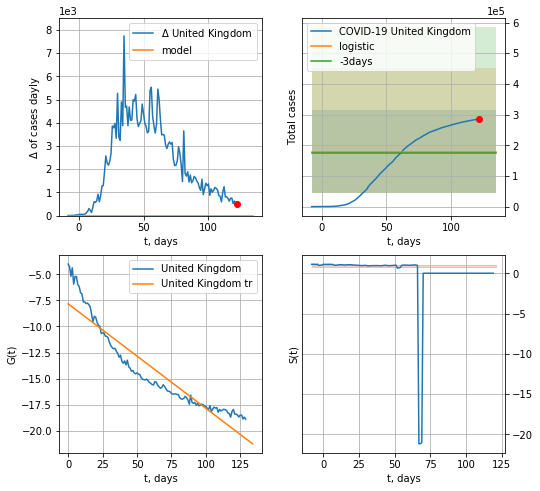

United Kingdom data at: 2020-07-05
+3 day model MAPE: 0.023621962351344495
model: logistic
coeffs:  [ 1.43536374e+05 -8.29245999e+00  2.15688459e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7547549885789918
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  179420 ± 135418
	 total death:  27797 ± 62939
trend coefficient of determination: 0.877741
 intercept: -7.835267
 slope: -0.100043


In [542]:
x = forecast('United Kingdom',dfGB[:],d1,16*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


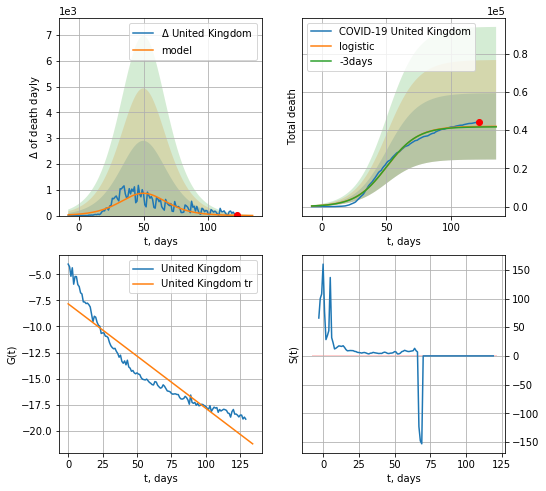

United Kingdom data at: 2020-07-05
+3 day model MAPE: 0.006289569228541947
model: logistic
coeffs:  [4.20468142e+04 8.23228011e-02 5.03397250e+01]
rational stdev:  0.4131560515064448
forecast at the end of period: +13 days
	 total death:  42007 ± 17355
trend coefficient of determination: 0.877741
 intercept: -7.835267
 slope: -0.100043


In [543]:
x = forecast('United Kingdom',dfGB[:],d1,16*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


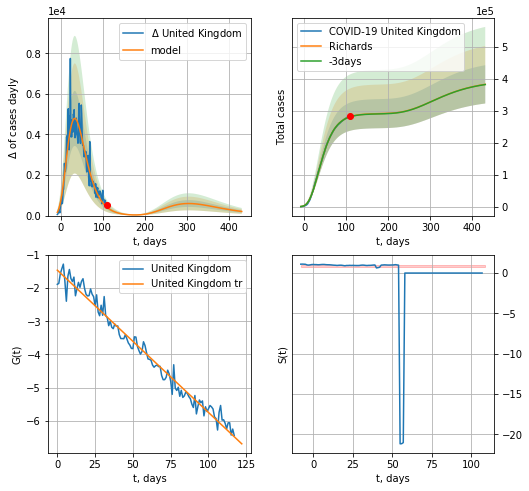

United Kingdom data at: 2020-07-05
+3 day model MAPE: 0.001725
model: Richards
coeffs: [ 2.91804581e+05  4.32072270e+00 -6.79469175e+01  1.03795589e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.156499
forecast at the end of period: +321 days
	 deltaDaycases: 202
	 total cases: 383404 ± 60002
	 total death: 59401 ± 27888
trend coefficient of determination: 0.977679
 intercept: -1.457458
 slope: -0.042970


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


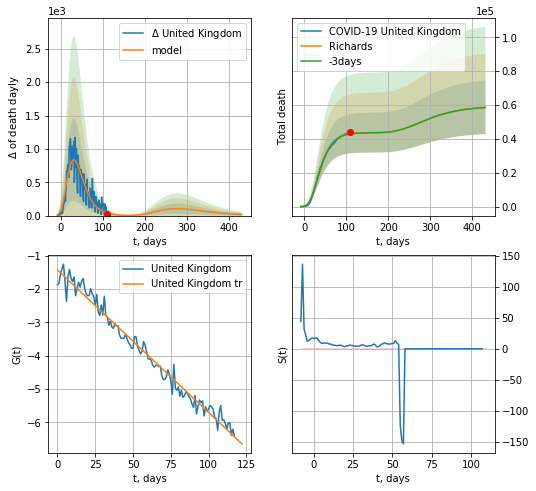

United Kingdom data at: 2020-07-05
+3 day model MAPE: 0.003873
model: Richards
coeffs: [ 4.37960517e+04  8.28905244e+00 -6.60235954e+01  6.28583464e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.269553
forecast at the end of period: +321 days
	 total death: 58689 ± 15819
trend coefficient of determination: 0.977585
 intercept: -1.421135
 slope: -0.042799


In [544]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


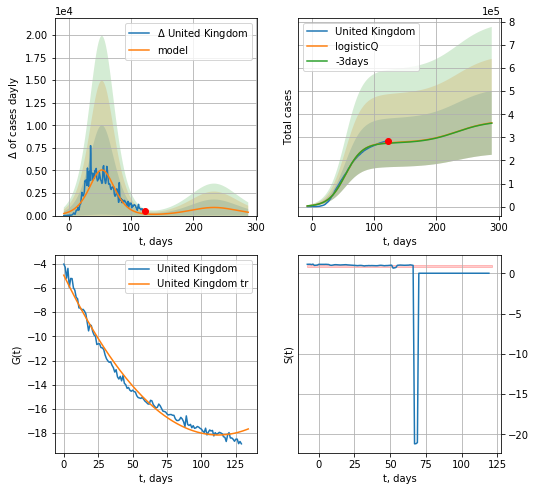

United Kingdom data at: 2020-07-05
+3 day model MAPE: 0.005293
model: logisticQ
coeffs: [ 2.76197101e+05  2.54209106e-07  5.35507682e+01 -2.87487486e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.381679
forecast at the end of period: +167 days
	 deltaDaycases: 370
	 total cases: 362804 ± 138474
	 total death: 56209 ± 64361
trend coefficient of determination: 0.986674
 intercept_: -4.945829556140794
 coeffs_: [ 0.         -0.23548843  0.00104997]


In [545]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


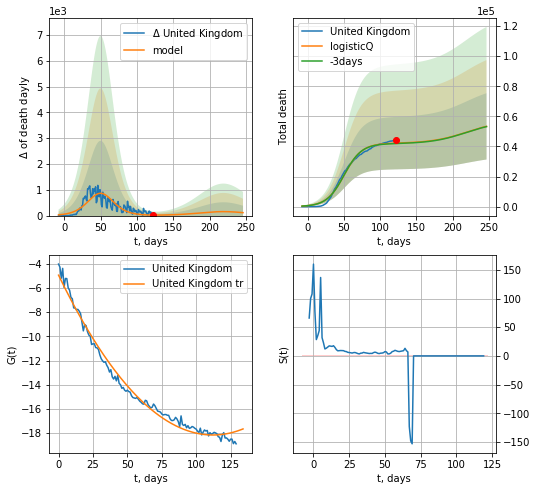

United Kingdom data at: 2020-07-05
+3 day model MAPE: 0.006363
model: logisticQ
coeffs: [ 4.20463501e+04  2.26914536e-07  5.03403900e+01 -3.62657297e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.413179
forecast at the end of period: +125 days
	 total death: 53335 ± 22037
trend coefficient of determination: 0.986674
 intercept_: -4.945829556140794
 coeffs_: [ 0.         -0.23548843  0.00104997]


In [546]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [131]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [132]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [133]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [134]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [135]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [547]:
dT

99

DK
           date    cases  active  death
125 2020-07-01  12794.0     495  606.0
126 2020-07-02  12815.0     440  606.0
127 2020-07-03  12832.0     409  606.0
128 2020-07-04  12832.3     409  606.0
129 2020-07-05  12832.6     409  606.0


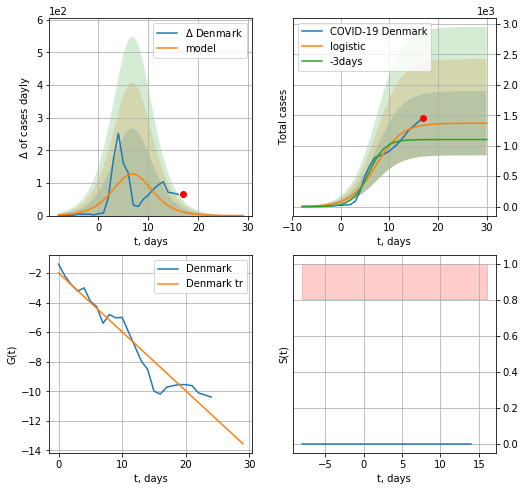

Denmark data at: 2020-07-05
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  64 ± 73
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


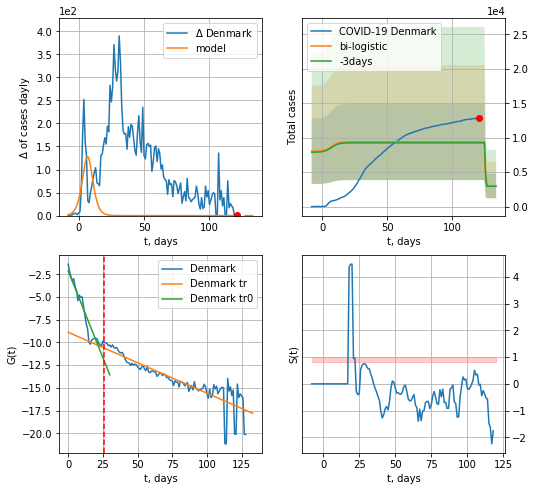

Denmark data at: 2020-07-05
+3 day model MAPE: 0.016027961058615526
model: bi-logistic
coeffs:  [6434.10930578   -9.50865125  125.74185339] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5908678235427425
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  2978 ± 1759
	 total death:  140 ± 248
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.760087
 intercept: -8.880889
 slope: -0.067022


In [549]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*16-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,16*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


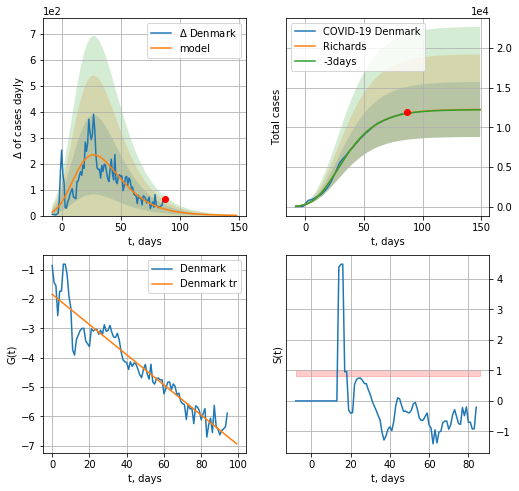

Denmark data at: 2020-07-05
+3 day model MAPE: 0.002072
model: Richards
coeffs: [ 1.22659587e+04  7.57412632e-01 -2.17374814e+01  7.08529608e-02]
rational stdev: 0.283101
forecast at the end of period: +62 days
	 deltaDaycases: 0
	 total cases: 12247 ± 3467
	 total death: 578 ± 490
trend coefficient of determination: 0.907675
 intercept: -1.842227
 slope: -0.051439


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


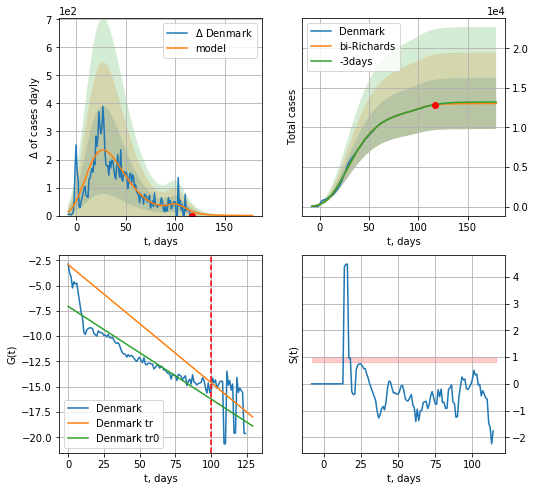

Denmark data at: 2020-07-05
+3 day model MAPE: 0.003789
model: bi-Richards
coeffs: [7.67077968e+02 1.55948378e-01 1.01451835e+02 9.46682585e-01]
rational stdev: 0.247450
forecast at the end of period: +62 days
	 deltaDaycases: 0
	 total cases: 13029 ± 3224
	 total death: 615 ± 456
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.855859
 intercept: -7.053288
 slope: -0.091733
trend coefficient of determination: 0.135915
 intercept: -2.926268
 slope: -0.116772


In [550]:
vL = 100+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,23*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


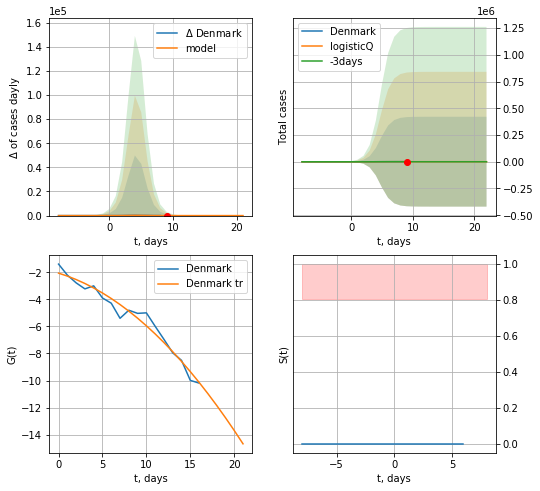

Denmark data at: 2020-07-05
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 40 ± 58472
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


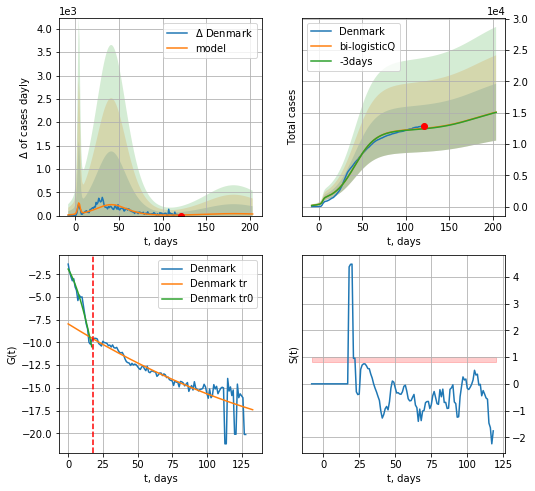

Denmark data at: 2020-07-05
+3 day model MAPE: 0.004888
model: bi-logisticQ
coeffs: [ 1.13348961e+04  1.67477468e-07  4.16799711e+01 -4.93666180e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300950
forecast at the end of period: +83 days
	 deltaDaycases: 34
	 total cases: 15075 ± 4536
	 total death: 711 ± 641
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.808751
 intercept_: -7.962839990634674
 coeffs_: [ 0.         -0.09465983  0.00017809]


In [551]:
x = forecastRRR('Denmark',dfDK[:18],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date   cases  active  death
126 2020-07-01  8896.0     507  251.0
127 2020-07-02  8902.0     513  251.0
128 2020-07-03  8921.0     532  251.0
129 2020-07-04  8926.0     537  251.0
130 2020-07-05  8930.0     541  251.0


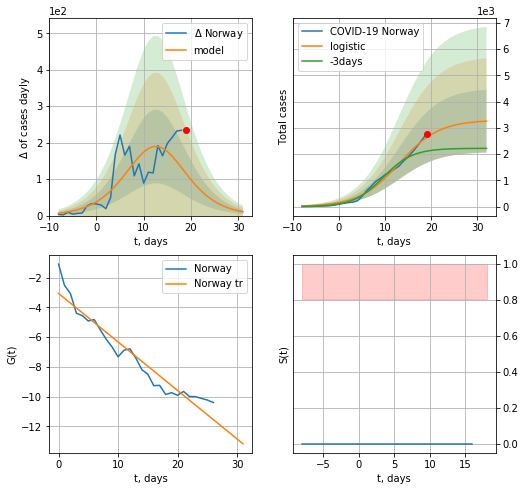

Norway data at: 2020-07-05
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +13 days
	 deltaDaycases:  10
	 total cases:  3256 ± 1196
	 total death:  91 ± 100
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


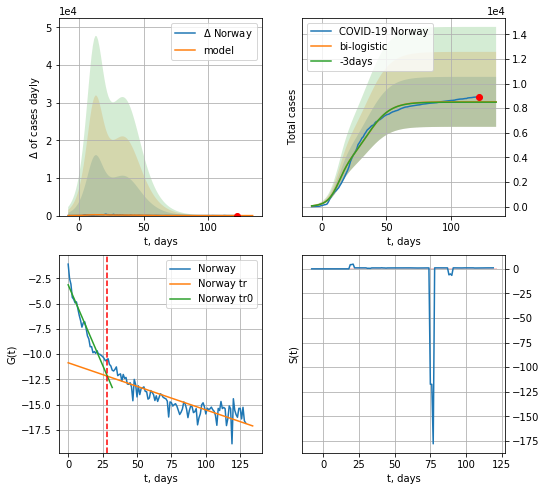

Norway data at: 2020-07-05
+3 day model MAPE: 0.0031269836463251213
model: bi-logistic
coeffs:  [5.21999846e+03 1.13046803e-01 3.56797753e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.23838835618994048
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  8517 ± 2030
	 total death:  239 ± 170
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.742388
 intercept: -10.847106
 slope: -0.046560


In [552]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*16-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,16*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

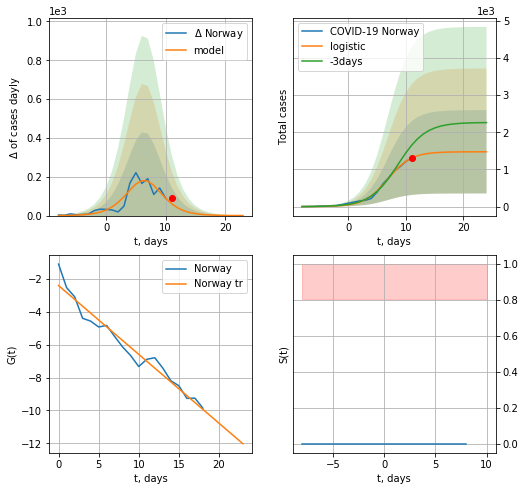

Norway data at: 2020-07-05
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1474 ± 1120
	 total death:  41 ± 93
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


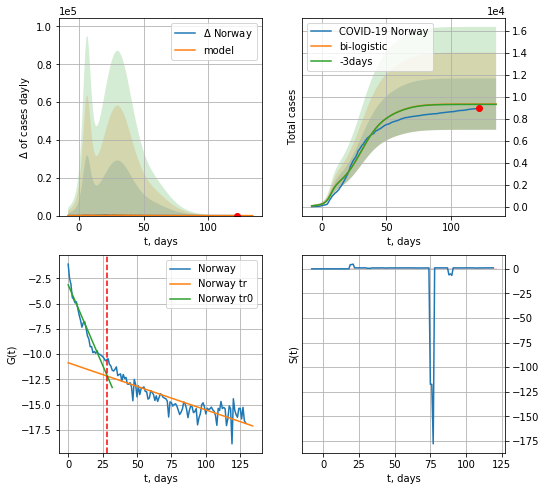

Norway data at: 2020-07-05
+3 day model MAPE: 0.003228564236261975
model: bi-logistic
coeffs:  [6.98119281e+03 1.17951915e-01 3.02180125e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.2507509743701696
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  9328 ± 2339
	 total death:  262 ± 197
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.742388
 intercept: -10.847106
 slope: -0.046560


In [553]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*16-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


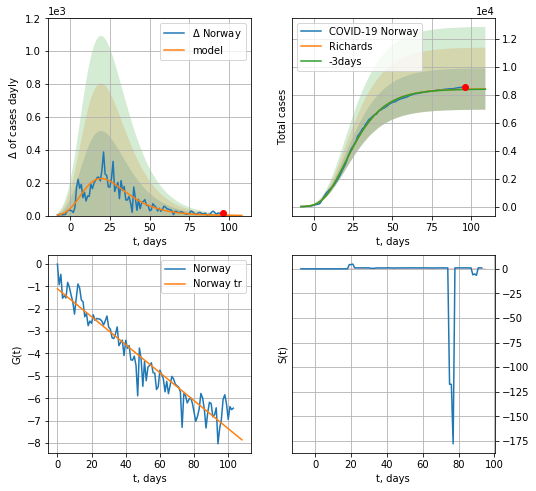

Norway data at: 2020-07-05
+3 day model MAPE: 0.002094
model: Richards
coeffs: [ 8.43838842e+03  7.14084289e+00 -4.28210769e+01  1.02282394e-02]
rational stdev: 0.175948
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 8425 ± 1482
	 total death: 236 ± 124
trend coefficient of determination: 0.922155
 intercept: -1.112087
 slope: -0.062445


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


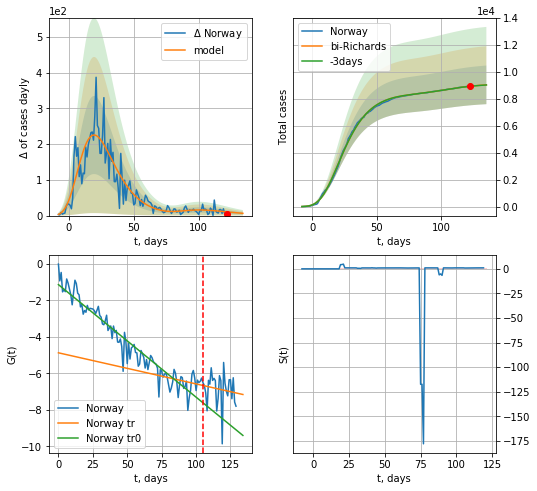

Norway data at: 2020-07-05
+3 day model MAPE: 0.000506
model: bi-Richards
coeffs: [7.23736880e+02 5.37150528e+00 1.82806335e+01 1.00284144e-02]
rational stdev: 0.158650
forecast at the end of period: +13 days
	 deltaDaycases: 6
	 total cases: 9037 ± 1433
	 total death: 254 ± 120
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.918523
 intercept: -1.135832
 slope: -0.061711
trend coefficient of determination: 0.018414
 intercept: -4.874486
 slope: -0.017058


In [554]:
vL = 105
x = forecastRR('Norway',dfNG[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


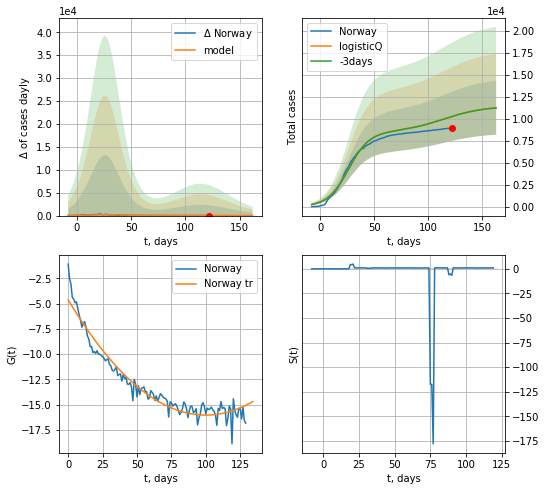

Norway data at: 2020-07-05
+3 day model MAPE: 0.001196
model: logisticQ
coeffs: [ 8.46951021e+03  2.50594003e-07  2.62313483e+01 -4.14130032e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.272425
forecast at the end of period: +41 days
	 deltaDaycases: 10
	 total cases: 11250 ± 3064
	 total death: 316 ± 258
trend coefficient of determination: 0.940976
 intercept_: -4.625576595163134
 coeffs_: [ 0.         -0.22793969  0.00114028]


In [555]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


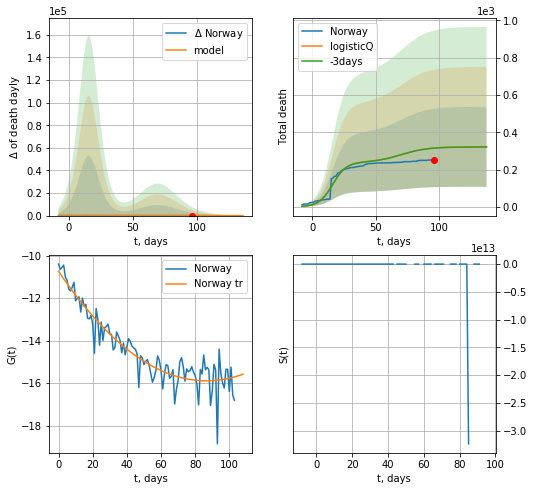

Norway data at: 2020-07-05
+3 day model MAPE: 0.002209
model: logisticQ
coeffs: [ 2.37750165e+02  1.19466688e-06  1.60221015e+01 -1.57249797e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.666574
forecast at the end of period: +41 days
	 total death: 321 ± 214
trend coefficient of determination: 0.864638
 intercept_: -10.738502645343534
 coeffs_: [ 0.         -0.11896455  0.00068653]


In [556]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date    cases  active   death
127 2020-07-01  69692.0       0  5370.0
128 2020-07-02  70639.0       0  5411.0
129 2020-07-03  71419.0       0  5420.0
130 2020-07-04  71419.3       0  5420.0
131 2020-07-05  71419.6       0  5420.0


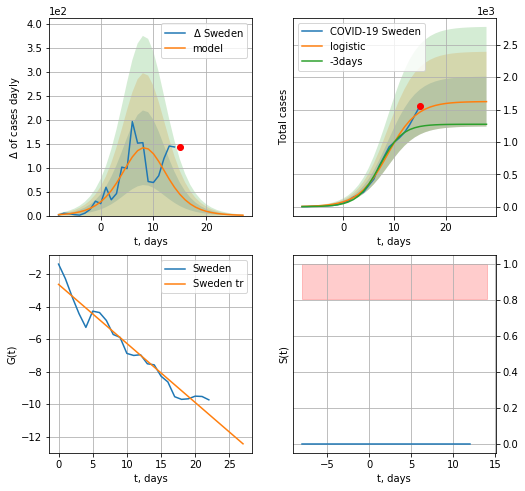

Sweden data at: 2020-07-05
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1621 ± 384
	 total death:  123 ± 87
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


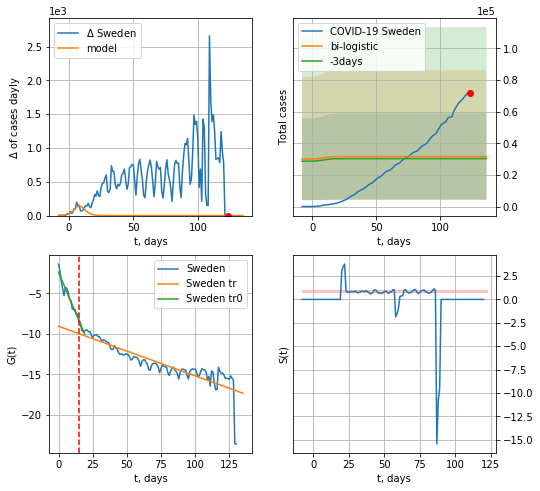

Sweden data at: 2020-07-05
+3 day model MAPE: 0.0439693340770931
model: bi-logistic
coeffs:  [ 2.39924752e+04 -9.60968896e+00  2.44518486e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8629643048492288
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  31613 ± 27281
	 total death:  2399 ± 6210
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.758955
 intercept: -9.053711
 slope: -0.061201


In [559]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[:-9-dT],d1,7*16-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
           date    cases  active   death
127 2020-07-01  69692.0       0  5370.0
128 2020-07-02  70639.0       0  5411.0
129 2020-07-03  71419.0       0  5420.0
130 2020-07-04  71419.3       0  5420.0
131 2020-07-05  71419.6       0  5420.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


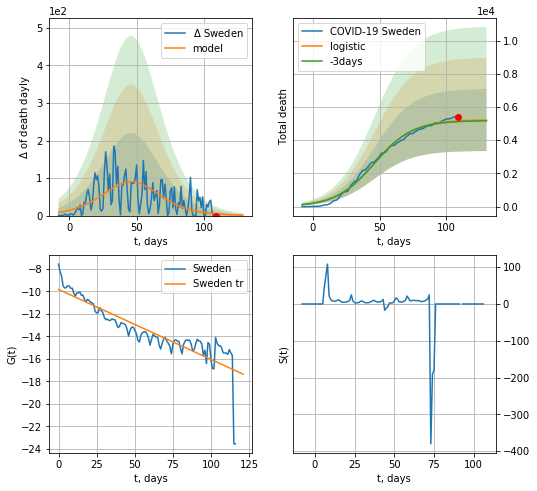

Sweden data at: 2020-07-05
+3 day model MAPE: 0.008881203433988938
model: logistic
coeffs:  [5.23249234e+03 6.90752537e-02 4.62704410e+01]
rational stdev:  0.3583095863213033
forecast at the end of period: +21 days
	 total death:  5216 ± 1869
trend coefficient of determination: 0.763542
 intercept: -9.831904
 slope: -0.062213


In [560]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


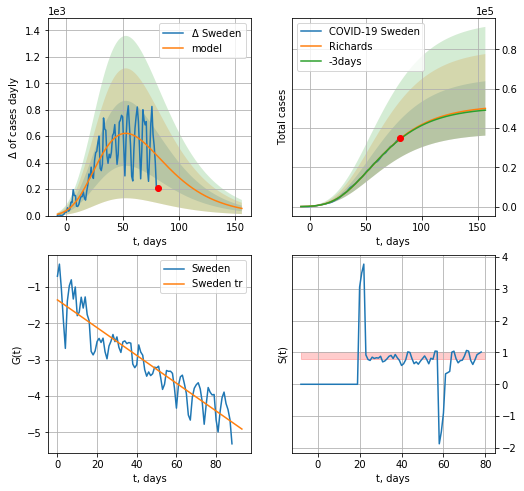

Sweden data at: 2020-07-05
+3 day model MAPE: 0.006125
model: Richards
coeffs: [ 5.15411678e+04  1.71360194e+00 -6.59040825e+01  1.93271263e-02]
rational stdev: 0.276754
forecast at the end of period: +76 days
	 deltaDaycases: 54
	 total cases: 49909 ± 13812
	 total death: 3787 ± 3144
trend coefficient of determination: 0.852284
 intercept: -1.357303
 slope: -0.038160


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


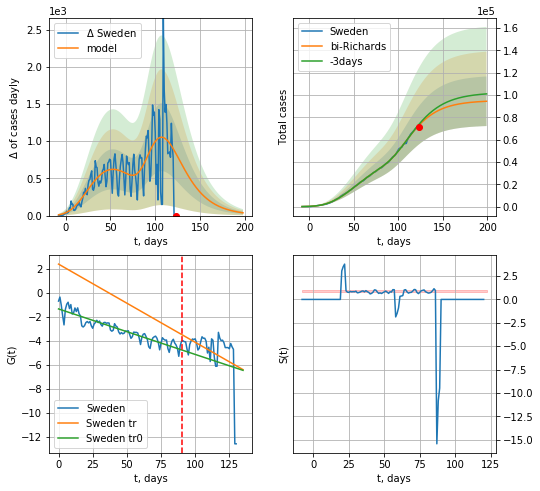

Sweden data at: 2020-07-05
+3 day model MAPE: 0.012297
model: bi-Richards
coeffs: [4.37238543e+04 2.82171909e+00 3.30122651e+01 1.83207103e-02]
rational stdev: 0.235272
forecast at the end of period: +76 days
	 deltaDaycases: 37
	 total cases: 94408 ± 22211
	 total death: 7164 ± 5056
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.853949
 intercept: -1.358999
 slope: -0.037858
trend coefficient of determination: 0.168925
 intercept: 2.371790
 slope: -0.065046


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


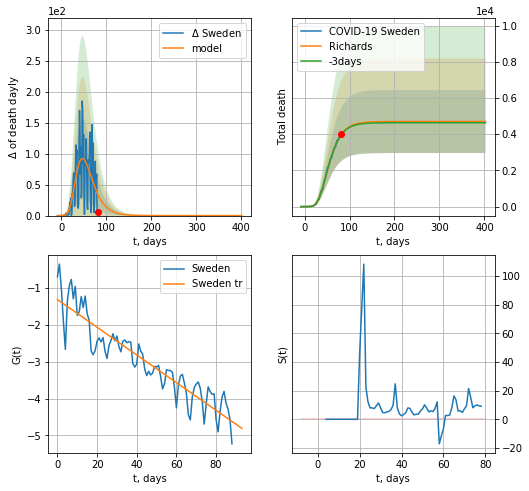

Sweden data at: 2020-07-05
+3 day model MAPE: 0.006769
model: Richards
coeffs: [ 4.70128038e+03  4.77681479e+00 -3.56595016e+01  1.12330349e-02]
rational stdev: 0.370514
forecast at the end of period: +321 days
	 total death: 4701 ± 1741
trend coefficient of determination: 0.849510
 intercept: -1.318621
 slope: -0.037513


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


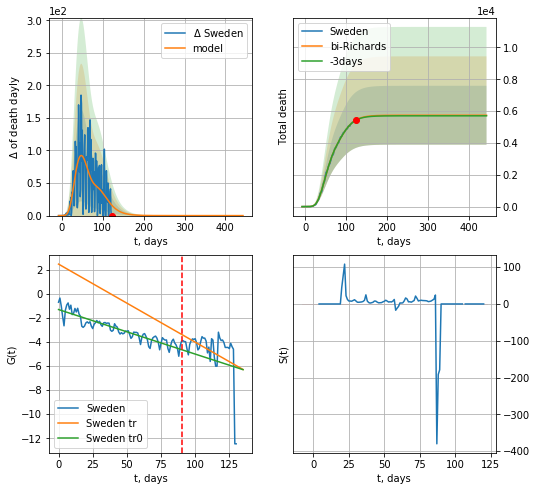

Sweden data at: 2020-07-05
+3 day model MAPE: 0.002236
model: bi-Richards
coeffs: [1.03792169e+03 7.39743311e+00 8.27335899e+00 7.38892119e-03]
rational stdev: 0.322228
forecast at the end of period: +321 days
	 total death: 5739 ± 1849
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.850267
 intercept: -1.306420
 slope: -0.036995
trend coefficient of determination: 0.168052
 intercept: 2.468821
 slope: -0.064849


In [561]:
vL = 90
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,60*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


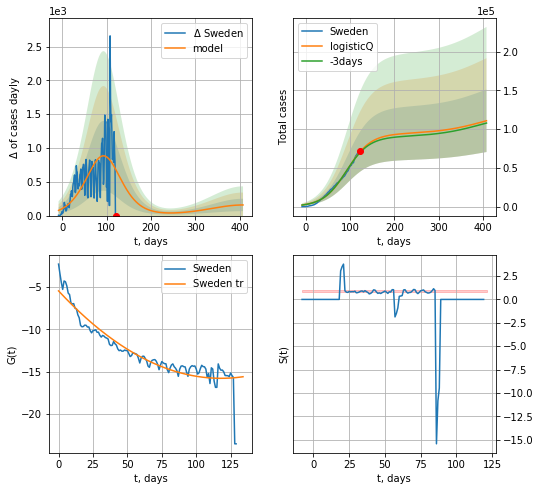

Sweden data at: 2020-07-05
+3 day model MAPE: 0.014978
model: logisticQ
coeffs: [ 9.39937230e+04  2.26538633e-07  9.33535306e+01 -1.65627363e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364309
forecast at the end of period: +286 days
	 deltaDaycases: 157
	 total cases: 110812 ± 40369
	 total death: 8409 ± 9190
trend coefficient of determination: 0.858832
 intercept_: -5.452145405805478
 coeffs_: [ 0.         -0.17529873  0.0007422 ]


In [562]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


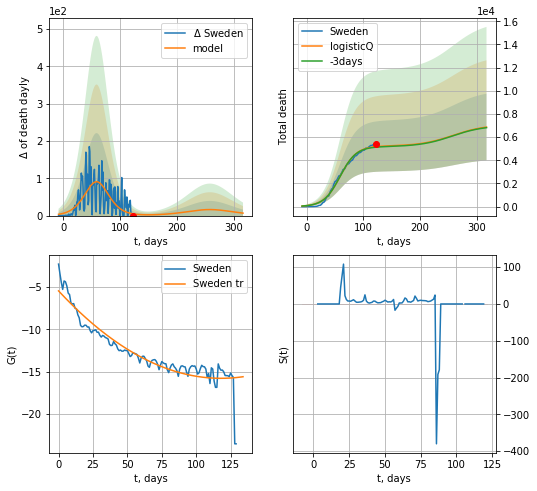

Sweden data at: 2020-07-05
+3 day model MAPE: 0.008969
model: logisticQ
coeffs: [ 5.22551786e+03  2.24726227e-07  5.92242101e+01 -3.09122495e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.419998
forecast at the end of period: +195 days
	 total death: 6866 ± 2883
trend coefficient of determination: 0.858832
 intercept_: -5.452145405805478
 coeffs_: [ 0.         -0.17529873  0.0007422 ]


In [563]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
161 2020-07-01  83537.0     416  4634.0
162 2020-07-02  83542.0     409  4634.0
163 2020-07-03  83545.0     402  4634.0
164 2020-07-04  83553.0     403  4634.0
165 2020-07-05  83557.0     405  4634.0


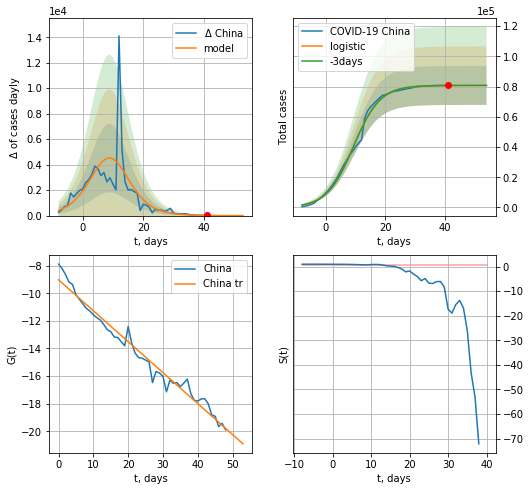

China data at: 2020-07-05
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  80806 ± 12905
	 total death:  4481 ± 2147
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


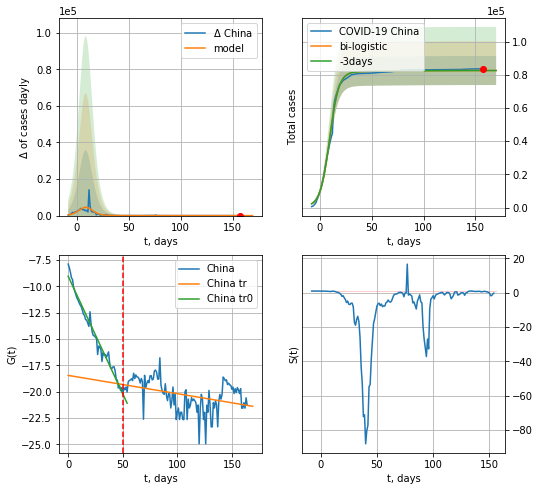

China data at: 2020-07-05
+3 day model MAPE: 0.0003744639993304758
model: bi-logistic
coeffs:  [1.79248154e+03 2.58115154e-02 1.21690125e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10596017463225577
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  82572 ± 8749
	 total death:  4579 ± 1455
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.150542
 intercept: -18.455980
 slope: -0.017356


In [565]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*16-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,16*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [566]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

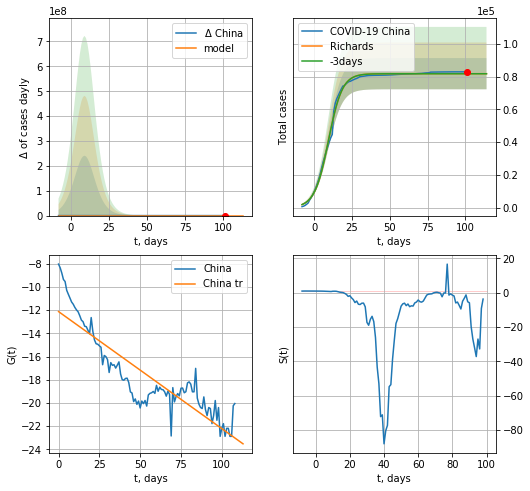

China data at: 2020-07-05
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736185e+04 2.15574478e-01 9.59539597e+00 1.02116157e+00]
rational stdev: 0.116457
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4535 ± 1584
trend coefficient of determination: 0.785239
 intercept: -12.125053
 slope: -0.100960


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


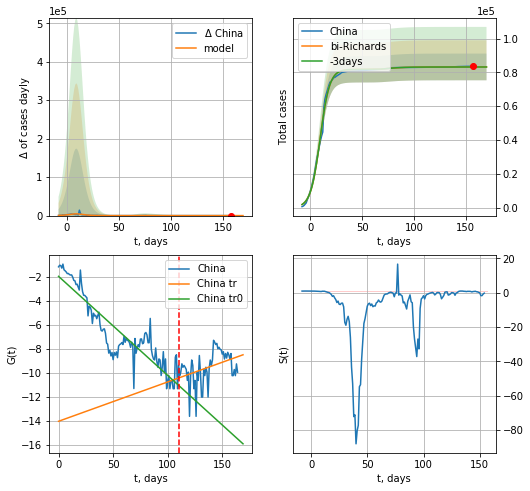

China data at: 2020-07-05
+3 day model MAPE: 0.000470
model: bi-Richards
coeffs: [1.41436396e+03 6.74104545e+01 7.82352848e+00 1.43388919e-03]
rational stdev: 0.094879
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 83187 ± 7892
	 total death: 4613 ± 1313
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.821007
 intercept: -1.967835
 slope: -0.082657
trend coefficient of determination: 0.147091
 intercept: -14.057281
 slope: 0.032818


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [568]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,16*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,16*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

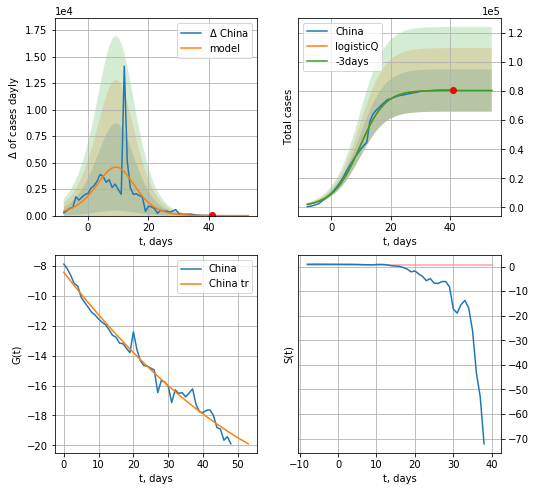

China data at: 2020-07-05
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4459 ± 2421
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


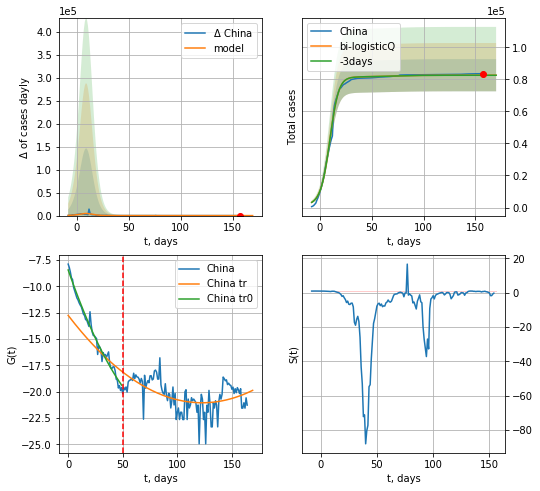

China data at: 2020-07-05
+3 day model MAPE: 0.000415
model: bi-logisticQ
coeffs: [ 2.19669681e+03  4.03596868e-04  2.47971491e+01 -4.32237950e-02]
rational stdev: 0.121684
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 82614 ± 10052
	 total death: 4581 ± 1672
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.284402
 intercept_: -12.754885790184417
 coeffs_: [ 0.         -0.13526907  0.000551  ]


In [569]:
x = forecastRRR('China',dfCN[:50],d1,7*16-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,16*7-dT,x,1.0,vL=50)

In [152]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
137 2020-07-01  12904   938.0  282.0
138 2020-07-02  12967   926.0  282.0
139 2020-07-03  13030   936.0  283.0
140 2020-07-04  13091   976.0  283.0
141 2020-07-05  13137  1005.0  284.0


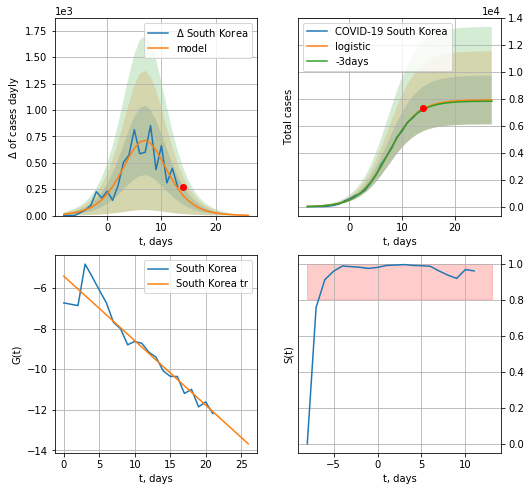

South Korea data at: 2020-07-05
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +13 days
	 deltaDaycases:  2
	 total cases:  7934 ± 1805
	 total death:  171 ± 116
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


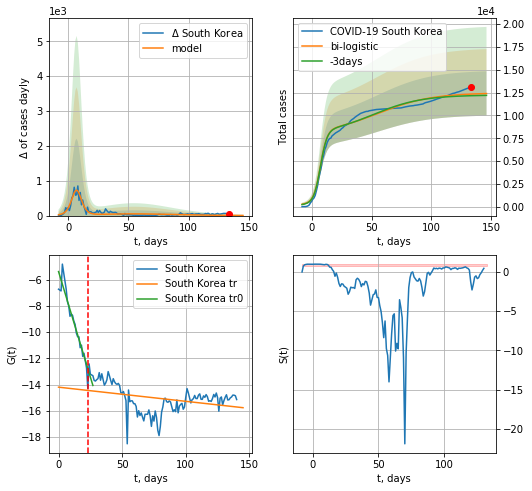

South Korea data at: 2020-07-05
+3 day model MAPE: 0.014893006857818396
model: bi-logistic
coeffs:  [4.53893097e+03 4.44679601e-02 5.49473245e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.19598647281473425
forecast at the end of period: +13 days
	 deltaDaycases:  3
	 total cases:  12402 ± 2430
	 total death:  268 ± 157
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.119732
 intercept: -14.195583
 slope: -0.010777


In [571]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*16-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,16*7-dT,x,1.0,vL=23)

In [154]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

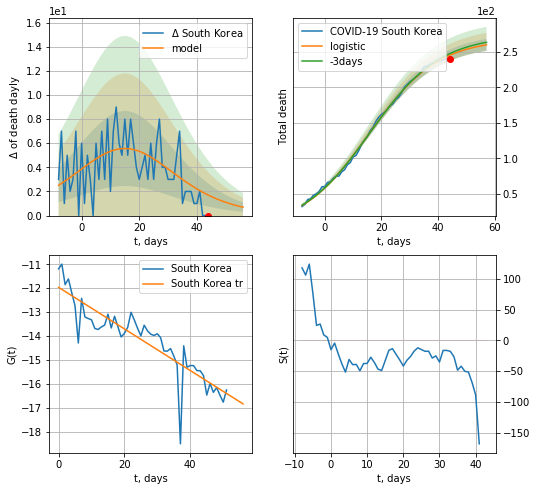

South Korea data at: 2020-07-05
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +13 days
	 total death:  260 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


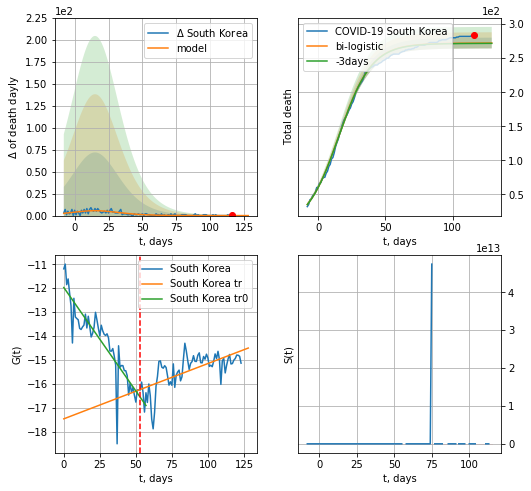

South Korea data at: 2020-07-05
+3 day model MAPE: 0.001630849026035845
model: bi-logistic
coeffs:  [ 3.99585123  0.02286845 10.49436941] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.029031456683624432
forecast at the end of period: +13 days
	 deltaDaydeath:  0
	 total death:  272 ± 7
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.446705
 intercept: -17.464550
 slope: 0.023128


In [573]:
x = forecast('South Korea',dfKR[17:70],d1,16*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,16*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


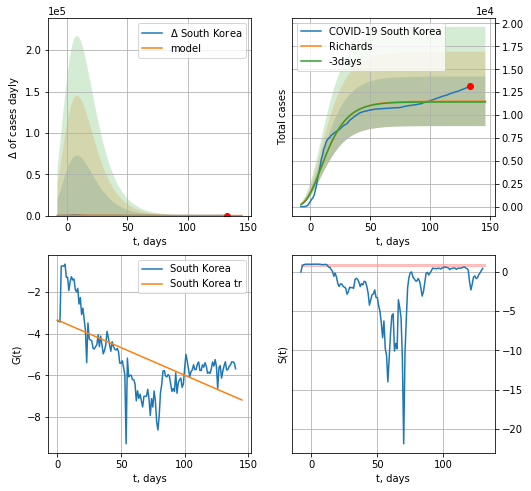

South Korea data at: 2020-07-05
+3 day model MAPE: 0.006459
model: Richards
coeffs: [ 1.15120019e+04  2.62486042e+01 -6.43924288e+01  3.02278072e-03]
rational stdev: 0.234819
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 11511 ± 2703
	 total death: 248 ± 174
trend coefficient of determination: 0.392171
 intercept: -3.350803
 slope: -0.026424


In [574]:
x = forecastRR('South Korea',dfKR[:],d1,16*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


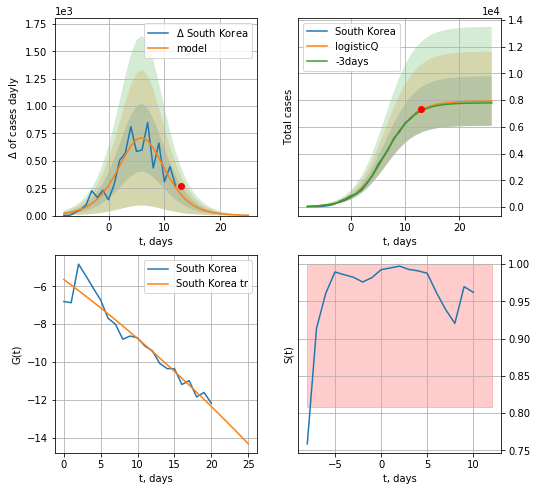

South Korea data at: 2020-07-05
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +13 days
	 deltaDaycases: 2
	 total cases: 7929 ± 1851
	 total death: 171 ± 119
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


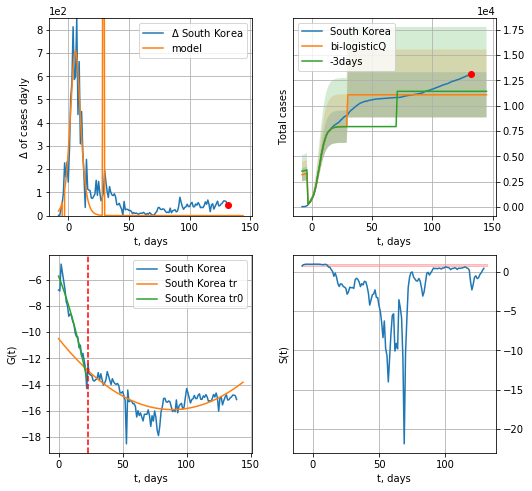

South Korea data at: 2020-07-05
+3 day model MAPE: 0.029965
model: bi-logisticQ
coeffs: [3141.34264339   12.0084372    29.52639753   -3.86004319]
rational stdev: 0.201840
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 11077 ± 2235
	 total death: 239 ± 144
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.548367
 intercept_: -10.499408595992524
 coeffs_: [ 0.         -0.12170248  0.00068514]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [575]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [158]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


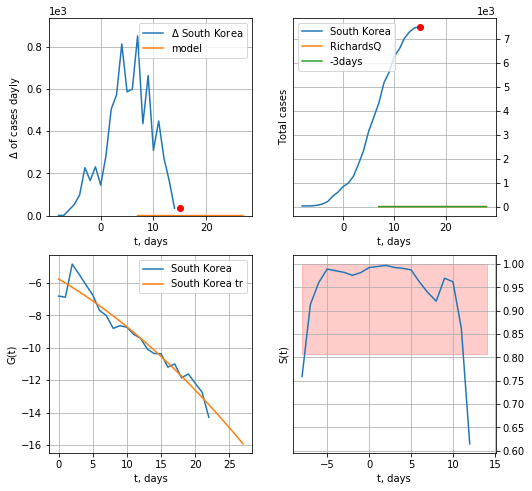

South Korea data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +13 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [577]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


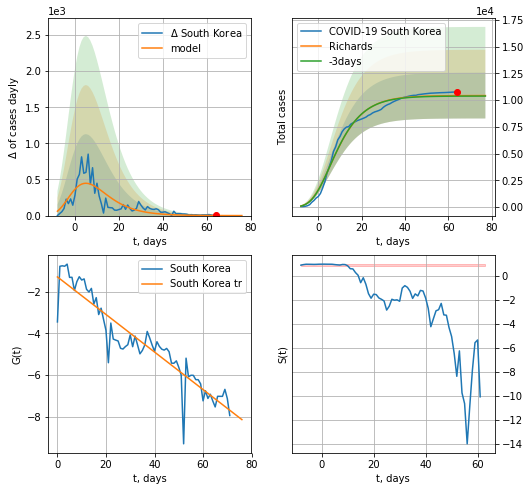

South Korea data at: 2020-07-05
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 10429 ± 2143
	 total death: 225 ± 138
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


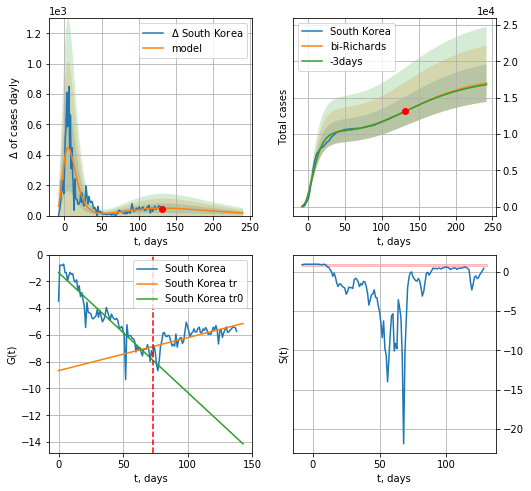

South Korea data at: 2020-07-05
+3 day model MAPE: 0.001299
model: bi-Richards
coeffs: [ 7.62316450e+03  2.05781347e+00 -1.36003670e+02  8.57102711e-03]
rational stdev: 0.151652
forecast at the end of period: +111 days
	 deltaDaycases: 17
	 total cases: 17004 ± 2578
	 total death: 367 ± 166
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865751
 intercept: -1.340300
 slope: -0.089481
trend coefficient of determination: 0.444078
 intercept: -8.668032
 slope: 0.024657


In [579]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,16*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [580]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


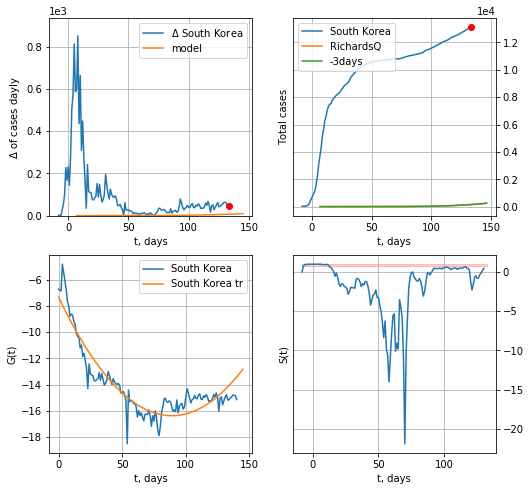

South Korea data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +13 days
	 deltaDaycases: 9


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [582]:
x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
160 2020-07-01  44310.0    5273   26.0
161 2020-07-02  44310.5    4855   26.0
162 2020-07-03  44479.0    4684   26.0
163 2020-07-04  44664.0    4521   26.0
164 2020-07-05  44983.0    4516   26.0


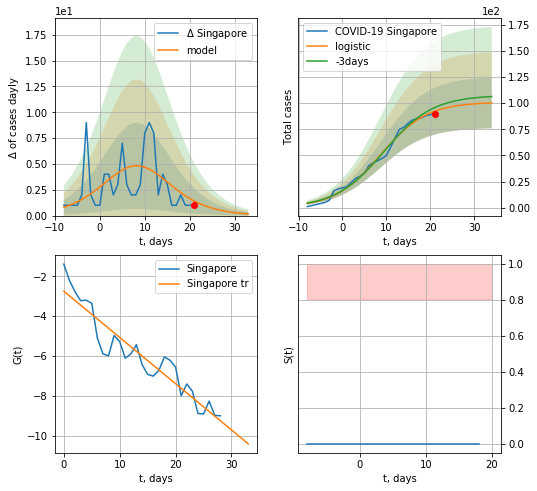

Singapore data at: 2020-07-05
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  100 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


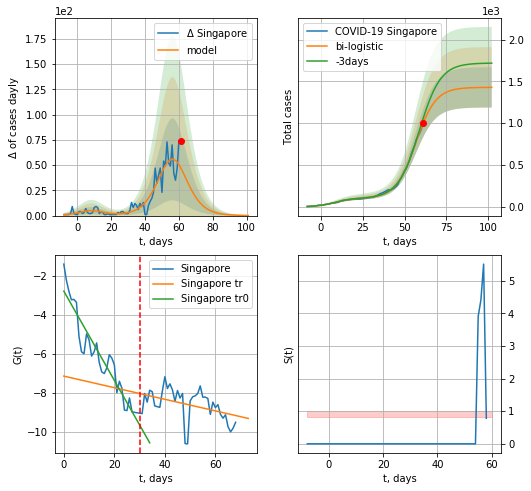

Singapore data at: 2020-07-05
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


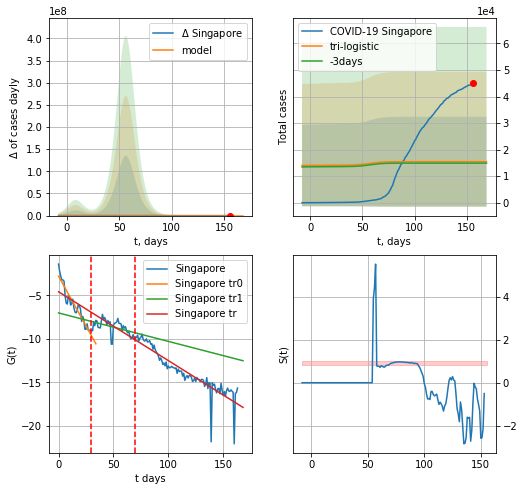

Singapore data at: 2020-07-05
+3 day model MAPE: 0.03627284202795396
model: tri-logistic
coeffs:  [ 1.40412249e+04 -9.52108805e+00  2.35448480e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  1.0941142628483234
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  15469 ± 16925
	 total death:  8 ± 26
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.814589
 intercept: -4.573132
 slope: -0.079301


In [584]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*16-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


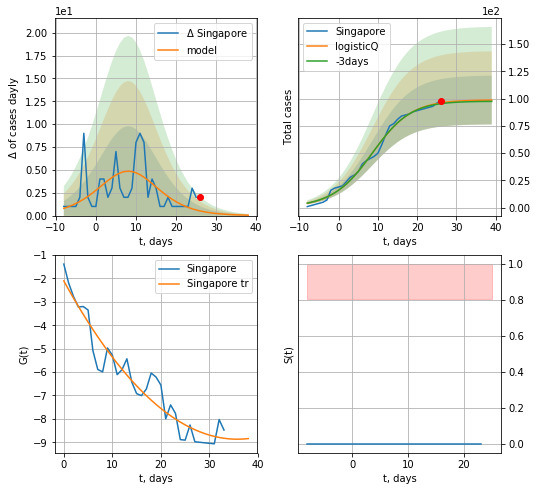

Singapore data at: 2020-07-05
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


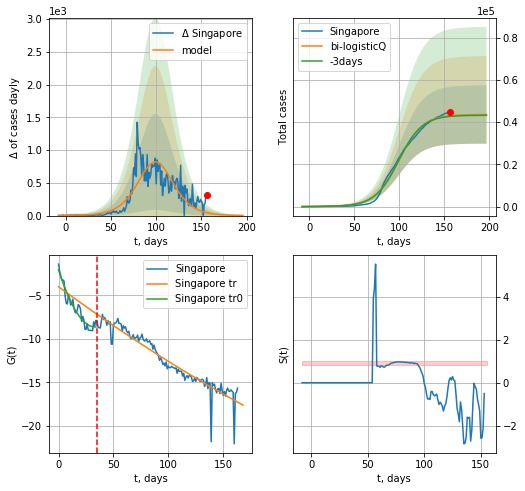

Singapore data at: 2020-07-05
+3 day model MAPE: 0.007910
model: bi-logisticQ
coeffs: [ 4.35505184e+04  2.89746075e-07  9.96019760e+01 -2.59753810e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.316995
forecast at the end of period: +41 days
	 deltaDaycases: 2
	 total cases: 43622 ± 13828
	 total death: 25 ± 23
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.903227
 intercept_: -4.002527382066766
 coeffs_: [ 0.00000000e+00 -9.27994564e-02  6.95065135e-05]


In [586]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*16-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [587]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

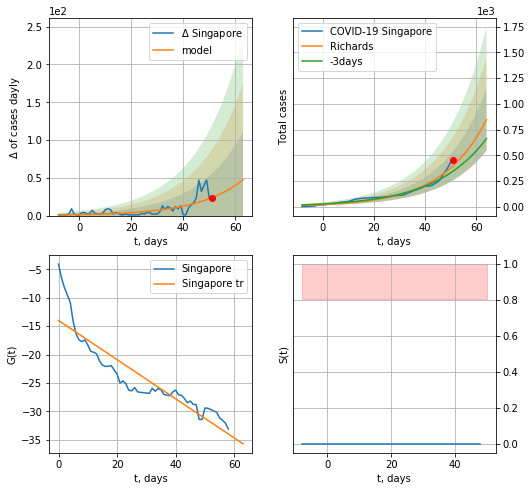

Singapore data at: 2020-07-05
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +13 days
	 deltaDaycases: 47
	 total cases: 845 ± 300
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


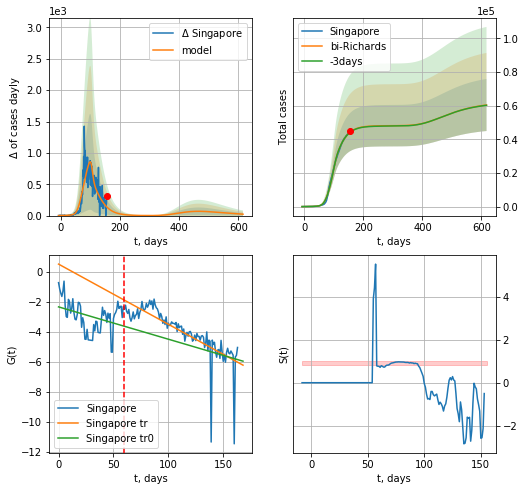

Singapore data at: 2020-07-05
+3 day model MAPE: 0.002548
model: bi-Richards
coeffs: [ 3.88377484e+04  4.89683026e+00 -2.84951692e+01  7.90574231e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.256119
forecast at the end of period: +461 days
	 deltaDaycases: 22
	 total cases: 60429 ± 15477
	 total death: 34 ± 26
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.125289
 intercept: -2.319068
 slope: -0.021617
trend coefficient of determination: 0.618532
 intercept: 0.541027
 slope: -0.040226


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


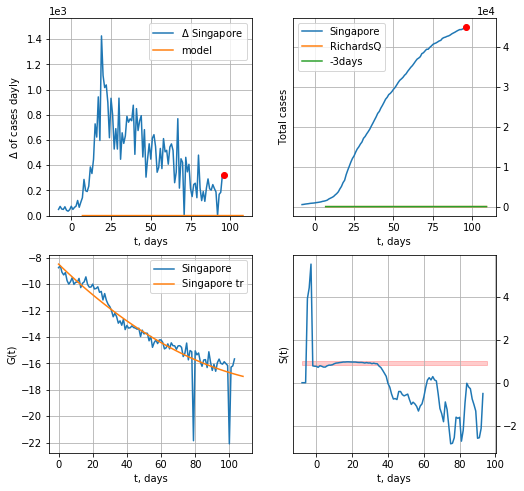

Singapore data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 9.75970661e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +13 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [590]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,16*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
111 2020-07-01  1990.0      79   69.0
112 2020-07-02  1990.5      79   69.0
113 2020-07-03  1991.0      63   69.0
114 2020-07-04  1993.0      54   69.0
115 2020-07-05  1994.0      50   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


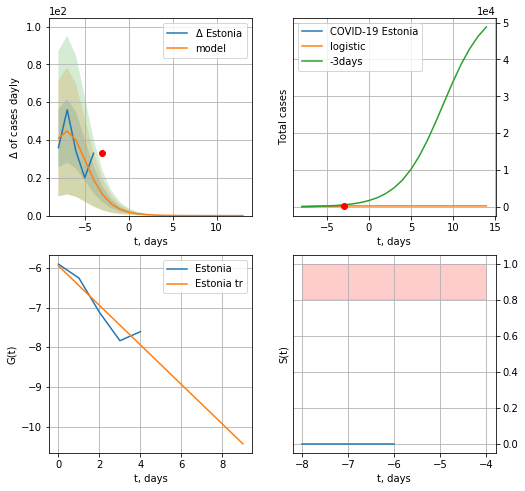

Estonia data at: 2020-07-05
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


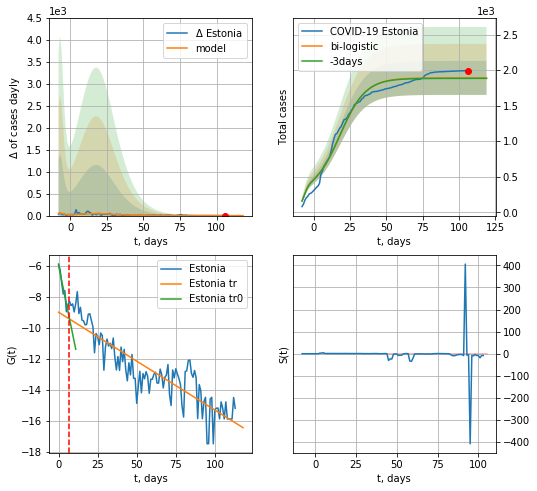

Estonia data at: 2020-07-05
+3 day model MAPE: 0.003556833311988212
model: bi-logistic
coeffs:  [1.61315524e+03 1.12147296e-01 1.81259626e+01] [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.1265008784976763
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1890 ± 239
	 total death:  65 ± 24
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.780840
 intercept: -9.004609
 slope: -0.063053


In [591]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

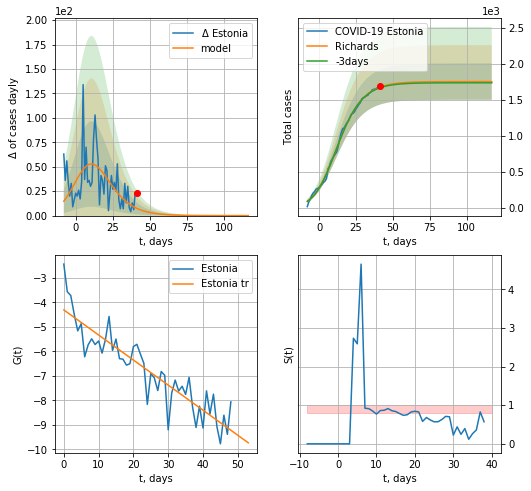

Estonia data at: 2020-07-05
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +76 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 60 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


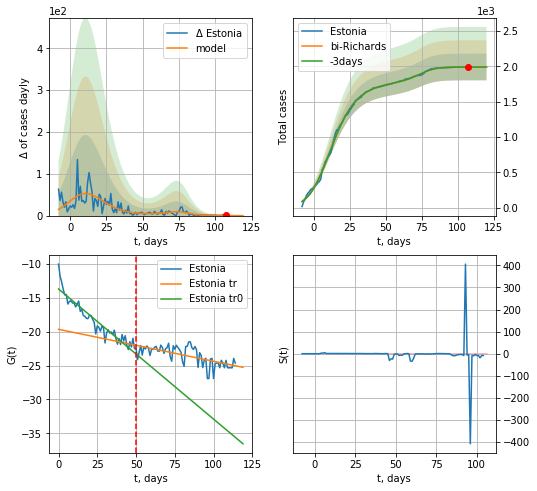

Estonia data at: 2020-07-05
+3 day model MAPE: 0.000581
model: bi-Richards
coeffs: [2.39851162e+02 9.21955242e-02 7.78191705e+01 2.24298558e+00]
rational stdev: 0.094856
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1989 ± 188
	 total death: 68 ± 19
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.888903
 intercept: -13.693468
 slope: -0.192045
trend coefficient of determination: 0.415274
 intercept: -19.648313
 slope: -0.047154


In [592]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*16-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


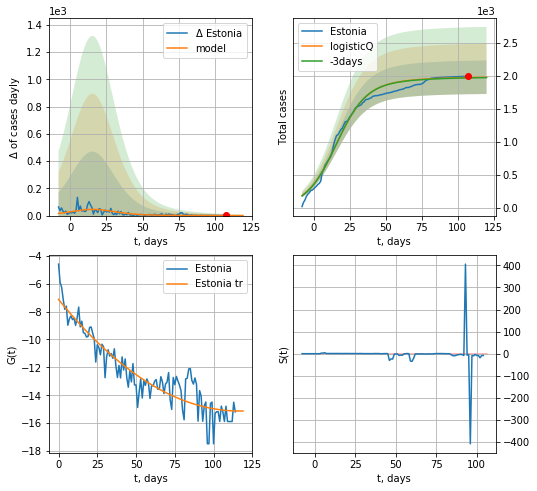

Estonia data at: 2020-07-05
+3 day model MAPE: 0.003081
model: logisticQ
coeffs: [ 1.90125934e+03  1.77736859e-07  1.57028409e+01 -5.36322386e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.128598
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1979 ± 254
	 total death: 68 ± 26
trend coefficient of determination: 0.855108
 intercept_: -7.129548304930246
 coeffs_: [ 0.         -0.13722636  0.00058817]


In [593]:
x = forecastRRR('Estonia',dfES[:],d1,7*16-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
116 2020-07-01  1121.0     117   30.0
117 2020-07-02  1122.0     104   30.0
118 2020-07-03  1122.1      95   30.0
119 2020-07-04  1123.0      93   30.0
120 2020-07-05  1127.0      97   30.0


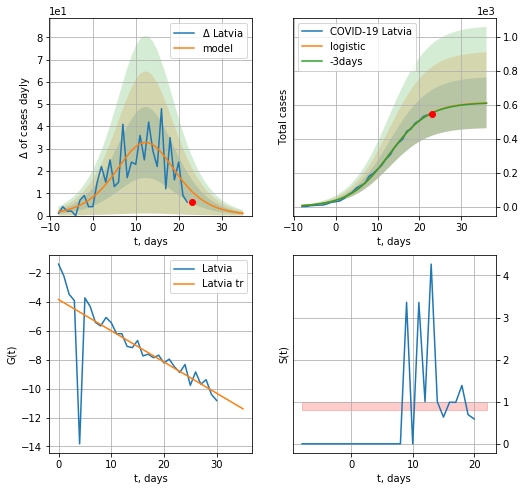

Latvia data at: 2020-07-05
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  611 ± 149
	 total death:  16 ± 11
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


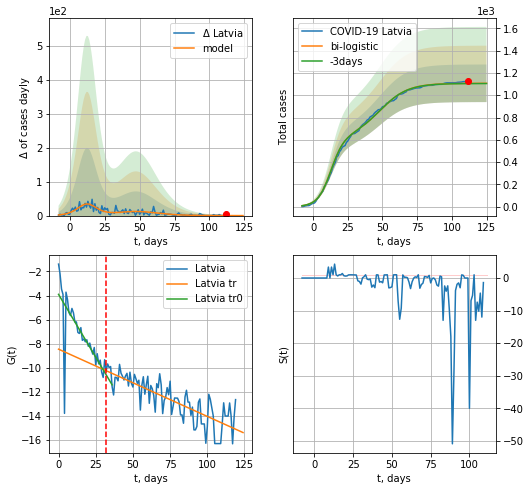

Latvia data at: 2020-07-05
+3 day model MAPE: 0.001881858768096584
model: bi-logistic
coeffs:  [4.91054043e+02 9.90283475e-02 4.80623936e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.15227010594331777
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1106 ± 168
	 total death:  29 ± 13
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.645535
 intercept: -8.468228
 slope: -0.055988


In [594]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,16*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


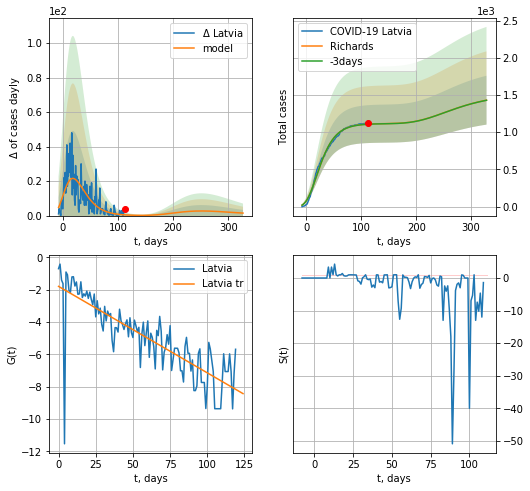

Latvia data at: 2020-07-05
+3 day model MAPE: 0.001464
model: Richards
coeffs: [ 1.11666452e+03  9.15527671e+00 -7.95824262e+01  5.74926485e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.229342
forecast at the end of period: +216 days
	 deltaDaycases: 1
	 total cases: 1430 ± 327
	 total death: 38 ± 26
trend coefficient of determination: 0.666644
 intercept: -1.792592
 slope: -0.053468


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


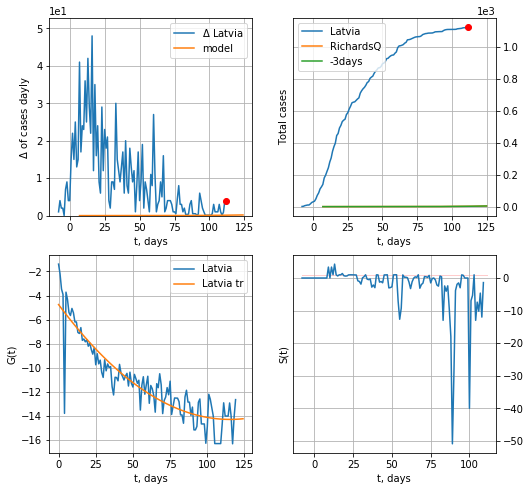

Latvia data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.14660905e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +13 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [595]:
x = forecastRR('Latvia',dfLV[:],d1,7*45-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


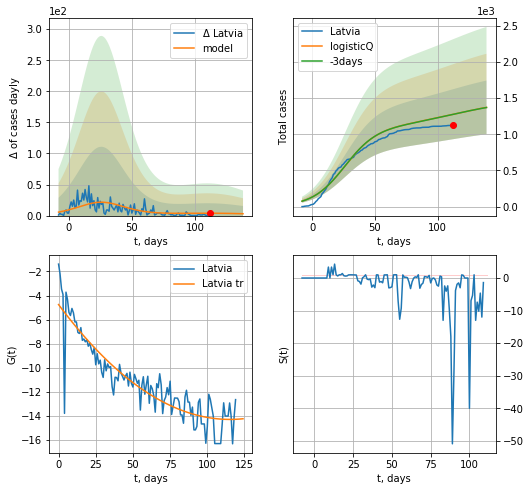

Latvia data at: 2020-07-05
+3 day model MAPE: 0.001280
model: logisticQ
coeffs: [ 1.09028352e+03  1.76462773e-07  2.60402292e+01 -4.38403232e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.270288
forecast at the end of period: +27 days
	 deltaDaycases: 3
	 total cases: 1371 ± 370
	 total death: 36 ± 29
trend coefficient of determination: 0.821145
 intercept_: -4.753487185561573
 coeffs_: [ 0.         -0.1660027   0.00072034]


In [596]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


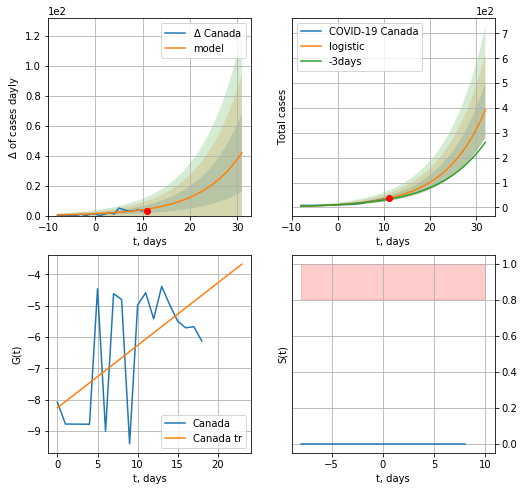

Canada data at: 2020-07-05
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  32 ± 27
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


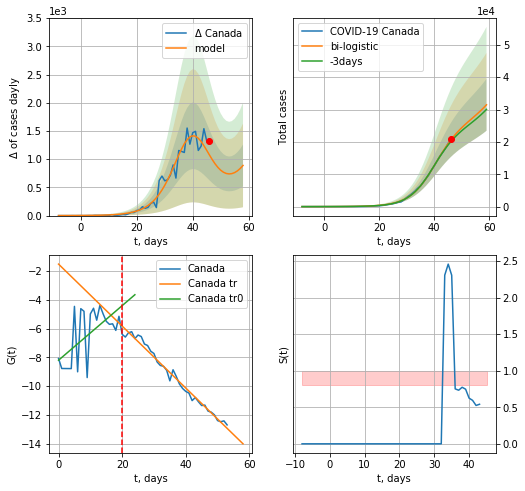

Canada data at: 2020-07-05
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +13 days
	 deltaDaycases:  888
	 total cases:  31457 ± 8019
	 total death:  2588 ± 1979
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


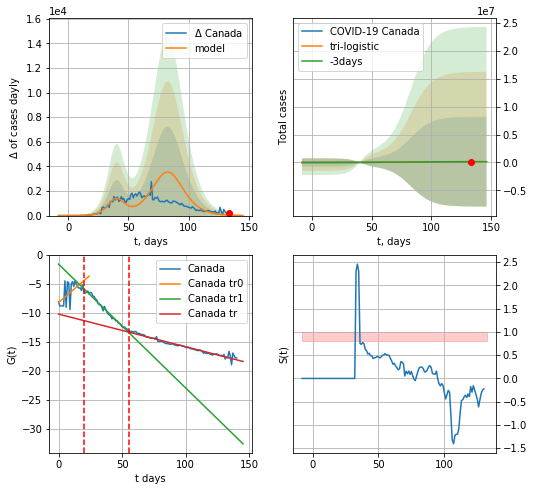

Canada data at: 2020-07-05
+3 day model MAPE: 0.004870106113387908
model: tri-logistic
coeffs:  [-1.26457723e+04  1.63438361e+00 -2.67653870e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  58.88378132368971
forecast at the end of period: +13 days
	 deltaDaycases:  11
	 total cases:  136611 ± 8044183
	 total death:  11241 ± 1985737
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.961592
 intercept: -10.183915
 slope: -0.056291


In [597]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,16*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
137 2020-07-01  104271.0   27912  8615.0
138 2020-07-02  104772.0   27783  8642.0
139 2020-07-03  105091.0   27735  8663.0
140 2020-07-04  105317.0   27653  8674.0
141 2020-07-05  105536.0   27613  8684.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


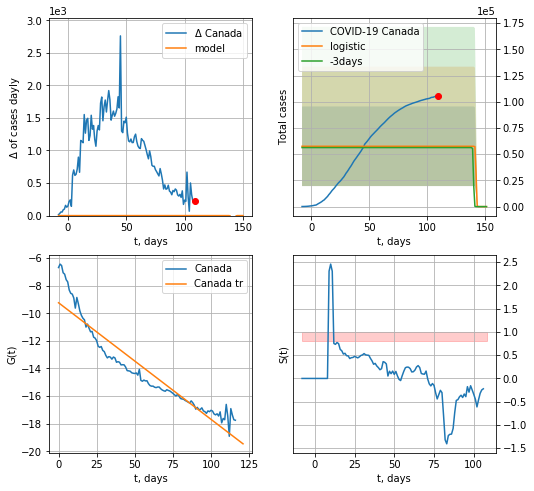

Canada data at: 2020-07-05
+3 day model MAPE: 0.02214918819454144
model: logistic
coeffs:  [ 5.75284406e+04 -4.77977034e+00  1.42039513e+02]
rational stdev:  0.65943055135524
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.893593
 intercept: -9.243030
 slope: -0.084360


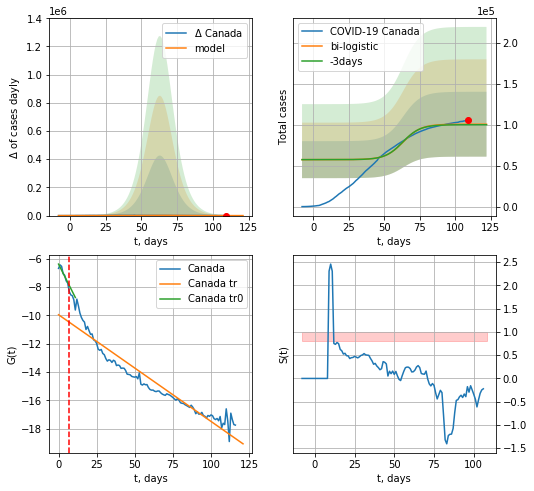

Canada data at: 2020-07-05
+3 day model MAPE: 0.006607056931809311
model: bi-logistic
coeffs:  [4.33305379e+04 1.60075438e-01 6.32804308e+01] [ 5.75284406e+04 -4.77977034e+00  1.42039513e+02]
rational stdev:  0.39326800553235053
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  100855 ± 39663
	 total death:  8298 ± 9790
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.915354
 intercept: -9.960768
 slope: -0.075237


In [598]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,16*7-dT,x,1.,vL=31-24,cases='cases')

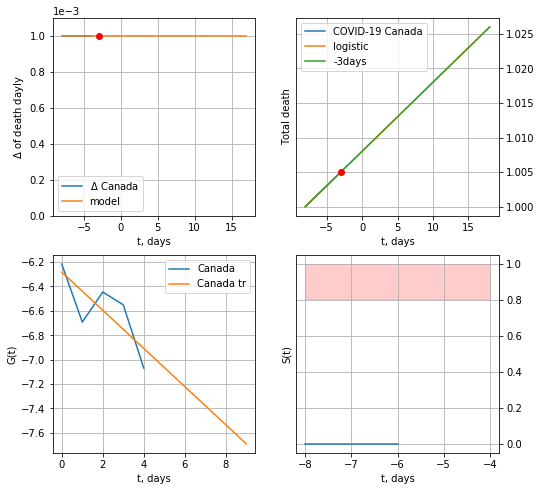

Canada data at: 2020-07-05
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


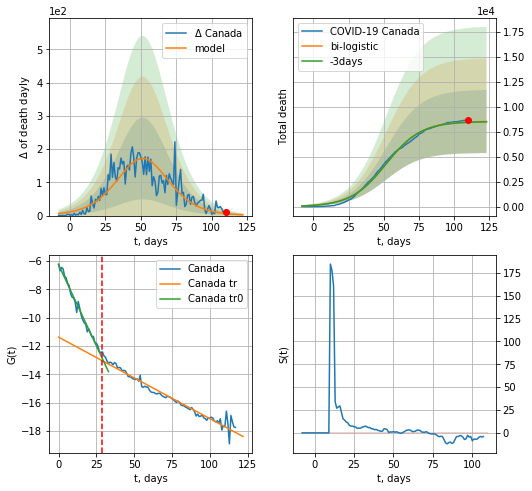

Canada data at: 2020-07-05
+3 day model MAPE: 0.003979280076334231
model: bi-logistic
coeffs:  [8.56006375e+03 8.03178626e-02 5.17293334e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.37050397794659984
forecast at the end of period: +13 days
	 deltaDaydeath:  2
	 total death:  8533 ± 3161
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.962746
 intercept: -11.373399
 slope: -0.057483


In [599]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,16*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


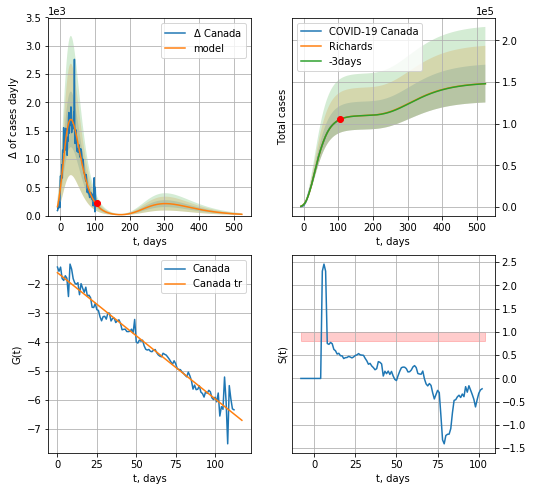

Canada data at: 2020-07-05
+3 day model MAPE: 0.000494
model: Richards
coeffs: [ 1.09920630e+05  2.76361790e+00 -6.74800811e+01  1.53206799e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.153390
forecast at the end of period: +420 days
	 deltaDaycases: 22
	 total cases: 148165 ± 22727
	 total death: 12191 ± 5609
trend coefficient of determination: 0.970010
 intercept: -1.626357
 slope: -0.043510


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


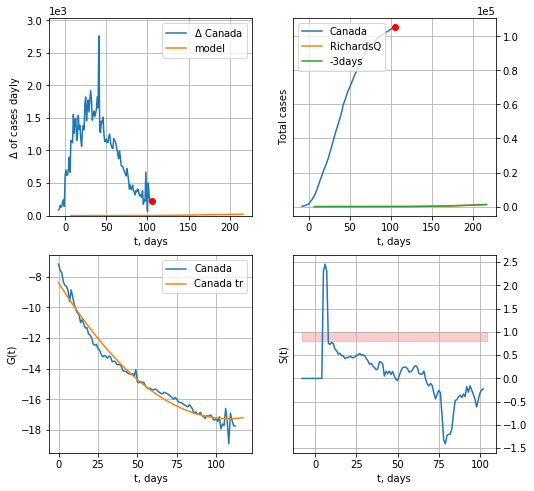

Canada data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 6.29625328e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +112 days
	 deltaDaycases: 22


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [600]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


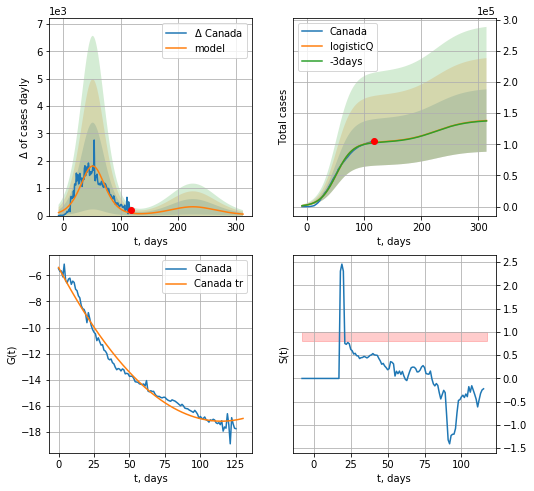

Canada data at: 2020-07-05
+3 day model MAPE: 0.004742
model: logisticQ
coeffs: [ 1.03138153e+05  3.17130353e-07  5.18888348e+01 -2.20990927e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362682
forecast at the end of period: +196 days
	 deltaDaycases: 54
	 total cases: 138088 ± 50082
	 total death: 11362 ± 12362
trend coefficient of determination: 0.982967
 intercept_: -5.400888423920151
 coeffs_: [ 0.         -0.20531311  0.0008952 ]


In [601]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
121 2020-07-01  42454   13077  1579.0
122 2020-07-02  42782   13098  1587.0
123 2020-07-03  43156   13134  1598.0
124 2020-07-04  43569   13192  1605.0
125 2020-07-05  43897   13266  1614.0


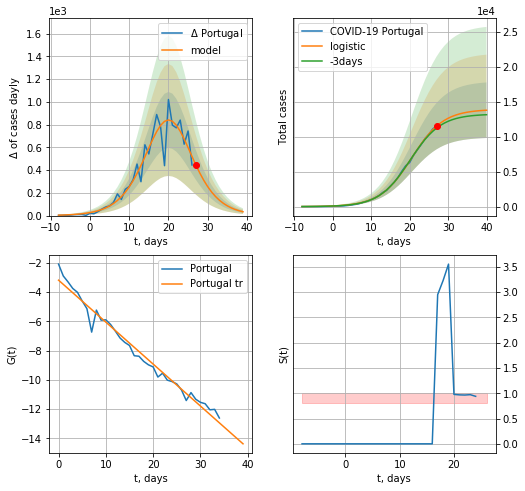

Portugal data at: 2020-07-05
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +13 days
	 deltaDaycases:  33
	 total cases:  13818 ± 3980
	 total death:  508 ± 439
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


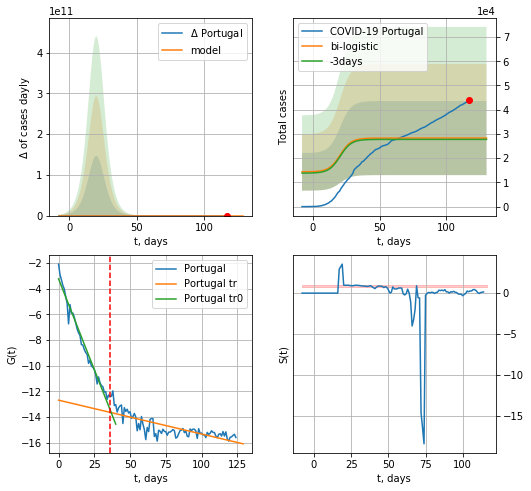

Portugal data at: 2020-07-05
+3 day model MAPE: 0.019899027792678194
model: bi-logistic
coeffs:  [ 1.14858583e+04 -4.59810307e+00  1.01652954e+03] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5404133747170717
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  28300 ± 15294
	 total death:  1040 ± 1686
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.604564
 intercept: -12.678417
 slope: -0.026367


In [602]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,16*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


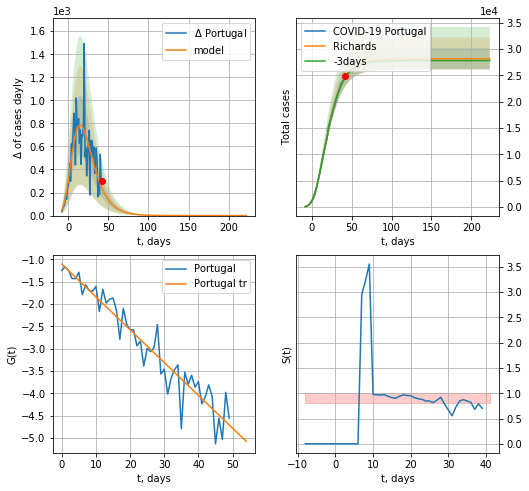

Portugal data at: 2020-07-05
+3 day model MAPE: 0.006186
model: Richards
coeffs: [ 2.81616178e+04  5.39214197e+00 -4.03941749e+01  1.41510332e-02]
rational stdev: 0.071740
forecast at the end of period: +181 days
	 deltaDaycases: 0
	 total cases: 28161 ± 2020
	 total death: 1035 ± 222
trend coefficient of determination: 0.913504
 intercept: -1.105984
 slope: -0.073555


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


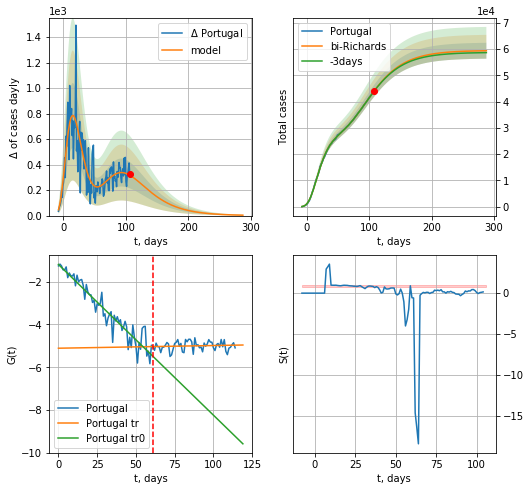

Portugal data at: 2020-07-05
+3 day model MAPE: 0.001731
model: bi-Richards
coeffs: [ 3.12604208e+04  1.56208789e+00 -4.18089289e+01  1.86776602e-02]
rational stdev: 0.050891
forecast at the end of period: +181 days
	 deltaDaycases: 3
	 total cases: 59311 ± 3018
	 total death: 2180 ± 332
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.904501
 intercept: -1.203576
 slope: -0.070341
trend coefficient of determination: 0.008533
 intercept: -5.112847
 slope: 0.001255


In [603]:
vL=61+10
x = forecastRR('Portugal',dfPT[10:vL-10],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[10:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


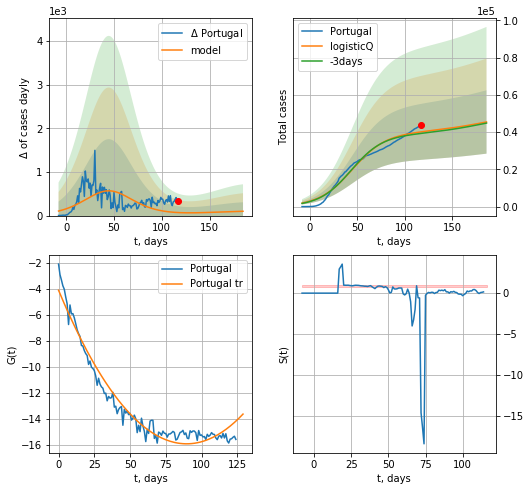

Portugal data at: 2020-07-05
+3 day model MAPE: 0.020962
model: logisticQ
coeffs: [ 3.94334951e+04  1.03586275e-07  4.48182283e+01 -5.50547409e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374288
forecast at the end of period: +69 days
	 deltaDaycases: 98
	 total cases: 45473 ± 17020
	 total death: 1671 ± 1876
trend coefficient of determination: 0.959427
 intercept_: -4.093646244160492
 coeffs_: [ 0.         -0.26415856  0.00147441]


In [604]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

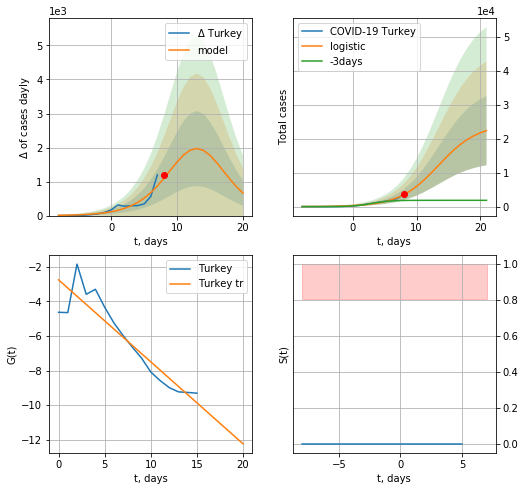

Turkey data at: 2020-07-05
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +13 days
	 deltaDaycases:  658
	 total cases:  22352 ± 10174
	 total death:  567 ± 774
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


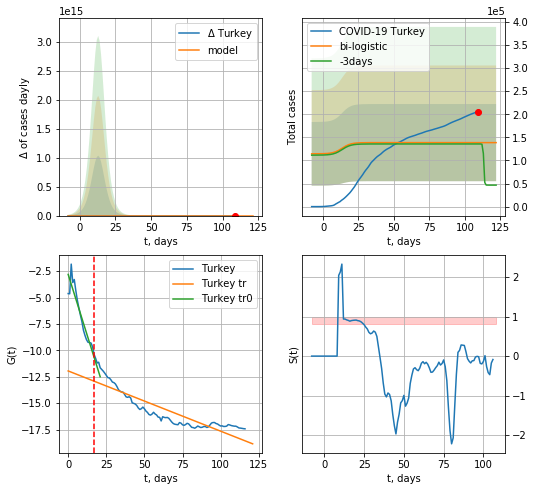

Turkey data at: 2020-07-05
+3 day model MAPE: 0.021348066856252443
model: bi-logistic
coeffs:  [ 9.14887772e+04 -3.96101507e+00  9.47741802e+02] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6027649724693758
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  138628 ± 83560
	 total death:  3520 ± 6365
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.779879
 intercept: -11.946446
 slope: -0.056991


In [605]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*16-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,16*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


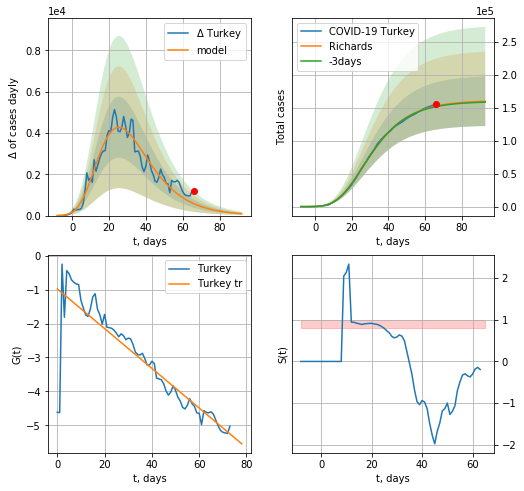

Turkey data at: 2020-07-05
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234317e+05  5.77708690e+00 -3.44331101e+01  1.25674474e-02]
rational stdev: 0.235071
forecast at the end of period: +27 days
	 deltaDaycases: 91
	 total cases: 160008 ± 37613
	 total death: 4063 ± 2865
trend coefficient of determination: 0.775257
 intercept: -0.978832
 slope: -0.058549


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


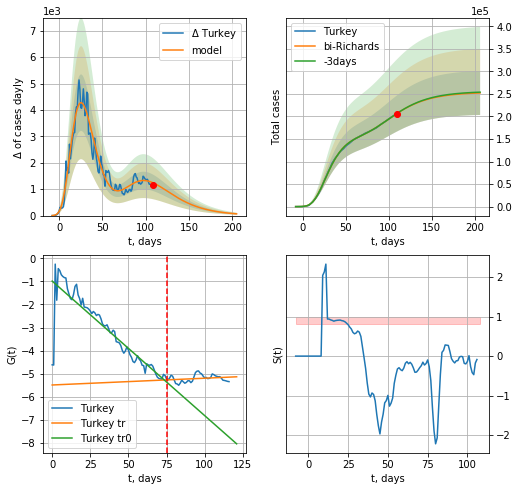

Turkey data at: 2020-07-05
+3 day model MAPE: 0.000969
model: bi-Richards
coeffs: [ 9.26671138e+04  2.95189728e+00 -1.58313200e+01  1.27255597e-02]
rational stdev: 0.193663
forecast at the end of period: +97 days
	 deltaDaycases: 65
	 total cases: 252166 ± 48835
	 total death: 6403 ± 3720
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.780630
 intercept: -0.985816
 slope: -0.058316
trend coefficient of determination: 0.053886
 intercept: -5.490717
 slope: 0.002935


In [606]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


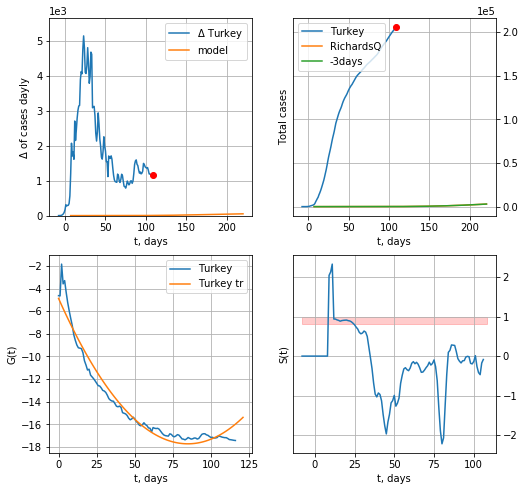

Turkey data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.40696826e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +112 days
	 deltaDaycases: 50


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [607]:
x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


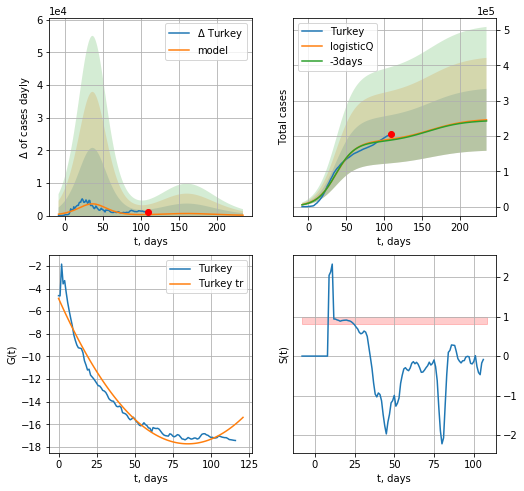

Turkey data at: 2020-07-05
+3 day model MAPE: 0.013892
model: logisticQ
coeffs: [ 1.84057887e+05  1.40371546e-07  3.68845406e+01 -5.53794027e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.356926
forecast at the end of period: +126 days
	 deltaDaycases: 127
	 total cases: 245857 ± 87752
	 total death: 6243 ± 6684
trend coefficient of determination: 0.956655
 intercept_: -4.867938620344459
 coeffs_: [ 0.         -0.30295602  0.00178584]


In [608]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [609]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.026619343389529725

In [610]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

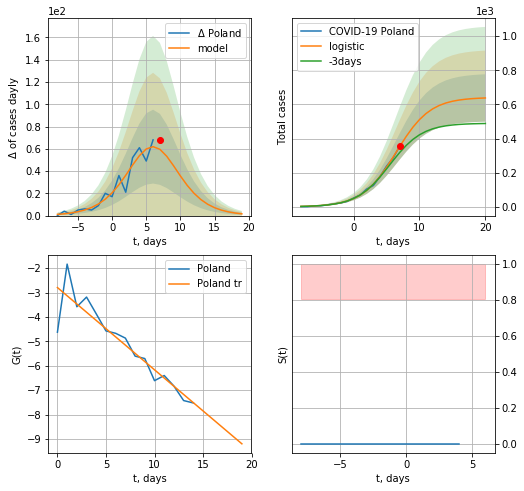

Poland data at: 2020-07-05
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  637 ± 138
	 total death:  26 ± 16
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


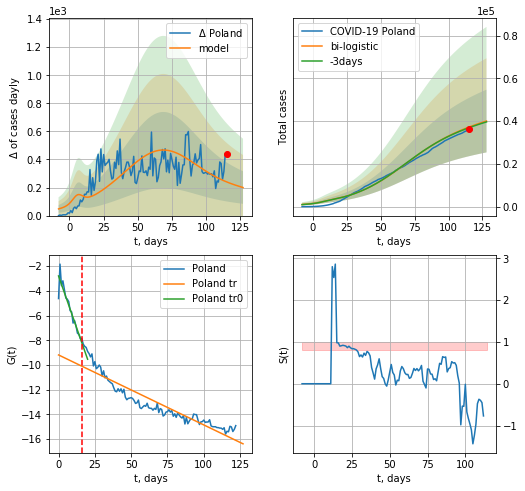

Poland data at: 2020-07-05
+3 day model MAPE: 0.008544406612281192
model: bi-logistic
coeffs:  [3.75076612e+04 4.80605355e-02 6.77083081e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36653381255804907
forecast at the end of period: +13 days
	 deltaDaycases:  199
	 total cases:  40049 ± 14679
	 total death:  1684 ± 1851
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.865060
 intercept: -9.190779
 slope: -0.056667


In [611]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*16-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,16*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


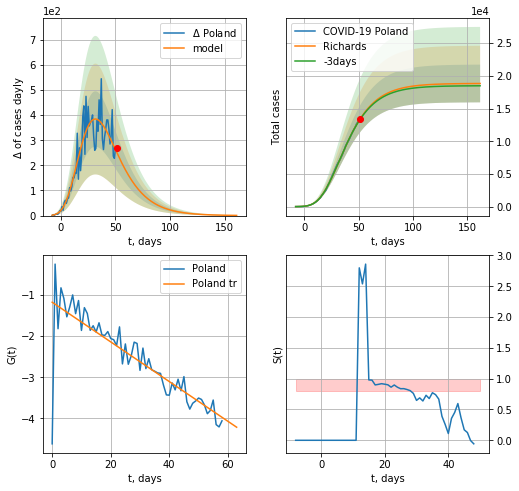

Poland data at: 2020-07-05
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418055e+04  3.45583442e+00 -4.15713344e+01  1.61921023e-02]
rational stdev: 0.153201
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 18828 ± 2884
	 total death: 792 ± 364
trend coefficient of determination: 0.708781
 intercept: -1.177313
 slope: -0.048172


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


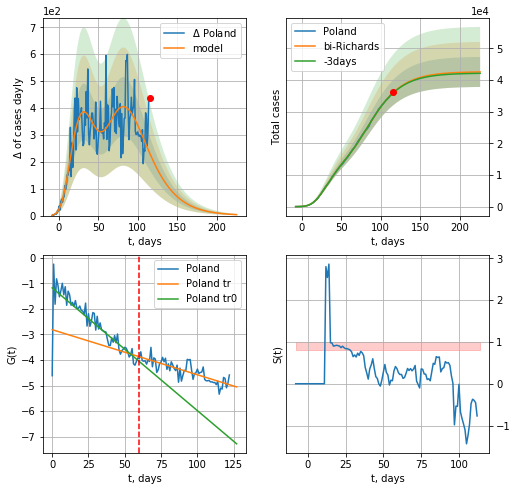

Poland data at: 2020-07-05
+3 day model MAPE: 0.002982
model: bi-Richards
coeffs: [ 2.37932871e+04  2.49415170e+00 -1.37976501e+01  1.63075291e-02]
rational stdev: 0.111451
forecast at the end of period: +111 days
	 deltaDaycases: 3
	 total cases: 42550 ± 4742
	 total death: 1790 ± 598
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.717698
 intercept: -1.180974
 slope: -0.048018
trend coefficient of determination: 0.664902
 intercept: -2.815346
 slope: -0.017639


In [612]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


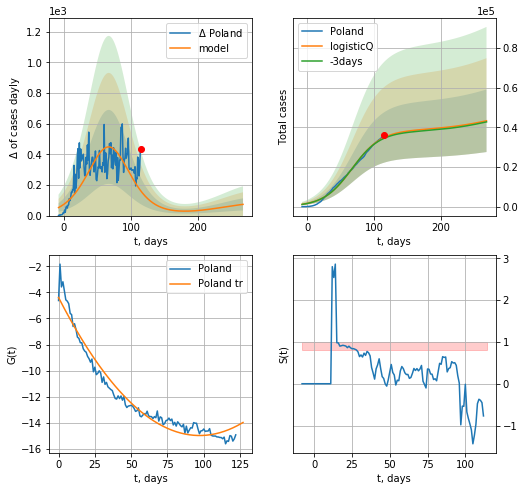

Poland data at: 2020-07-05
+3 day model MAPE: 0.011985
model: logisticQ
coeffs: [ 3.84107326e+04  2.46606390e-07  6.71609372e+01 -1.88708943e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364380
forecast at the end of period: +153 days
	 deltaDaycases: 73
	 total cases: 43293 ± 15775
	 total death: 1821 ± 1990
trend coefficient of determination: 0.958840
 intercept_: -4.392153211224382
 coeffs_: [ 0.         -0.21771516  0.00112083]


In [613]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
130 2020-07-01  26257.0    8483  322.0
131 2020-07-02  27542.0    9618  325.0
132 2020-07-03  28055.0   10060  326.0
133 2020-07-04  29170.0   11024  330.0
134 2020-07-05  30162.0   11856  332.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


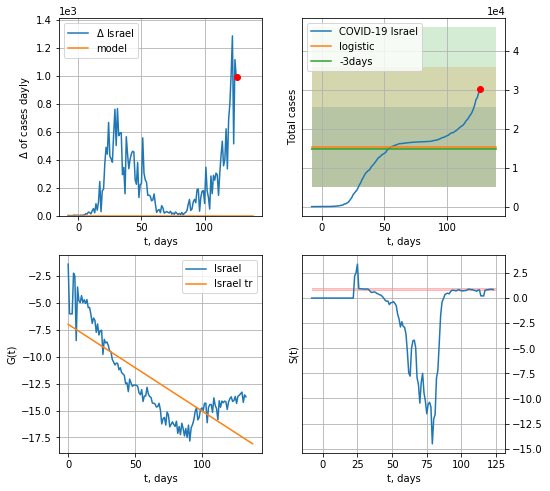

Israel data at: 2020-07-05
+3 day model MAPE: 0.032347332474555006
model: logistic
coeffs:  [ 1.22458376e+04 -5.24679982e+00  1.44247379e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.673316737319814
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  15307 ± 10306
	 total death:  168 ± 339
trend coefficient of determination: 0.637207
 intercept: -6.983608
 slope: -0.080537


In [615]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


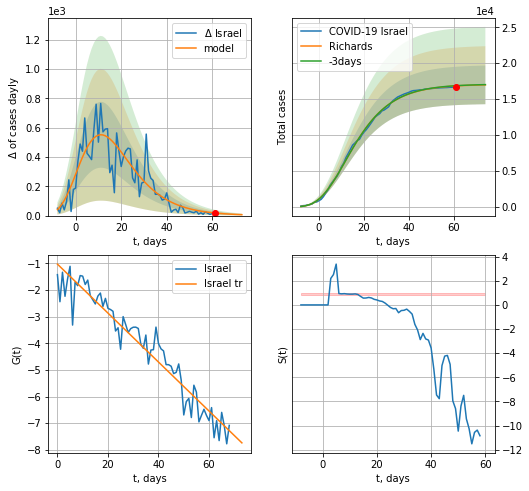

Israel data at: 2020-07-05
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +13 days
	 deltaDaycases: 6
	 total cases: 16983 ± 2686
	 total death: 186 ± 88
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


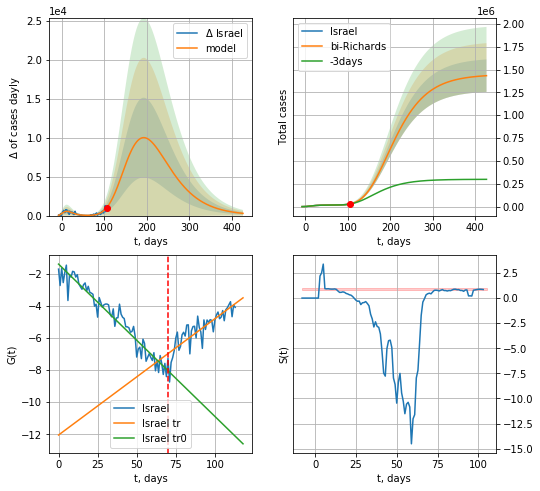

Israel data at: 2020-07-05
+3 day model MAPE: 0.032649
model: bi-Richards
coeffs: [1.42984097e+06 3.05294563e-01 5.29432601e+01 6.42451491e-02]
rational stdev: 0.124170
forecast at the end of period: +321 days
	 deltaDaycases: 283
	 total cases: 1432476 ± 177870
	 total death: 15767 ± 5873
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.935699
 intercept: -1.374852
 slope: -0.095109
trend coefficient of determination: 0.722878
 intercept: -12.049121
 slope: 0.072610


In [616]:
x = forecastRR('Israel',dfIS[20:90],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


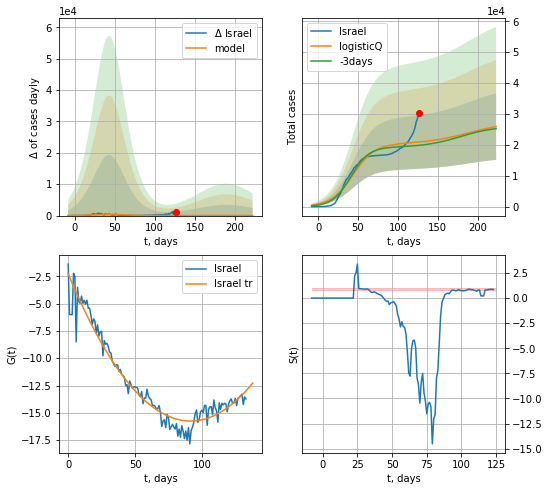

Israel data at: 2020-07-05
+3 day model MAPE: 0.054025
model: logisticQ
coeffs: [ 2.03258790e+04  7.09513498e-08  4.34609928e+01 -1.03702707e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.414992
forecast at the end of period: +97 days
	 deltaDaycases: 46
	 total cases: 25912 ± 10753
	 total death: 285 ± 354
trend coefficient of determination: 0.941466
 intercept_: -2.277224429136046
 coeffs_: [ 0.        -0.2944664  0.0016085]


In [617]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


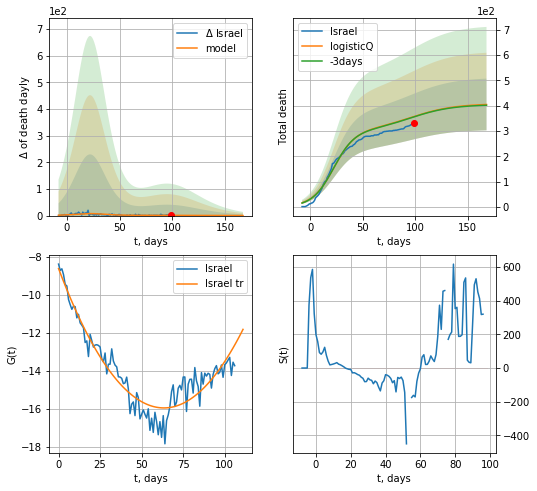

Israel data at: 2020-07-05
+3 day model MAPE: 0.003497
model: logisticQ
coeffs: [ 3.01142072e+02  2.48839978e-07  2.21917815e+01 -3.90801731e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252587
forecast at the end of period: +69 days
	 total death: 404 ± 102
trend coefficient of determination: 0.892818
 intercept_: -8.6186665065018
 coeffs_: [ 0.         -0.23129907  0.00182409]


In [618]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


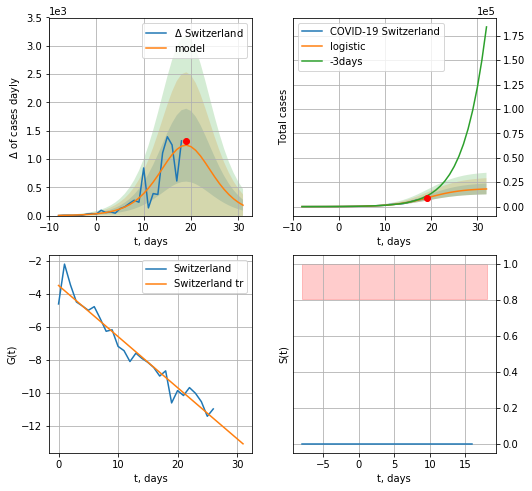

Switzerland data at: 2020-07-05
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +13 days
	 deltaDaycases:  183
	 total cases:  18076 ± 5532
	 total death:  1100 ± 1009
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


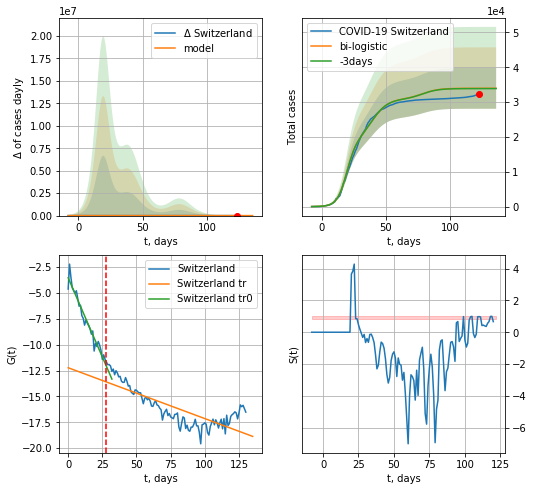

Switzerland data at: 2020-07-05
+3 day model MAPE: 0.002576977407622205
model: bi-logistic
coeffs:  [1.22145219e+04 1.60942943e-01 3.94022071e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.1728606132283394
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  33973 ± 5872
	 total death:  2068 ± 1072
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.626846
 intercept: -12.226918
 slope: -0.049115


In [619]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*16-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*16-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


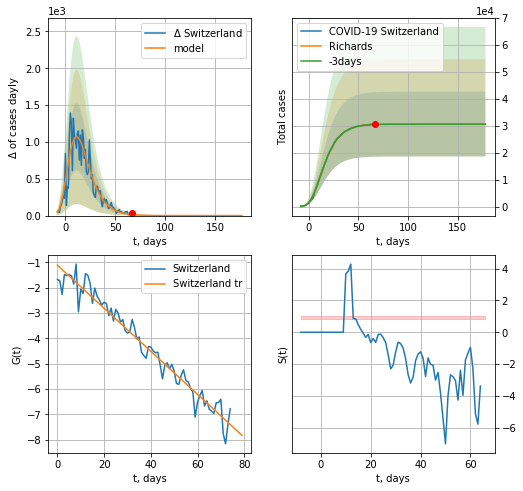

Switzerland data at: 2020-07-05
+3 day model MAPE: 0.000828
model: Richards
coeffs: [ 3.06407782e+04  7.51555694e+00 -3.39977032e+01  1.27179279e-02]
rational stdev: 0.391779
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 30640 ± 12004
	 total death: 1865 ± 2192
trend coefficient of determination: 0.957486
 intercept: -1.108794
 slope: -0.084964


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


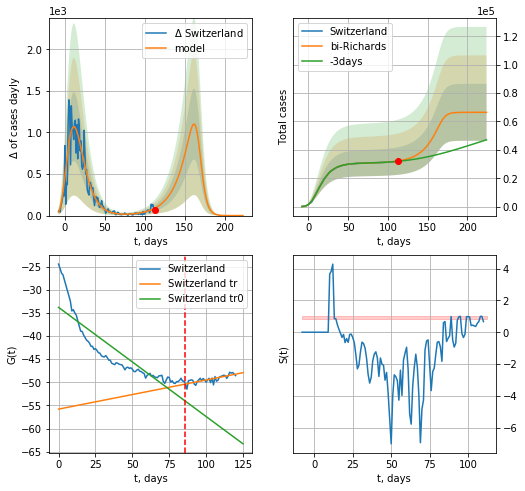

Switzerland data at: 2020-07-05
+3 day model MAPE: 0.008218
model: bi-Richards
coeffs: [3.58048681e+04 5.70227229e-02 1.68170967e+02 4.08547795e+00]
rational stdev: 0.301761
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 66445 ± 20050
	 total death: 4046 ± 3662
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.777093
 intercept: -33.792210
 slope: -0.235965
trend coefficient of determination: 0.603065
 intercept: -55.787783
 slope: 0.062983


In [620]:
iL = 10
vL = 86 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


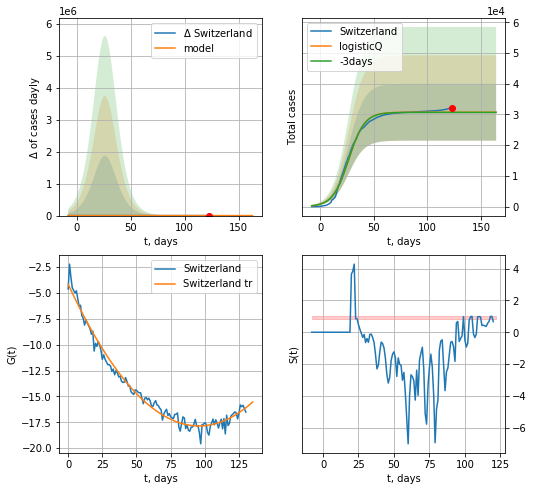

Switzerland data at: 2020-07-05
+3 day model MAPE: 0.002181
model: logisticQ
coeffs: [ 3.07496001e+04  5.05474414e-07  2.65168003e+01 -2.68534049e+05]
rational stdev: 0.301003
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 30749 ± 9255
	 total death: 1872 ± 1690
trend coefficient of determination: 0.980818
 intercept_: -4.1533593041383305
 coeffs_: [ 0.         -0.28624609  0.00149546]


In [621]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [622]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
113 2020-07-01  44998.0   24277  1173.0
114 2020-07-02  45887.0   24649  1185.0
115 2020-07-03  46763.0   24993  1212.0
116 2020-07-04  47677.0   25335  1227.0
117 2020-07-05  49043.0   26078  1262.0


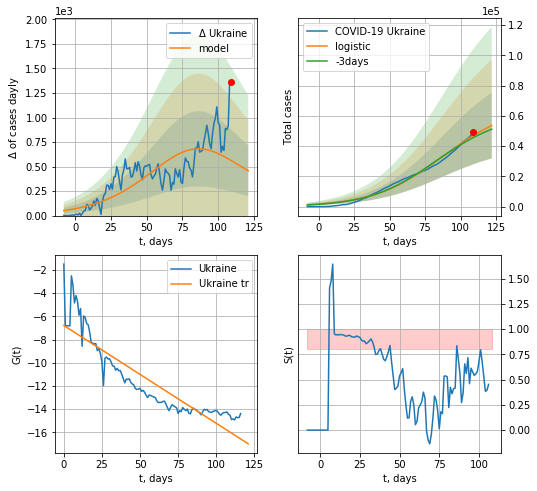

Ukraine data at: 2020-07-05
+3 day model MAPE: 0.031102335677712714
model: logistic
coeffs:  [6.29867590e+04 4.21120388e-02 8.55045000e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.40534008395485926
forecast at the end of period: +13 days
	 deltaDaycases:  456
	 total cases:  53612 ± 21731
	 total death:  1379 ± 1676
trend coefficient of determination: 0.806234
 intercept: -6.790825
 slope: -0.084276


In [624]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


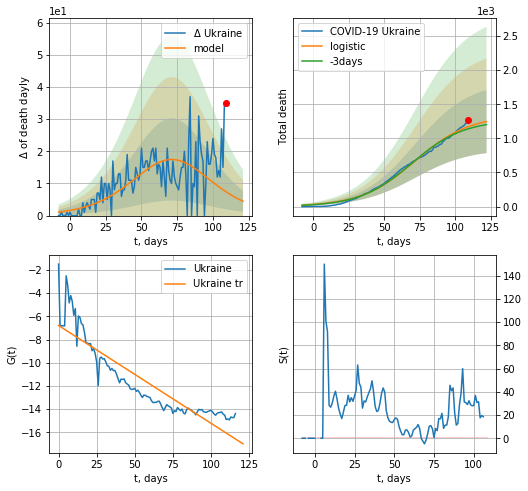

Ukraine data at: 2020-07-05
+3 day model MAPE: 0.02845205972721371
model: logistic
coeffs:  [1.33626896e+03 5.22905701e-02 7.16179171e+01]
rational stdev:  0.37078161749326577
forecast at the end of period: +13 days
	 total death:  1246 ± 462
trend coefficient of determination: 0.806234
 intercept: -6.790825
 slope: -0.084276


In [625]:
x=forecast('Ukraine',dfUR[:],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


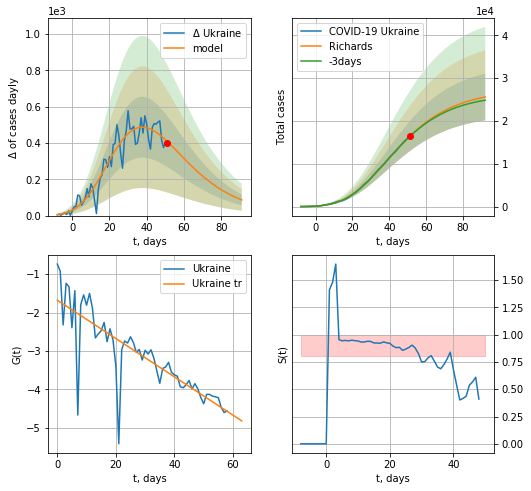

Ukraine data at: 2020-07-05
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152280e+04  5.78390520e-01 -1.00505543e+01  8.74755420e-02]
rational stdev: 0.213278
forecast at the end of period: +41 days
	 deltaDaycases: 86
	 total cases: 25590 ± 5457
	 total death: 658 ± 421
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


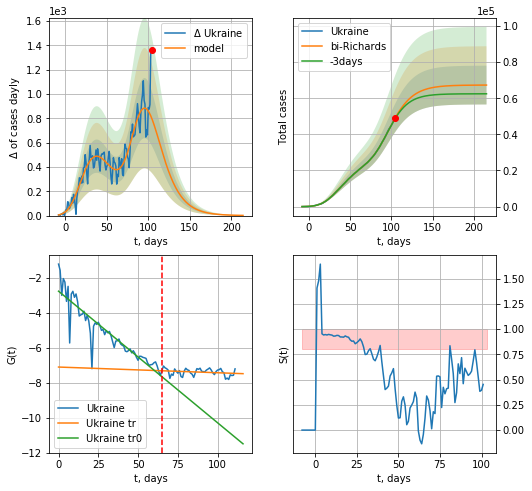

Ukraine data at: 2020-07-05
+3 day model MAPE: 0.006836
model: bi-Richards
coeffs: [4.00110734e+04 1.91942100e-01 8.03916087e+01 3.36434679e-01]
rational stdev: 0.159536
forecast at the end of period: +111 days
	 deltaDaycases: 1
	 total cases: 67302 ± 10737
	 total death: 1731 ± 828
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.838554
 intercept: -2.772737
 slope: -0.075228
trend coefficient of determination: 0.053038
 intercept: -7.109915
 slope: -0.003260


In [626]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


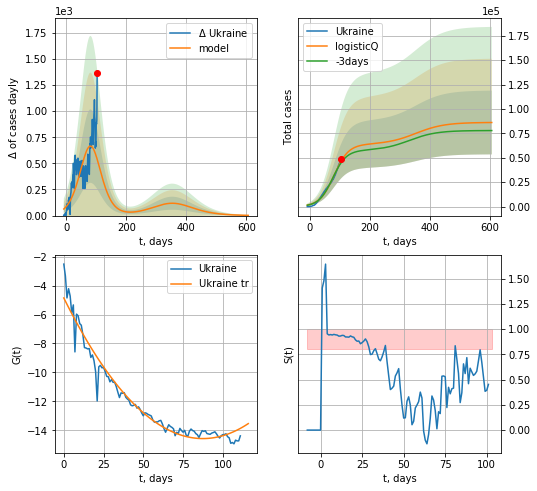

Ukraine data at: 2020-07-05
+3 day model MAPE: 0.035704
model: logisticQ
coeffs: [ 6.36728093e+04  2.71803548e-07  8.10812595e+01 -1.53335434e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378945
forecast at the end of period: +503 days
	 deltaDaycases: 2
	 total cases: 86113 ± 32632
	 total death: 2215 ± 2518
trend coefficient of determination: 0.958314
 intercept_: -4.853853069507632
 coeffs_: [ 0.         -0.22211307  0.00126964]


In [627]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [628]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

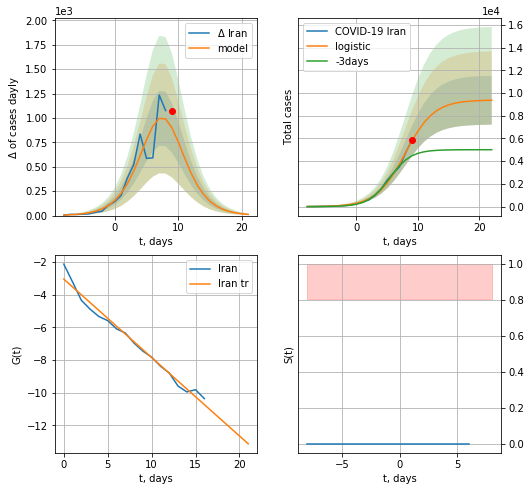

Iran data at: 2020-07-05
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +13 days
	 deltaDaycases:  11
	 total cases:  9363 ± 2151
	 total death:  450 ± 310
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


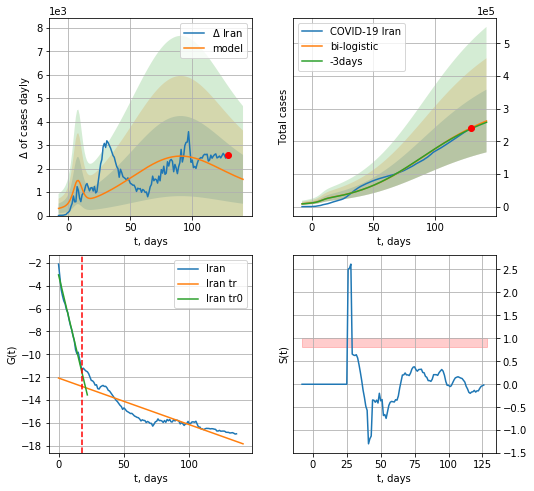

Iran data at: 2020-07-05
+3 day model MAPE: 0.011981600220711585
model: bi-logistic
coeffs:  [2.74501775e+05 3.55074374e-02 8.90556606e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36613338632744613
forecast at the end of period: +13 days
	 deltaDaycases:  1544
	 total cases:  262447 ± 96090
	 total death:  12630 ± 13872
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.812088
 intercept: -12.065663
 slope: -0.040724


In [629]:
x = forecast('Iran',dfIN[:18],d1,7*16-dT)
xx = forecast2('Iran',dfIN[:],d1,16*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


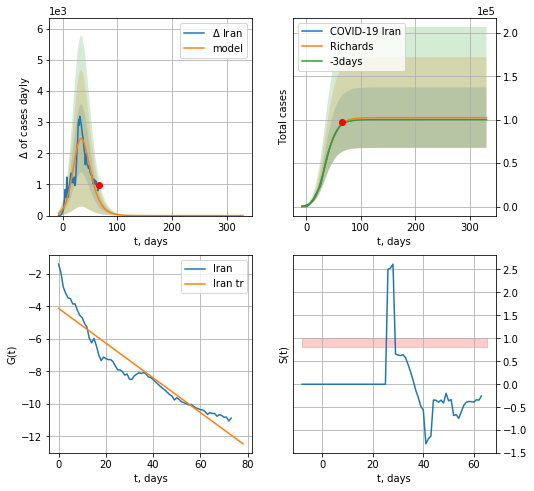

Iran data at: 2020-07-05
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +265 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 4931 ± 5028
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


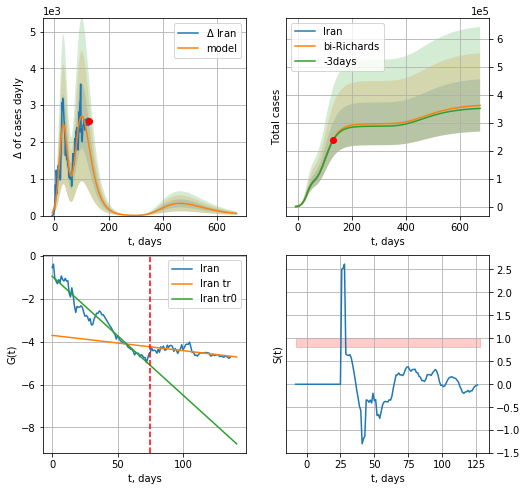

Iran data at: 2020-07-05
+3 day model MAPE: 0.008320
model: bi-Richards
coeffs: [ 1.94406433e+05  2.44383803e+00 -7.90750305e+00  1.54511654e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.258405
forecast at the end of period: +545 days
	 deltaDaycases: 57
	 total cases: 362729 ± 93730
	 total death: 17456 ± 13532
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949239
 intercept: -0.938919
 slope: -0.055515
trend coefficient of determination: 0.456741
 intercept: -3.698068
 slope: -0.007157


In [630]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,92*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


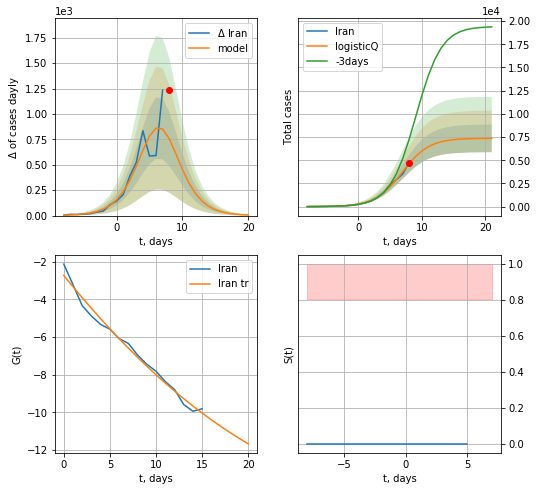

Iran data at: 2020-07-05
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +13 days
	 deltaDaycases: 5
	 total cases: 7359 ± 1494
	 total death: 354 ± 215
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


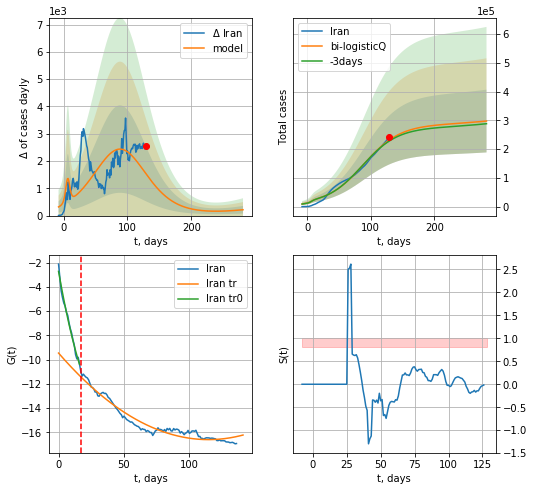

Iran data at: 2020-07-05
+3 day model MAPE: 0.015809
model: bi-logisticQ
coeffs: [ 2.76989258e+05  1.57252743e-07  8.86568170e+01 -2.22871167e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366671
forecast at the end of period: +153 days
	 deltaDaycases: 214
	 total cases: 297474 ± 109075
	 total death: 14315 ± 15746
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.947214
 intercept_: -9.463667249370015
 coeffs_: [ 0.         -0.1246851   0.00054394]


In [631]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active    death
123 2020-07-01  654405.0  221938   9536.0
124 2020-07-02  661165.0  222504   9683.0
125 2020-07-03  667883.0  220131   9859.0
126 2020-07-04  674515.0  217609  10027.0
127 2020-07-05  687862.0  223237  10296.0


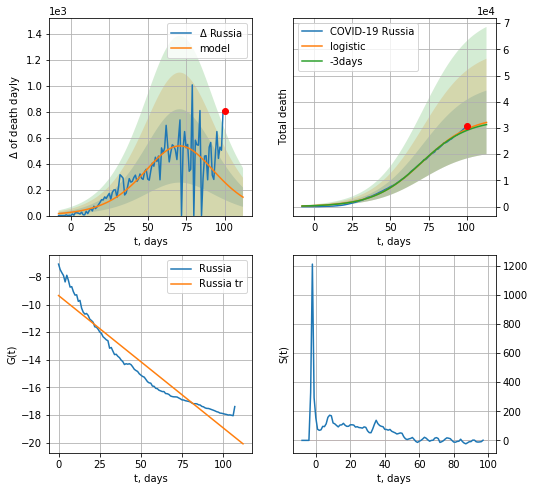

Russia data at: 2020-07-05
+3 day model MAPE: 0.018597590770934747
model: logistic
coeffs:  [3.44899084e+04 6.23224497e-02 7.12882106e+01]
rational stdev:  0.37840698685488094
forecast at the end of period: +13 days
	 total death:  32104 ± 12148
trend coefficient of determination: 0.913590
 intercept: -9.351655
 slope: -0.095763


In [632]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,16*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


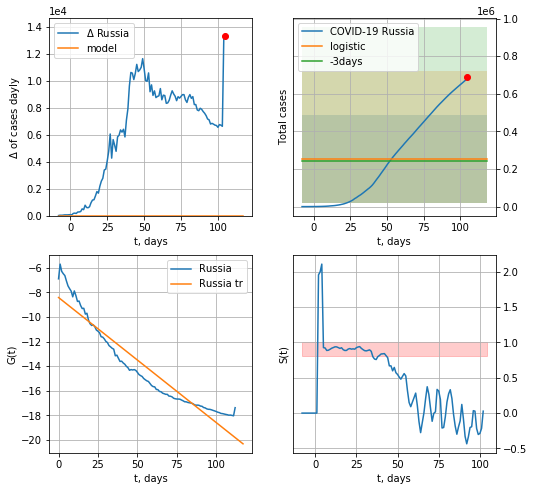

Russia data at: 2020-07-05
+3 day model MAPE: 0.04735501966140426
model: logistic
coeffs:  [ 2.53189272e+05 -7.18305298e+00  1.86435546e+02]
rational stdev:  0.9248152908708316
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  253189 ± 234153
	 total death:  3789 ± 10512
trend coefficient of determination: 0.911079
 intercept: -8.420821
 slope: -0.101732


In [633]:
x = forecast('Russia',dfRS[14:],d1,16*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


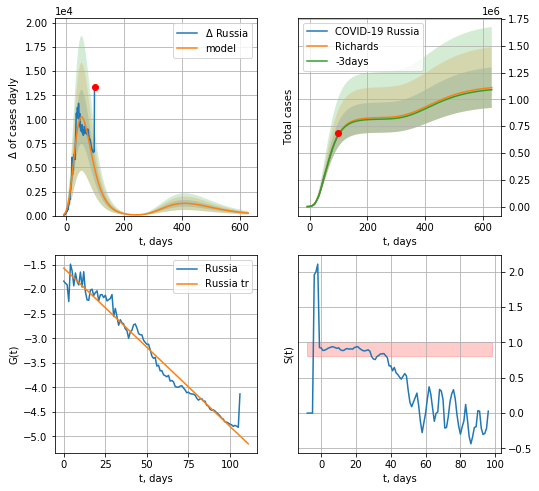

Russia data at: 2020-07-05
+3 day model MAPE: 0.007630
model: Richards
coeffs: [ 8.31224152e+05  2.35001348e+00 -7.18077818e+01  1.43730956e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.170063
forecast at the end of period: +531 days
	 deltaDaycases: 254
	 total cases: 1109606 ± 188702
	 total death: 16608 ± 8473
trend coefficient of determination: 0.969887
 intercept: -1.572621
 slope: -0.032240


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


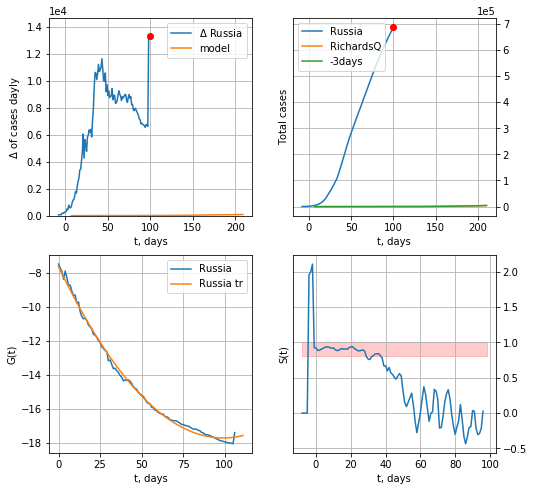

Russia data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.43452012e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +111 days
	 deltaDaycases: 80


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [634]:
x = forecastRR('Russia',dfRS[20:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


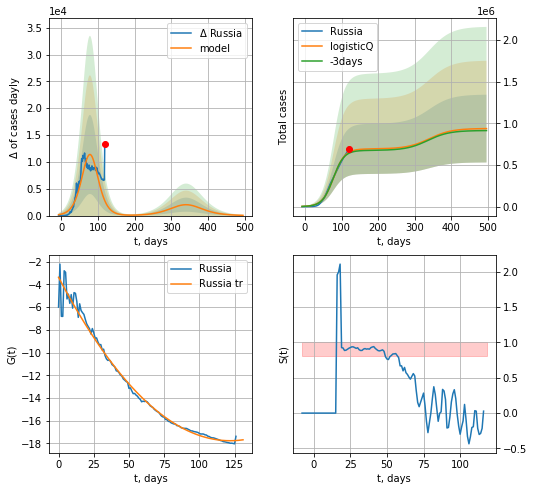

Russia data at: 2020-07-05
+3 day model MAPE: 0.018033
model: logisticQ
coeffs: [ 6.92999677e+05  3.54052576e-07  7.80165269e+01 -1.85515171e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434425
forecast at the end of period: +377 days
	 deltaDaycases: 47
	 total cases: 937030 ± 407069
	 total death: 14025 ± 18278
trend coefficient of determination: 0.983257
 intercept_: -3.3692297230292834
 coeffs_: [ 0.         -0.23635292  0.00096967]


In [635]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
161 2020-07-01  18723.0    1018  974.0
162 2020-07-02  18874.0    1127  975.0
163 2020-07-03  19068.0    1226  976.0
164 2020-07-04  19282.0    1346  977.0
165 2020-07-05  19522.0    1495  977.0


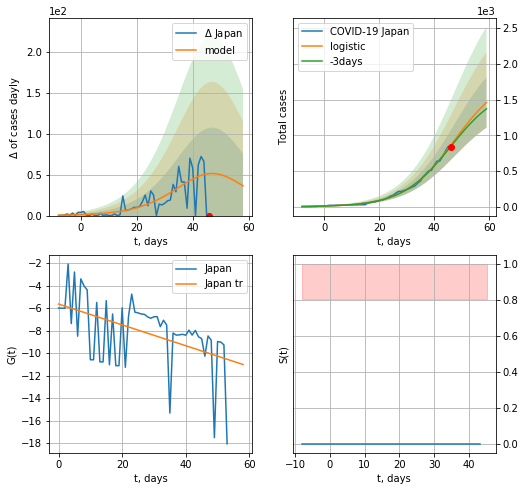

Japan data at: 2020-07-05
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +13 days
	 deltaDaycases:  36
	 total cases:  1458 ± 352
	 total death:  73 ± 52
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


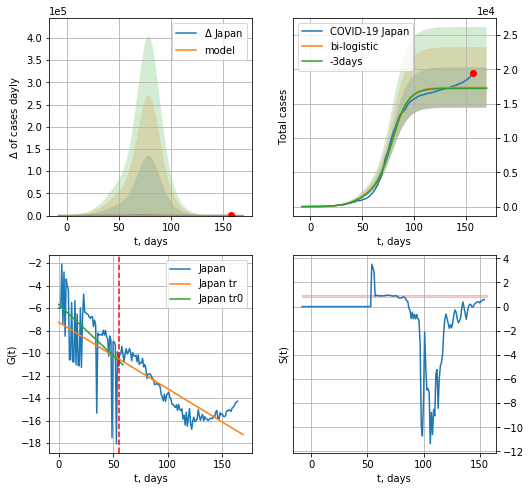

Japan data at: 2020-07-05
+3 day model MAPE: 0.007751560004034379
model: bi-logistic
coeffs:  [1.54954865e+04 1.26969951e-01 7.89853556e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.16951119579982005
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  17362 ± 2943
	 total death:  868 ± 441
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.747937
 intercept: -7.260184
 slope: -0.059137


In [637]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*16-dT)
    xx = forecast2('Japan',dfJP[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

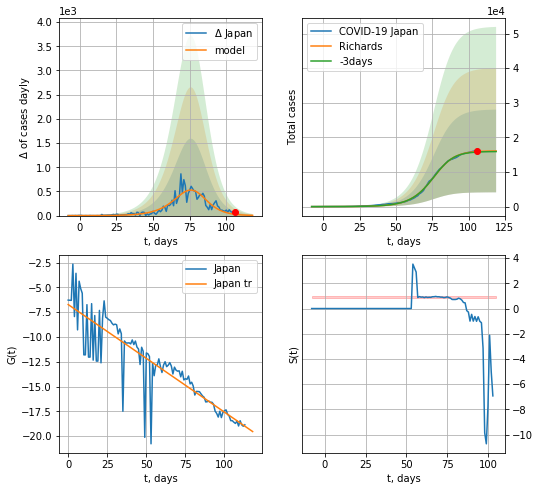

Japan data at: 2020-07-05
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +13 days
	 deltaDaycases: 4
	 total cases: 16074 ± 11948
	 total death: 804 ± 1792
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


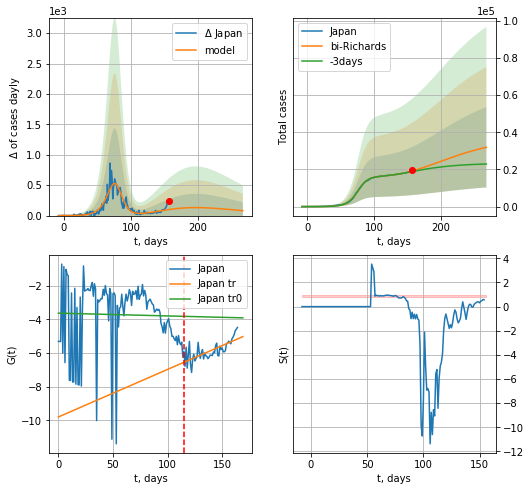

Japan data at: 2020-07-05
+3 day model MAPE: 0.017535
model: bi-Richards
coeffs: [ 2.14047335e+04  1.97011476e+00 -8.62215154e+01  8.53377692e-03]
rational stdev: 0.676538
forecast at the end of period: +111 days
	 deltaDaycases: 80
	 total cases: 31908 ± 21587
	 total death: 1596 ± 3239
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.000729
 intercept: -3.632572
 slope: -0.001653
trend coefficient of determination: 0.520221
 intercept: -9.799349
 slope: 0.028240


In [639]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


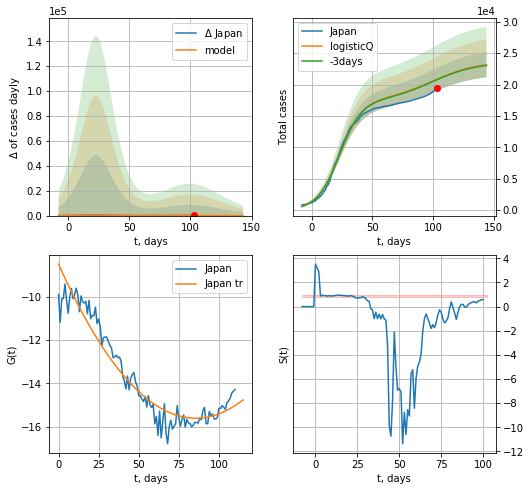

Japan data at: 2020-07-05
+3 day model MAPE: 0.003367
model: logisticQ
coeffs: [ 1.74854502e+04  4.08741089e-07  2.29581432e+01 -2.64124924e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.086559
forecast at the end of period: +41 days
	 deltaDaycases: 26
	 total cases: 23156 ± 2004
	 total death: 1158 ± 300
trend coefficient of determination: 0.920446
 intercept_: -8.489624418851376
 coeffs_: [ 0.         -0.16641972  0.00097285]


In [640]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


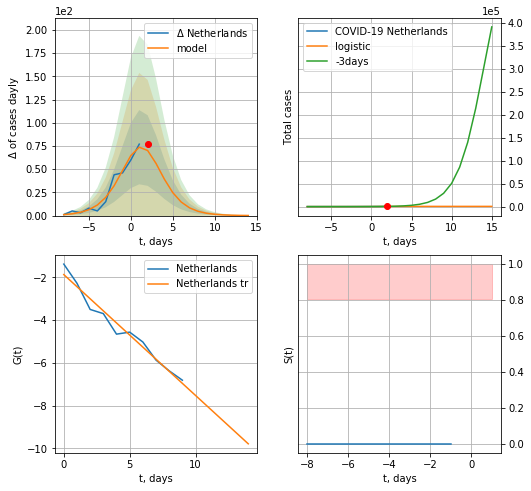

Netherlands data at: 2020-07-05
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  59 ± 42
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

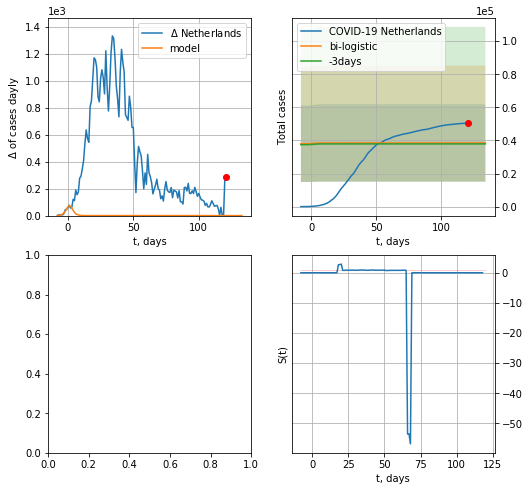

In [641]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,16*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
           date    cases  active   death
125 2020-07-01  50273.5       0  6113.0
126 2020-07-02  50335.0       0  6113.0
127 2020-07-03  50335.0       0  6113.0
128 2020-07-04  50335.0       0  6113.0
129 2020-07-05  50621.0       0  6127.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

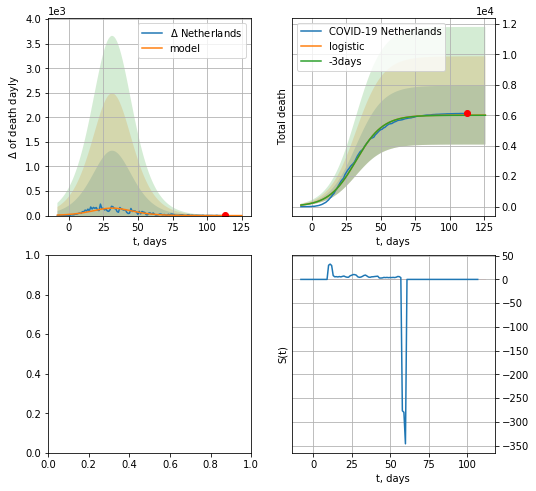

In [642]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


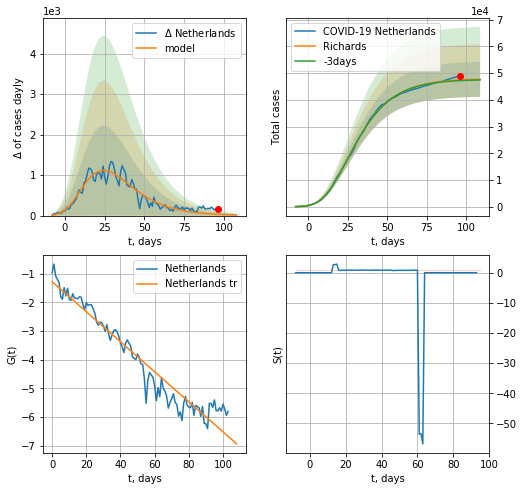

Netherlands data at: 2020-07-05
+3 day model MAPE: 0.004428
model: Richards
coeffs: [ 4.79228880e+04  6.10801361e+00 -4.69731320e+01  1.04094123e-02]
rational stdev: 0.137169
forecast at the end of period: +13 days
	 deltaDaycases: 14
	 total cases: 47696 ± 6542
	 total death: 5773 ± 2375
trend coefficient of determination: 0.935019
 intercept: -1.282677
 slope: -0.052364


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

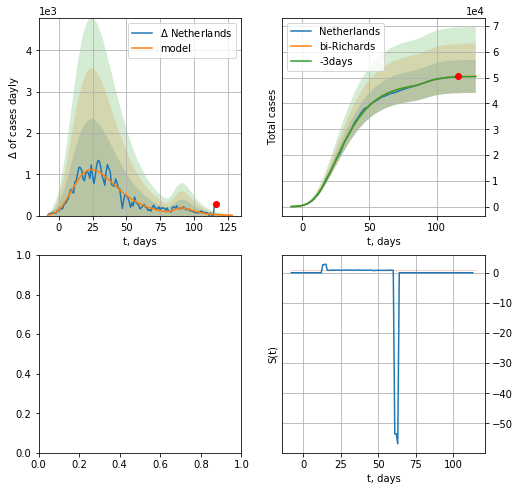

In [653]:
iL = 5
vL = 115
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


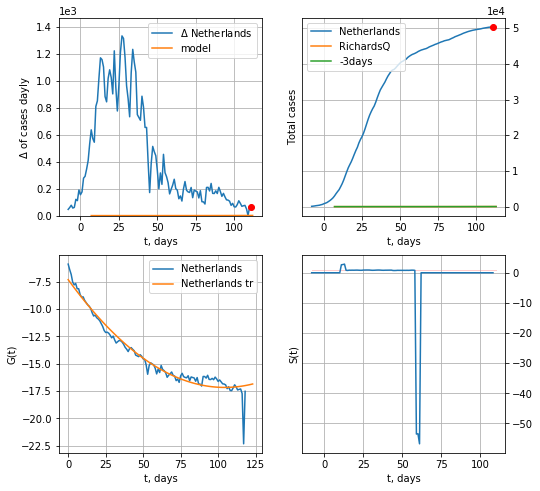

Netherlands data at: 2020-07-02
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.85848799e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +2 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [217]:
x = forecastQR('Netherlands',dfNL[7:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

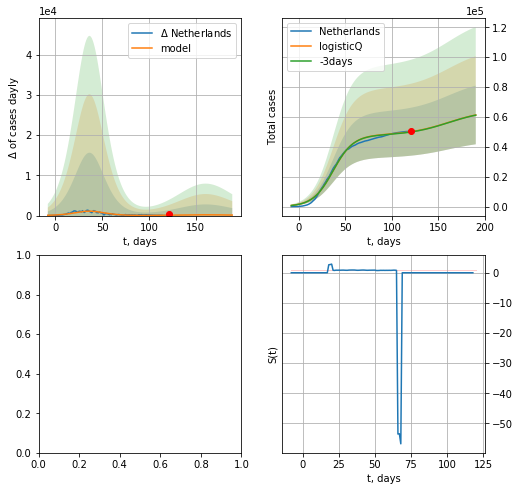

In [654]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [219]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


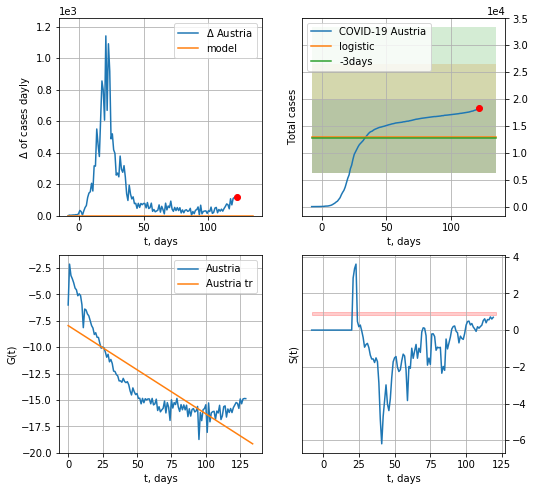

Austria data at: 2020-07-05
+3 day model MAPE: 0.011515102147876464
model: logistic
coeffs:  [ 1.22264123e+04 -5.42563918e+00  1.16901138e+03]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.5235560907125213
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  12990 ± 6801
	 total death:  501 ± 786
trend coefficient of determination: 0.692418
 intercept: -7.956042
 slope: -0.083674


In [655]:
x = forecast('Austria',dfAT[:],d1,7*16-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


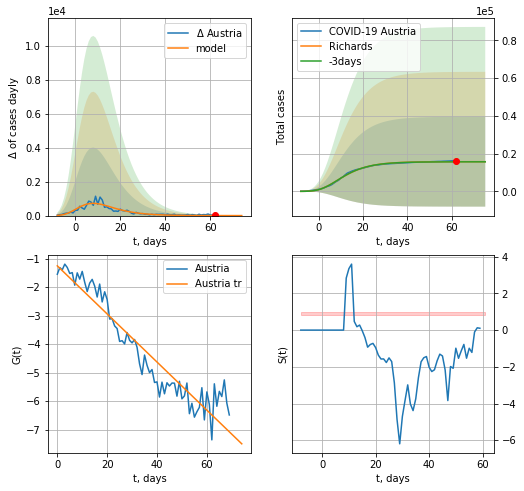

Austria data at: 2020-07-05
+3 day model MAPE: 0.004675
model: Richards
coeffs: [ 1.57373335e+04  1.43837183e+01 -2.95009845e+01  8.70431827e-03]
rational stdev: 1.513265
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 15733 ± 23809
	 total death: 607 ± 2755
trend coefficient of determination: 0.902787
 intercept: -1.255749
 slope: -0.084344


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


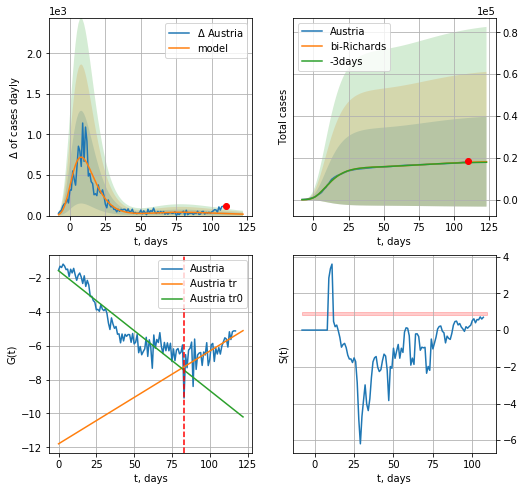

Austria data at: 2020-07-05
+3 day model MAPE: 0.010541
model: bi-Richards
coeffs: [ 2.92002872e+03  6.89459794e+00 -5.59180043e+01  5.57559852e-03]
rational stdev: 1.181613
forecast at the end of period: +13 days
	 deltaDaycases: 17
	 total cases: 18164 ± 21463
	 total death: 701 ± 2484
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.868028
 intercept: -1.566601
 slope: -0.070786
trend coefficient of determination: 0.420970
 intercept: -11.791610
 slope: 0.054800


In [656]:
vL=83+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


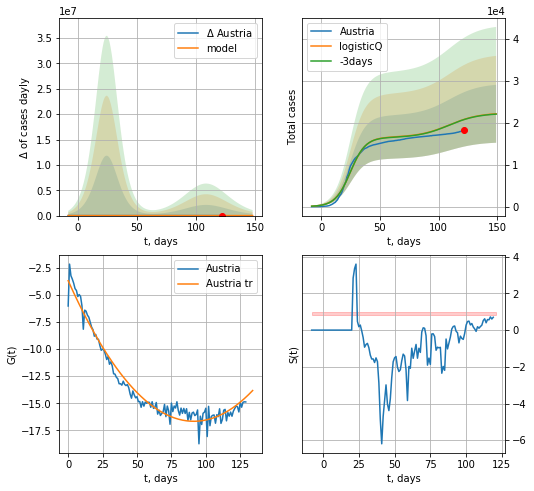

Austria data at: 2020-07-05
+3 day model MAPE: 0.001736
model: logisticQ
coeffs: [ 1.65339263e+04  3.30498172e-07  2.50158349e+01 -4.66531417e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311910
forecast at the end of period: +27 days
	 deltaDaycases: 19
	 total cases: 22137 ± 6904
	 total death: 854 ± 799
trend coefficient of determination: 0.964020
 intercept_: -3.65953283834469
 coeffs_: [ 0.         -0.28507601  0.00156127]


In [657]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
122 2020-07-01  61509.0   34734  9754.0
123 2020-07-02  61598.0   34793  9761.0
124 2020-07-03  61727.0   34889  9765.0
125 2020-07-04  61838.0   34976  9771.0
126 2020-07-05  62016.0   35154  9771.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


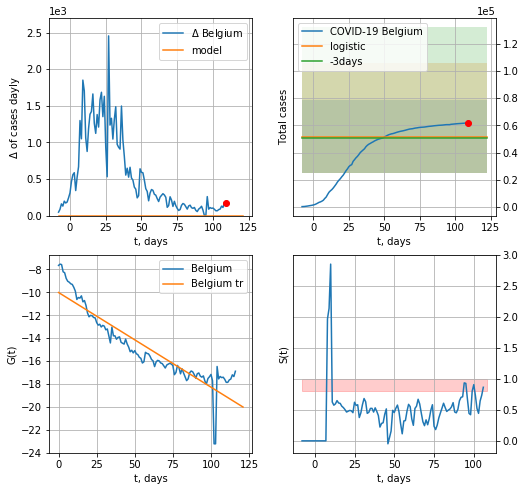

Belgium data at: 2020-07-05
+3 day model MAPE: 0.013098010429429333
model: logistic
coeffs:  [ 4.13615754e+04 -8.29242470e+00  2.66318514e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.5205677951078506
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  51701 ± 26914
	 total death:  8145 ± 12720
trend coefficient of determination: 0.839974
 intercept: -10.014480
 slope: -0.082652


In [658]:
vL=9
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[vL:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
           date    cases  active   death
122 2020-07-01  61509.0   34734  9754.0
123 2020-07-02  61598.0   34793  9761.0
124 2020-07-03  61727.0   34889  9765.0
125 2020-07-04  61838.0   34976  9771.0
126 2020-07-05  62016.0   35154  9771.0


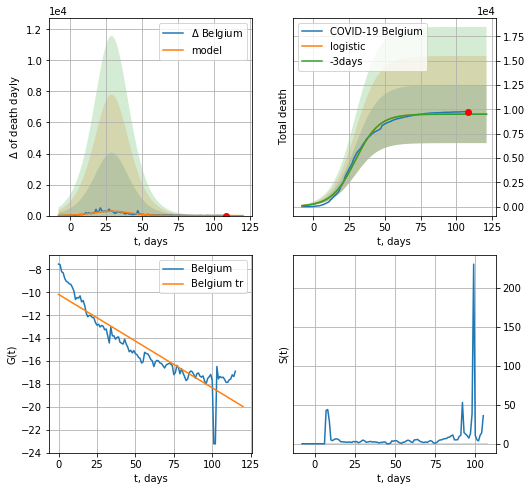

Belgium data at: 2020-07-05
+3 day model MAPE: 0.0018126998054716439
model: logistic
coeffs:  [9.52032611e+03 1.21007263e-01 2.92697833e+01]
rational stdev:  0.3136405043586563
forecast at the end of period: +13 days
	 total death:  9520 ± 2985
trend coefficient of determination: 0.837574
 intercept: -10.178713
 slope: -0.081588


In [659]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


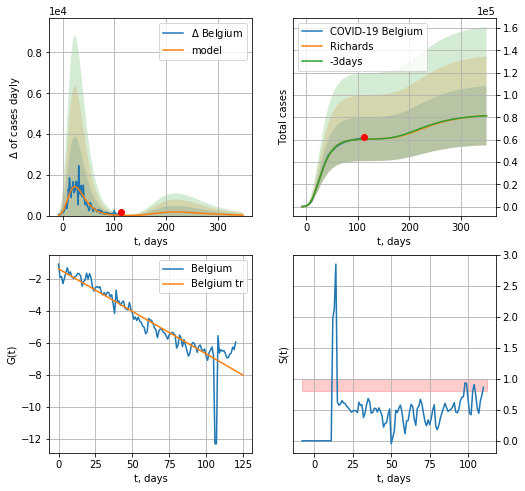

Belgium data at: 2020-07-05
+3 day model MAPE: 0.002105
model: Richards
coeffs: [ 6.07262148e+04  7.76818144e+00 -5.13864338e+01  8.19160704e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.325435
forecast at the end of period: +237 days
	 deltaDaycases: 26
	 total cases: 81495 ± 26521
	 total death: 12840 ± 12535
trend coefficient of determination: 0.833449
 intercept: -1.374224
 slope: -0.053107


In [660]:
x = forecastRR('Belgium',dfBG[5:],d1,48*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


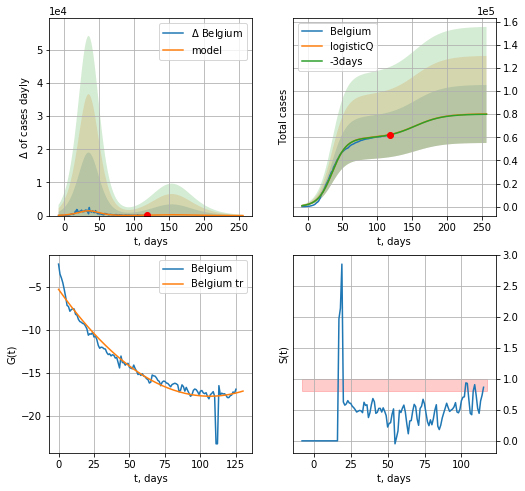

Belgium data at: 2020-07-05
+3 day model MAPE: 0.002816
model: logisticQ
coeffs: [ 5.93155920e+04  3.08115758e-07  3.54215772e+01 -3.16413958e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313264
forecast at the end of period: +139 days
	 deltaDaycases: 6
	 total cases: 80187 ± 25119
	 total death: 12634 ± 11873
trend coefficient of determination: 0.943094
 intercept_: -5.295110064490098
 coeffs_: [ 0.         -0.23270227  0.00109125]


In [661]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [662]:
dfBZ.tail()

,date,cases,active,death
127,2020-07-01,1453369.0,476509,60713.0
128,2020-07-02,1501353.0,523216,61990.0
129,2020-07-03,1543341.0,501472,63254.0
130,2020-07-04,1578376.0,535396,64365.0
131,2020-07-05,1604585.0,561070,64900.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


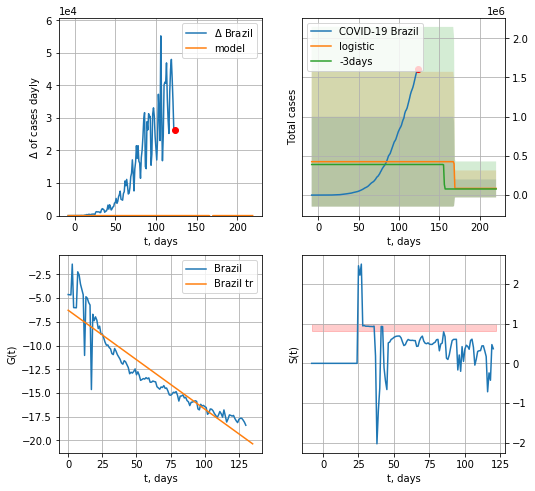

Brazil data at: 2020-07-05
+3 day model MAPE: 0.0919851669610582
model: logistic
coeffs:  [ 3.40842533e+05 -6.63434419e+00  1.68378953e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3442821980730817
forecast at the end of period: +97 days
	 deltaDaycases:  0
	 total cases:  85210 ± 114547
	 total death:  3446 ± 13897
trend coefficient of determination: 0.866588
 intercept: -6.279950
 slope: -0.104296


In [663]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


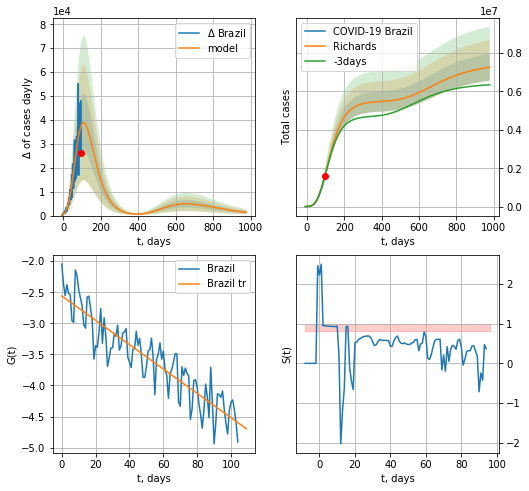

Brazil data at: 2020-07-05
+3 day model MAPE: 0.008083
model: Richards
coeffs: [ 5.49016098e+06  3.56202473e-01 -3.68120939e+01  5.55587831e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.096404
forecast at the end of period: +881 days
	 deltaDaycases: 1381
	 total cases: 7263772 ± 700259
	 total death: 293794 ± 84969
trend coefficient of determination: 0.817789
 intercept: -2.560136
 slope: -0.019585


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


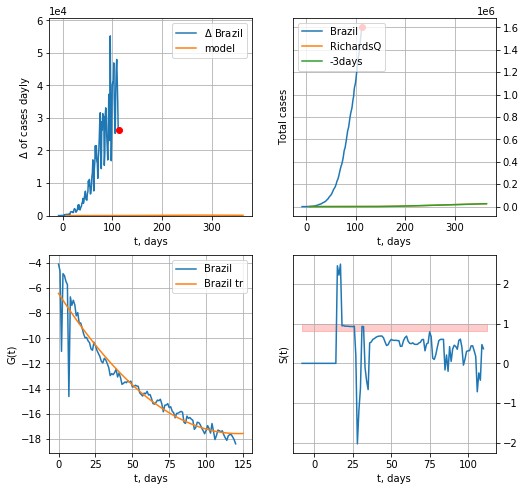

Brazil data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.54597654e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +251 days
	 deltaDaycases: 92


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [666]:
x = forecastRR('Brazil',dfBZ[26:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


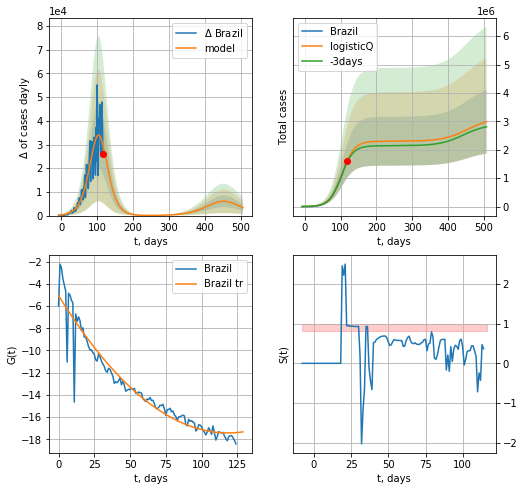

Brazil data at: 2020-07-05
+3 day model MAPE: 0.023924
model: logisticQ
coeffs: [ 2.30193319e+06  1.38305224e-06  1.04014186e+02 -4.26033032e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373494
forecast at the end of period: +391 days
	 deltaDaycases: 3366
	 total cases: 2982629 ± 1113994
	 total death: 120637 ± 135171
trend coefficient of determination: 0.925469
 intercept_: -5.059458195792395
 coeffs_: [ 0.         -0.20870194  0.00088065]


In [667]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [668]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
137 2020-07-01  8001.0     807  104.0
138 2020-07-02  8066.0     830  104.0
139 2020-07-03  8260.0     837  104.0
140 2020-07-04  8443.0     940  104.0
141 2020-07-05  8586.0    1060  106.0


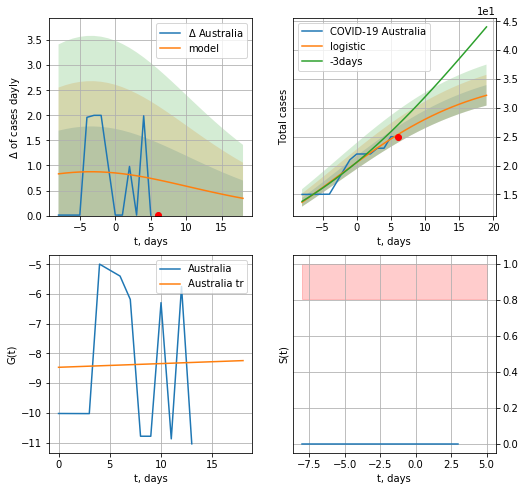

Australia data at: 2020-07-05
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  32 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


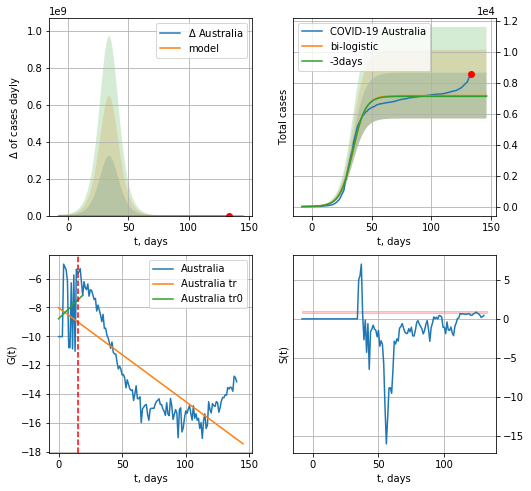

Australia data at: 2020-07-05
+3 day model MAPE: 0.007252998927654632
model: bi-logistic
coeffs:  [7.14120918e+03 1.86000825e-01 3.44037200e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.2056928226675221
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  7177 ± 1476
	 total death:  88 ± 54
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.587858
 intercept: -8.021824
 slope: -0.065121


In [670]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,16*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,16*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


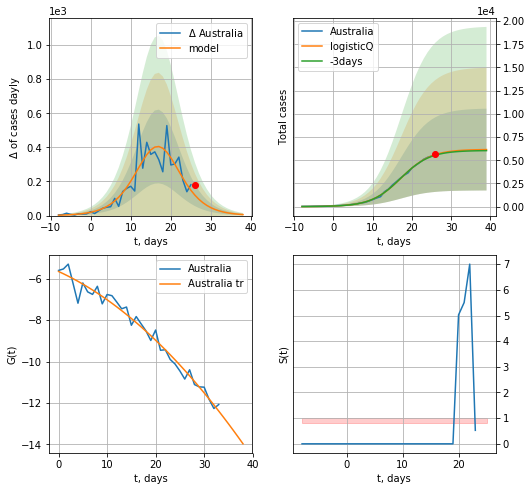

Australia data at: 2020-07-05
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +13 days
	 deltaDaycases: 5
	 total cases: 6148 ± 4407
	 total death: 75 ± 161
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


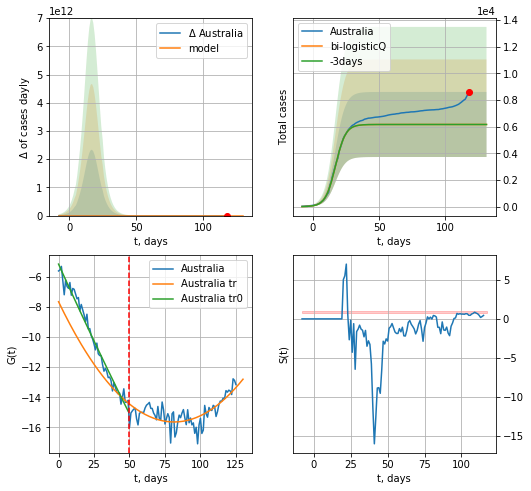

Australia data at: 2020-07-05
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-7.53409934 -1.19252742 25.50341933  5.97953823]
rational stdev: 0.395677
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2440
	 total death: 76 ± 90
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.512159
 intercept_: -7.649588053579384
 coeffs_: [ 0.         -0.19621476  0.00120481]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [672]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

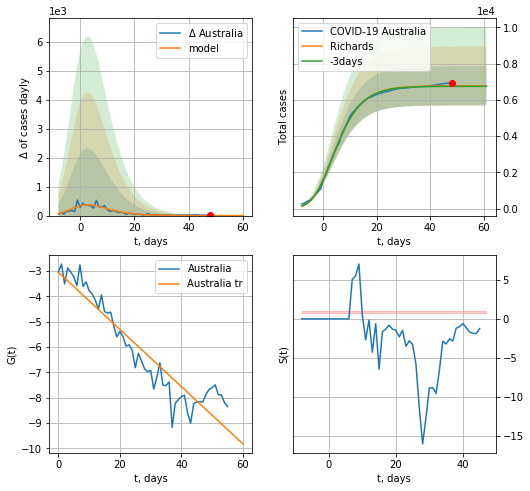

Australia data at: 2020-07-05
+3 day model MAPE: 0.004280
model: Richards
coeffs: [ 6.77705018e+03  7.40442846e-01 -5.76166471e+00  2.24569731e-01]
rational stdev: 0.159926
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 6776 ± 1083
	 total death: 83 ± 39
trend coefficient of determination: 0.885689
 intercept: -3.046778
 slope: -0.112817


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


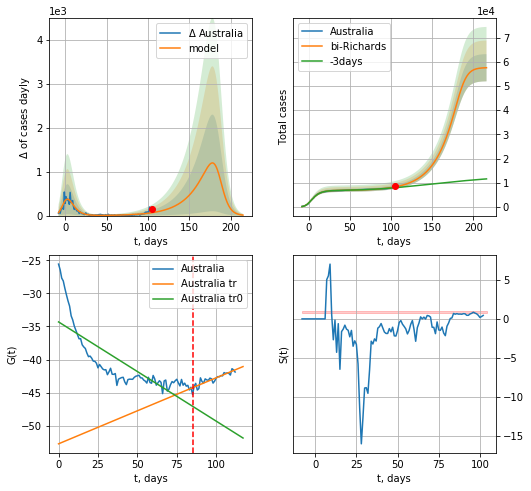

Australia data at: 2020-07-05
+3 day model MAPE: 0.044675
model: bi-Richards
coeffs: [5.08051909e+04 4.34163994e-02 1.86376375e+02 4.17319723e+00]
rational stdev: 0.097783
forecast at the end of period: +111 days
	 deltaDaycases: 11
	 total cases: 57525 ± 5625
	 total death: 710 ± 208
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.648597
 intercept: -34.307335
 slope: -0.150268
trend coefficient of determination: 0.792019
 intercept: -52.765076
 slope: 0.099960


In [676]:
iL = 28
vL = 85+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

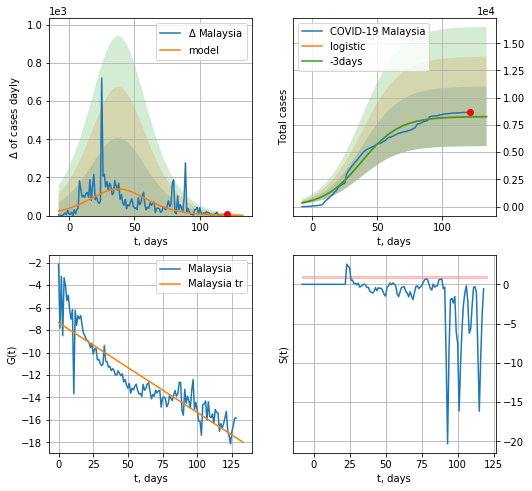

Malaysia data at: 2020-07-05
+3 day model MAPE: 0.005398810293892554
model: logistic
coeffs:  [8.30490559e+03 6.74527589e-02 3.80922817e+01]
rational stdev:  0.32995719511878385
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  8292 ± 2736
	 total death:  115 ± 113
trend coefficient of determination: 0.810219
 intercept: -7.331602
 slope: -0.080083


In [678]:
x = forecast('Malaysia',dfML[:],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

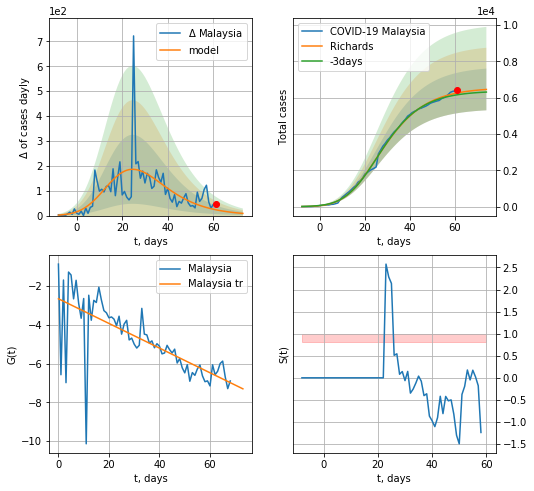

Malaysia data at: 2020-07-05
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +13 days
	 deltaDaycases: 8
	 total cases: 6458 ± 1148
	 total death: 90 ± 48
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


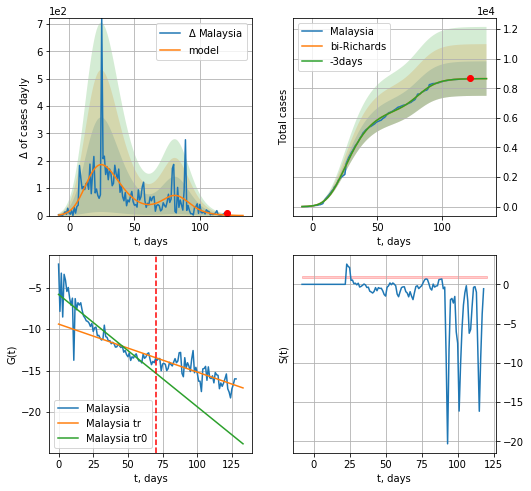

Malaysia data at: 2020-07-05
+3 day model MAPE: 0.000603
model: bi-Richards
coeffs: [2.10151037e+03 1.30265563e-01 8.20253022e+01 1.01936095e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.134526
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 8656 ± 1164
	 total death: 120 ± 48
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.807504
 intercept: -5.808017
 slope: -0.135632
trend coefficient of determination: 0.568839
 intercept: -9.392461
 slope: -0.057949


In [679]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


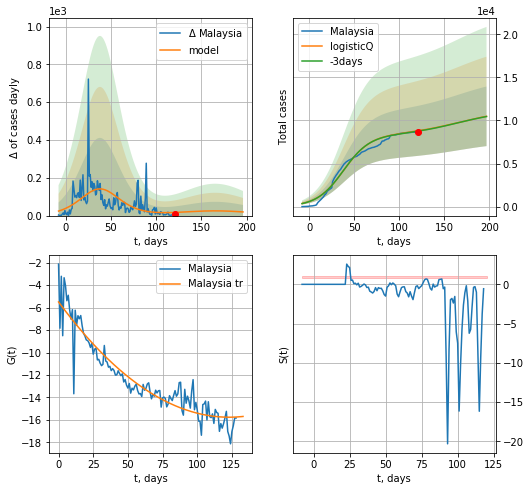

Malaysia data at: 2020-07-05
+3 day model MAPE: 0.004339
model: logisticQ
coeffs: [ 8.30491906e+03  1.18831982e-07  3.80939669e+01 -5.67406386e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329996
forecast at the end of period: +76 days
	 deltaDaycases: 19
	 total cases: 10483 ± 3459
	 total death: 146 ± 144
trend coefficient of determination: 0.874867
 intercept_: -5.491657615901003
 coeffs_: [ 0.         -0.16701111  0.00067914]


In [680]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
124 2020-07-01  1530.0      18   22.0
125 2020-07-02  1530.3      18   22.0
126 2020-07-03  1530.6      18   22.0
127 2020-07-04  1533.0      21   22.0
128 2020-07-05  1534.0      22   22.0


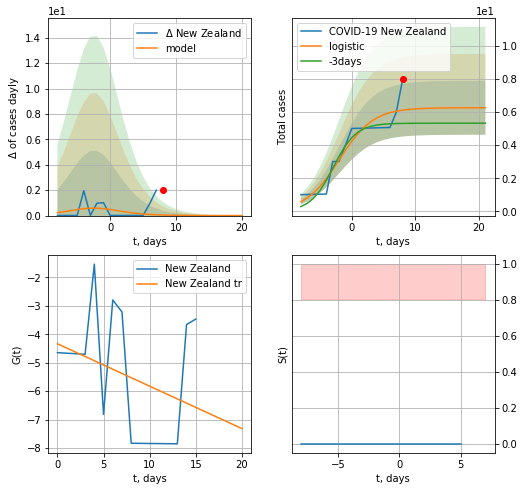

New Zealand data at: 2020-07-05
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


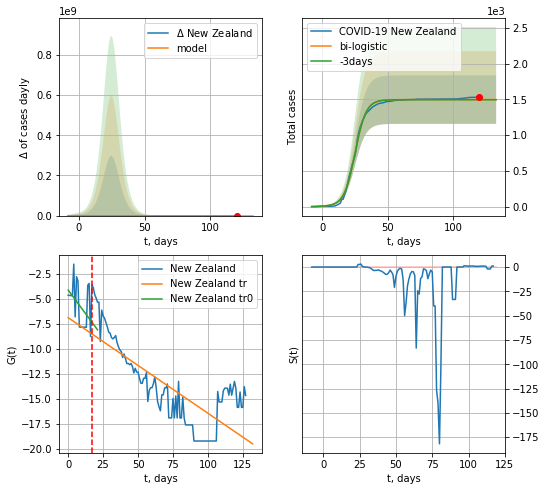

New Zealand data at: 2020-07-05
+3 day model MAPE: 0.0009303606127698018
model: bi-logistic
coeffs:  [1.49103347e+03 2.38540685e-01 2.51906048e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.22639338499723707
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1497 ± 338
	 total death:  21 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.591554
 intercept: -6.891261
 slope: -0.095658


In [682]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,16*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

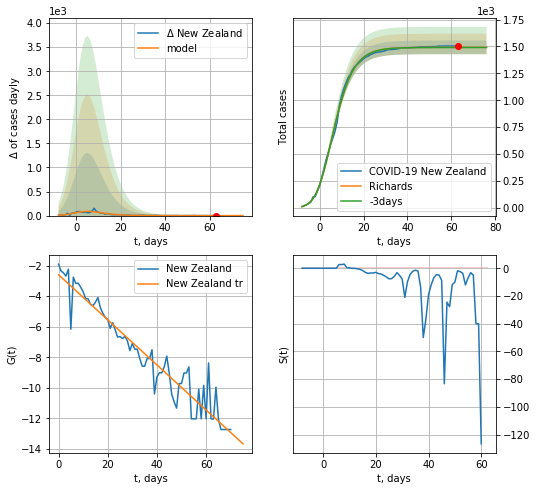

New Zealand data at: 2020-07-05
+3 day model MAPE: 0.000854
model: Richards
coeffs: [ 1.49158630e+03  5.64402224e-01 -5.41494471e-01  3.30453174e-01]
rational stdev: 0.042486
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1491 ± 63
	 total death: 21 ± 2
trend coefficient of determination: 0.916494
 intercept: -2.603090
 slope: -0.147473


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


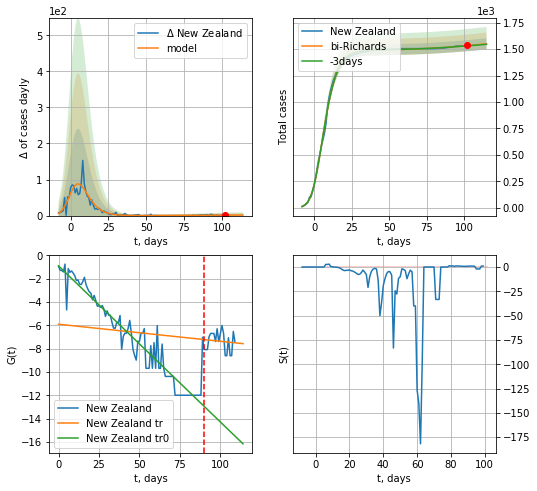

New Zealand data at: 2020-07-05
+3 day model MAPE: 0.001481
model: bi-Richards
coeffs: [ 2.79485306e+02  2.09839827e+00 -1.52220976e+02  7.84543982e-03]
rational stdev: 0.034211
forecast at the end of period: +13 days
	 deltaDaycases: 1
	 total cases: 1550 ± 53
	 total death: 22 ± 2
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.914517
 intercept: -0.902789
 slope: -0.133667
trend coefficient of determination: 0.010255
 intercept: -5.899020
 slope: -0.014591


In [683]:
vL = 90 + 18
x = forecastRR('New Zealand',dfZL[18:vL-18],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[18:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-18)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


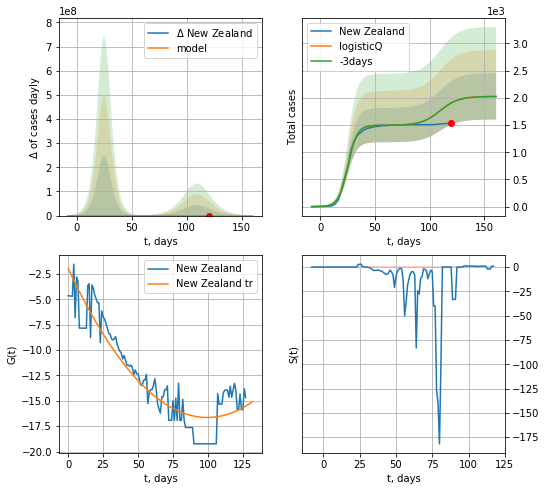

New Zealand data at: 2020-07-05
+3 day model MAPE: 0.000488
model: logisticQ
coeffs: [ 1.49751305e+03  1.95900780e-06  2.51434458e+01 -1.20584322e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.210176
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 2026 ± 425
	 total death: 29 ± 18
trend coefficient of determination: 0.854216
 intercept_: -1.9683201832960737
 coeffs_: [ 0.         -0.29496711  0.00148219]


In [684]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
124 2020-07-01  62424.0   14473  398.0
125 2020-07-02  62698.0   13555  405.0
126 2020-07-03  62997.0   12676  412.0
127 2020-07-04  63270.0   12183  418.0
128 2020-07-05  63554.0   12260  423.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


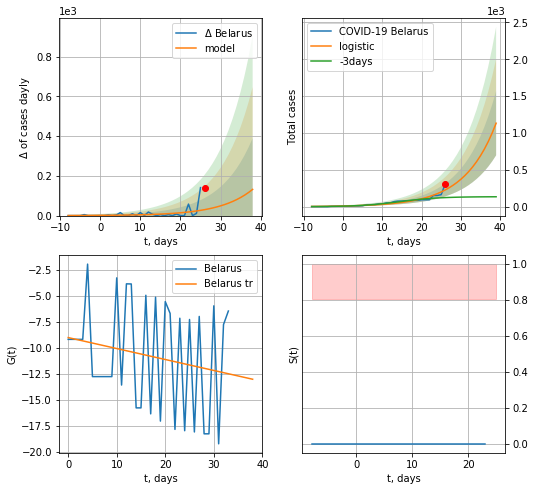

Belarus data at: 2020-07-05
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +13 days
	 deltaDaycases:  132
	 total cases:  1132 ± 435
	 total death:  7 ± 8
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


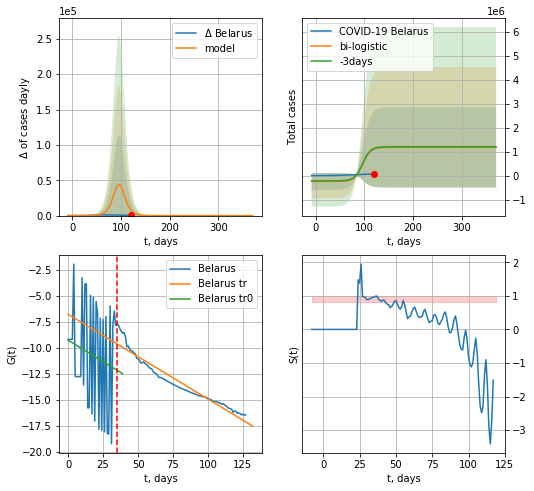

Belarus data at: 2020-07-05
+3 day model MAPE: 0.021598504917868747
model: bi-logistic
coeffs:  [-2.45506697e+05  3.04767716e+01 -7.03370512e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  1.4210071269644486
forecast at the end of period: +251 days
	 deltaDaycases:  0
	 total cases:  1176472 ± 1671776
	 total death:  7830 ± 33379
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.930601
 intercept: -6.798332
 slope: -0.081458


In [686]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*16-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
124 2020-07-01  62424.0   14473  398.0
125 2020-07-02  62698.0   13555  405.0
126 2020-07-03  62997.0   12676  412.0
127 2020-07-04  63270.0   12183  418.0
128 2020-07-05  63554.0   12260  423.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


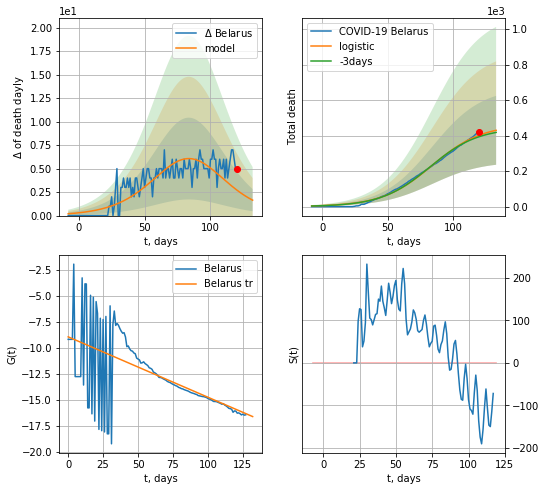

Belarus data at: 2020-07-05
+3 day model MAPE: 0.02163292429800261
model: logistic
coeffs:  [4.62892587e+02 5.24464640e-02 8.39990748e+01]
rational stdev:  0.4515492629068496
forecast at the end of period: +13 days
	 total death:  429 ± 194
trend coefficient of determination: 0.368478
 intercept: -8.970351
 slope: -0.058076


In [687]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


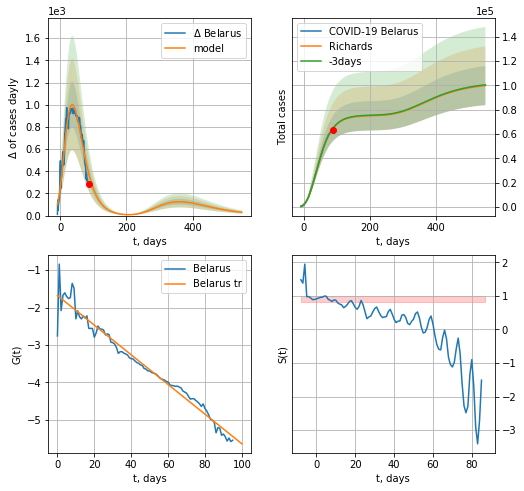

Belarus data at: 2020-07-05
+3 day model MAPE: 0.003207
model: Richards
coeffs: [ 7.51014777e+04  2.92077086e+00 -8.29824100e+01  1.24938380e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.161277
forecast at the end of period: +461 days
	 deltaDaycases: 29
	 total cases: 99853 ± 16103
	 total death: 664 ± 321
trend coefficient of determination: 0.964809
 intercept: -1.678924
 slope: -0.039651


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


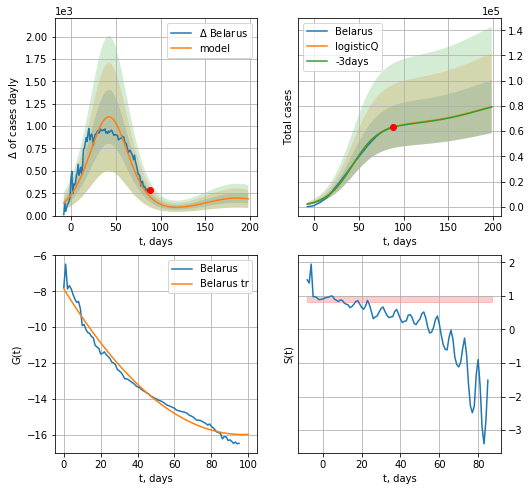

Belarus data at: 2020-07-05
+3 day model MAPE: 0.005100
model: logisticQ
coeffs: [ 6.54258008e+04  5.21014867e-07  4.27396670e+01 -1.28811269e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.265104
forecast at the end of period: +111 days
	 deltaDaycases: 187
	 total cases: 79459 ± 21065
	 total death: 528 ± 419
trend coefficient of determination: 0.979236
 intercept_: -7.862033418064399
 coeffs_: [ 0.         -0.16766277  0.00086554]


In [688]:
x = forecastRR('Belarus',dfBR[32:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


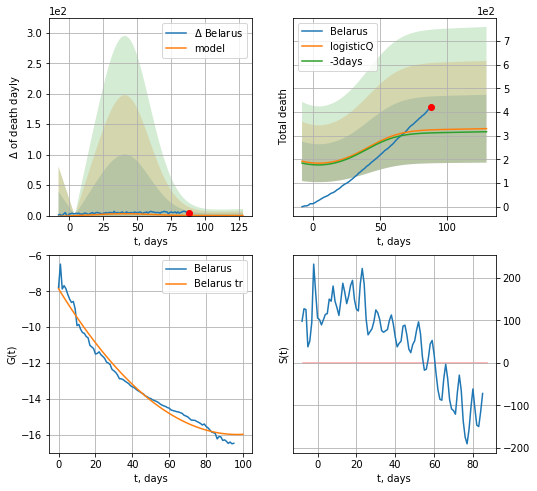

Belarus data at: 2020-07-05
+3 day model MAPE: 0.040864
model: logisticQ
coeffs: [ 2.75047365e+02  7.77822646e-04  9.75117156e+00 -9.36353670e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.433814
forecast at the end of period: +41 days
	 total death: 329 ± 143
trend coefficient of determination: 0.979236
 intercept_: -7.862033418064399
 coeffs_: [ 0.         -0.16766277  0.00086554]


In [689]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

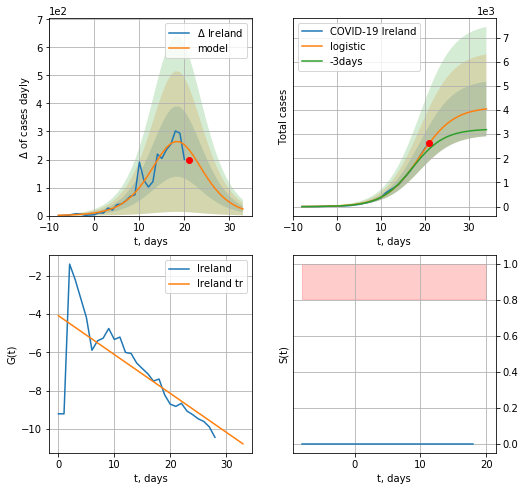

Ireland data at: 2020-07-05
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +13 days
	 deltaDaycases:  23
	 total cases:  4045 ± 1131
	 total death:  275 ± 230
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


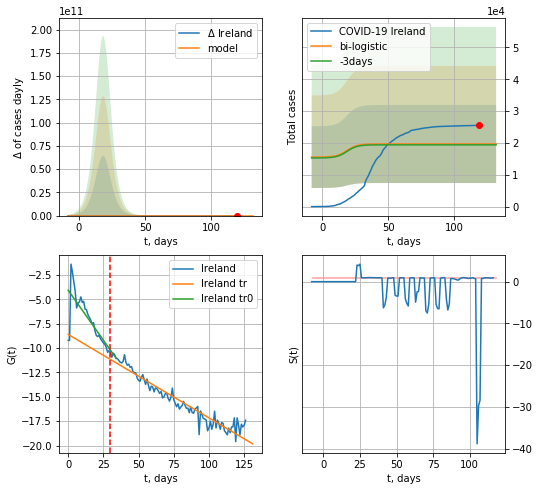

Ireland data at: 2020-07-05
+3 day model MAPE: 0.013849519212100854
model: bi-logistic
coeffs:  [ 1.24298549e+04 -1.04203902e+01  2.62559725e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6233053707354366
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  19664 ± 12257
	 total death:  1341 ± 2507
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.925586
 intercept: -8.594674
 slope: -0.085676


In [691]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,16*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


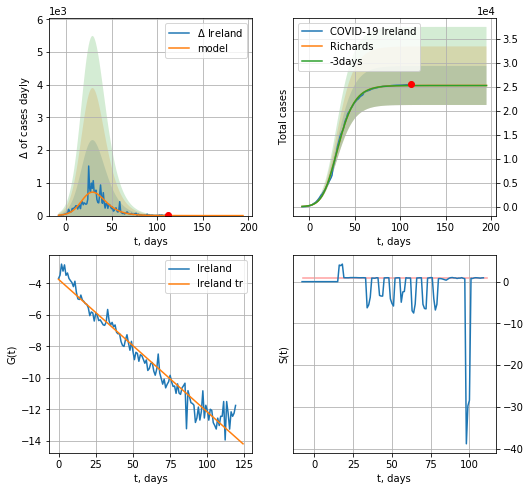

Ireland data at: 2020-07-05
+3 day model MAPE: 0.000711
model: Richards
coeffs: [2.53250062e+04 2.11040202e-01 2.09675735e+01 4.43163856e-01]
rational stdev: 0.160971
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 25325 ± 4076
	 total death: 1727 ± 833
trend coefficient of determination: 0.956157
 intercept: -3.754353
 slope: -0.084146


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


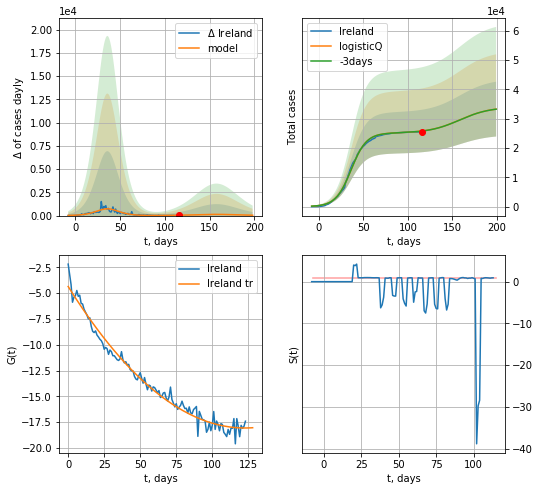

Ireland data at: 2020-07-05
+3 day model MAPE: 0.001050
model: logisticQ
coeffs: [ 2.51130340e+04  6.99937202e-07  3.62551174e+01 -1.66386676e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.280975
forecast at the end of period: +83 days
	 deltaDaycases: 40
	 total cases: 33268 ± 9347
	 total death: 2268 ± 1911
trend coefficient of determination: 0.979159
 intercept_: -4.364905883240478
 coeffs_: [ 0.         -0.22345231  0.00091123]


In [692]:
ivL = 7
vL = 90 + ivL
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Ireland',dfIR[7:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
120 2020-07-01  282043   30847  5753.0
121 2020-07-02  284541   29374  5920.0
122 2020-07-03  288089   28695  6051.0
123 2020-07-04  291847   28210  6192.0
124 2020-07-05  295532   28192  6308.0


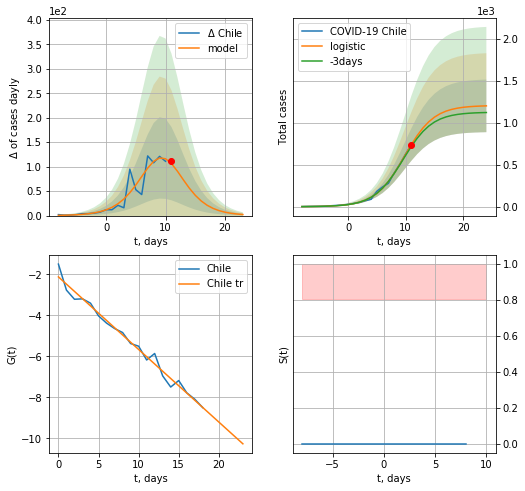

Chile data at: 2020-07-05
+3 day model MAPE: 0.03908987806693812
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +13 days
	 deltaDaycases:  2
	 total cases:  1203 ± 314
	 total death:  25 ± 19
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


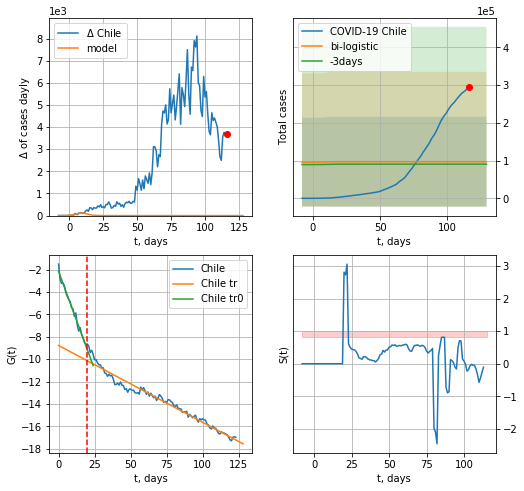

Chile data at: 2020-07-05
+3 day model MAPE: 0.07263679947398187
model: bi-logistic
coeffs:  [ 7.67088480e+04 -1.69883509e+01  4.17067463e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.226455971774072
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  97093 ± 119081
	 total death:  2072 ± 7623
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.962651
 intercept: -8.772080
 slope: -0.068695


In [694]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*16-dT)
xx = forecast2('Chile',dfCL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:62: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


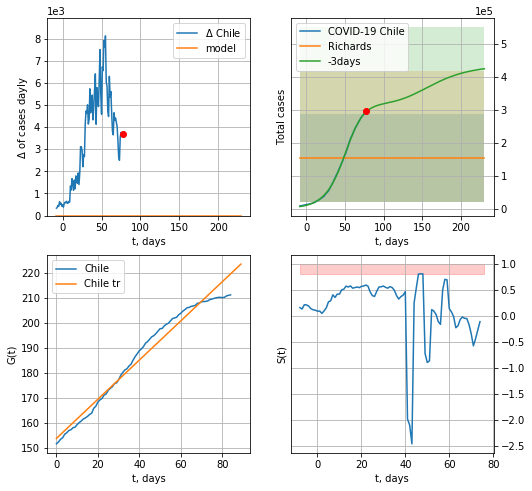

Chile data at: 2020-07-05
+3 day model MAPE: 0.480919
model: Richards
coeffs: [ 1.12114826e+05 -1.05414860e-01 -2.10986154e+01 -1.71123562e+01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.868600
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 152747 ± 132676
	 total death: 3260 ± 8494
trend coefficient of determination: 0.972032
 intercept: 153.647639
 slope: 0.784889


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


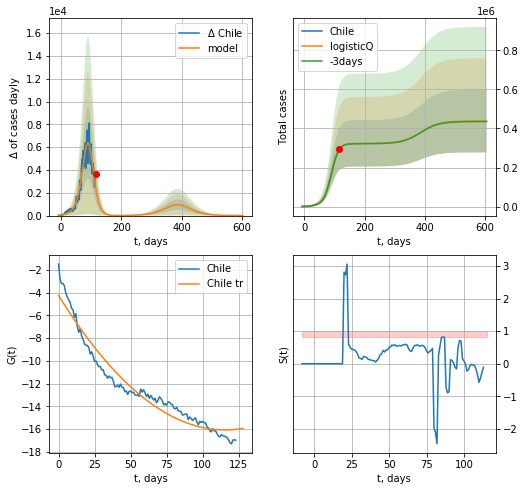

Chile data at: 2020-07-05
+3 day model MAPE: 0.002905
model: logisticQ
coeffs: [ 3.23534522e+05  1.79473829e-04  8.86821735e+01 -3.49019752e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366636
forecast at the end of period: +489 days
	 deltaDaycases: 2
	 total cases: 438057 ± 160607
	 total death: 9350 ± 10284
trend coefficient of determination: 0.947052
 intercept_: -4.2573027084815624
 coeffs_: [ 0.         -0.20479451  0.00088702]


In [695]:
vL = 20+10
x = forecastRR('Chile',dfCL[39:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

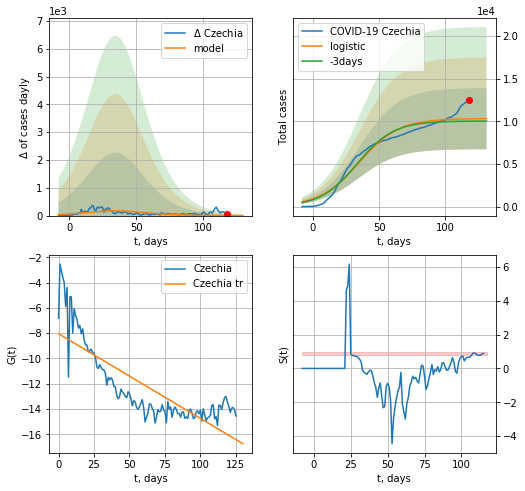

Czechia data at: 2020-07-05
+3 day model MAPE: 0.02734714442297486
model: logistic
coeffs:  [1.03213907e+04 6.70012626e-02 3.49717384e+01]
rational stdev:  0.3477468269988806
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  10304 ± 3583
	 total death:  286 ± 298
trend coefficient of determination: 0.653092
 intercept: -8.044403
 slope: -0.067019


In [696]:
x = forecast('Czechia',dfCH[:],d1,16*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


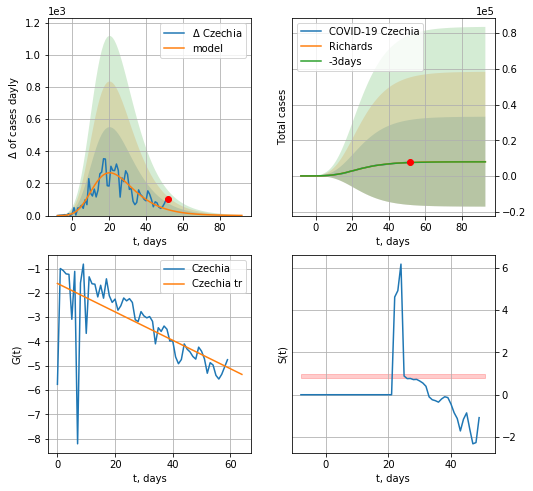

Czechia data at: 2020-07-05
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936728e+03  1.90702295e+00 -1.17113715e+01  4.87284384e-02]
rational stdev: 3.153560
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 7979 ± 25164
	 total death: 221 ± 2090
trend coefficient of determination: 0.449014
 intercept: -1.614154
 slope: -0.058414


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


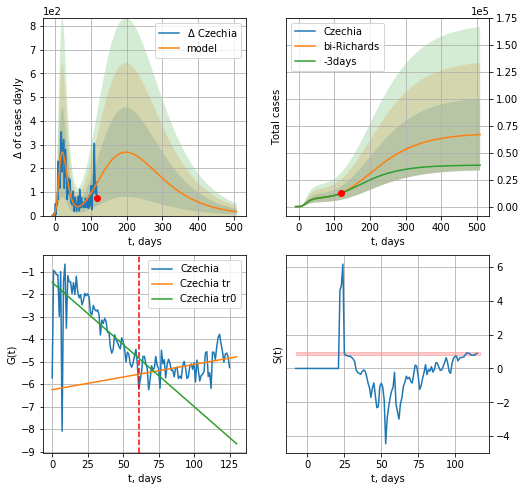

Czechia data at: 2020-07-05
+3 day model MAPE: 0.014657
model: bi-Richards
coeffs: [ 6.02325623e+04  7.60580568e-01 -1.40856749e+02  1.60147977e-02]
rational stdev: 0.497701
forecast at the end of period: +391 days
	 deltaDaycases: 16
	 total cases: 66864 ± 33278
	 total death: 1859 ± 2775
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.427017
 intercept: -1.484316
 slope: -0.055154
trend coefficient of determination: 0.158094
 intercept: -6.249253
 slope: 0.011224


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


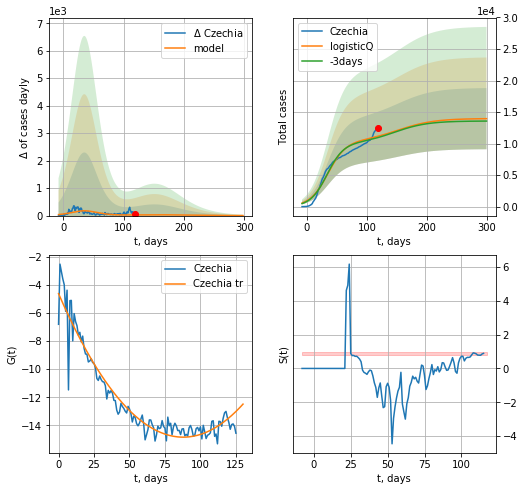

Czechia data at: 2020-07-05
+3 day model MAPE: 0.018791
model: logisticQ
coeffs: [ 1.03214639e+04  8.12723553e-08  3.49734138e+01 -8.24127778e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347773
forecast at the end of period: +181 days
	 deltaDaycases: 0
	 total cases: 13951 ± 4851
	 total death: 387 ± 403
trend coefficient of determination: 0.922134
 intercept_: -4.62882096185815
 coeffs_: [ 0.         -0.23229173  0.00132219]


In [699]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

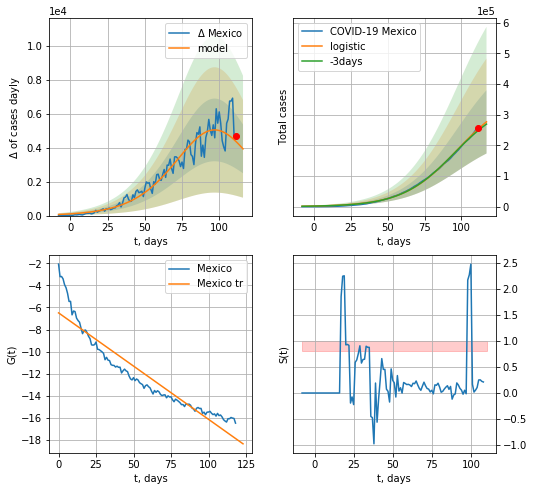

Mexico data at: 2020-07-05
+3 day model MAPE: 0.02084178927707552
model: logistic
coeffs:  [3.68965147e+05 5.43996862e-02 9.72139697e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37336756822584954
forecast at the end of period: +6 days
	 deltaDaycases:  3926
	 total cases:  276522 ± 103244
	 total death:  32985 ± 36946
trend coefficient of determination: 0.887451
 intercept: -6.488276
 slope: -0.096280


In [700]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


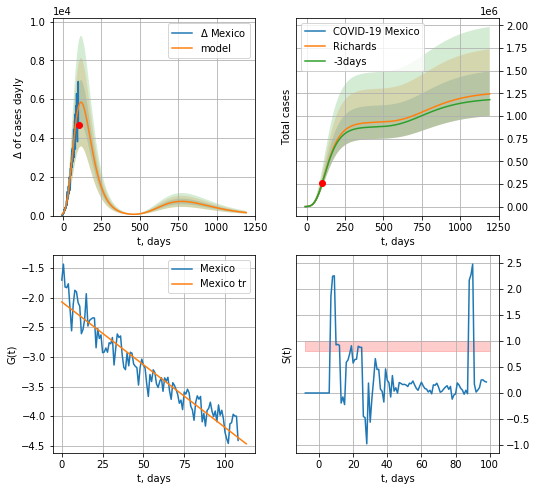

Mexico data at: 2020-07-05
+3 day model MAPE: 0.005223
model: Richards
coeffs: [ 9.33132939e+05  5.33755362e-01 -8.10946120e+01  3.24052906e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.197850
forecast at the end of period: +1091 days
	 deltaDaycases: 154
	 total cases: 1244158 ± 246156
	 total death: 148413 ± 88090
trend coefficient of determination: 0.912451
 intercept: -2.074286
 slope: -0.021160


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


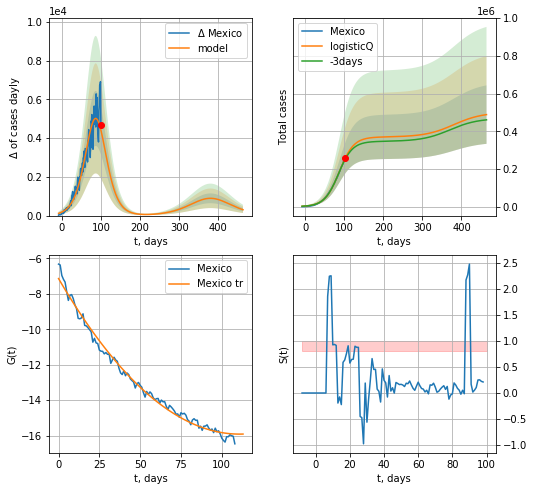

Mexico data at: 2020-07-05
+3 day model MAPE: 0.021103
model: logisticQ
coeffs: [ 3.69428588e+05  1.06730539e-06  8.72662956e+01 -5.08389218e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317693
forecast at the end of period: +363 days
	 deltaDaycases: 303
	 total cases: 488177 ± 155090
	 total death: 58233 ± 55500
trend coefficient of determination: 0.989815
 intercept_: -7.137735510993936
 coeffs_: [ 0.         -0.15825677  0.00071348]


In [701]:
x = forecastRR('Mexico',dfMX[10:],d1,170*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
114 2020-07-01  1825.0     211   78.0  432457.0
115 2020-07-02  1828.0     199   78.0  436679.0
116 2020-07-03  1831.0     196   79.0  439451.0
117 2020-07-04  1836.0     201   79.0  442242.0
118 2020-07-05  1841.0     215   79.0       NaN


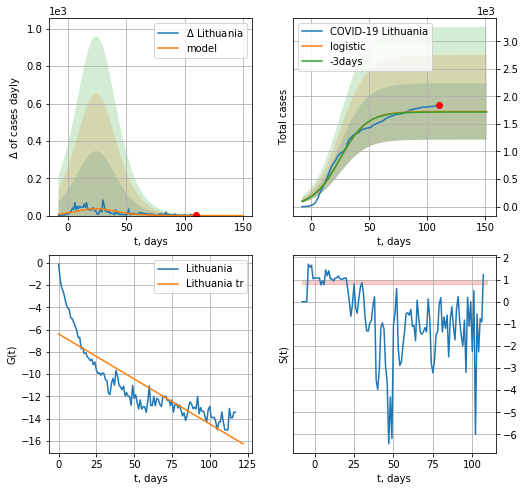

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.005523344132676919
model: logistic
coeffs:  [1.72637031e+03 8.56579578e-02 2.46640397e+01]
rational stdev:  0.29611845478407045
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1726 ± 511
	 total death:  74 ± 65
trend coefficient of determination: 0.739336
 intercept: -6.376675
 slope: -0.081009


In [702]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [703]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [704]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


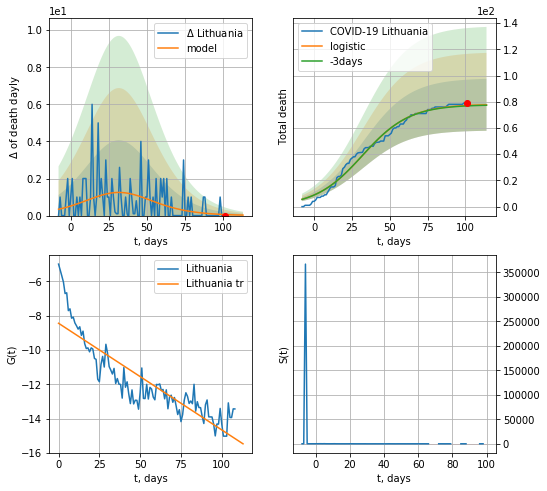

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.0039979916942615235
model: logistic
coeffs:  [7.80637970e+01 6.39796499e-02 3.20212846e+01]
rational stdev:  0.2551373550892002
forecast at the end of period: +13 days
	 total death:  77 ± 19
trend coefficient of determination: 0.770707
 intercept: -8.443968
 slope: -0.062042


In [706]:
x = forecast('Lithuania',dfLT[9:],d1,7*16-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


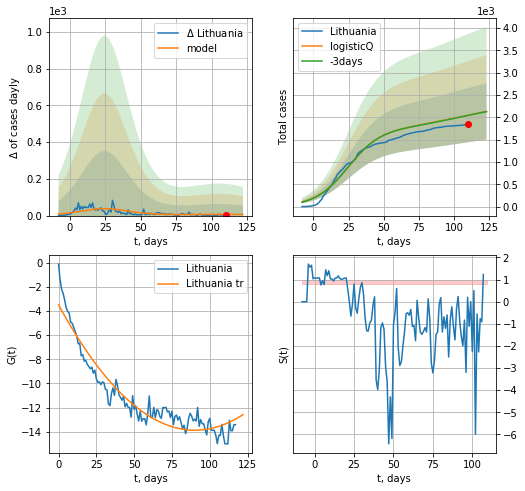

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.002185
model: logisticQ
coeffs: [ 1.72637458e+03  1.54029613e-07  2.46651665e+01 -5.55903111e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.296143
forecast at the end of period: +13 days
	 deltaDaycases: 5
	 total cases: 2130 ± 630
	 total death: 91 ± 80
trend coefficient of determination: 0.910336
 intercept_: -3.484369161612732
 coeffs_: [ 0.         -0.23061485  0.00127869]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


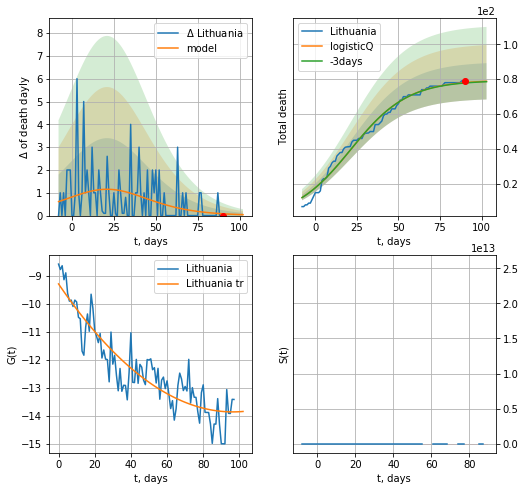

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.002474
model: logisticQ
coeffs: [ 7.94622943e+01  3.66832307e-07  2.13644047e+01 -1.58336505e+05]
rational stdev: 0.131891
forecast at the end of period: +13 days
	 total death: 78 ± 10
trend coefficient of determination: 0.824080
 intercept_: -9.298570460735519
 coeffs_: [ 0.         -0.09486708  0.00049211]


In [707]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


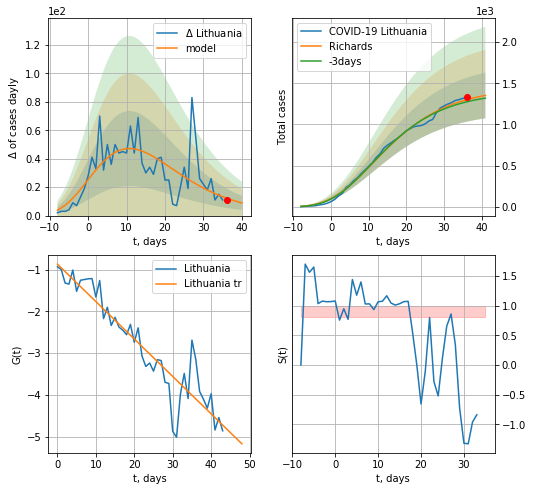

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.45212959e+03  9.67658542e+00 -4.16678055e+01  9.16998413e-03]
rational stdev: 0.205046
forecast at the end of period: +5 days
	 deltaDaycases: 8
	 total cases: 1352 ± 277
	 total death: 58 ± 35
trend coefficient of determination: 0.866665
 intercept: -0.867769
 slope: -0.089640


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


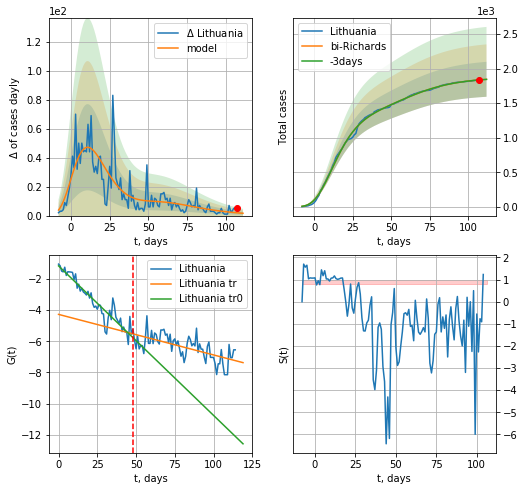

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.000681
model: bi-Richards
coeffs: [4.23793057e+02 6.09551655e-01 1.52250587e+01 8.53818953e-02]
rational stdev: 0.136975
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 1844 ± 252
	 total death: 79 ± 32
bi-Richards approximation splitting point: 48
trend coefficient of determination: 0.885754
 intercept: -1.167158
 slope: -0.095886
trend coefficient of determination: 0.409217
 intercept: -4.277462
 slope: -0.026004


In [708]:
vL = 48+3
x = forecastRR('Lithuania',dfLT[3:vL-3],d1,15*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,15*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-3)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


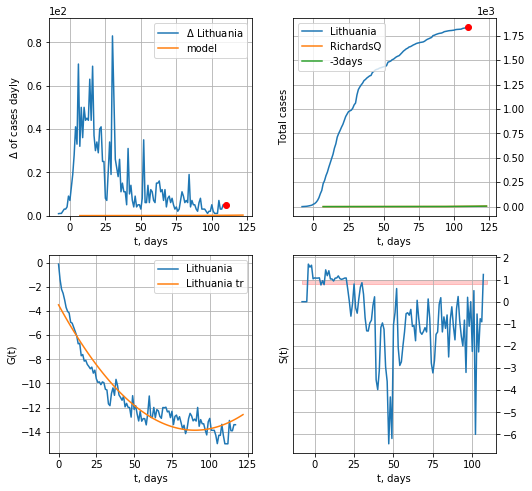

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 4.54139979e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +13 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [709]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
116 2020-07-01  4345.0     232  110.0
117 2020-07-02  4395.0     273  110.0
118 2020-07-03  4447.0     321  110.0
119 2020-07-04  4476.0     350  110.0
120 2020-07-05  4522.0     396  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


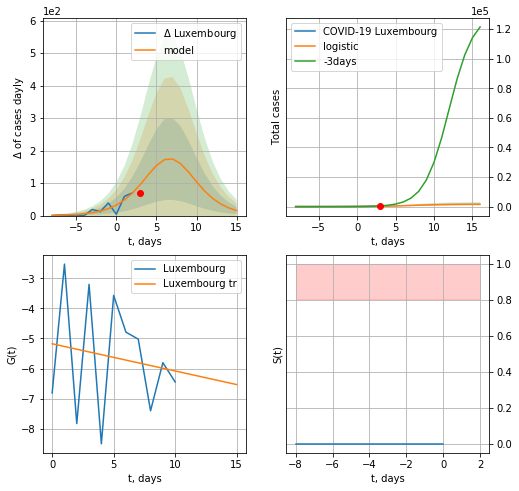

Luxembourg data at: 2020-07-05
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +13 days
	 deltaDaycases:  15
	 total cases:  1534 ± 493
	 total death:  37 ± 35
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


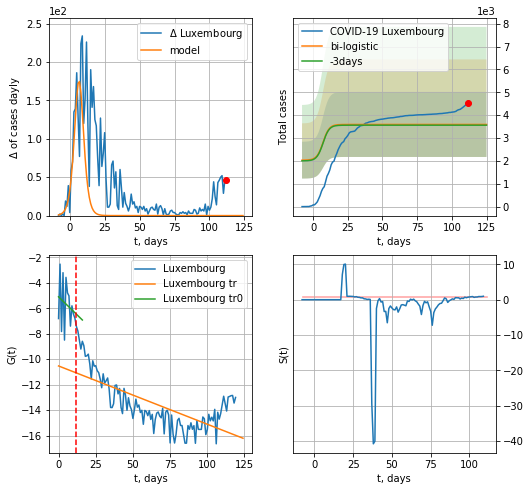

Luxembourg data at: 2020-07-05
+3 day model MAPE: 0.0089172214965484
model: bi-logistic
coeffs:  [1807.37301751   -6.89742235  251.52991968] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.3953748209013406
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  3596 ± 1421
	 total death:  87 ± 103
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.486688
 intercept: -10.530918
 slope: -0.045792


In [710]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,16*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,16*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


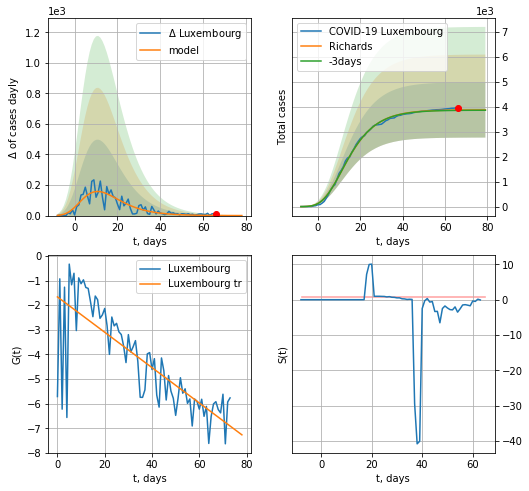

Luxembourg data at: 2020-07-05
+3 day model MAPE: 0.003345
model: Richards
coeffs: [ 3.88162927e+03  1.99569941e+01 -3.56216724e+01  5.55736951e-03]
rational stdev: 0.285969
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 3879 ± 1109
	 total death: 94 ± 80
trend coefficient of determination: 0.626779
 intercept: -1.663811
 slope: -0.071855


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


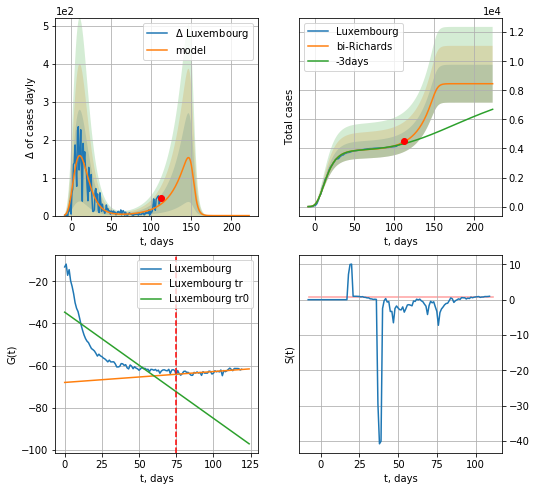

Luxembourg data at: 2020-07-05
+3 day model MAPE: 0.030508
model: bi-Richards
coeffs: [4.57459577e+03 5.19371719e-02 1.52250837e+02 6.78701677e+00]
rational stdev: 0.154075
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 8456 ± 1302
	 total death: 205 ± 94
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.641959
 intercept: -34.659117
 slope: -0.503928
trend coefficient of determination: 0.466781
 intercept: -68.011708
 slope: 0.051692


In [714]:
vL = 75
x = forecastRR("Luxembourg",dfLX[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


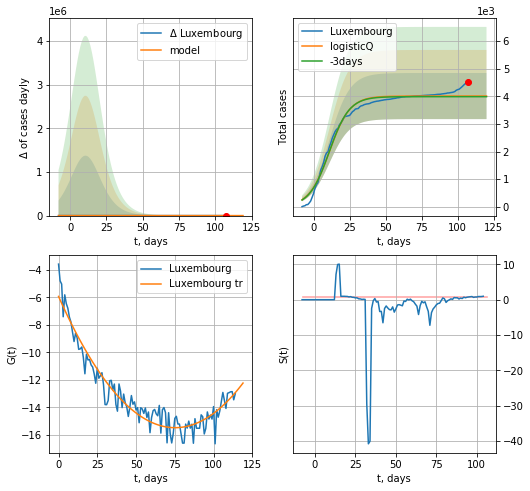

Luxembourg data at: 2020-07-05
+3 day model MAPE: 0.005681
model: logisticQ
coeffs: [ 4.00892342e+03  3.35329728e-07  1.10302847e+01 -4.22041835e+05]
rational stdev: 0.208106
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 4008 ± 834
	 total death: 97 ± 60
trend coefficient of determination: 0.919773
 intercept_: -5.922973904685283
 coeffs_: [ 0.         -0.25410872  0.00169022]


In [715]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
123 2020-07-01  58257.0  25794.0  4576.0
124 2020-07-02  59468.0  26797.0  4639.0
125 2020-07-03  60657.0  27566.0  4700.0
126 2020-07-04  61535.0  28259.0  4769.0
127 2020-07-05  61958.0  28455.0  4781.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


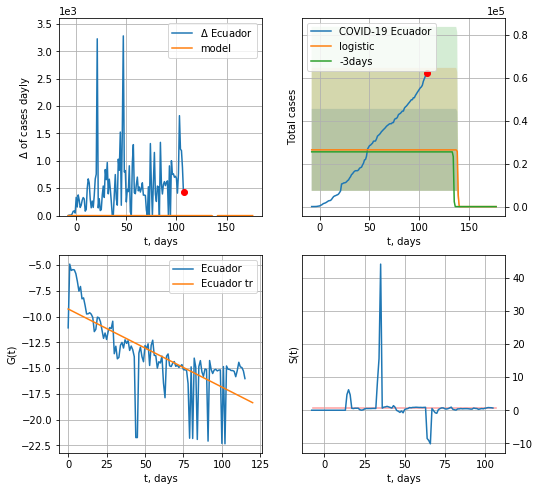

Ecuador data at: 2020-07-05
+3 day model MAPE: 0.0361505872480512
model: logistic
coeffs:  [ 2.63924193e+04 -4.84378397e+00  1.38718553e+02]
rational stdev:  0.7222456803120155
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.528739
 intercept: -9.257565
 slope: -0.075868


In [716]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


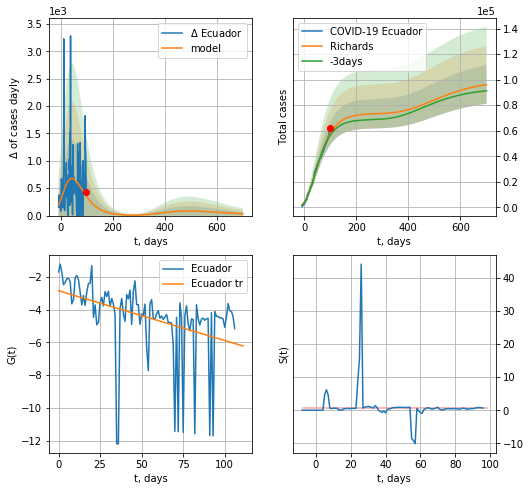

Ecuador data at: 2020-07-05
+3 day model MAPE: 0.025118
model: Richards
coeffs: [ 7.34780050e+04  1.58872230e+00 -1.19628931e+02  1.59500658e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.156547
forecast at the end of period: +601 days
	 deltaDaycases: 31
	 total cases: 96111 ± 15045
	 total death: 7416 ± 3482
trend coefficient of determination: 0.165224
 intercept: -2.855654
 slope: -0.030330


In [717]:
x = forecastRR("Ecuador",dfED[20:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


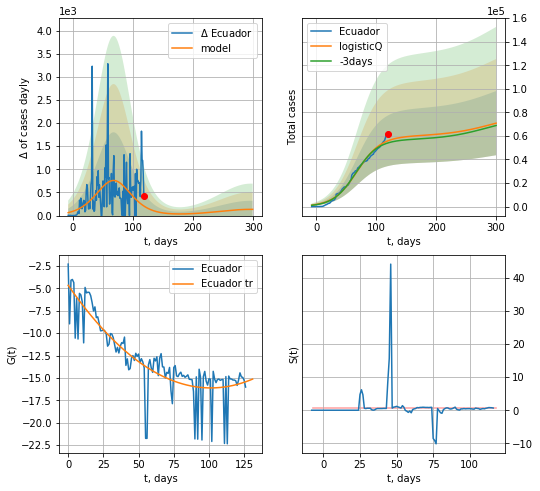

Ecuador data at: 2020-07-05
+3 day model MAPE: 0.033993
model: logisticQ
coeffs: [ 5.97571312e+04  1.84218018e-07  6.79560130e+01 -2.75180555e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384439
forecast at the end of period: +181 days
	 deltaDaycases: 134
	 total cases: 70852 ± 27238
	 total death: 5467 ± 6305
trend coefficient of determination: 0.725348
 intercept_: -4.663964900610019
 coeffs_: [ 0.         -0.22623827  0.00111702]


In [718]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
127 2020-07-01  7241.0     213  328.0
128 2020-07-02  7241.5     213  328.0
129 2020-07-03  7242.0     213  329.0
130 2020-07-04  7248.0     219  329.0
131 2020-07-05  7253.0     224  329.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


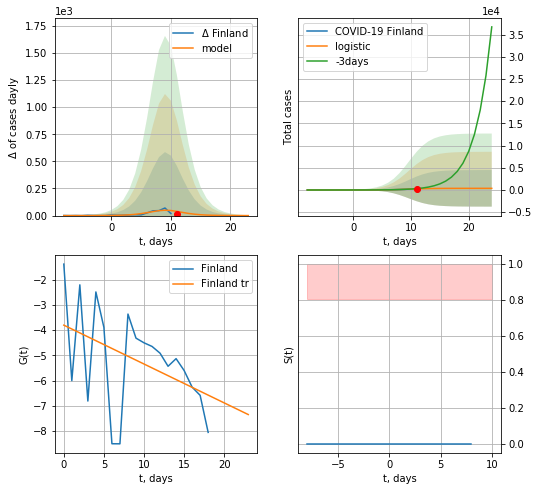

Finland data at: 2020-07-05
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  373 ± 4114
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


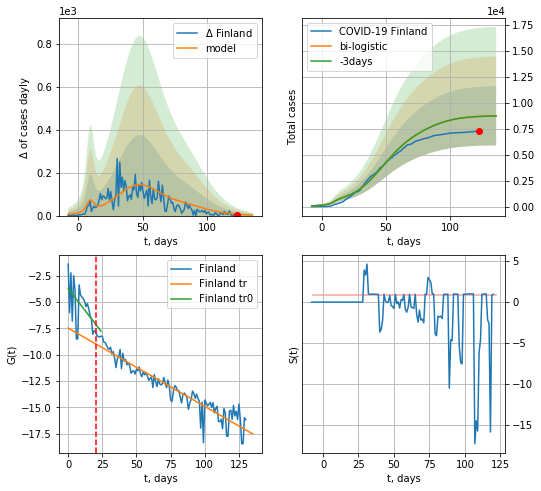

Finland data at: 2020-07-05
+3 day model MAPE: 0.0019597783310963137
model: bi-logistic
coeffs:  [6.73324393e+03 8.23346804e-02 4.69092788e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.32591116056972036
forecast at the end of period: +13 days
	 deltaDaycases:  2
	 total cases:  8761 ± 2855
	 total death:  397 ± 388
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.897293
 intercept: -7.469457
 slope: -0.074451


In [719]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*16-dT)
xx = forecast2("Finland",dfFI[:],d1,16*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


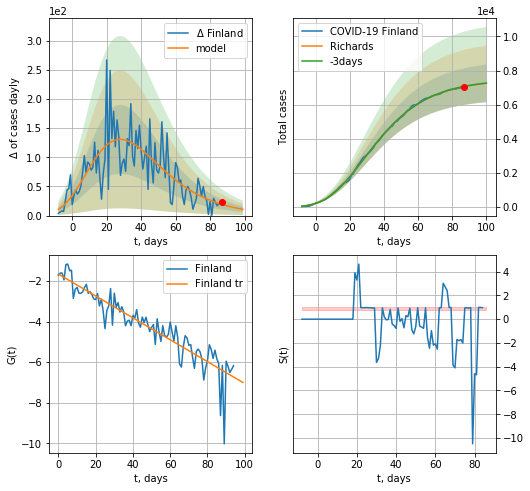

Finland data at: 2020-07-05
+3 day model MAPE: 0.001718
model: Richards
coeffs: [ 7.46745345e+03  8.75042301e-01 -3.06186517e+01  5.59118542e-02]
rational stdev: 0.152333
forecast at the end of period: +13 days
	 deltaDaycases: 10
	 total cases: 7246 ± 1103
	 total death: 328 ± 149
trend coefficient of determination: 0.846419
 intercept: -1.660591
 slope: -0.053972


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp


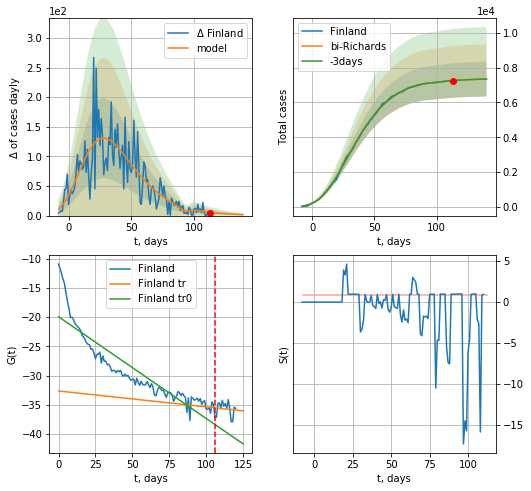

Finland data at: 2020-07-05
+3 day model MAPE: 0.000025
model: bi-Richards
coeffs: [-95.47993625   0.15234626  95.79807328   3.18652392]
rational stdev: 0.136095
forecast at the end of period: +27 days
	 deltaDaycases: 1
	 total cases: 7340 ± 998
	 total death: 332 ± 135
bi-Richards approximation splitting point: 106
trend coefficient of determination: 0.821028
 intercept: -19.944638
 slope: -0.173875
trend coefficient of determination: 0.009556
 intercept: -32.640029
 slope: -0.027189


In [720]:
vL = 106 + 10
x = forecastRR("Finland",dfFI[10:vL-10],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


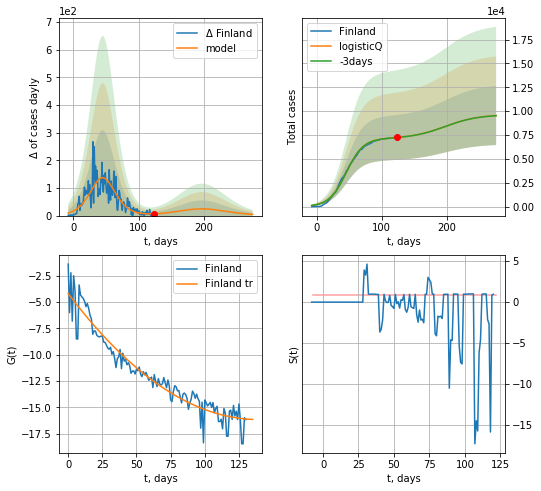

Finland data at: 2020-07-05
+3 day model MAPE: 0.001803
model: logisticQ
coeffs: [ 7.13486506e+03  3.51158737e-07  4.53048572e+01 -2.18509869e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324332
forecast at the end of period: +153 days
	 deltaDaycases: 4
	 total cases: 9545 ± 3095
	 total death: 432 ± 420
trend coefficient of determination: 0.921964
 intercept_: -4.182060469138457
 coeffs_: [ 0.         -0.17206314  0.0006179 ]


In [721]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
113 2020-07-01   5154  2200.0  232.0
114 2020-07-02   5315  2281.0  232.0
115 2020-07-03   5497  2366.0  239.0
116 2020-07-04   5677  2538.0  241.0
117 2020-07-05   5740  2579.0  246.0


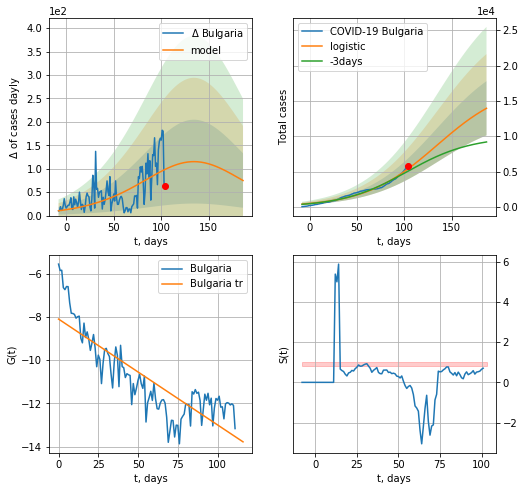

Bulgaria data at: 2020-07-05
+3 day model MAPE: 0.066487985389847
model: logistic
coeffs:  [1.74755793e+04 2.63462905e-02 1.34835408e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.275131489880237
forecast at the end of period: +83 days
	 deltaDaycases:  74
	 total cases:  13949 ± 3837
	 total death:  597 ± 492
trend coefficient of determination: 0.708223
 intercept: -8.102206
 slope: -0.048950


In [722]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


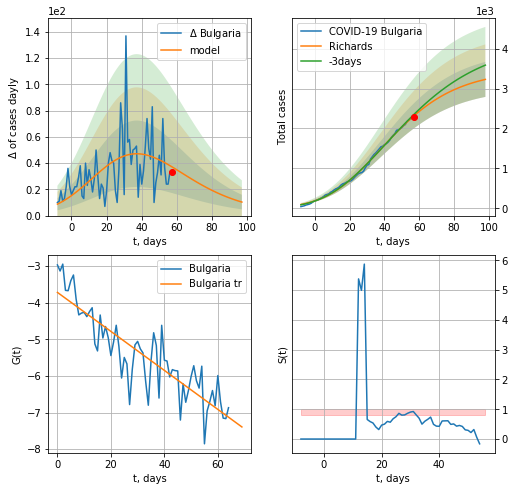

Bulgaria data at: 2020-07-05
+3 day model MAPE: 0.017234
model: Richards
coeffs: [3.47700933e+03 1.26494372e-01 1.24703961e+01 3.39631762e-01]
rational stdev: 0.135837
forecast at the end of period: +41 days
	 deltaDaycases: 10
	 total cases: 3229 ± 438
	 total death: 138 ± 56
trend coefficient of determination: 0.758376
 intercept: -3.716230
 slope: -0.053312


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


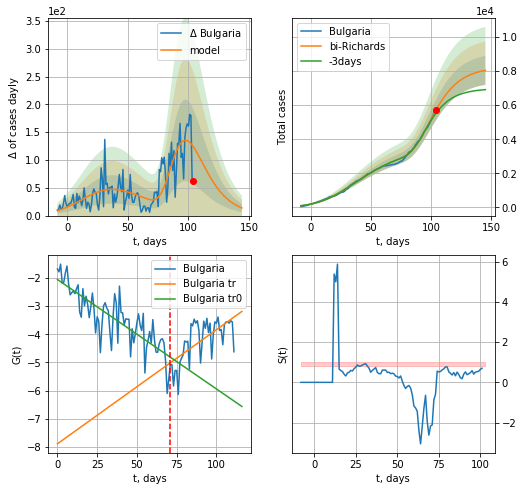

Bulgaria data at: 2020-07-05
+3 day model MAPE: 0.038347
model: bi-Richards
coeffs: [4.76917430e+03 5.63806291e+00 3.80309259e+01 1.27670075e-02]
rational stdev: 0.105825
forecast at the end of period: +41 days
	 deltaDaycases: 13
	 total cases: 8045 ± 851
	 total death: 344 ± 109
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.674587
 intercept: -2.052270
 slope: -0.038916
trend coefficient of determination: 0.431648
 intercept: -7.894096
 slope: 0.040571


In [723]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,20*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


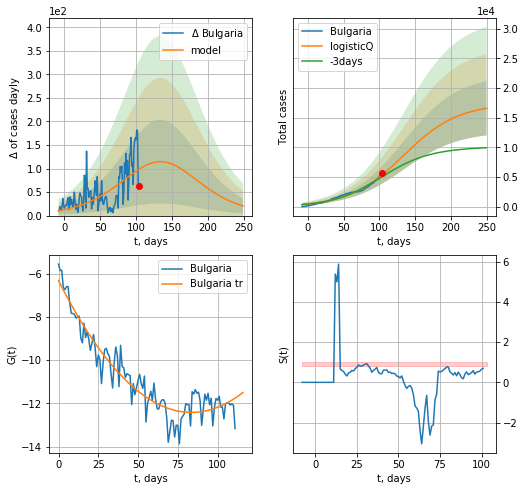

Bulgaria data at: 2020-07-05
+3 day model MAPE: 0.064477
model: logisticQ
coeffs: [ 1.72759669e+04  7.43702641e-07  1.34052330e+02 -3.54968463e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.275194
forecast at the end of period: +146 days
	 deltaDaycases: 20
	 total cases: 16589 ± 4565
	 total death: 710 ± 586
trend coefficient of determination: 0.896640
 intercept_: -6.325608818383468
 coeffs_: [ 0.         -0.14585761  0.00087305]


In [724]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
125 2020-07-01  3179.0    62.0   58.0
126 2020-07-02  3180.0    56.0   58.0
127 2020-07-03  3185.0    61.0   58.0
128 2020-07-04  3190.0    61.0   58.0
129 2020-07-05  3195.0    65.0   58.0


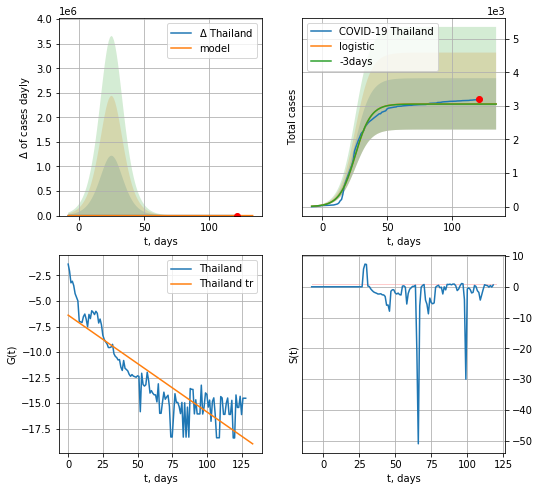

Thailand data at: 2020-07-05
+3 day model MAPE: 0.001902782732085758
model: logistic
coeffs:  [3.05963395e+03 1.65578517e-01 2.55742558e+01]
rational stdev:  0.2497182711505892
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  3059 ± 764
	 total death:  55 ± 41
trend coefficient of determination: 0.751960
 intercept: -6.388704
 slope: -0.094779


In [726]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [727]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


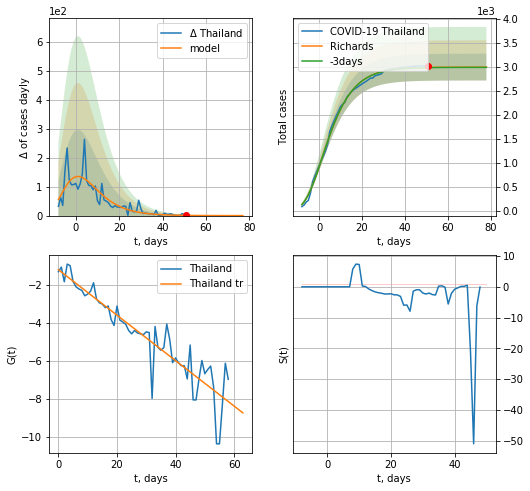

Thailand data at: 2020-07-05
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 54 ± 15
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


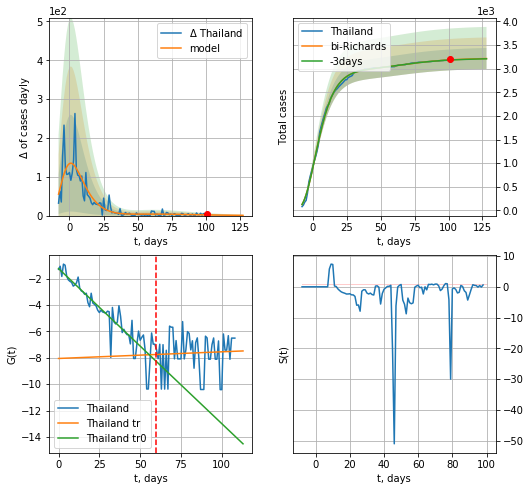

Thailand data at: 2020-07-05
+3 day model MAPE: 0.001007
model: bi-Richards
coeffs: [ 2.31420929e+02  6.63990352e+00 -4.72160676e+01  6.70198319e-03]
rational stdev: 0.069382
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 3213 ± 222
	 total death: 58 ± 12
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843242
 intercept: -1.241648
 slope: -0.117525
trend coefficient of determination: 0.002379
 intercept: -8.054966
 slope: 0.005046


In [728]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


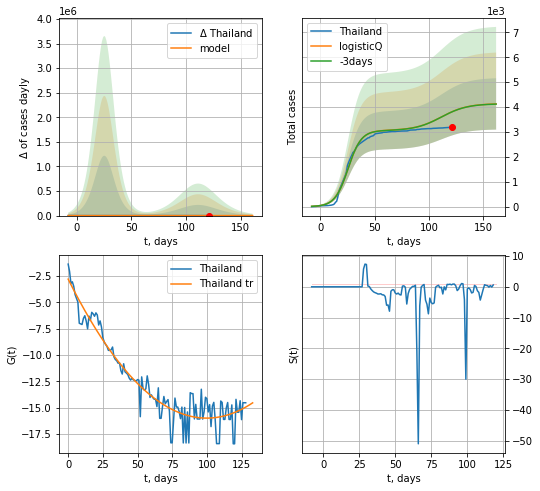

Thailand data at: 2020-07-05
+3 day model MAPE: 0.000752
model: logisticQ
coeffs: [ 3.05962998e+03  5.24444726e-07  2.55744537e+01 -3.15588324e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.249892
forecast at the end of period: +41 days
	 deltaDaycases: 1
	 total cases: 4127 ± 1031
	 total death: 74 ± 55
trend coefficient of determination: 0.914012
 intercept_: -2.8098181938452633
 coeffs_: [ 0.         -0.26386358  0.00132098]


In [729]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

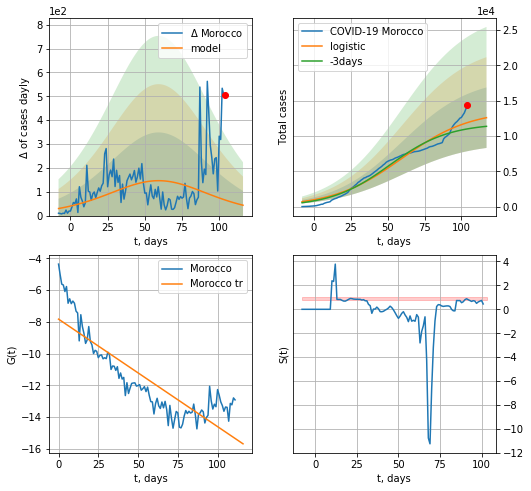

Morocco data at: 2020-07-05
+3 day model MAPE: 0.0828615566082909
model: logistic
coeffs:  [1.36826815e+04 4.27876867e-02 5.96693313e+01]
rational stdev:  0.33980911304616646
forecast at the end of period: +13 days
	 deltaDaycases:  43
	 total cases:  12598 ± 4281
	 total death:  206 ± 210
trend coefficient of determination: 0.750233
 intercept: -7.826773
 slope: -0.067676


In [730]:
x = forecast("Morocco",dfMR[5:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


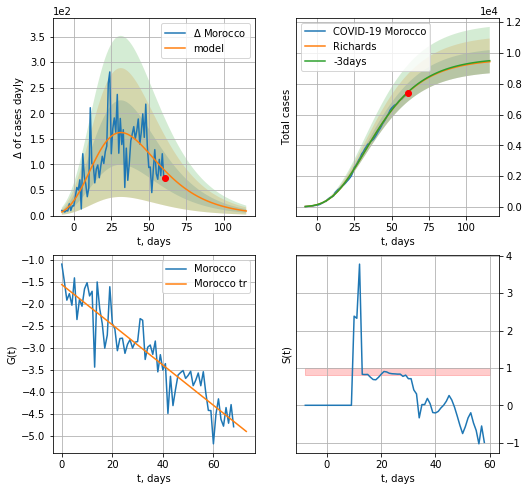

Morocco data at: 2020-07-05
+3 day model MAPE: 0.002855
model: Richards
coeffs: [ 9.62196675e+03  2.25668236e+00 -5.19496574e+01  2.05516980e-02]
rational stdev: 0.079909
forecast at the end of period: +55 days
	 deltaDaycases: 9
	 total cases: 9430 ± 753
	 total death: 154 ± 36
trend coefficient of determination: 0.846109
 intercept: -1.563197
 slope: -0.045646


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


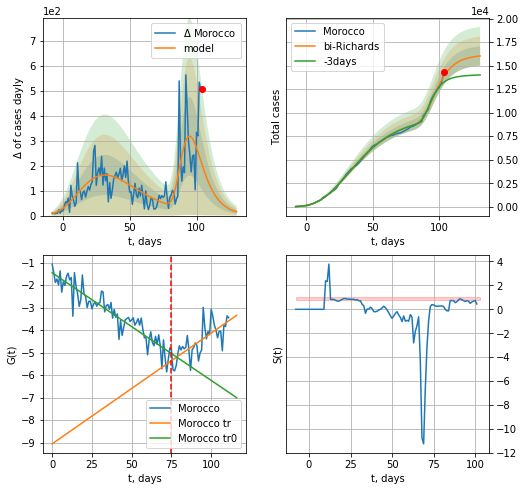

Morocco data at: 2020-07-05
+3 day model MAPE: 0.057236
model: bi-Richards
coeffs: [6.58891781e+03 1.04877365e+01 5.92669359e+01 1.17120612e-02]
rational stdev: 0.064184
forecast at the end of period: +27 days
	 deltaDaycases: 15
	 total cases: 16031 ± 1028
	 total death: 262 ± 50
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.861108
 intercept: -1.454431
 slope: -0.047833
trend coefficient of determination: 0.520047
 intercept: -9.053700
 slope: 0.049208


In [731]:
vL = 75 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


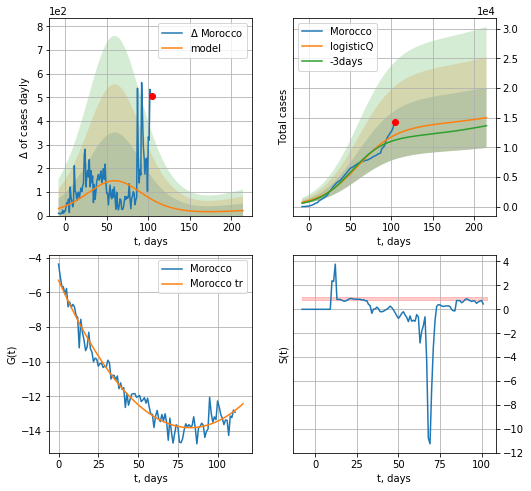

Morocco data at: 2020-07-05
+3 day model MAPE: 0.078650
model: logisticQ
coeffs: [ 1.36805308e+04  1.46865444e-07  5.96619124e+01 -2.91205196e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339841
forecast at the end of period: +111 days
	 deltaDaycases: 21
	 total cases: 14995 ± 5096
	 total death: 245 ± 249
trend coefficient of determination: 0.962299
 intercept_: -5.2949408160734714
 coeffs_: [ 0.         -0.20577958  0.00124419]


In [732]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

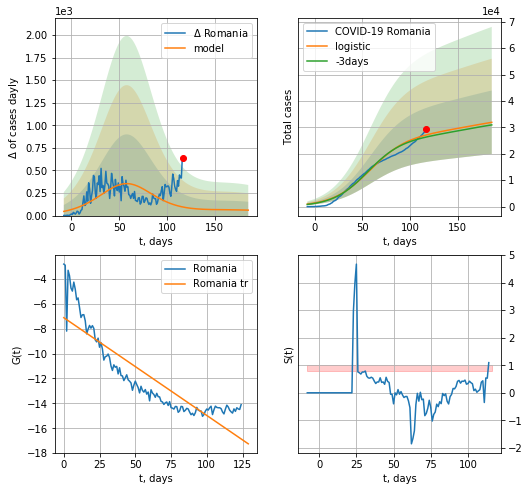

Romania data at: 2020-07-05
+3 day model MAPE: 0.030058123536046002
model: logistic
coeffs:  [2.65433191e+04 5.17149170e-02 5.76785941e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3772553728800869
forecast at the end of period: +69 days
	 deltaDaycases:  60
	 total cases:  31924 ± 12043
	 total death:  1931 ± 2185
trend coefficient of determination: 0.778775
 intercept: -7.110936
 slope: -0.078612


In [733]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


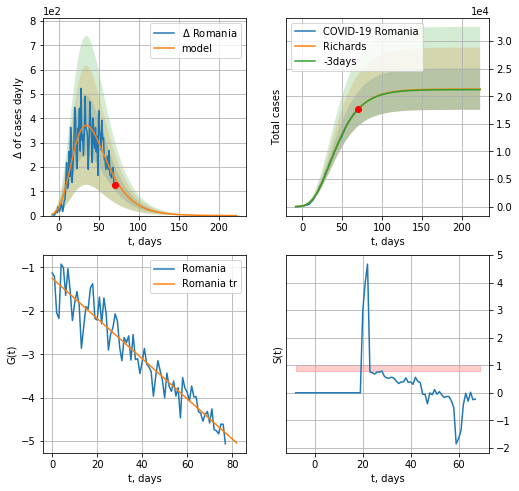

Romania data at: 2020-07-05
+3 day model MAPE: 0.002257
model: Richards
coeffs: [ 2.13025472e+04  3.80217834e+00 -5.67257576e+01  1.25517845e-02]
rational stdev: 0.176275
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 21299 ± 3754
	 total death: 1288 ± 681
trend coefficient of determination: 0.908515
 intercept: -1.251895
 slope: -0.046188


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


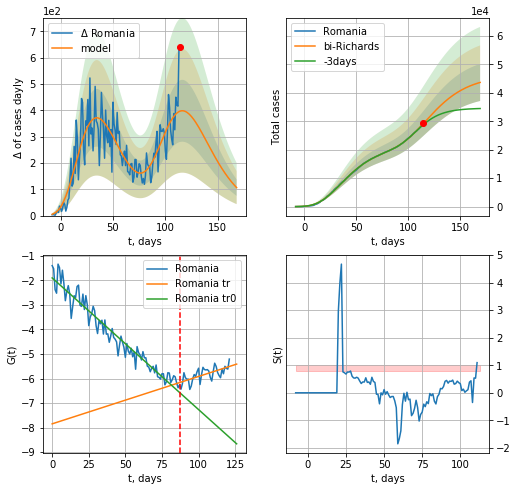

Romania data at: 2020-07-05
+3 day model MAPE: 0.015490
model: bi-Richards
coeffs: [2.48301407e+04 3.27960106e-01 7.27787453e+01 1.34891650e-01]
rational stdev: 0.149089
forecast at the end of period: +55 days
	 deltaDaycases: 106
	 total cases: 43637 ± 6505
	 total death: 2640 ± 1180
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.939534
 intercept: -1.899080
 slope: -0.053661
trend coefficient of determination: 0.448583
 intercept: -7.846174
 slope: 0.019318


In [734]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


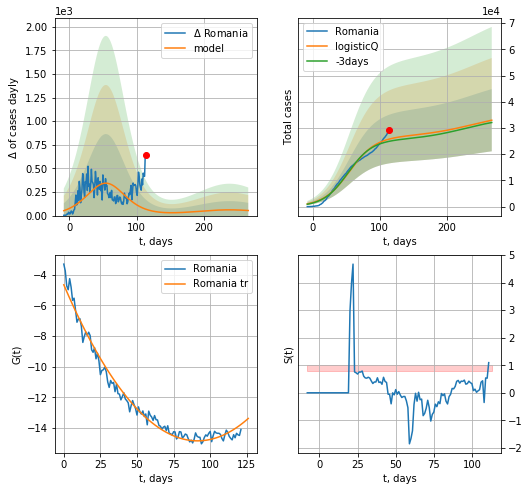

Romania data at: 2020-07-05
+3 day model MAPE: 0.034487
model: logisticQ
coeffs: [ 2.66041249e+04  1.37485582e-07  5.47953445e+01 -3.73594318e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359869
forecast at the end of period: +153 days
	 deltaDaycases: 53
	 total cases: 32957 ± 11860
	 total death: 1993 ± 2151
trend coefficient of determination: 0.980025
 intercept_: -4.65017708764728
 coeffs_: [ 0.         -0.2230907   0.00122056]


In [735]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [736]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
144 2020-07-01  1290784  159938  133331.0
145 2020-07-02  1295336  158991  133481.0
146 2020-07-03  1299510  160692  133614.0
147 2020-07-04  1302059  161413  133687.0
148 2020-07-05  1304731  161088  133771.0


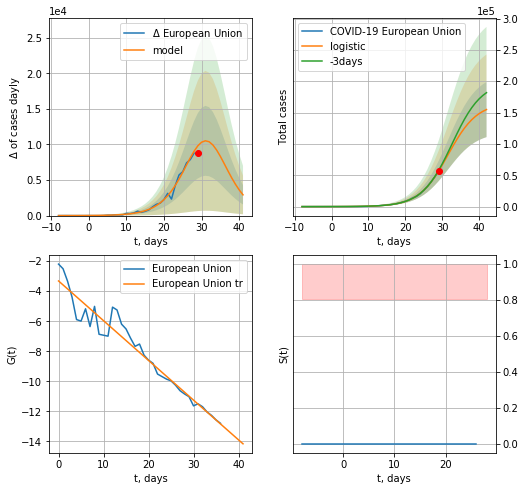

European Union data at: 2020-07-05
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +13 days
	 deltaDaycases:  2916
	 total cases:  154809 ± 43935
	 total death:  15872 ± 13513
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


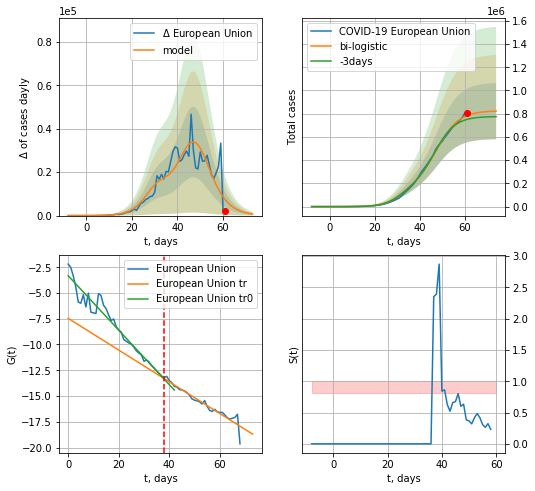

European Union data at: 2020-07-05
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +13 days
	 deltaDaycases:  718
	 total cases:  821988 ± 241737
	 total death:  84276 ± 74353
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


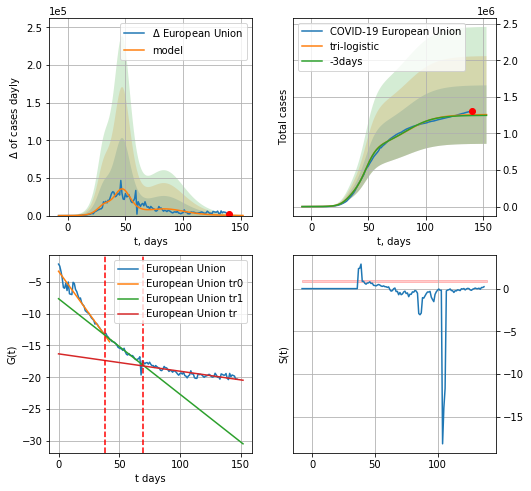

European Union data at: 2020-07-05
+3 day model MAPE: 0.007847127634850126
model: tri-logistic
coeffs:  [4.34460143e+05 8.19425655e-02 8.42963055e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.31778872137677106
forecast at the end of period: +13 days
	 deltaDaycases:  132
	 total cases:  1258126 ± 399818
	 total death:  128992 ± 122976
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.720481
 intercept: -16.319658
 slope: -0.027302


In [738]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,16*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,16*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


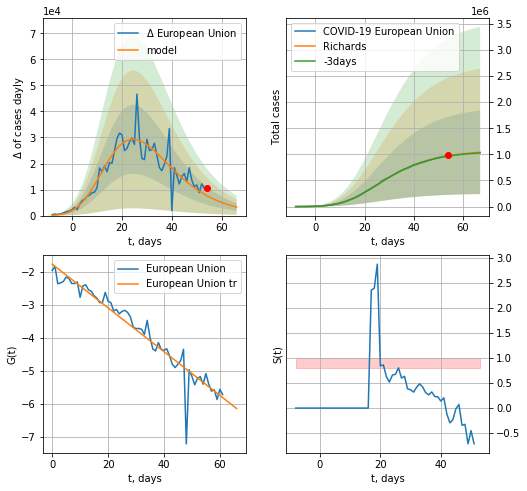

European Union data at: 2020-07-05
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +13 days
	 deltaDaycases: 3278
	 total cases: 1040293 ± 799549
	 total death: 106658 ± 245926
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


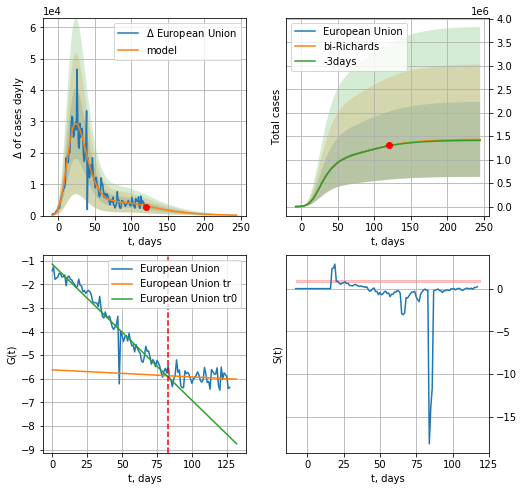

European Union data at: 2020-07-05
+3 day model MAPE: 0.003010
model: bi-Richards
coeffs: [ 3.54947676e+05  2.30567956e+00 -5.55399186e+01  1.25759712e-02]
rational stdev: 0.557572
forecast at the end of period: +125 days
	 deltaDaycases: 134
	 total cases: 1432703 ± 798835
	 total death: 146891 ± 245707
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.944029
 intercept: -1.145353
 slope: -0.057635
trend coefficient of determination: 0.017160
 intercept: -5.622132
 slope: -0.002990


In [739]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


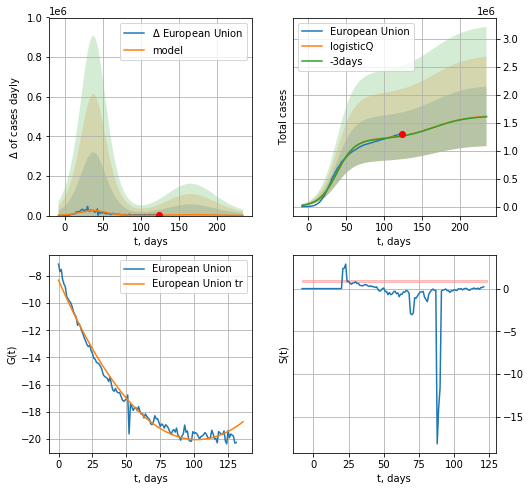

European Union data at: 2020-07-05
+3 day model MAPE: 0.005633
model: logisticQ
coeffs: [ 1.20643083e+06  1.84468487e-07  3.80216686e+01 -4.63199259e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.330021
forecast at the end of period: +111 days
	 deltaDaycases: 862
	 total cases: 1613026 ± 532332
	 total death: 165379 ± 163735
trend coefficient of determination: 0.982079
 intercept_: -8.30995333759602
 coeffs_: [ 0.         -0.23055979  0.00113109]


In [740]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


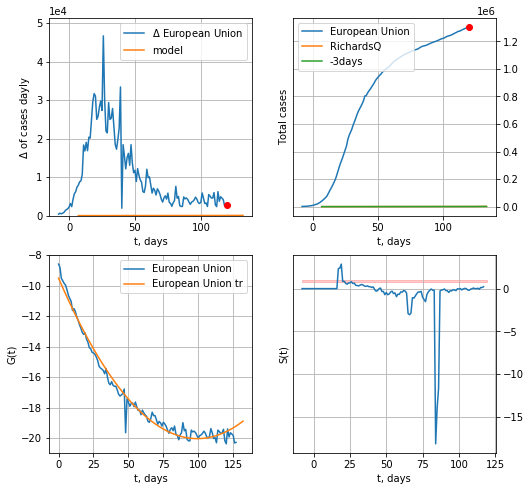

European Union data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.42779548e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: nan
forecast at the end of period: +13 days
	 deltaDaycases: 53


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [741]:
x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [287]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [288]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [289]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [290]:
#dfIC[:]

IC
           date   cases  active  death
122 2020-07-01  1847.0      14   10.0
123 2020-07-02  1850.0      12   10.0
124 2020-07-03  1855.0      13   10.0
125 2020-07-04  1860.0      17   10.0
126 2020-07-05  1863.0      20   10.0


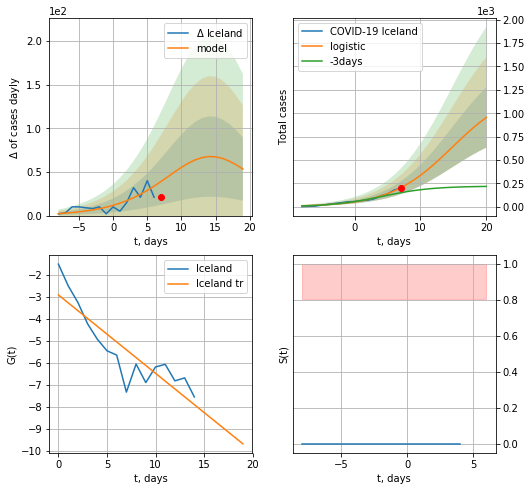

Iceland data at: 2020-07-05
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +13 days
	 deltaDaycases:  53
	 total cases:  955 ± 322
	 total death:  5 ± 5
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


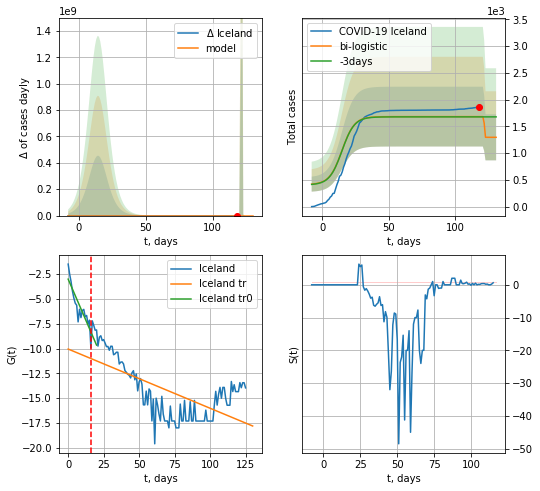

Iceland data at: 2020-07-05
+3 day model MAPE: 0.0030640022221336324
model: bi-logistic
coeffs:  [387.33273917  -7.12134066 122.10646707] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.33194333485241195
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1296 ± 430
	 total death:  6 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.420303
 intercept: -10.053814
 slope: -0.059581


In [742]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


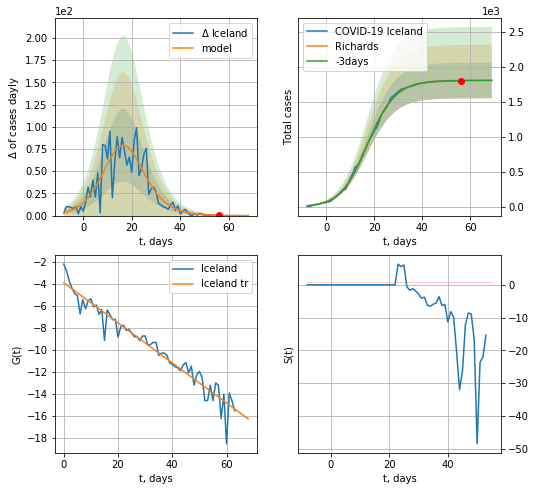

Iceland data at: 2020-07-05
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 9 ± 3
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


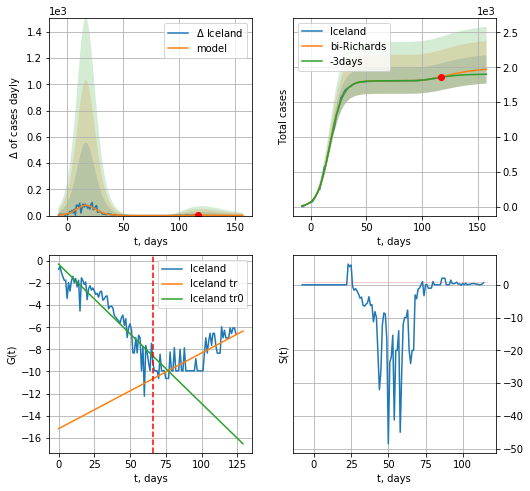

Iceland data at: 2020-07-05
+3 day model MAPE: 0.003616
model: bi-Richards
coeffs: [1.84758976e+02 2.99177208e+00 4.92906815e+01 1.86743471e-02]
rational stdev: 0.102956
forecast at the end of period: +41 days
	 deltaDaycases: 1
	 total cases: 1969 ± 202
	 total death: 10 ± 3
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.839721
 intercept: -0.283865
 slope: -0.126082
trend coefficient of determination: 0.601802
 intercept: -15.182483
 slope: 0.068519


In [743]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


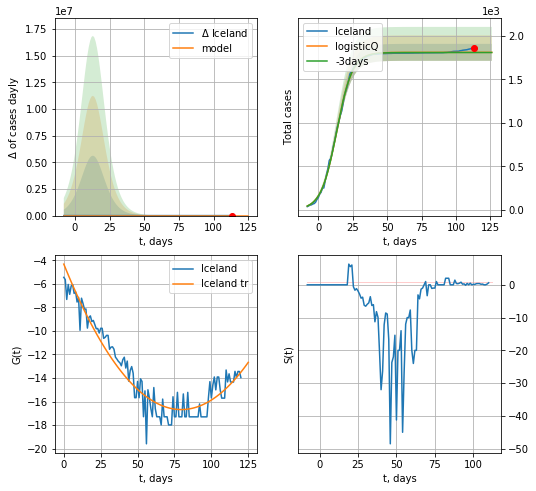

Iceland data at: 2020-07-05
+3 day model MAPE: 0.001045
model: logisticQ
coeffs: [ 1.81142964e+03  3.45757639e-06  1.34076529e+01 -5.06500361e+04]
rational stdev: 0.053933
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1811 ± 97
	 total death: 9 ± 1
trend coefficient of determination: 0.917789
 intercept_: -4.318047435868619
 coeffs_: [ 0.         -0.31051611  0.00194971]


In [744]:
x = forecastRRR("Iceland",dfIC[5:],d1,16*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active  death
113 2020-07-01  34463  17873.0  645.0
114 2020-07-02  35237  18125.0  667.0
115 2020-07-03  35995  18352.0  698.0
116 2020-07-04  36983  18502.0  720.0
117 2020-07-05  38149  19416.0  747.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


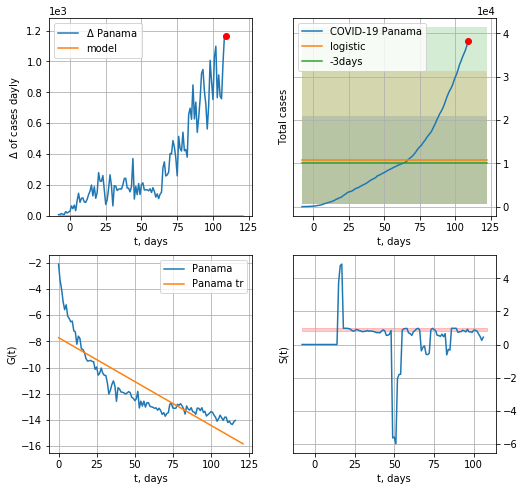

Panama data at: 2020-07-05
+3 day model MAPE: 0.06775725166525526
model: logistic
coeffs:  [ 1.07915255e+04 -8.84577560e+00  2.38338297e+02]
rational stdev:  0.9481920663019566
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  10791 ± 10232
	 total death:  211 ± 600
trend coefficient of determination: 0.741163
 intercept: -7.719439
 slope: -0.066993


In [746]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


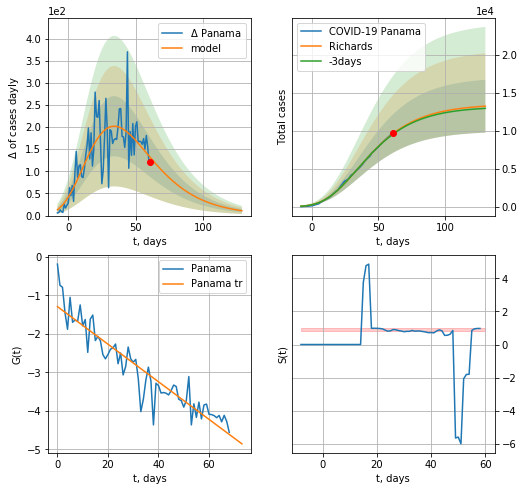

Panama data at: 2020-07-05
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +69 days
	 deltaDaycases: 11
	 total cases: 13222 ± 3479
	 total death: 258 ± 203
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


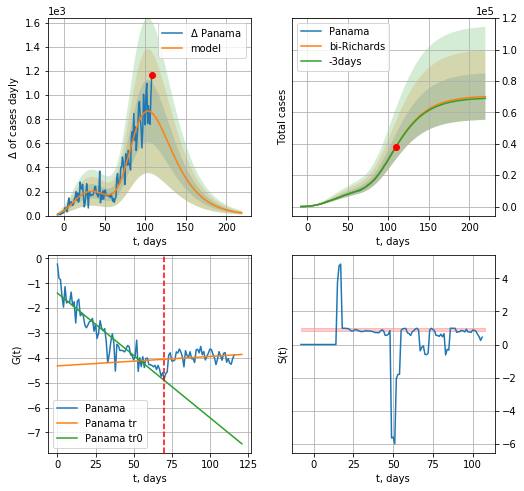

Panama data at: 2020-07-05
+3 day model MAPE: 0.004259
model: bi-Richards
coeffs: [5.71143121e+04 1.07802554e+00 2.41241171e+01 3.77130168e-02]
rational stdev: 0.211130
forecast at the end of period: +111 days
	 deltaDaycases: 21
	 total cases: 70071 ± 14794
	 total death: 1372 ± 869
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.876403
 intercept: -1.395027
 slope: -0.050105
trend coefficient of determination: 0.037215
 intercept: -4.321998
 slope: 0.003799


In [747]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


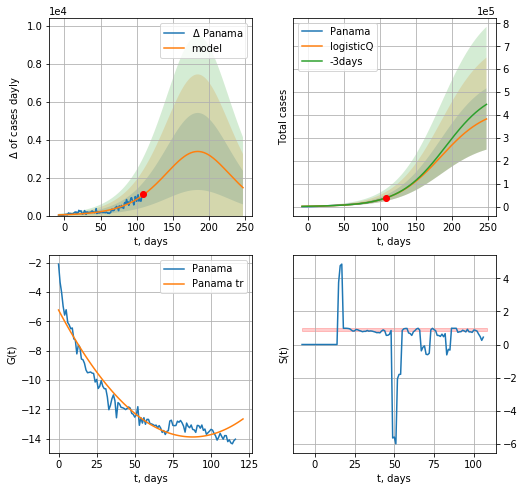

Panama data at: 2020-07-05
+3 day model MAPE: 0.004918
model: logisticQ
coeffs: [ 4.35729383e+05  1.81859419e-06  1.84632913e+02 -1.69062945e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.349947
forecast at the end of period: +139 days
	 deltaDaycases: 1475
	 total cases: 382748 ± 133941
	 total death: 7494 ± 7867
trend coefficient of determination: 0.930464
 intercept_: -5.227787331200179
 coeffs_: [ 0.         -0.19699482  0.00112072]


In [748]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

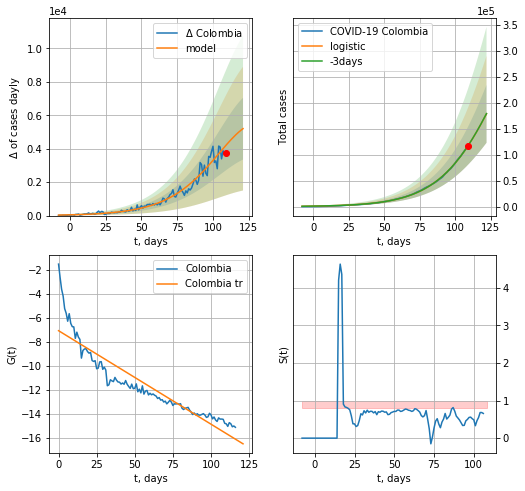

Colombia data at: 2020-07-05
+3 day model MAPE: 0.0009673423852177362
model: logistic
coeffs:  [4.73333111e+05 4.70082431e-02 1.32586148e+02]
rational stdev:  0.31223412850265364
forecast at the end of period: +13 days
	 deltaDaycases:  5201
	 total cases:  178965 ± 55879
	 total death:  6210 ± 5816
trend coefficient of determination: 0.840646
 intercept: -7.059083
 slope: -0.078019


In [750]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,16*7-dT)

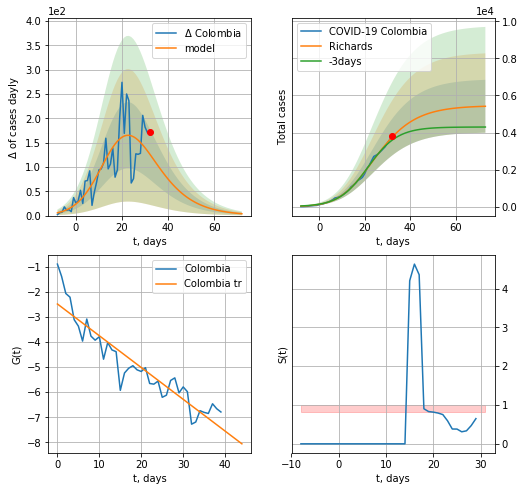

Colombia data at: 2020-07-05
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45323700e+03 2.23852153e-01 1.50939189e+01 4.47628300e-01]
rational stdev: 0.263661
forecast at the end of period: +41 days
	 deltaDaycases: 3
	 total cases: 5416 ± 1428
	 total death: 187 ± 147
trend coefficient of determination: 0.864435
 intercept: -2.485434
 slope: -0.126591


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


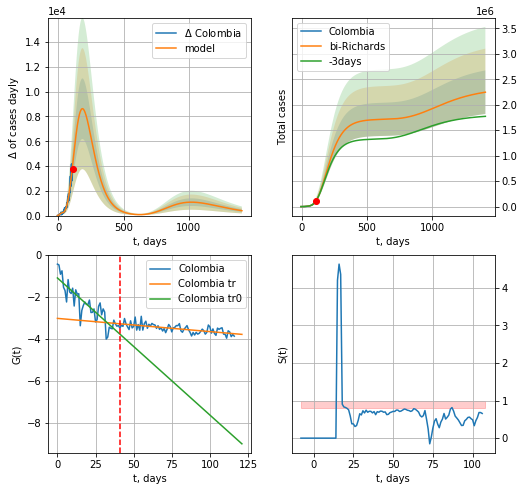

Colombia data at: 2020-07-05
+3 day model MAPE: 0.006842
model: bi-Richards
coeffs: [ 1.71049487e+06  3.87415155e-01 -5.35931672e+01  3.60235590e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.190219
forecast at the end of period: +1301 days
	 deltaDaycases: 396
	 total cases: 2245854 ± 427203
	 total death: 77936 ± 44474
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.761568
 intercept: -1.102950
 slope: -0.065163
trend coefficient of determination: 0.425510
 intercept: -3.025044
 slope: -0.006279


In [751]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,200*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


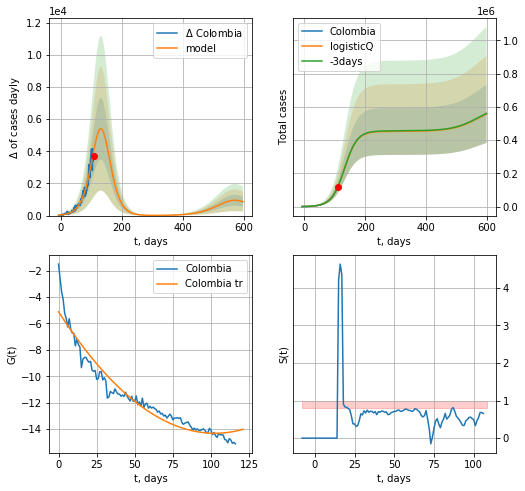

Colombia data at: 2020-07-05
+3 day model MAPE: 0.000473
model: logisticQ
coeffs: [ 4.52815797e+05  5.25108330e-06  1.31026963e+02 -8.96640837e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313082
forecast at the end of period: +489 days
	 deltaDaycases: 865
	 total cases: 557806 ± 174638
	 total death: 19357 ± 18180
trend coefficient of determination: 0.937353
 intercept_: -5.111719790760466
 coeffs_: [ 0.         -0.17962309  0.00087591]


In [752]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active  death
119 2020-07-01  14272.0  3312.0  920.0
120 2020-07-02  14657.0  3387.0  928.0
121 2020-07-03  15070.0  3301.0  937.0
122 2020-07-04  15500.0  3373.0  946.0
123 2020-07-05  15941.0  3497.0  952.0


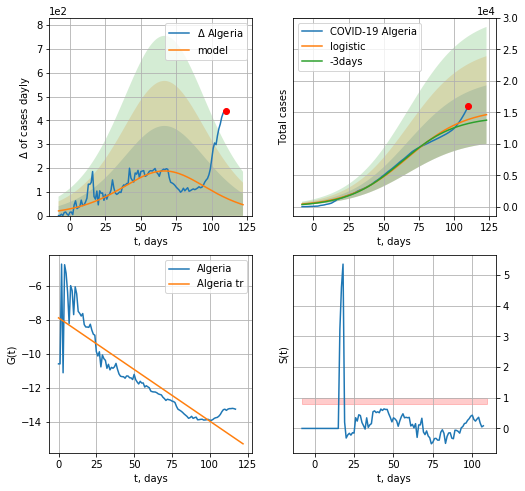

Algeria data at: 2020-07-05
+3 day model MAPE: 0.049796346862366045
model: logistic
coeffs:  [1.56200422e+04 4.80125484e-02 6.70788944e+01]
rational stdev:  0.3176206330910056
forecast at the end of period: +13 days
	 deltaDaycases:  45
	 total cases:  14622 ± 4644
	 total death:  873 ± 831
trend coefficient of determination: 0.787904
 intercept: -7.890826
 slope: -0.060760


In [754]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,16*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


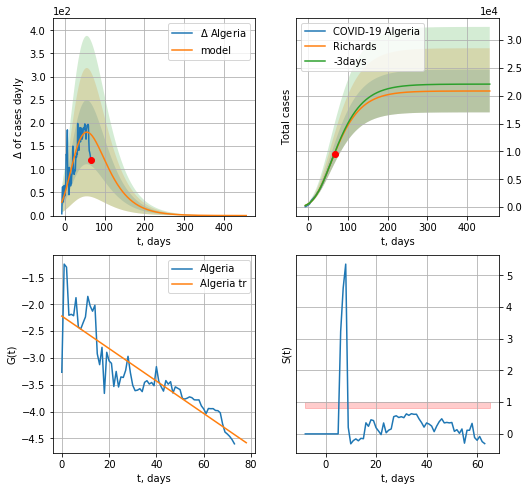

Algeria data at: 2020-07-05
+3 day model MAPE: 0.008186
model: Richards
coeffs: [ 2.08625851e+04  9.79673977e-01 -1.01161081e+02  2.42501114e-02]
rational stdev: 0.184006
forecast at the end of period: +391 days
	 deltaDaycases: 0
	 total cases: 20861 ± 3838
	 total death: 1245 ± 687
trend coefficient of determination: 0.777640
 intercept: -2.218091
 slope: -0.030315


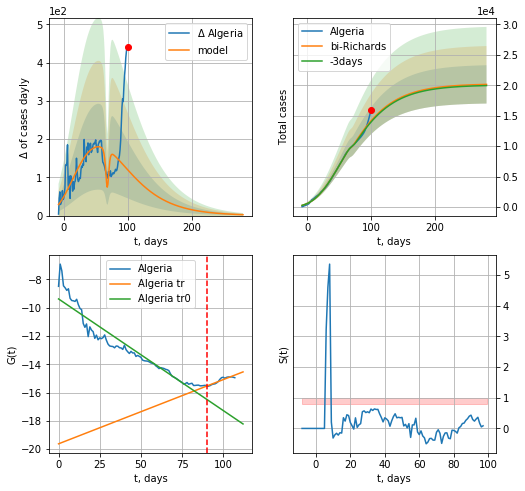

Algeria data at: 2020-07-05
+3 day model MAPE: 0.013940
model: bi-Richards
coeffs: [-6.17018191e+02  5.76724550e-01  6.88064768e+01  1.17376497e+00]
rational stdev: 0.156011
forecast at the end of period: +181 days
	 deltaDaycases: 2
	 total cases: 20147 ± 3143
	 total death: 1203 ± 563
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.909853
 intercept: -9.379830
 slope: -0.078887
trend coefficient of determination: 0.871132
 intercept: -19.618962
 slope: 0.045372


In [755]:
vL = 90+15
x = forecastRR("Algeria",dfAR[15:vL-15],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[15:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


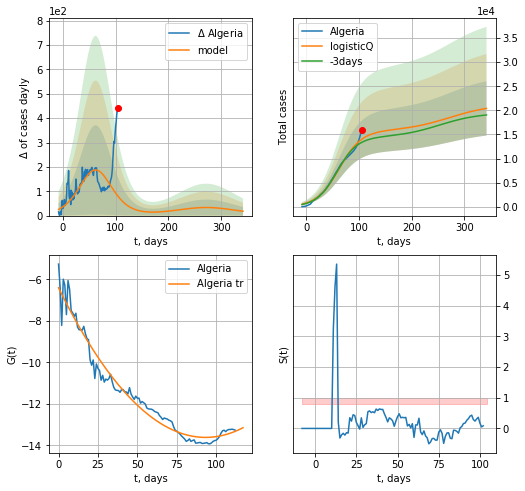

Algeria data at: 2020-07-05
+3 day model MAPE: 0.049203
model: logisticQ
coeffs: [ 1.57147915e+04  3.11981186e-07  6.23947976e+01 -1.52155626e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.276126
forecast at the end of period: +237 days
	 deltaDaycases: 17
	 total cases: 20401 ± 5633
	 total death: 1218 ± 1008
trend coefficient of determination: 0.963591
 intercept_: -6.410019440162354
 coeffs_: [ 0.         -0.15445511  0.00082805]


In [756]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

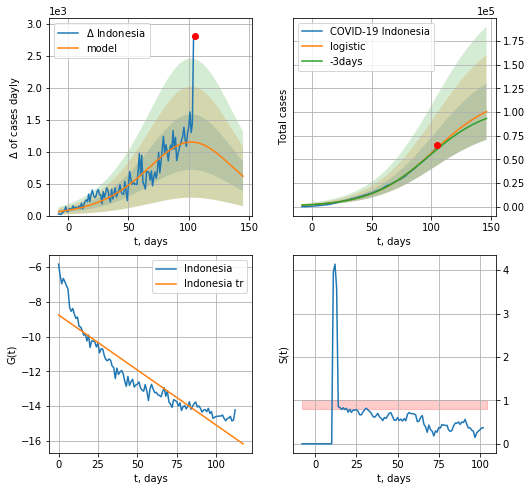

Indonesia data at: 2020-07-05
+3 day model MAPE: 0.02252050070232198
model: logistic
coeffs:  [1.18910128e+05 3.87941045e-02 1.02554397e+02]
rational stdev:  0.29717859405144
forecast at the end of period: +41 days
	 deltaDaycases:  616
	 total cases:  100315 ± 29811
	 total death:  5005 ± 4462
trend coefficient of determination: 0.857679
 intercept: -8.757310
 slope: -0.063372


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


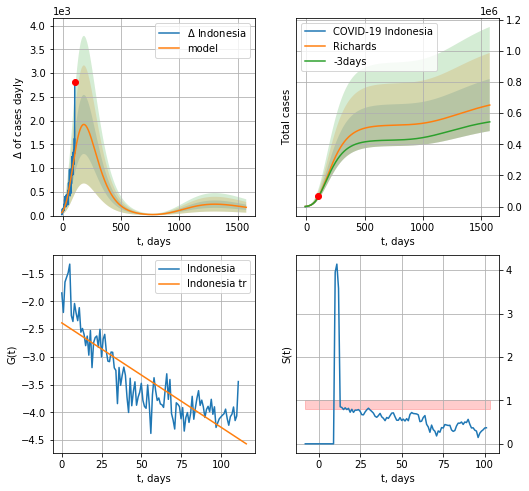

Indonesia data at: 2020-07-05
+3 day model MAPE: 0.012733
model: Richards
coeffs: [ 5.23689009e+05  3.64297156e-01 -1.73801061e+02  2.77113573e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.256426
forecast at the end of period: +1469 days
	 deltaDaycases: 174
	 total cases: 651545 ± 167073
	 total death: 32508 ± 25007
trend coefficient of determination: 0.727687
 intercept: -2.388869
 slope: -0.018778


In [757]:
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,224*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


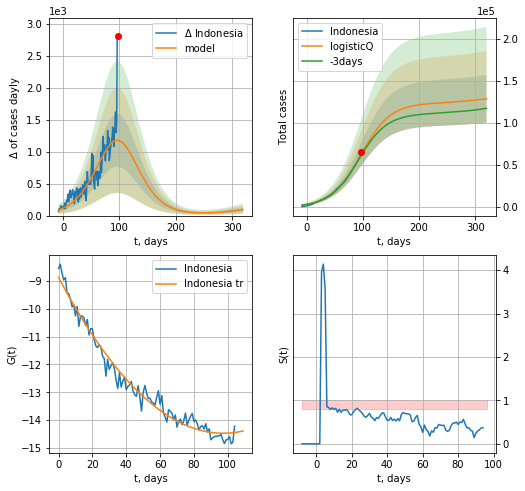

Indonesia data at: 2020-07-05
+3 day model MAPE: 0.020721
model: logisticQ
coeffs: [ 1.23288449e+05  2.02672927e-06  9.63238460e+01 -1.87687097e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.221279
forecast at the end of period: +223 days
	 deltaDaycases: 93
	 total cases: 128887 ± 28520
	 total death: 6430 ± 4268
trend coefficient of determination: 0.975560
 intercept_: -8.866080033373077
 coeffs_: [ 0.         -0.11534022  0.00059291]


In [758]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


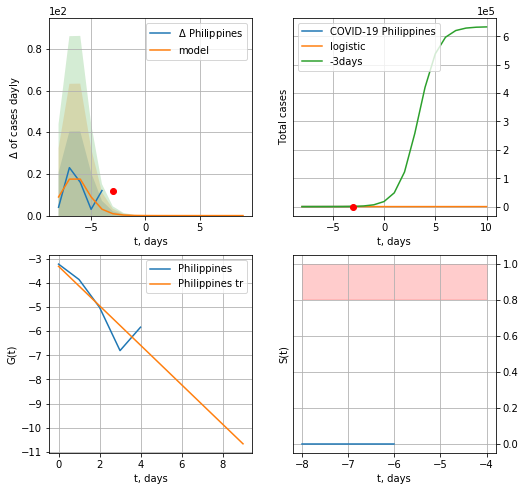

Philippines data at: 2020-07-05
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


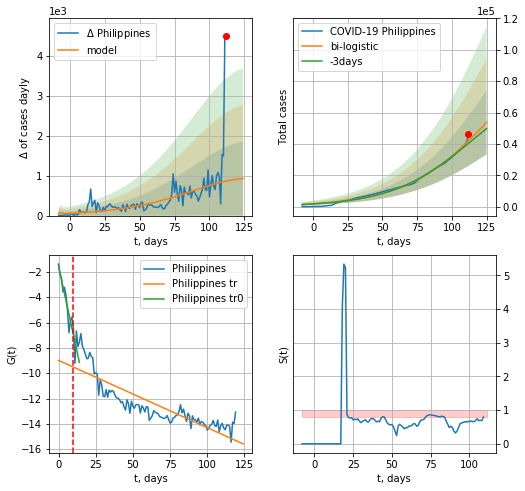

Philippines data at: 2020-07-05
+3 day model MAPE: 0.042237049981053286
model: bi-logistic
coeffs:  [1.16158160e+05 3.22048370e-02 1.29797342e+02] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.3786587264062389
forecast at the end of period: +13 days
	 deltaDaycases:  928
	 total cases:  53662 ± 20319
	 total death:  1509 ± 1714
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.735259
 intercept: -8.988108
 slope: -0.053141


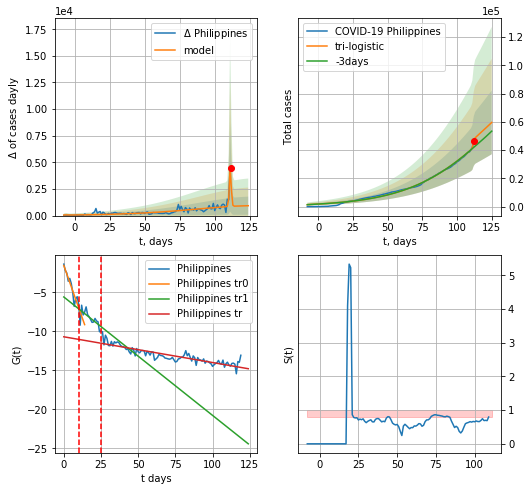

Philippines data at: 2020-07-05
+3 day model MAPE: 0.13688429744857858
model: tri-logistic
coeffs:  [5.96741683e+03 2.96291126e+00 1.11652950e+02] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  1.16158160e+05
  3.22048370e-02  1.29797342e+02]
forecast rational stdev:  0.3781391148873606
forecast at the end of period: +13 days
	 deltaDaycases:  928
	 total cases:  59630 ± 22548
	 total death:  1676 ± 1901
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.770390
 intercept: -10.706983
 slope: -0.033016


In [760]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,16*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


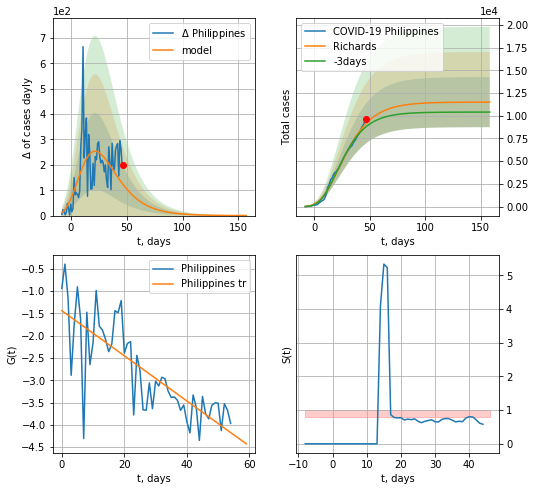

Philippines data at: 2020-07-05
+3 day model MAPE: 0.044209
model: Richards
coeffs: [ 1.15018278e+04  6.61454462e+00 -5.57256966e+01  9.11064046e-03]
rational stdev: 0.239775
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 11498 ± 2757
	 total death: 323 ± 232
trend coefficient of determination: 0.622666
 intercept: -1.437831
 slope: -0.050660


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


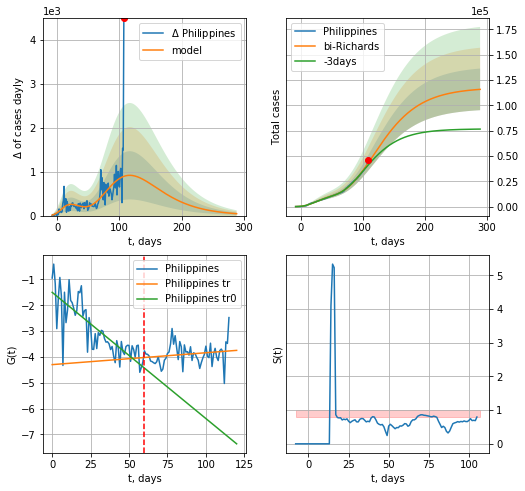

Philippines data at: 2020-07-05
+3 day model MAPE: 0.048380
model: bi-Richards
coeffs: [ 1.06182582e+05  1.72611648e+00 -6.47717458e+01  1.36651978e-02]
rational stdev: 0.177550
forecast at the end of period: +181 days
	 deltaDaycases: 43
	 total cases: 115853 ± 20569
	 total death: 3258 ± 1735
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.654377
 intercept: -1.500827
 slope: -0.048837
trend coefficient of determination: 0.032787
 intercept: -4.297337
 slope: 0.004593


In [761]:
vL = 60 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


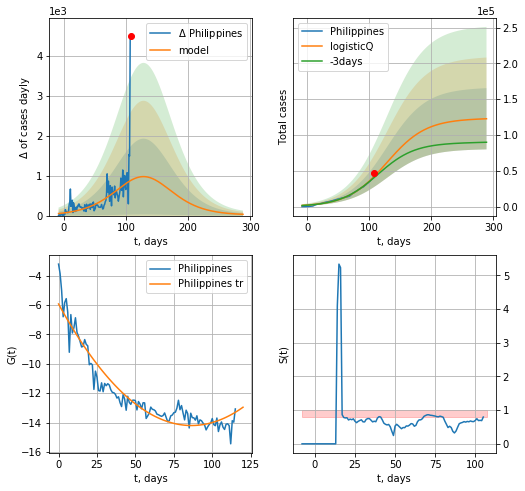

Philippines data at: 2020-07-05
+3 day model MAPE: 0.040827
model: logisticQ
coeffs: [ 1.22804929e+05  1.64623448e-06  1.28567127e+02 -1.91914374e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348494
forecast at the end of period: +181 days
	 deltaDaycases: 32
	 total cases: 122665 ± 42748
	 total death: 3449 ± 3605
trend coefficient of determination: 0.910373
 intercept_: -5.933164494707164
 coeffs_: [ 0.         -0.1912883   0.00110618]


In [762]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
123 2020-07-01  3432.0    1866  192.0
124 2020-07-02  3458.0    1892  192.0
125 2020-07-03  3486.0    1920  192.0
126 2020-07-04  3511.0    1945  192.0
127 2020-07-05  3519.0    1953  192.0


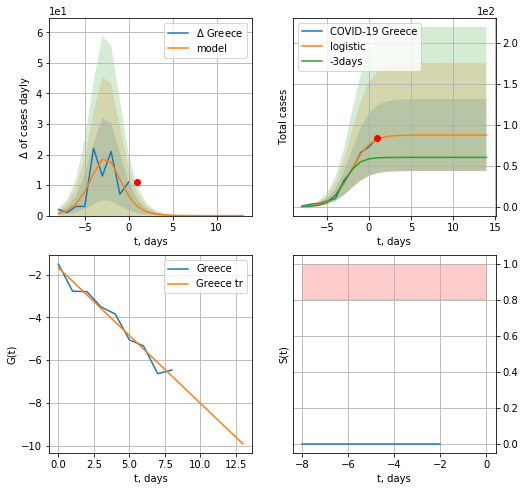

Greece data at: 2020-07-05
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


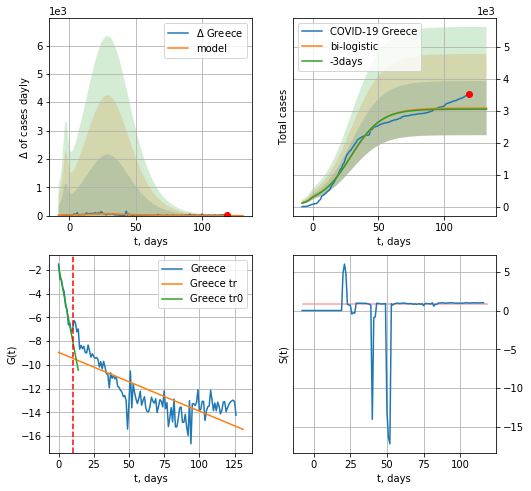

Greece data at: 2020-07-05
+3 day model MAPE: 0.011060922133482934
model: bi-logistic
coeffs:  [2.99501507e+03 8.50856311e-02 2.94096219e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.2745508586359211
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  3082 ± 846
	 total death:  168 ± 138
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.600041
 intercept: -8.949347
 slope: -0.049576


In [763]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,16*7-dT)
xx = forecast2("Greece",dfGC[:],d1,16*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


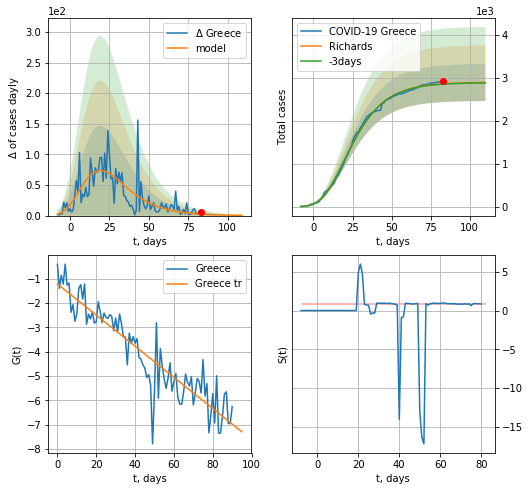

Greece data at: 2020-07-05
+3 day model MAPE: 0.003283
model: Richards
coeffs: [ 2.89327821e+03  7.32575617e+00 -4.72776749e+01  9.49188322e-03]
rational stdev: 0.149150
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 2887 ± 430
	 total death: 157 ± 70
trend coefficient of determination: 0.838381
 intercept: -1.223029
 slope: -0.063896


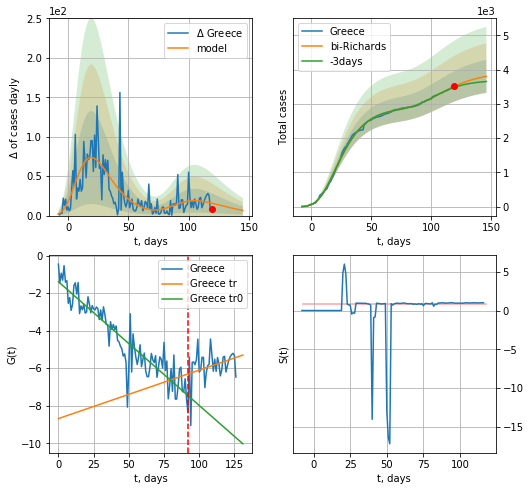

Greece data at: 2020-07-05
+3 day model MAPE: 0.009140
model: bi-Richards
coeffs: [1.05453278e+03 1.03043867e+00 4.34290663e+01 4.71463637e-02]
rational stdev: 0.126521
forecast at the end of period: +27 days
	 deltaDaycases: 6
	 total cases: 3805 ± 481
	 total death: 207 ± 78
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.848097
 intercept: -1.396608
 slope: -0.065895
trend coefficient of determination: 0.090405
 intercept: -8.685263
 slope: 0.025823


In [764]:
vL = 92
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


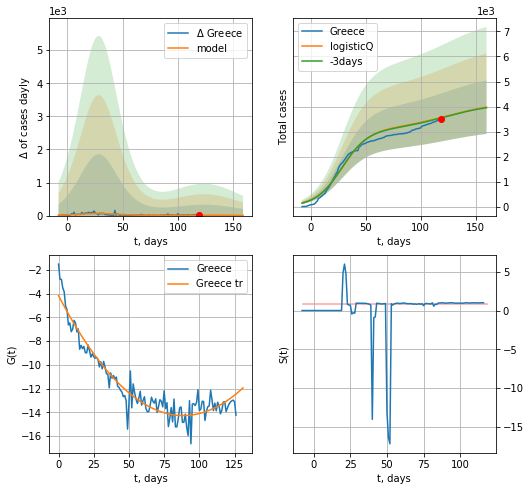

Greece data at: 2020-07-05
+3 day model MAPE: 0.004955
model: logisticQ
coeffs: [ 3.08776938e+03  1.32006048e-07  2.86525539e+01 -6.23784414e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.268994
forecast at the end of period: +41 days
	 deltaDaycases: 7
	 total cases: 3974 ± 1069
	 total death: 216 ± 174
trend coefficient of determination: 0.915800
 intercept_: -4.170194821785421
 coeffs_: [ 0.         -0.22845765  0.0012907 ]


In [765]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
117 2020-07-01  4157.0     857  586.0
118 2020-07-02  4166.0     858  587.0
119 2020-07-03  4172.0     832  588.0
120 2020-07-04  4174.0     801  589.0
121 2020-07-05  4189.0     740  589.0


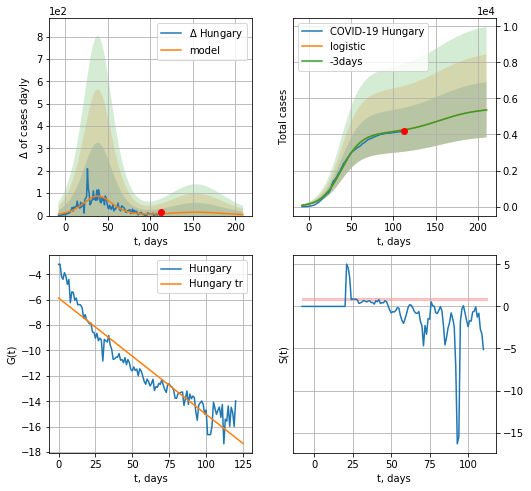

Hungary data at: 2020-07-05
+3 day model MAPE: 0.002694519237164807
model: logistic
coeffs:  [4.06386929e+03 8.55578595e-02 3.85121984e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.28537841839724526
forecast at the end of period: +97 days
	 deltaDaycases:  4
	 total cases:  5367 ± 1531
	 total death:  754 ± 645
trend coefficient of determination: 0.902435
 intercept: -5.869241
 slope: -0.091621


In [766]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


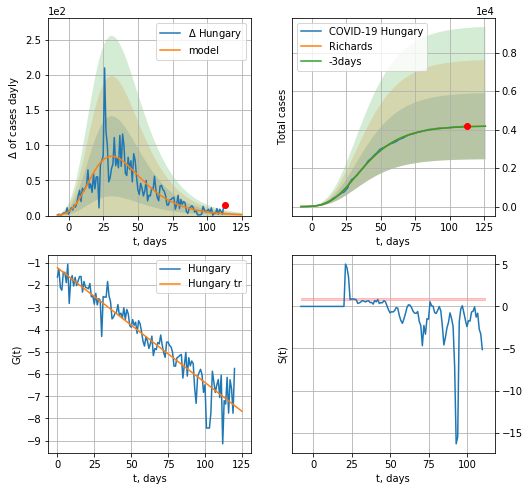

Hungary data at: 2020-07-05
+3 day model MAPE: 0.000746
model: Richards
coeffs: [ 4.20383563e+03  3.86346925e+00 -4.57016703e+01  1.42336894e-02]
rational stdev: 0.411321
forecast at the end of period: +13 days
	 deltaDaycases: 1
	 total cases: 4180 ± 1719
	 total death: 587 ± 724
trend coefficient of determination: 0.901621
 intercept: -1.215859
 slope: -0.051659


In [767]:
vL = 99
x = forecastRR("Hungary",dfHG[:],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR("Hungary",dfHG[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


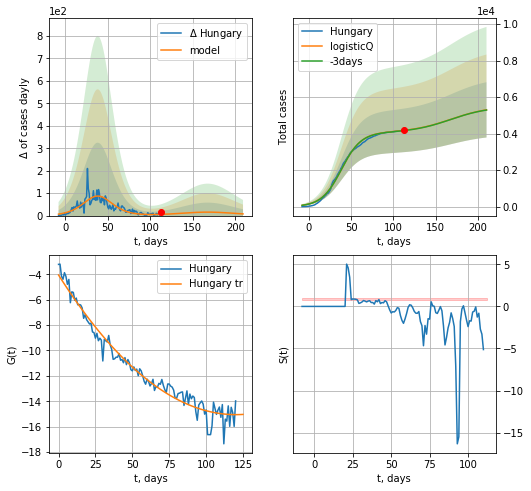

Hungary data at: 2020-07-05
+3 day model MAPE: 0.002875
model: logisticQ
coeffs: [ 4.06381571e+03  3.34978756e-07  3.85127926e+01 -2.55304923e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.285469
forecast at the end of period: +97 days
	 deltaDaycases: 7
	 total cases: 5301 ± 1513
	 total death: 745 ± 638
trend coefficient of determination: 0.963259
 intercept_: -4.057418350239248
 coeffs_: [ 0.         -0.18297547  0.0007613 ]


In [768]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


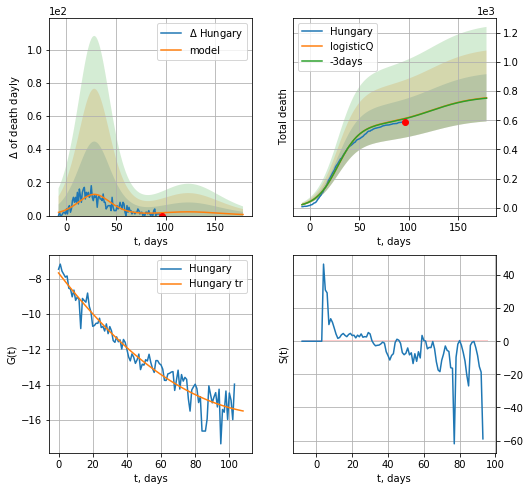

Hungary data at: 2020-07-05
+3 day model MAPE: 0.003381
model: logisticQ
coeffs: [ 5.68683523e+02  3.37768497e-07  2.83746889e+01 -2.63930913e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214778
forecast at the end of period: +83 days
	 total death: 754 ± 162
trend coefficient of determination: 0.933435
 intercept_: -7.677857998477211
 coeffs_: [ 0.         -0.12530069  0.0004905 ]


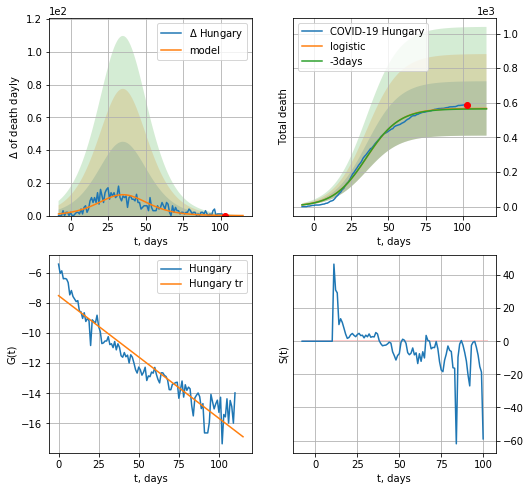

Hungary data at: 2020-07-05
+3 day model MAPE: 0.004576735460349218
model: logistic
coeffs:  [5.68099190e+02 8.99320655e-02 3.53544561e+01]
rational stdev:  0.2763542216313796
forecast at the end of period: +13 days
	 total death:  567 ± 156
trend coefficient of determination: 0.906068
 intercept: -7.518233
 slope: -0.081409


In [769]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,16*7-dT,cases='death')

MT
           date  cases  active  death
115 2020-07-01  671.0      15    9.0
116 2020-07-02  671.1      13    9.0
117 2020-07-03  672.0      13    9.0
118 2020-07-04  672.1      12    9.0
119 2020-07-05  672.2      11    9.0


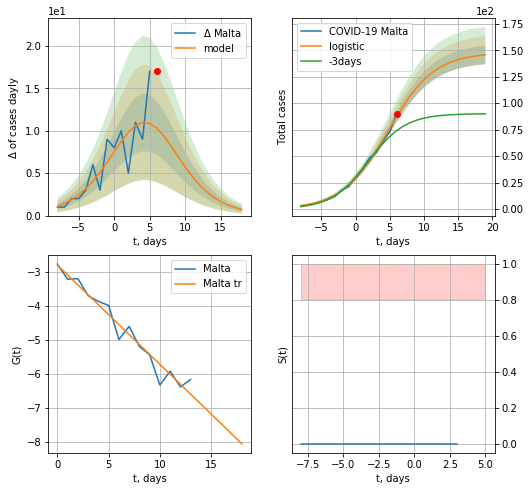

Malta data at: 2020-07-05
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  145 ± 8
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


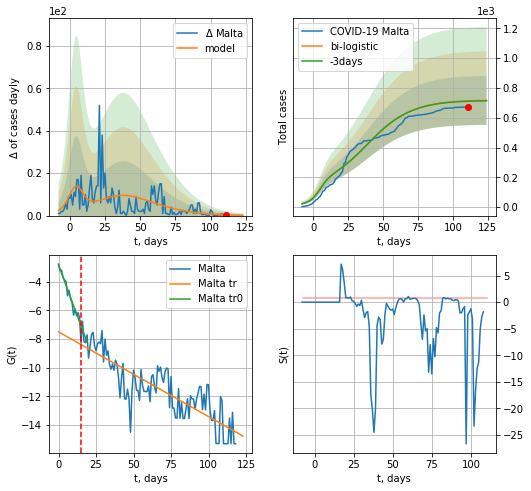

Malta data at: 2020-07-05
+3 day model MAPE: 0.003884667791782085
model: bi-logistic
coeffs:  [5.07560102e+02 7.17330823e-02 3.73908329e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.22949395386639043
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  716 ± 164
	 total death:  9 ± 6
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.702750
 intercept: -7.504177
 slope: -0.059176


In [771]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*16-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*16-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


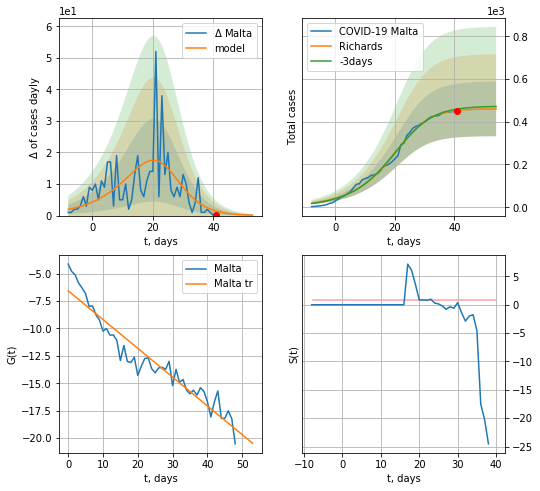

Malta data at: 2020-07-05
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 460 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


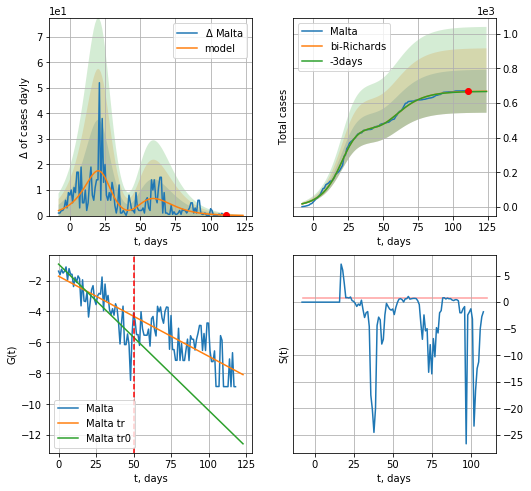

Malta data at: 2020-07-05
+3 day model MAPE: 0.001948
model: bi-Richards
coeffs: [2.08447269e+02 1.13495019e+01 4.09110661e+00 7.67369695e-03]
rational stdev: 0.185203
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 668 ± 123
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.729019
 intercept: -0.940159
 slope: -0.094440
trend coefficient of determination: 0.462153
 intercept: -1.721128
 slope: -0.051734


In [773]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


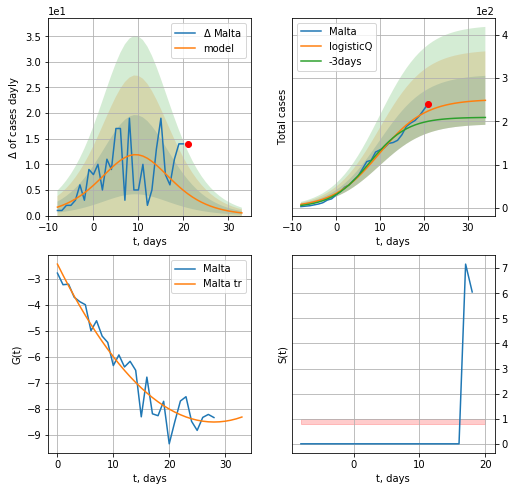

Malta data at: 2020-07-05
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 248 ± 56
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


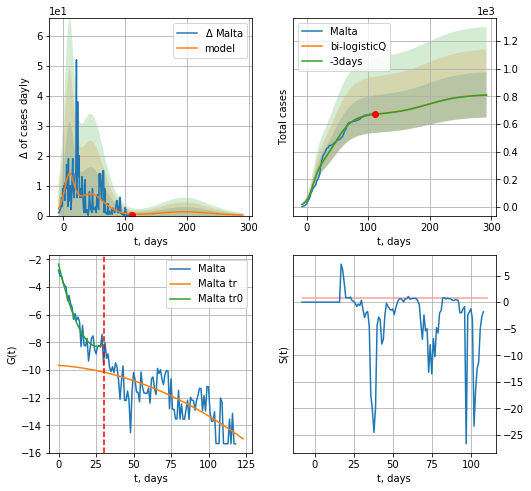

Malta data at: 2020-07-05
+3 day model MAPE: 0.002088
model: bi-logisticQ
coeffs: [ 4.16711332e+02  1.88202740e-07  4.50818184e+01 -3.65526071e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.201905
forecast at the end of period: +181 days
	 deltaDaycases: 0
	 total cases: 809 ± 163
	 total death: 10 ± 6
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.562716
 intercept_: -9.656040953100526
 coeffs_: [ 0.         -0.00784892 -0.00028704]


In [774]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
113 2020-07-01  1687.0   193.0   28.0
114 2020-07-02  1700.0   206.0   28.0
115 2020-07-03  1720.0   226.0   28.0
116 2020-07-04  1749.0   255.0   28.0
117 2020-07-05  1765.0   271.0   28.0


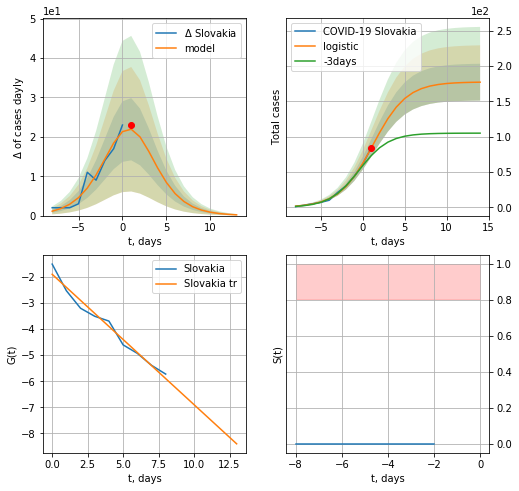

Slovakia data at: 2020-07-05
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  176 ± 26
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


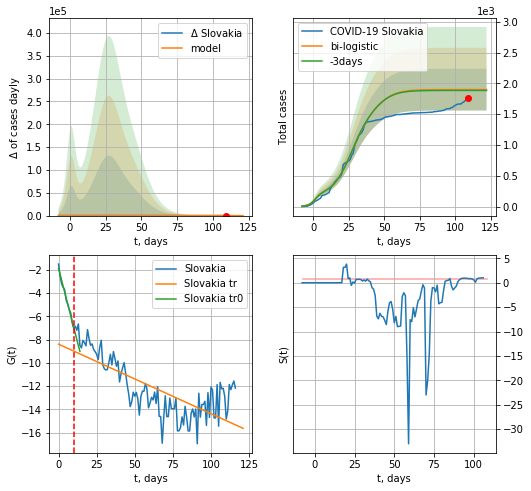

Slovakia data at: 2020-07-05
+3 day model MAPE: 0.007138488502458675
model: bi-logistic
coeffs:  [1.37733932e+03 1.46086222e-01 2.69517271e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.17848650221748508
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1898 ± 338
	 total death:  30 ± 16
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.551264
 intercept: -8.395141
 slope: -0.059853


In [776]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


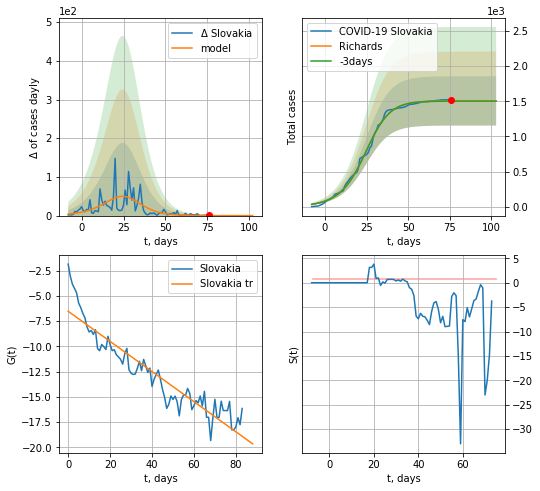

Slovakia data at: 2020-07-05
+3 day model MAPE: 0.002066
model: Richards
coeffs: [1.50610865e+03 1.09508318e-01 2.68945088e+01 1.32920214e+00]
rational stdev: 0.232989
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1506 ± 350
	 total death: 23 ± 16
trend coefficient of determination: 0.871466
 intercept: -6.535200
 slope: -0.149062


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


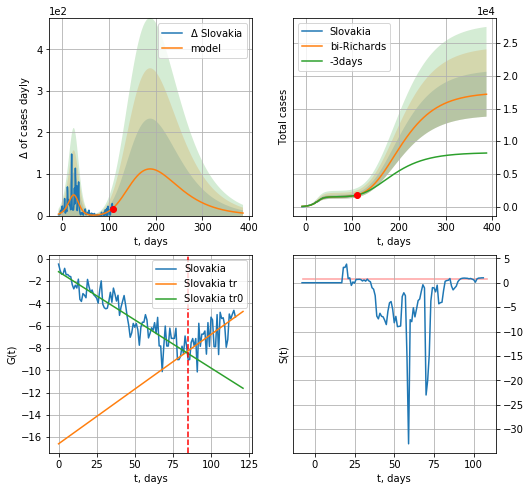

Slovakia data at: 2020-07-05
+3 day model MAPE: 0.008256
model: bi-Richards
coeffs: [1.59839932e+04 2.80938998e-01 5.42319022e+01 7.03298797e-02]
rational stdev: 0.199665
forecast at the end of period: +279 days
	 deltaDaycases: 6
	 total cases: 17182 ± 3430
	 total death: 272 ± 162
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.853730
 intercept: -1.164250
 slope: -0.086379
trend coefficient of determination: 0.374875
 intercept: -16.599471
 slope: 0.098107


In [777]:
vL = 85
x = forecastRR("Slovakia",dfSL[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d1,54*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


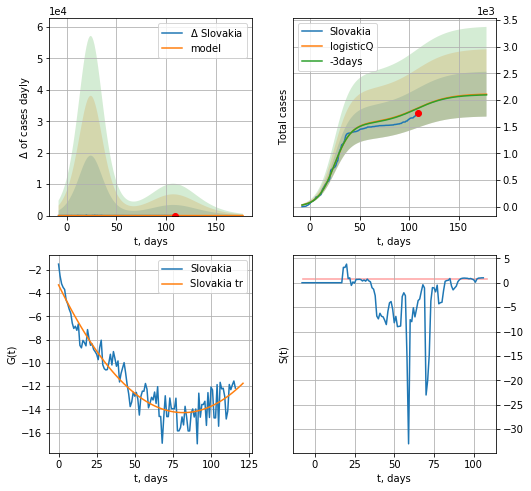

Slovakia data at: 2020-07-05
+3 day model MAPE: 0.003297
model: logisticQ
coeffs: [ 1.56468278e+03  8.86413029e-07  2.46853227e+01 -1.34313575e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.199355
forecast at the end of period: +69 days
	 deltaDaycases: 0
	 total cases: 2110 ± 420
	 total death: 33 ± 19
trend coefficient of determination: 0.900479
 intercept_: -3.296087828481248
 coeffs_: [ 0.         -0.26873307  0.00164284]


In [778]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
118 2020-07-01  1613.0   118.0  111.0
119 2020-07-02  1634.0   139.0  111.0
120 2020-07-03  1650.0   155.0  111.0
121 2020-07-04  1679.0   184.0  111.0
122 2020-07-05  1716.0   221.0  111.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


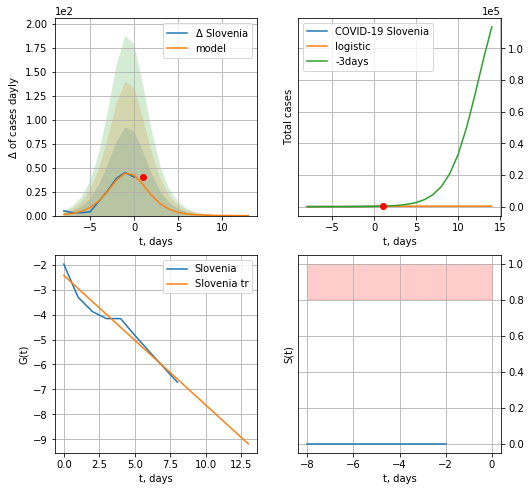

Slovenia data at: 2020-07-05
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  261 ± 138
	 total death:  16 ± 25
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


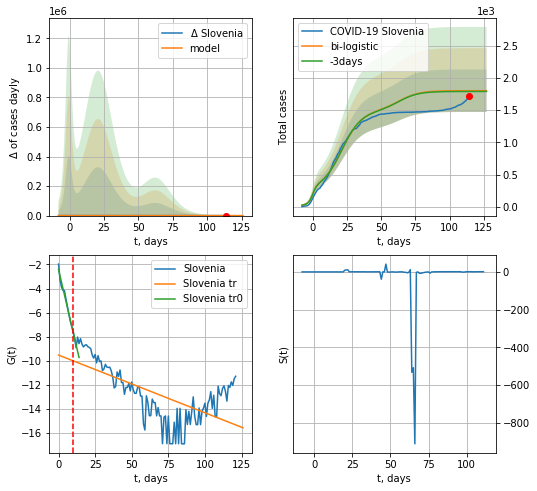

Slovenia data at: 2020-07-05
+3 day model MAPE: 0.006449691705893431
model: bi-logistic
coeffs:  [1.23345568e+03 1.36318630e-01 2.11120192e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.1833788496495066
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1802 ± 330
	 total death:  116 ± 63
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.422486
 intercept: -9.525322
 slope: -0.047919


In [780]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*16-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


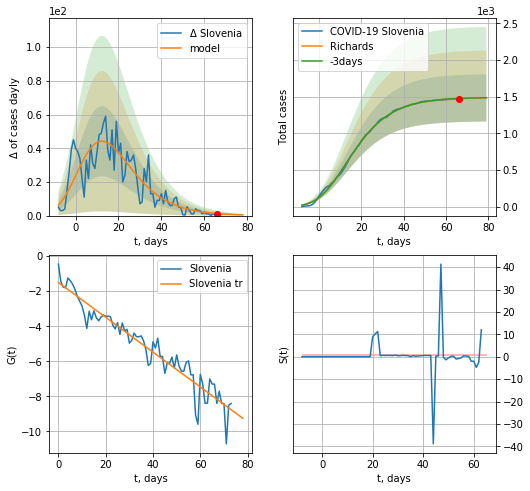

Slovenia data at: 2020-07-05
+3 day model MAPE: 0.001211
model: Richards
coeffs: [ 1.48860897e+03  5.69202399e-01 -8.90072420e+00  1.52510532e-01]
rational stdev: 0.217393
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1483 ± 322
	 total death: 95 ± 61
trend coefficient of determination: 0.915958
 intercept: -1.505070
 slope: -0.099296


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


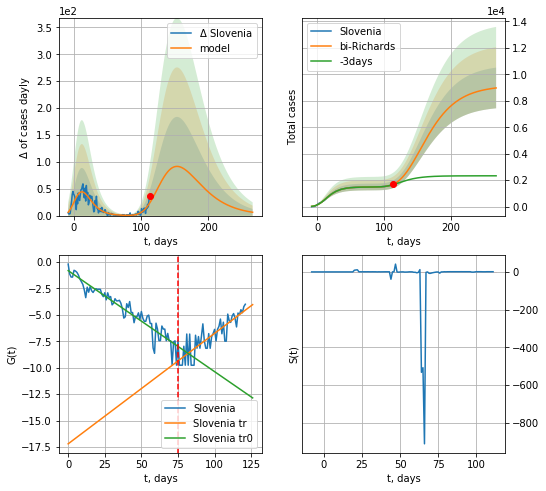

Slovenia data at: 2020-07-05
+3 day model MAPE: 0.023288
model: bi-Richards
coeffs: [7.67376585e+03 1.41780959e+00 3.92749138e+01 2.31260155e-02]
rational stdev: 0.171435
forecast at the end of period: +153 days
	 deltaDaycases: 6
	 total cases: 8975 ± 1538
	 total death: 580 ± 298
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.904819
 intercept: -0.837855
 slope: -0.095324
trend coefficient of determination: 0.707022
 intercept: -17.181235
 slope: 0.104234


In [782]:
vL = 75
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


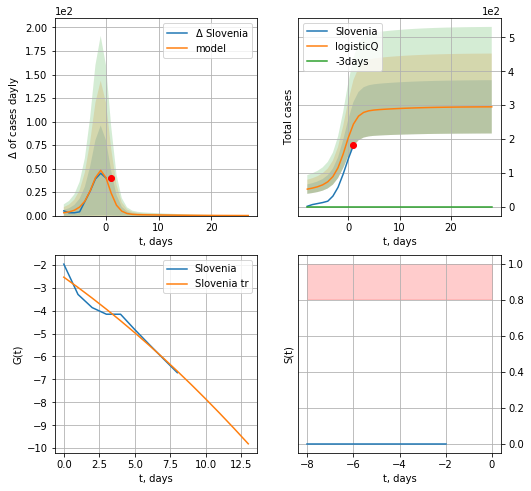

Slovenia data at: 2020-07-05
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 294 ± 78
	 total death: 19 ± 15
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


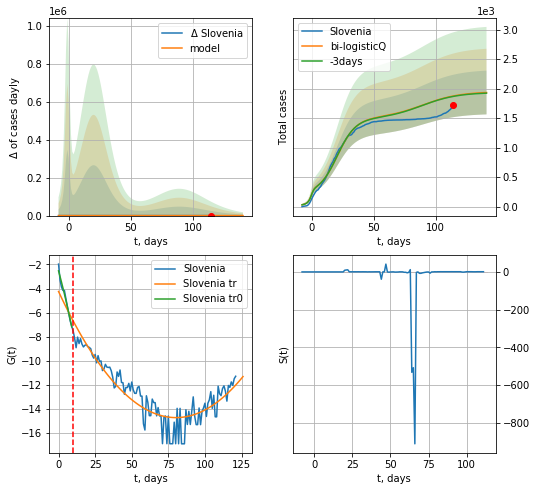

Slovenia data at: 2020-07-05
+3 day model MAPE: 0.003716
model: bi-logisticQ
coeffs: [ 1.27688293e+03  3.62092464e-07  2.05153840e+01 -3.67591286e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.191589
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1933 ± 370
	 total death: 125 ± 71
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.829587
 intercept_: -4.2474226902889605
 coeffs_: [ 0.         -0.26099061  0.00162652]


In [783]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
113 2020-07-01  14836  1783.0  281.0
114 2020-07-02  15195  1996.0  287.0
115 2020-07-03  15504  2142.0  298.0
116 2020-07-04  15829  2459.0  306.0
117 2020-07-05  16131  2756.0  311.0


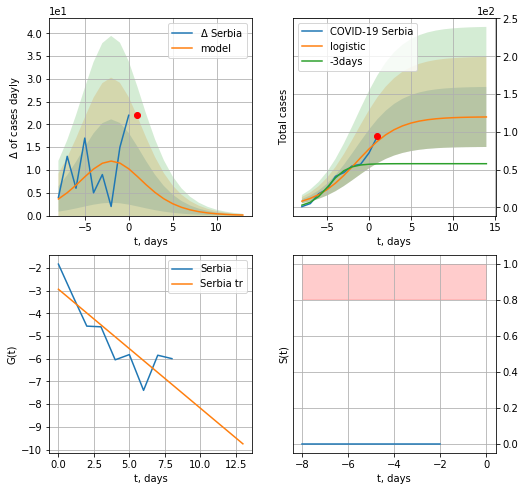

Serbia data at: 2020-07-05
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


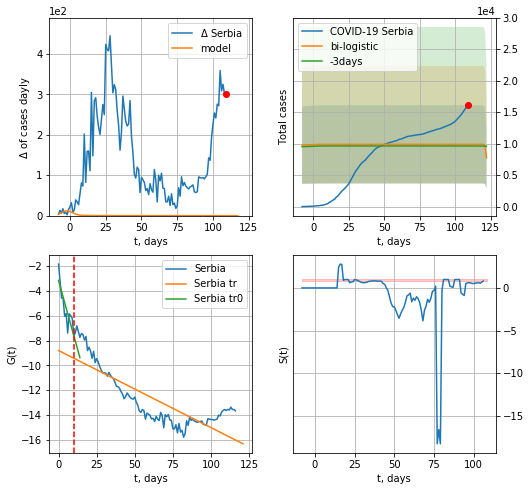

Serbia data at: 2020-07-05
+3 day model MAPE: 0.026737508727556075
model: bi-logistic
coeffs:  [ 7.80971398e+03 -2.37564990e+00  1.22405663e+02] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6285107722271829
forecast at the end of period: +13 days
	 deltaDaycases:  -1889
	 total cases:  7725 ± 4855
	 total death:  148 ± 279
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.681758
 intercept: -8.803088
 slope: -0.062218


In [784]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,16*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


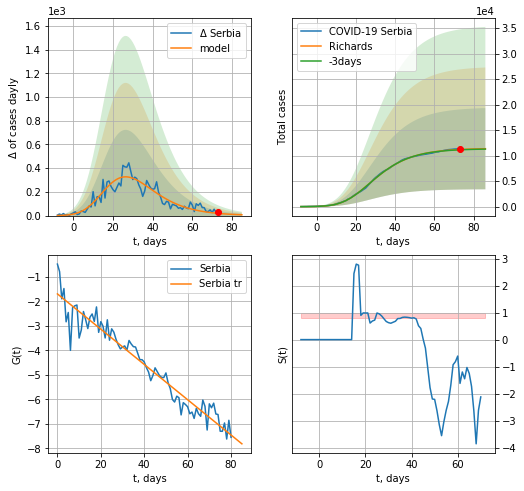

Serbia data at: 2020-07-05
+3 day model MAPE: 0.005935
model: Richards
coeffs: [1.14293254e+04 5.20642407e-01 5.14901126e+00 1.61282517e-01]
rational stdev: 0.700960
forecast at the end of period: +13 days
	 deltaDaycases: 6
	 total cases: 11349 ± 7955
	 total death: 218 ± 458
trend coefficient of determination: 0.932302
 intercept: -1.698040
 slope: -0.071957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


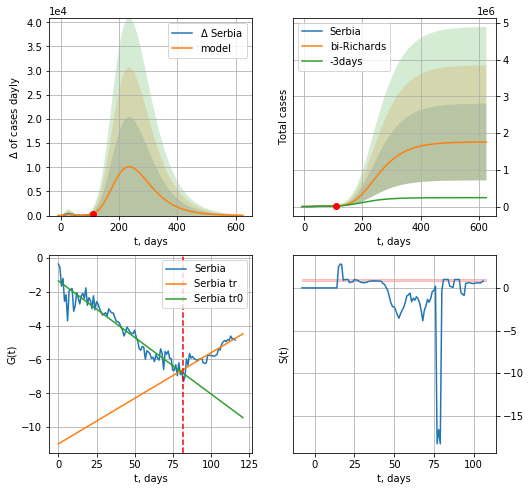

Serbia data at: 2020-07-05
+3 day model MAPE: 0.021400
model: bi-Richards
coeffs: [1.75198639e+06 1.80184887e-01 8.83981397e+01 9.08601912e-02]
rational stdev: 0.593685
forecast at the end of period: +517 days
	 deltaDaycases: 47
	 total cases: 1760515 ± 1045192
	 total death: 33942 ± 60452
bi-Richards approximation splitting point: 82
trend coefficient of determination: 0.923619
 intercept: -1.359599
 slope: -0.066751
trend coefficient of determination: 0.768095
 intercept: -10.985389
 slope: 0.053705


In [785]:
vL=82
x = forecastRR("Serbia",dfSB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,88*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


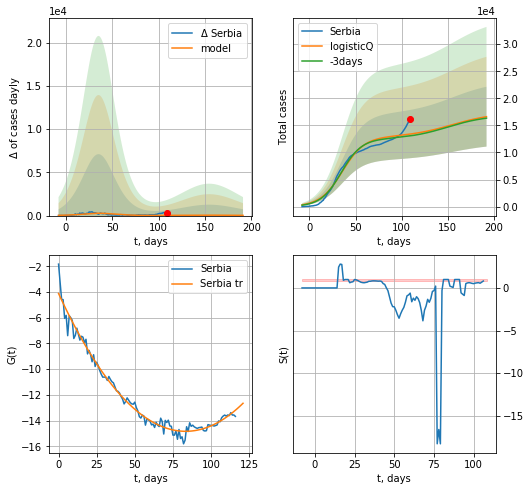

Serbia data at: 2020-07-05
+3 day model MAPE: 0.025575
model: logisticQ
coeffs: [ 1.28488275e+04  1.45576709e-07  3.55524505e+01 -5.76159059e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332743
forecast at the end of period: +83 days
	 deltaDaycases: 27
	 total cases: 16611 ± 5527
	 total death: 320 ± 319
trend coefficient of determination: 0.980064
 intercept_: -4.114800064904267
 coeffs_: [ 0.         -0.25688156  0.00154023]


In [786]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
123 2020-07-01  2831.0   568.0  108.0
124 2020-07-02  2912.0   647.0  110.0
125 2020-07-03  3008.0   728.0  112.0
126 2020-07-04  3094.0   798.0  113.0
127 2020-07-05  3151.0   842.0  113.0


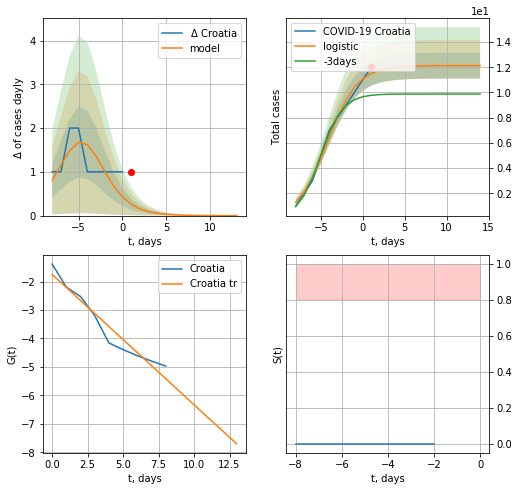

Croatia data at: 2020-07-05
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


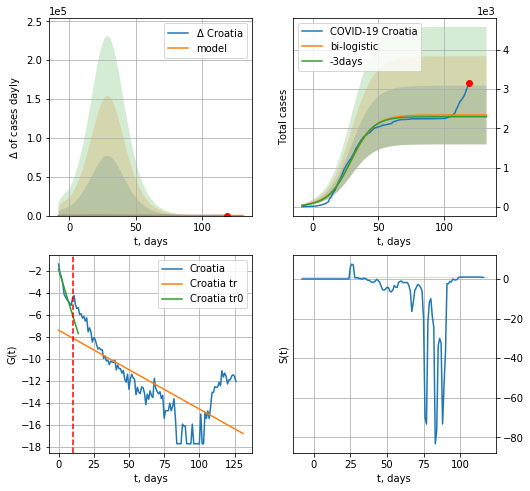

Croatia data at: 2020-07-05
+3 day model MAPE: 0.018944987982300647
model: bi-logistic
coeffs:  [2.32950893e+03 1.12777600e-01 2.93609276e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.3202766269130066
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  2341 ± 749
	 total death:  83 ± 79
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.510584
 intercept: -7.401137
 slope: -0.071759


In [787]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


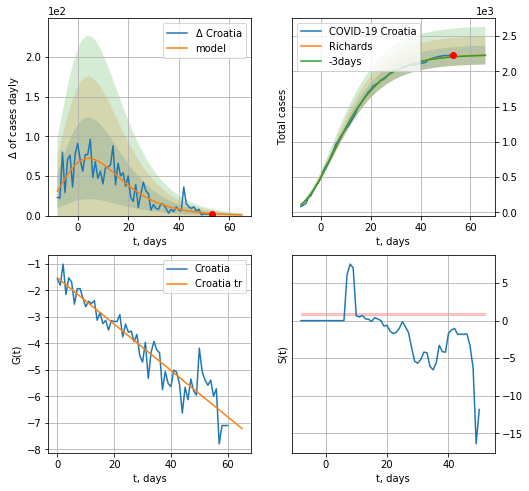

Croatia data at: 2020-07-05
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963101e+03  7.95190714e+00 -4.62548924e+01  1.10914885e-02]
rational stdev: 0.059686
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 2229 ± 133
	 total death: 79 ± 14
trend coefficient of determination: 0.897394
 intercept: -1.522031
 slope: -0.087533


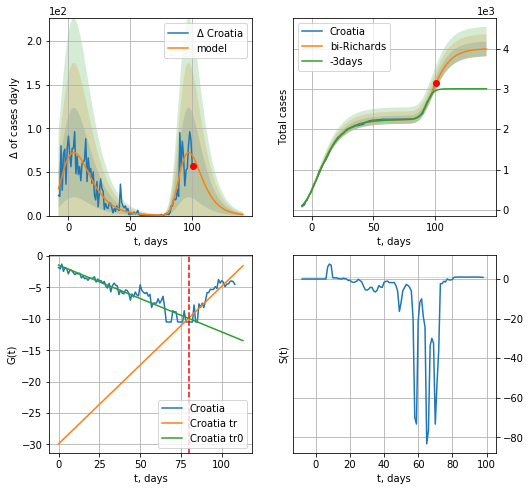

Croatia data at: 2020-07-05
+3 day model MAPE: 0.080547
model: bi-Richards
coeffs: [1.75903665e+03 1.86906473e+00 7.33699080e+01 6.15656892e-02]
rational stdev: 0.045763
forecast at the end of period: +41 days
	 deltaDaycases: 1
	 total cases: 3988 ± 182
	 total death: 143 ± 19
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.905735
 intercept: -1.430377
 slope: -0.106563
trend coefficient of determination: 0.818868
 intercept: -29.913919
 slope: 0.251136


In [791]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


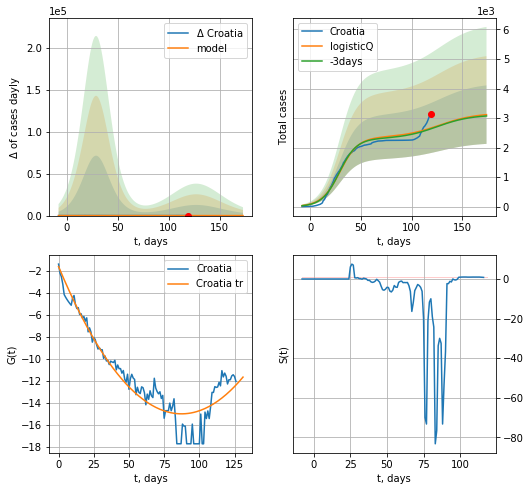

Croatia data at: 2020-07-05
+3 day model MAPE: 0.009615
model: logisticQ
coeffs: [ 2.34261038e+03  2.25242357e-07  2.92556513e+01 -4.95840407e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317861
forecast at the end of period: +55 days
	 deltaDaycases: 3
	 total cases: 3115 ± 990
	 total death: 111 ± 105
trend coefficient of determination: 0.893034
 intercept_: -1.6056309554144033
 coeffs_: [ 0.         -0.30687289  0.0017562 ]


In [792]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
117 2020-07-01  69814   47899  3034.0
118 2020-07-02  71299   48891  3120.0
119 2020-07-03  72711   49820  3201.0
120 2020-07-04  74035   50652  3280.0
121 2020-07-05  75253   51184  3343.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


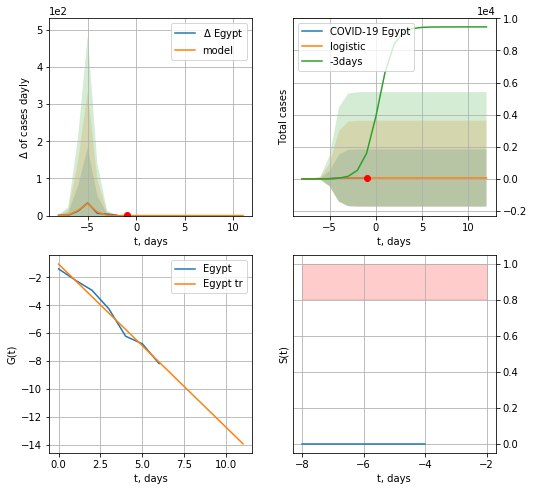

Egypt data at: 2020-07-05
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


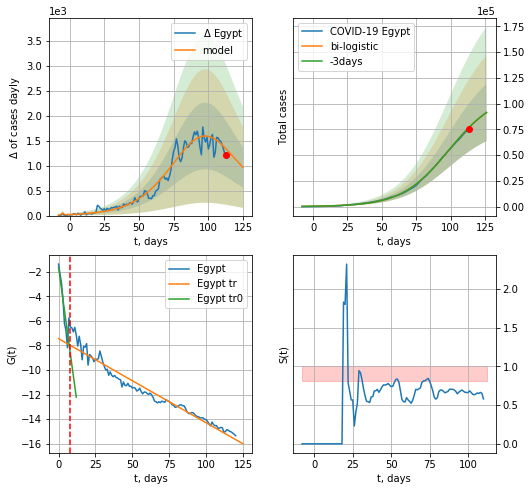

Egypt data at: 2020-07-05
+3 day model MAPE: 0.0008230288995070764
model: bi-logistic
coeffs:  [1.05597710e+05 5.93887375e-02 9.76592308e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.3035854785694981
forecast at the end of period: +13 days
	 deltaDaycases:  964
	 total cases:  91353 ± 27733
	 total death:  4058 ± 3695
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.952681
 intercept: -7.453058
 slope: -0.068480


In [793]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*16-dT)
xx = forecast2("Egypt",dfEG[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


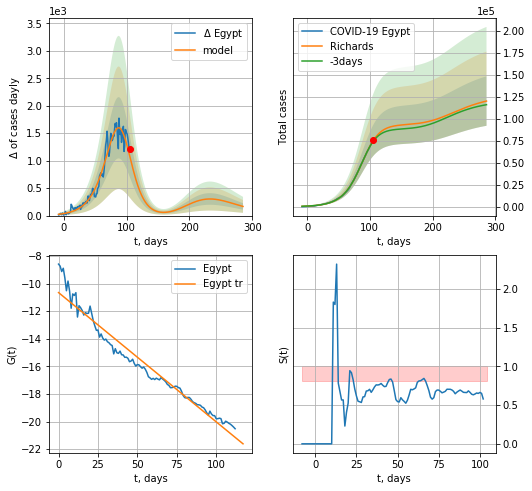

Egypt data at: 2020-07-05
+3 day model MAPE: 0.013328
model: Richards
coeffs: [9.33698738e+04 5.34224404e-02 9.27813032e+01 1.46063000e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.234061
forecast at the end of period: +181 days
	 deltaDaycases: 166
	 total cases: 120044 ± 28097
	 total death: 5332 ± 3744
trend coefficient of determination: 0.957894
 intercept: -10.652669
 slope: -0.093718


In [794]:
x = forecastRR("Egypt",dfEG[8:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


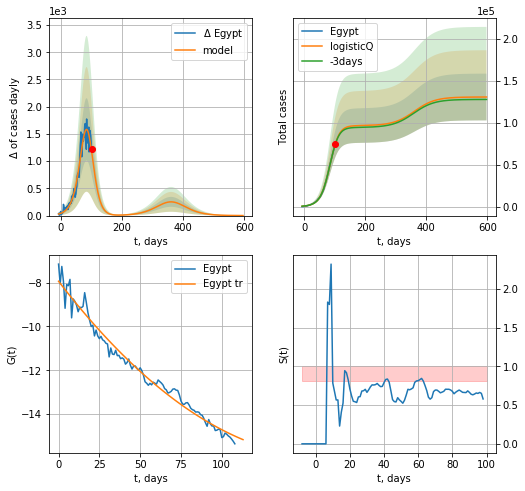

Egypt data at: 2020-07-05
+3 day model MAPE: 0.006015
model: logisticQ
coeffs: [ 9.67316697e+04  1.05428995e-04  8.26662209e+01 -5.36728423e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.212954
forecast at the end of period: +496 days
	 deltaDaycases: 0
	 total cases: 130963 ± 27889
	 total death: 5817 ± 3716
trend coefficient of determination: 0.977867
 intercept_: -7.9367734525574924
 coeffs_: [ 0.         -0.09675376  0.00029045]


In [795]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases   active   death
120 2020-07-01  51524  23207.0  2050.0
121 2020-07-02  53708  23636.0  2160.0
122 2020-07-03  56020  24158.0  2262.0
123 2020-07-04  58354  24909.0  2368.0
124 2020-07-05  60479  24989.0  2473.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


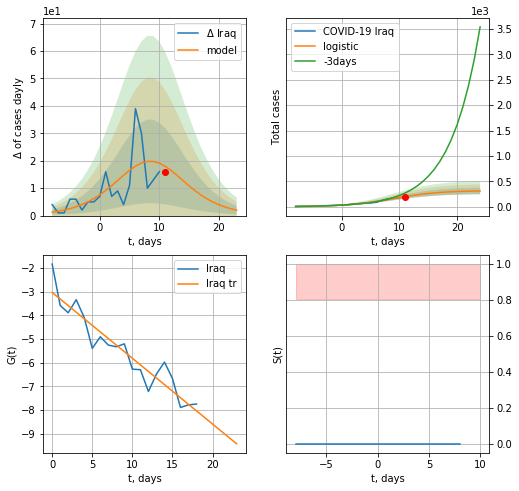

Iraq data at: 2020-07-05
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  309 ± 64
	 total death:  12 ± 7
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


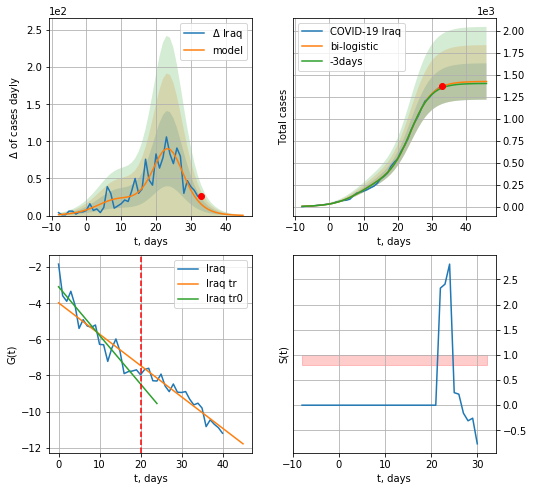

Iraq data at: 2020-07-05
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1424 ± 207
	 total death:  58 ± 25
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


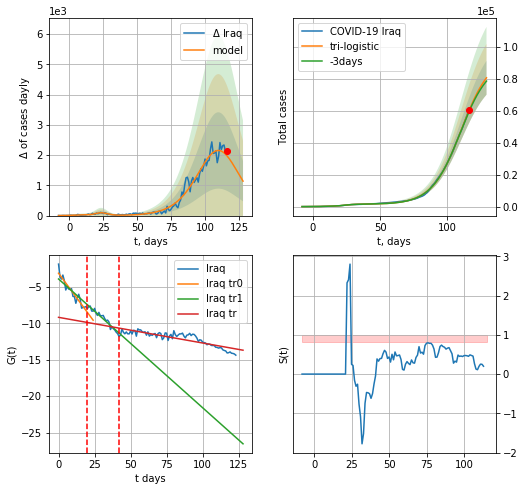

Iraq data at: 2020-07-05
+3 day model MAPE: 0.011862574767767446
model: tri-logistic
coeffs:  [9.33166370e+04 9.23599819e-02 1.10293865e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.1316825050650191
forecast at the end of period: +13 days
	 deltaDaycases:  1140
	 total cases:  80662 ± 10621
	 total death:  3298 ± 1302
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.734738
 intercept: -9.154604
 slope: -0.035323


In [797]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,16*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


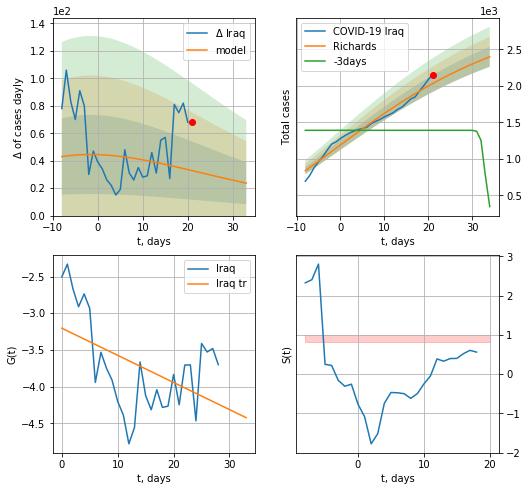

Iraq data at: 2020-07-05
+3 day model MAPE: 0.483696
model: Richards
coeffs: [ 3.05374051e+03  1.25736108e+00 -8.65808580e+01  3.20212773e-02]
rational stdev: 0.056950
forecast at the end of period: +13 days
	 deltaDaycases: 23
	 total cases: 2396 ± 136
	 total death: 97 ± 16
trend coefficient of determination: 0.238101
 intercept: -3.204366
 slope: -0.036947


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


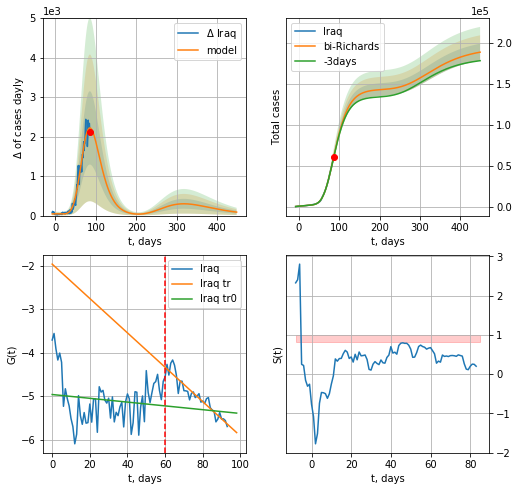

Iraq data at: 2020-07-05
+3 day model MAPE: 0.005041
model: bi-Richards
coeffs: [1.40275471e+05 2.22302066e-01 5.30821670e+01 2.13415319e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.054323
forecast at the end of period: +363 days
	 deltaDaycases: 87
	 total cases: 188444 ± 10236
	 total death: 7705 ± 1255
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.019912
 intercept: -4.962762
 slope: -0.004355
trend coefficient of determination: 0.889545
 intercept: -1.967418
 slope: -0.039489


In [798]:
vL=60+30#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,66*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-30)

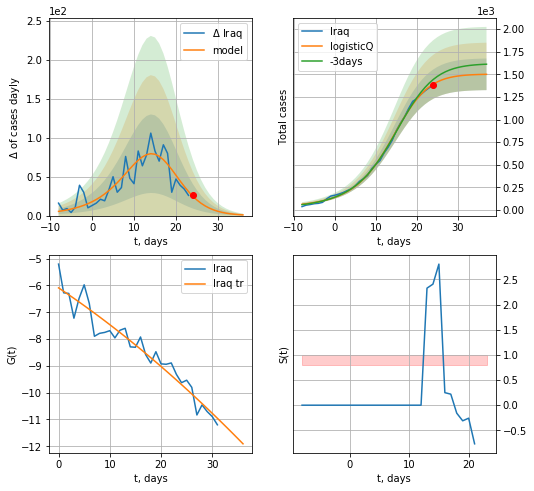

Iraq data at: 2020-07-05
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1500 ± 174
	 total death: 61 ± 21
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


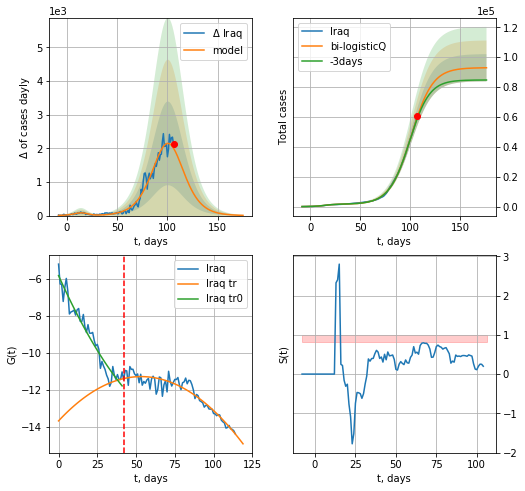

Iraq data at: 2020-07-05
+3 day model MAPE: 0.019673
model: bi-logisticQ
coeffs: [ 9.14653015e+04  1.57879635e-05  1.00884710e+02 -5.84896307e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.098095
forecast at the end of period: +69 days
	 deltaDaycases: 7
	 total cases: 92896 ± 9112
	 total death: 3798 ± 1117
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.896345
 intercept_: -13.666983014310937
 coeffs_: [ 0.          0.08966426 -0.00084084]


In [799]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [353]:
#len(dfAR)

AR
           date    cases  active  death
119 2020-07-01  14272.0  3312.0  920.0
120 2020-07-02  14657.0  3387.0  928.0
121 2020-07-03  15070.0  3301.0  937.0
122 2020-07-04  15500.0  3373.0  946.0
123 2020-07-05  15941.0  3497.0  952.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


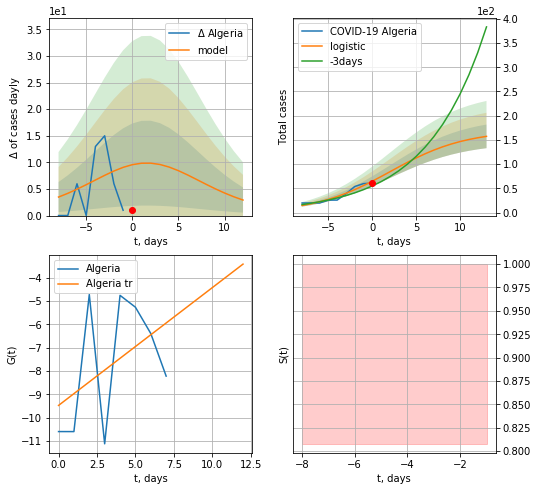

Algeria data at: 2020-07-05
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +13 days
	 deltaDaycases:  2
	 total cases:  157 ± 24
	 total death:  9 ± 4
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


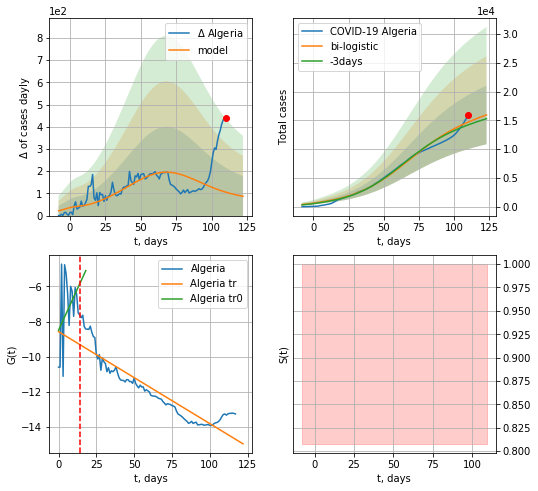

Algeria data at: 2020-07-05
+3 day model MAPE: 0.03528646502941695
model: bi-logistic
coeffs:  [1.53066399e+04 4.93963754e-02 6.71752306e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.31956936522431734
forecast at the end of period: +13 days
	 deltaDaycases:  86
	 total cases:  15953 ± 5098
	 total death:  952 ± 912
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.846538
 intercept: -8.576490
 slope: -0.052385


In [801]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*16-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*16-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


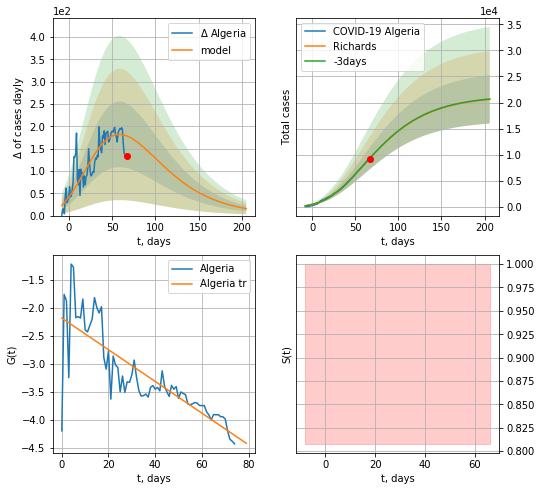

Algeria data at: 2020-07-05
+3 day model MAPE: 0.002676
model: Richards
coeffs: [ 2.12814905e+04  1.20319901e+00 -1.08693333e+02  1.95061272e-02]
rational stdev: 0.224506
forecast at the end of period: +139 days
	 deltaDaycases: 15
	 total cases: 20615 ± 4628
	 total death: 1231 ± 829
trend coefficient of determination: 0.678514
 intercept: -2.184065
 slope: -0.028199


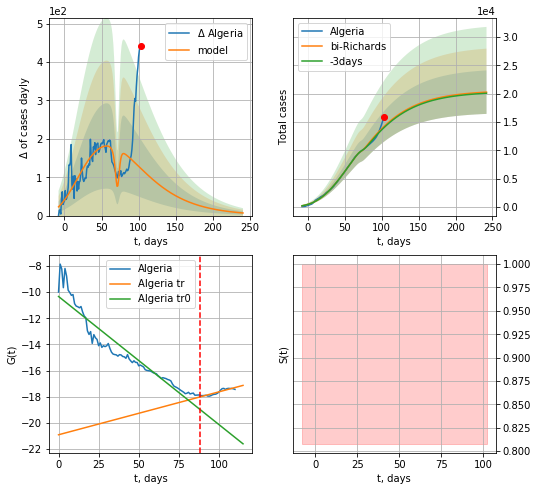

Algeria data at: 2020-07-05
+3 day model MAPE: 0.013947
model: bi-Richards
coeffs: [-7.18797205e+02  4.41952852e-01  7.24331799e+01  1.43126794e+00]
rational stdev: 0.189421
forecast at the end of period: +139 days
	 deltaDaycases: 6
	 total cases: 20274 ± 3840
	 total death: 1210 ± 687
bi-Richards approximation splitting point: 88
trend coefficient of determination: 0.903668
 intercept: -10.333879
 slope: -0.097959
trend coefficient of determination: 0.832876
 intercept: -20.906954
 slope: 0.032826


In [802]:
vL = 88+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


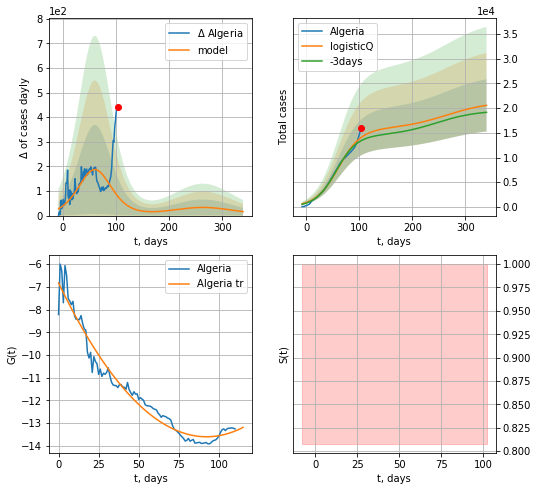

Algeria data at: 2020-07-05
+3 day model MAPE: 0.048993
model: logisticQ
coeffs: [ 1.57674265e+04  3.07394445e-07  6.05682678e+01 -1.53521526e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.257422
forecast at the end of period: +237 days
	 deltaDaycases: 16
	 total cases: 20562 ± 5293
	 total death: 1228 ± 948
trend coefficient of determination: 0.961522
 intercept_: -6.8248431446396225
 coeffs_: [ 0.         -0.14710072  0.00079723]


In [803]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
111 2020-07-01   999.0   147.0   19.0
112 2020-07-02   999.3   147.0   19.0
113 2020-07-03   999.6   141.0   19.0
114 2020-07-04  1002.0   144.0   19.0
115 2020-07-05  1003.0   145.0   19.0


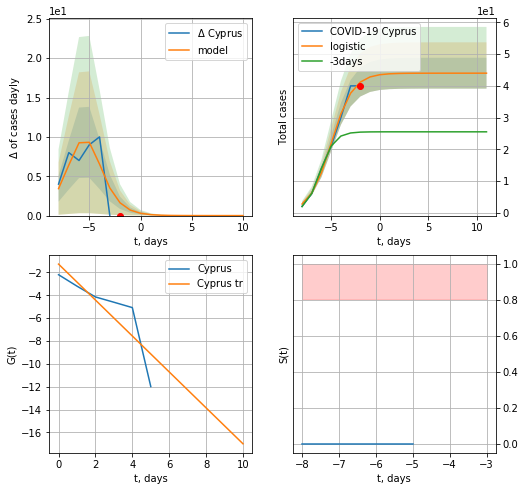

Cyprus data at: 2020-07-05
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  44 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


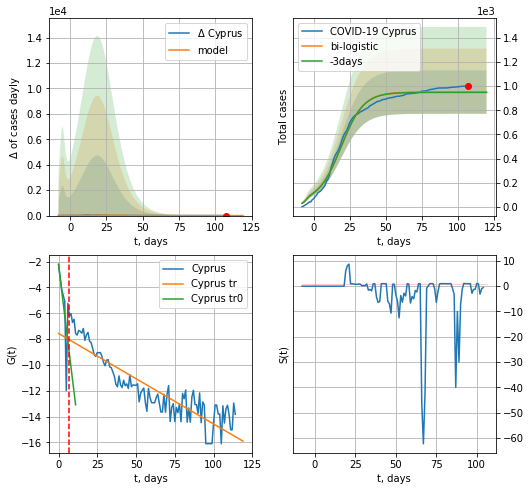

Cyprus data at: 2020-07-05
+3 day model MAPE: 0.0030447768441136227
model: bi-logistic
coeffs:  [9.07453793e+02 1.28028300e-01 1.91238302e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.18909792551542245
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  951 ± 179
	 total death:  18 ± 10
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.795465
 intercept: -7.563364
 slope: -0.070029


In [804]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*16-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


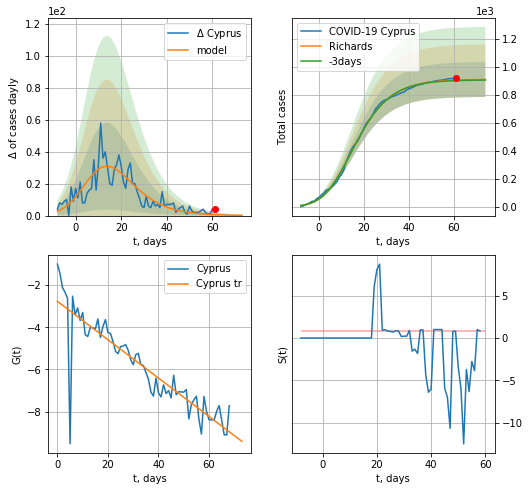

Cyprus data at: 2020-07-05
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 910 ± 125
	 total death: 17 ± 7
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


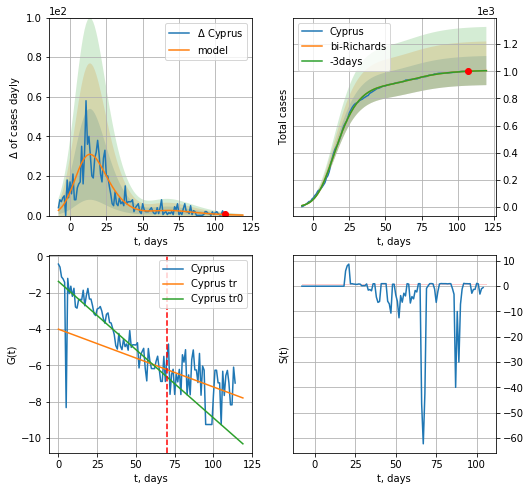

Cyprus data at: 2020-07-05
+3 day model MAPE: 0.000753
model: bi-Richards
coeffs: [ 9.66959762e+01  7.01070820e+00 -5.23760041e-02  9.44695045e-03]
rational stdev: 0.106789
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1005 ± 107
	 total death: 19 ± 6
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.729005
 intercept: -1.374847
 slope: -0.075200
trend coefficient of determination: 0.116215
 intercept: -4.007310
 slope: -0.031842


In [805]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


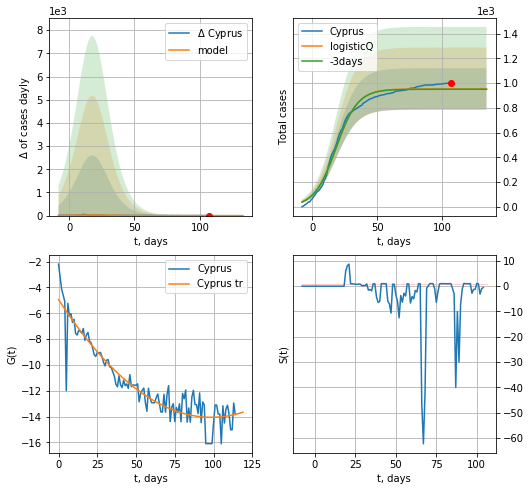

Cyprus data at: 2020-07-05
+3 day model MAPE: 0.002941
model: logisticQ
coeffs: [ 9.53673678e+02  3.46411496e-07  1.82348407e+01 -3.45284696e+05]
rational stdev: 0.175270
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 953 ± 167
	 total death: 18 ± 9
trend coefficient of determination: 0.872868
 intercept_: -4.944417383545273
 coeffs_: [ 0.         -0.18485253  0.00093826]


In [806]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active    death
116 2020-07-01  288477  100372.0   9860.0
117 2020-07-02  292004   99862.0  10045.0
118 2020-07-03  295599   99521.0  10226.0
119 2020-07-04  299080   99047.0  10412.0
120 2020-07-05  302718   98172.0  10589.0


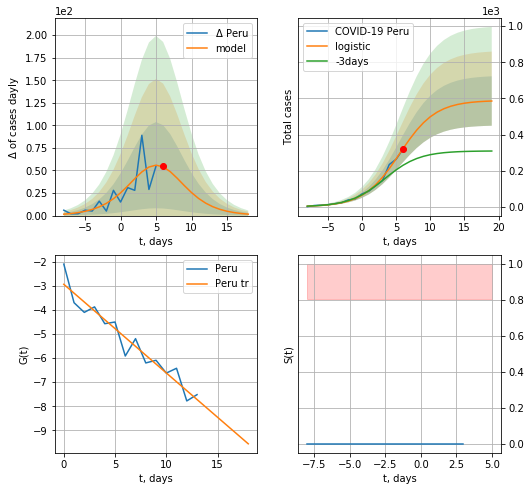

Peru data at: 2020-07-05
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  585 ± 136
	 total death:  20 ± 14
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


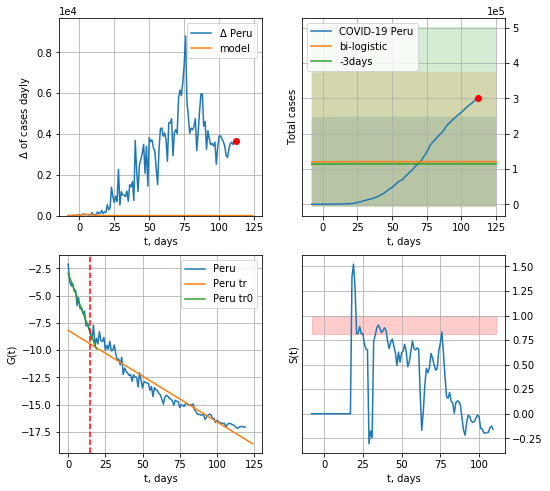

Peru data at: 2020-07-05
+3 day model MAPE: 0.05629604662048819
model: bi-logistic
coeffs:  [ 9.61005112e+04 -1.24409618e+01  3.08328299e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0554489717319533
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  120714 ± 127408
	 total death:  4222 ± 13368
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.937403
 intercept: -8.176663
 slope: -0.083964


In [808]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*16-dT)
xx = forecast2("Peru",dfPU[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


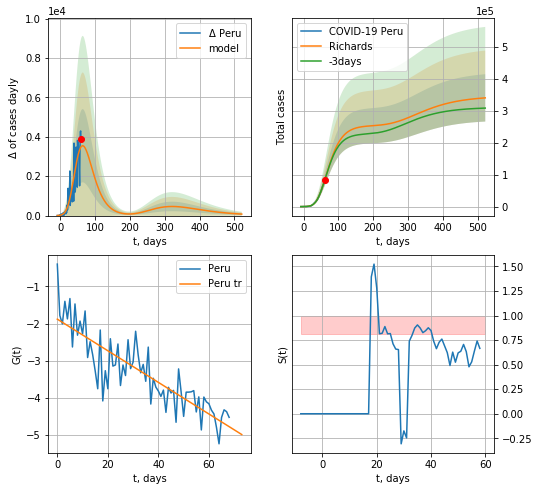

Peru data at: 2020-07-05
+3 day model MAPE: 0.004153
model: Richards
coeffs: [2.53867581e+05 3.16869248e-01 1.42807064e+01 1.27501600e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.217547
forecast at the end of period: +461 days
	 deltaDaycases: 75
	 total cases: 340242 ± 74018
	 total death: 11901 ± 7767
trend coefficient of determination: 0.729622
 intercept: -1.882679
 slope: -0.042523


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


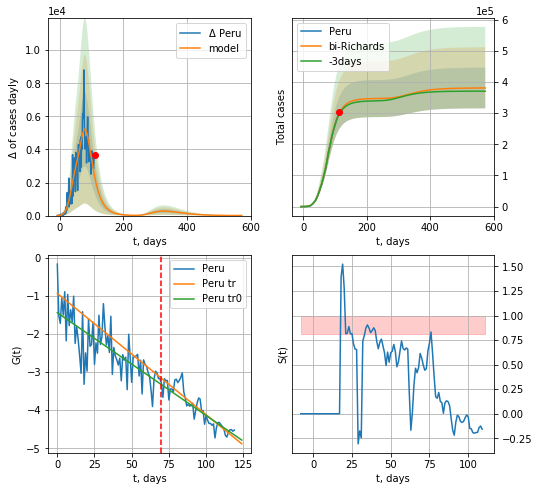

Peru data at: 2020-07-05
+3 day model MAPE: 0.011042
model: bi-Richards
coeffs: [9.30044850e+04 8.08312451e+00 8.93551247e+00 7.95942985e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.171593
forecast at the end of period: +461 days
	 deltaDaycases: 3
	 total cases: 380423 ± 65278
	 total death: 13307 ± 6850
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.545532
 intercept: -1.444383
 slope: -0.026948
trend coefficient of determination: 0.827946
 intercept: -0.938461
 slope: -0.031816


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


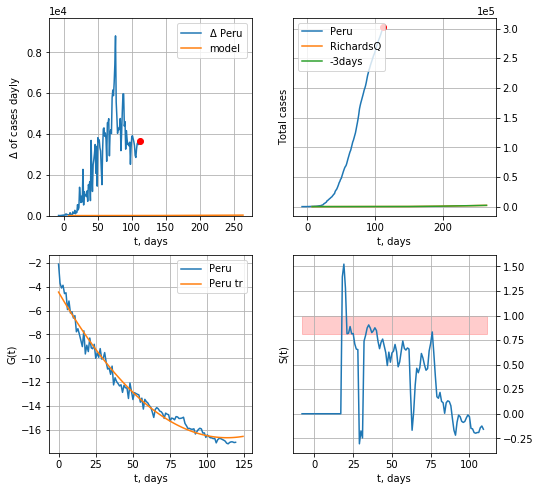

Peru data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.50045829e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +153 days
	 deltaDaycases: 22


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [817]:
vL = 70
x = forecastRR("Peru",dfPU[:vL],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,80*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


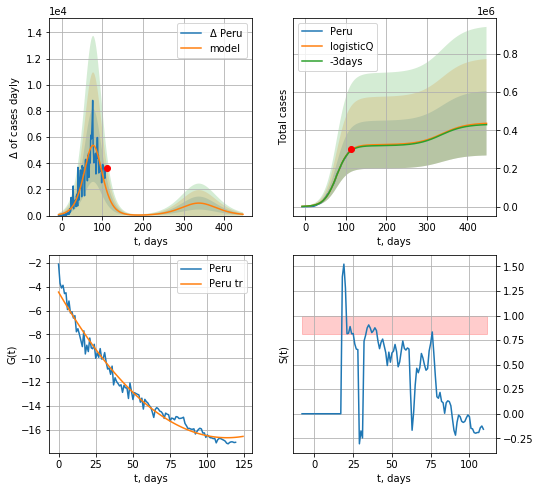

Peru data at: 2020-07-05
+3 day model MAPE: 0.010326
model: logisticQ
coeffs: [ 3.24516508e+05  8.77742863e-07  7.74893084e+01 -7.53332691e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385926
forecast at the end of period: +335 days
	 deltaDaycases: 97
	 total cases: 436498 ± 168456
	 total death: 15268 ± 17676
trend coefficient of determination: 0.978771
 intercept_: -4.446124641805753
 coeffs_: [ 0.         -0.21572011  0.0009528 ]


In [818]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active    death
123 2020-07-01  605220  227476.0  17848.0
124 2020-07-02  627168  229041.0  18225.0
125 2020-07-03  649889  236901.0  18669.0
126 2020-07-04  673904  245542.0  19279.0
127 2020-07-05  699402  254625.0  19707.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


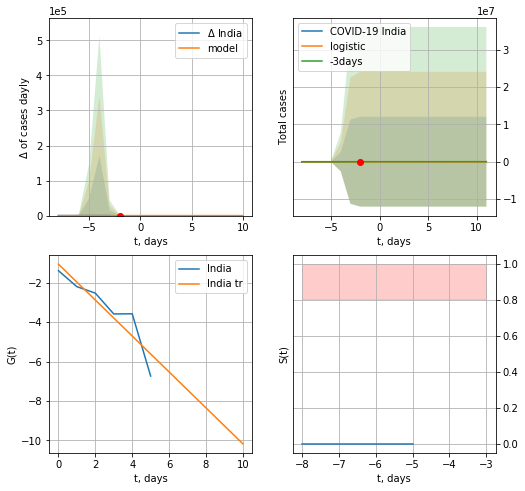

India data at: 2020-07-05
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


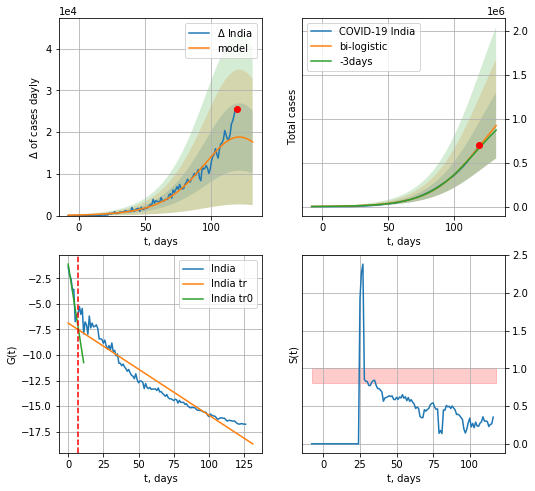

India data at: 2020-07-05
+3 day model MAPE: 0.028922371773834787
model: bi-logistic
coeffs:  [1.44258605e+06 5.19287179e-02 1.21177781e+02] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.40568567869603633
forecast at the end of period: +13 days
	 deltaDaycases:  17647
	 total cases:  922902 ± 374408
	 total death:  26004 ± 31648
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.925540
 intercept: -6.881823
 slope: -0.090070


In [819]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*16-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


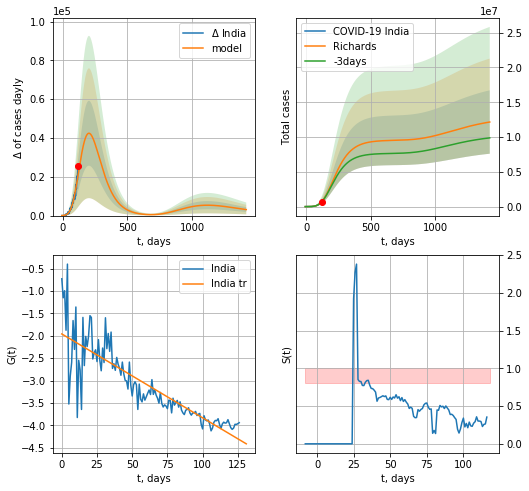

India data at: 2020-07-05
+3 day model MAPE: 0.013350
model: Richards
coeffs: [ 9.54730615e+06  2.63609803e-01 -4.51161282e+01  4.69065995e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.374744
forecast at the end of period: +1301 days
	 deltaDaycases: 3093
	 total cases: 12162414 ± 4557789
	 total death: 342699 ± 385272
trend coefficient of determination: 0.724231
 intercept: -1.958586
 slope: -0.018749


In [820]:
x = forecastRR("India",dfID[:],d1,200*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


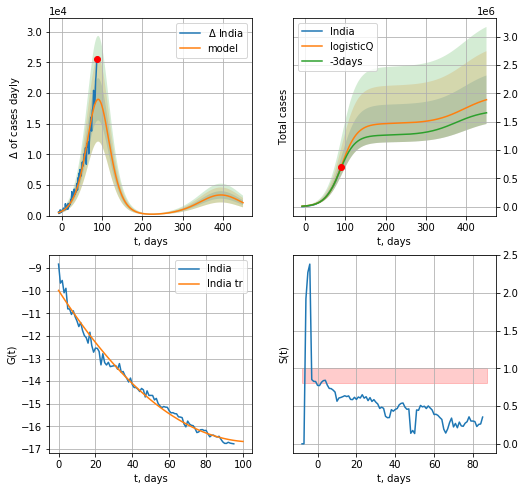

India data at: 2020-07-05
+3 day model MAPE: 0.028521
model: logisticQ
coeffs: [ 1.46651810e+06  2.70587204e-06  9.07394728e+01 -1.90174110e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.226863
forecast at the end of period: +363 days
	 deltaDaycases: 2103
	 total cases: 1886327 ± 427938
	 total death: 53150 ± 36173
trend coefficient of determination: 0.984865
 intercept_: -9.985398327784807
 coeffs_: [ 0.         -0.12703276  0.00060225]


In [821]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date    cases   active   death
119 2020-07-01  67197.0  42806.0  1351.0
120 2020-07-02  69941.0  44370.0  1385.0
121 2020-07-03  72786.0  46125.0  1437.0
122 2020-07-04  75376.0  47965.0  1481.0
123 2020-07-05  77815.0  48711.0  1507.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


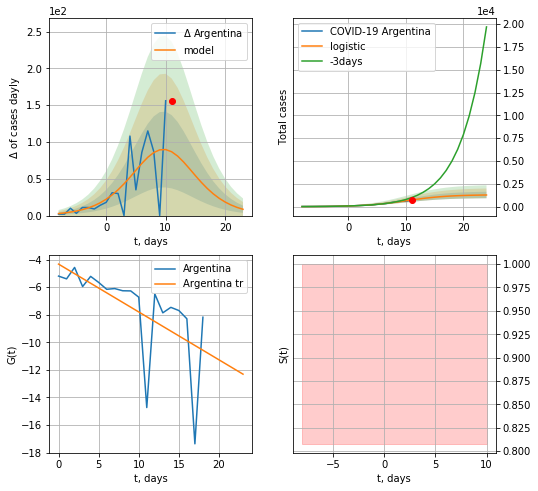

Argentina data at: 2020-07-05
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +13 days
	 deltaDaycases:  8
	 total cases:  1278 ± 355
	 total death:  24 ± 19
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


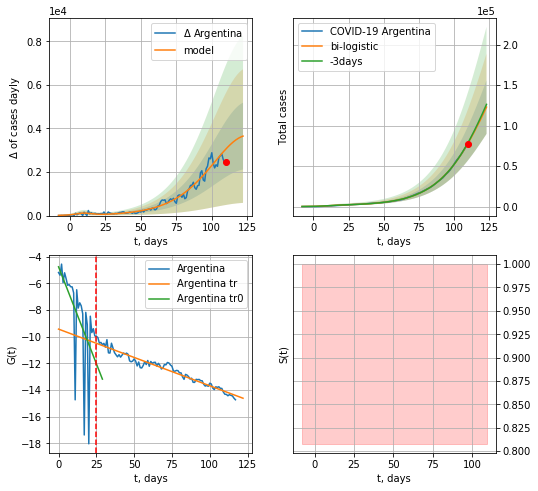

Argentina data at: 2020-07-05
+3 day model MAPE: 0.01004676096581926
model: bi-logistic
coeffs:  [2.68872343e+05 5.49362926e-02 1.26528880e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.26885232204015636
forecast at the end of period: +13 days
	 deltaDaycases:  3650
	 total cases:  122804 ± 33016
	 total death:  2378 ± 1917
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.951746
 intercept: -9.433888
 slope: -0.042421


In [823]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*16-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,16*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

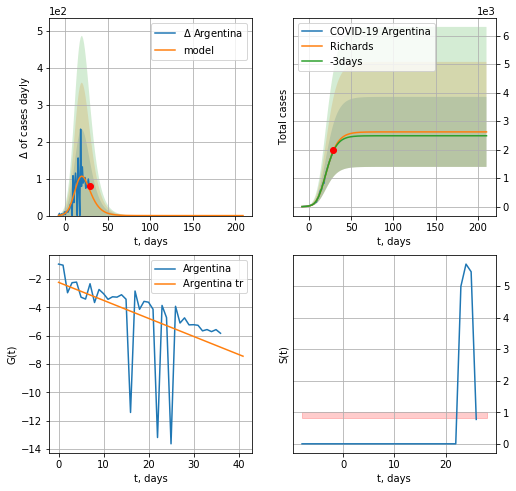

Argentina data at: 2020-07-05
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031748e+03 3.73236918e-01 1.15845148e+01 3.46306259e-01]
rational stdev: 0.468281
forecast at the end of period: +181 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 50 ± 70
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


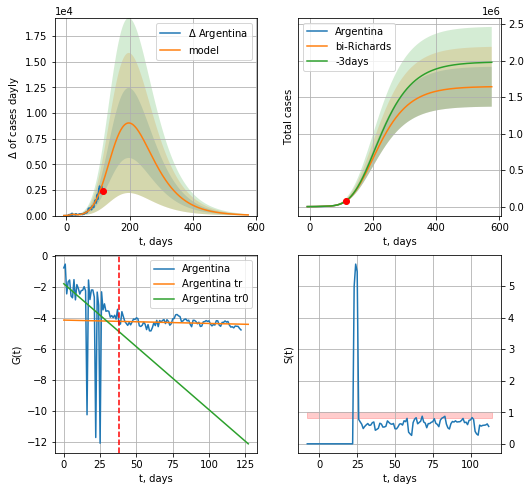

Argentina data at: 2020-07-05
+3 day model MAPE: 0.007040
model: bi-Richards
coeffs: [1.64300175e+06 1.34775031e-01 6.21101288e+01 1.17213006e-01]
rational stdev: 0.166332
forecast at the end of period: +461 days
	 deltaDaycases: 66
	 total cases: 1641449 ± 273025
	 total death: 31789 ± 15862
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.125474
 intercept: -1.799987
 slope: -0.081407
trend coefficient of determination: 0.049798
 intercept: -4.146598
 slope: -0.002161


In [824]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


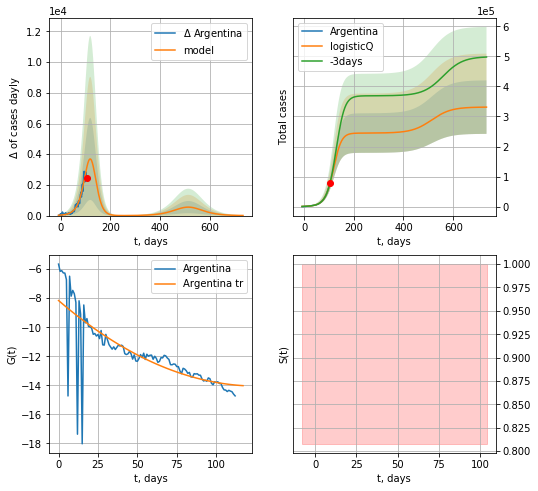

Argentina data at: 2020-07-05
+3 day model MAPE: 0.020230
model: logisticQ
coeffs: [ 2.44656948e+05  1.04077143e-04  1.17664491e+02 -4.60416428e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.268774
forecast at the end of period: +629 days
	 deltaDaycases: 7
	 total cases: 331038 ± 88974
	 total death: 6411 ± 5169
trend coefficient of determination: 0.593873
 intercept_: -8.158887232614696
 coeffs_: [ 0.         -0.09340354  0.00037021]


In [825]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


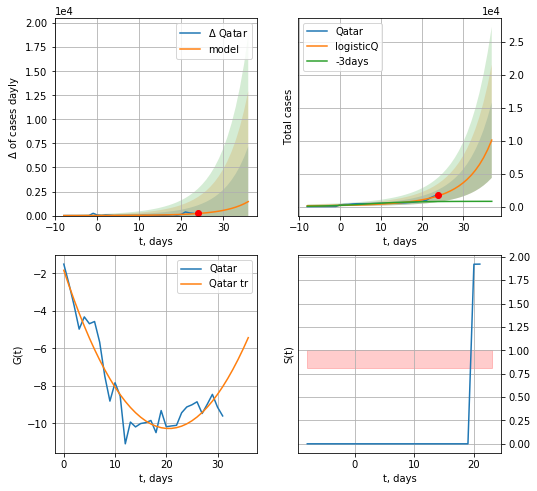

Qatar data at: 2020-07-05
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +13 days
	 deltaDaycases: 1453
	 total cases: 10110 ± 5735
	 total death: 12 ± 20
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


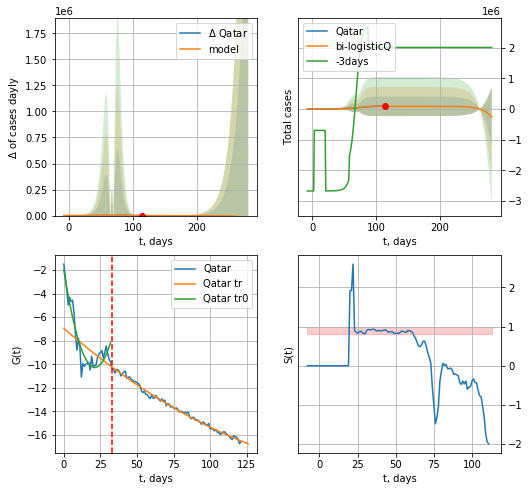

Qatar data at: 2020-07-05
+3 day model MAPE: 0.957361
model: bi-logisticQ
coeffs: [-4.59090662e+06  1.38234179e-03  6.79520248e+01 -1.08858463e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 3.713315
forecast at the end of period: +167 days
	 deltaDaycases: -22726
	 total cases: -262094 ± -973238
	 total death: -336 ± -3743
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.991661
 intercept_: -6.962554615463734
 coeffs_: [ 0.         -0.10724138  0.00023446]


In [826]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*16-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


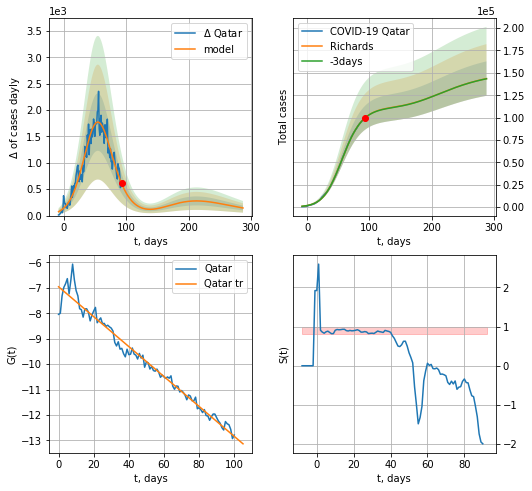

Qatar data at: 2020-07-05
+3 day model MAPE: 0.001145
model: Richards
coeffs: [1.11525511e+05 8.52759277e-02 4.82511919e+01 6.68786120e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.134117
forecast at the end of period: +195 days
	 deltaDaycases: 144
	 total cases: 143593 ± 19258
	 total death: 184 ± 74
trend coefficient of determination: 0.971358
 intercept: -6.957573
 slope: -0.058795


In [842]:
iL = 21
vL = 99 + iL
x = forecastRR('Qatar',dfQR[iL:].fillna(0),d1,42*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [843]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
137 2020-07-01  49069.0   10593  316.0
138 2020-07-02  49469.0   10488  317.0
139 2020-07-03  50141.0   10670  318.0
140 2020-07-04  50857.0   10679  321.0
141 2020-07-05  51540.0   10920  323.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


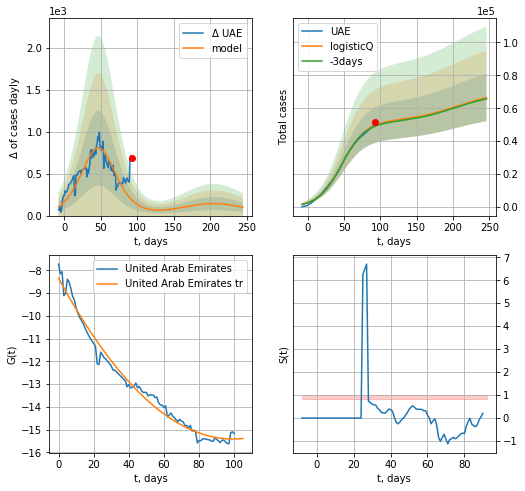

UAE data at: 2020-07-05
+3 day model MAPE: 0.011651
model: logisticQ
coeffs: [ 5.20775214e+04  6.70356101e-07  4.70933379e+01 -9.17280386e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.215155
forecast at the end of period: +153 days
	 deltaDaycases: 99
	 total cases: 66447 ± 14296
	 total death: 416 ± 268
trend coefficient of determination: 0.981328
 intercept_: -8.353653608235568
 coeffs_: [ 0.         -0.14234691  0.00071745]


In [844]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


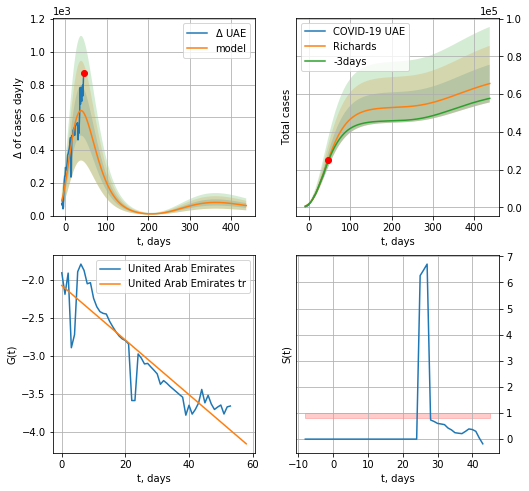

UAE data at: 2020-07-05
+3 day model MAPE: 0.028798
model: Richards
coeffs: [ 5.30737629e+04  1.10412183e+00 -6.62067699e+01  3.01726179e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.152521
forecast at the end of period: +391 days
	 deltaDaycases: 61
	 total cases: 65605 ± 10006
	 total death: 411 ± 188
trend coefficient of determination: 0.830554
 intercept: -2.075527
 slope: -0.035953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


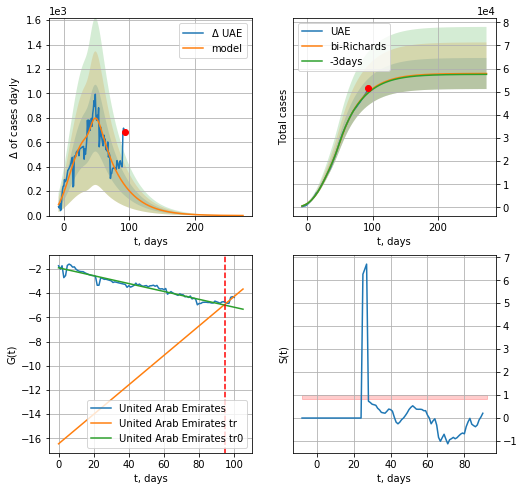

UAE data at: 2020-07-05
+3 day model MAPE: 0.006859
model: bi-Richards
coeffs: [ 4.80978349e+03  4.07578427e+01 -3.54570303e+00  2.67329683e-03]
rational stdev: 0.116006
forecast at the end of period: +181 days
	 deltaDaycases: 0
	 total cases: 57862 ± 6712
	 total death: 362 ± 125
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.941326
 intercept: -1.906657
 slope: -0.032575
trend coefficient of determination: 0.708222
 intercept: -16.444211
 slope: 0.121744


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


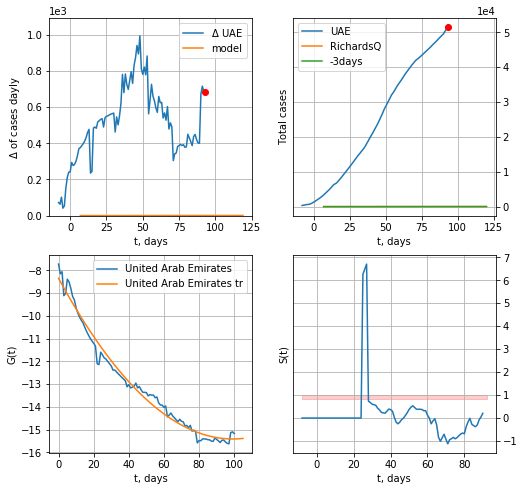

UAE data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.64994494e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +27 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [846]:
iL = 40
vL = 95 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [847]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
120 2020-07-01  194225.0   59767  1698.0
121 2020-07-02  197608.0   58187  1752.0
122 2020-07-03  201801.0   59385  1802.0
123 2020-07-04  205929.0   60815  1858.0
124 2020-07-05  209509.0   62357  1916.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


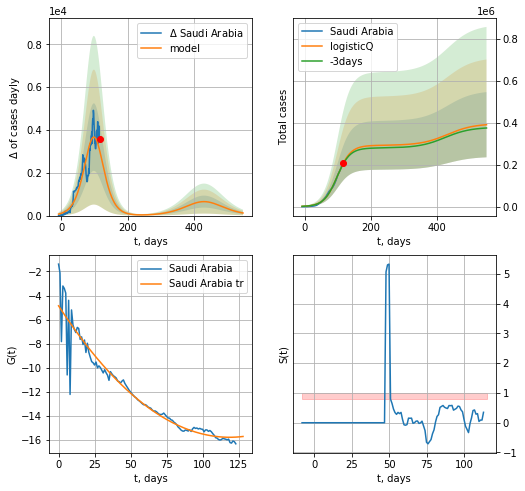

Saudi Arabia data at: 2020-07-05
+3 day model MAPE: 0.014821
model: logisticQ
coeffs: [ 2.91909474e+05  5.83005697e-07  9.88444024e+01 -8.60794237e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.398059
forecast at the end of period: +433 days
	 deltaDaycases: 120
	 total cases: 390320 ± 155370
	 total death: 3569 ± 4262
trend coefficient of determination: 0.922436
 intercept_: -4.8518120342063975
 coeffs_: [ 0.         -0.18412694  0.00077565]


In [849]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


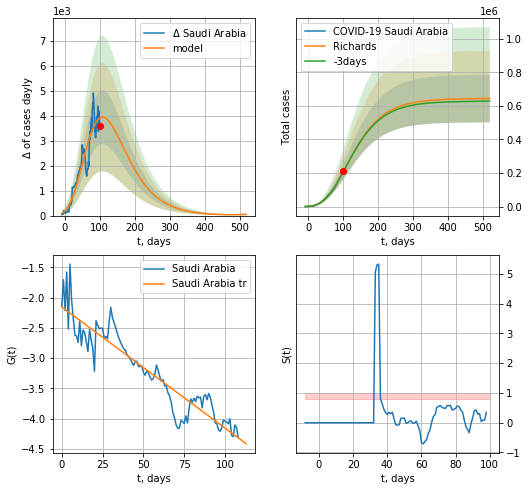

Saudi Arabia data at: 2020-07-05
+3 day model MAPE: 0.002830
model: Richards
coeffs: [ 6.44034758e+05  8.88666073e-01 -1.27238304e+02  1.89217130e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.220177
forecast at the end of period: +419 days
	 deltaDaycases: 49
	 total cases: 644740 ± 141956
	 total death: 5896 ± 3894
trend coefficient of determination: 0.860061
 intercept: -2.153432
 slope: -0.020017


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


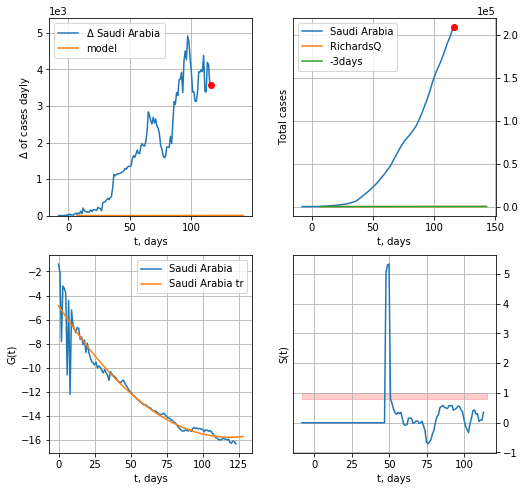

Saudi Arabia data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.80774879e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +27 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [854]:
x = forecastRR('Saudi Arabia',dfSA[15:],d1,74*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
113 2020-07-01  2054.0     295   11.0
114 2020-07-02  2066.0     228   11.0
115 2020-07-03  2069.0     195   11.0
116 2020-07-04  2074.0     178   11.0
117 2020-07-05  2076.0     162   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


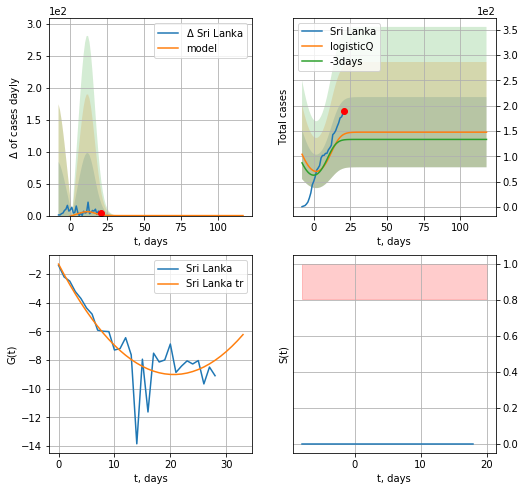

Sri Lanka data at: 2020-07-05
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +97 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


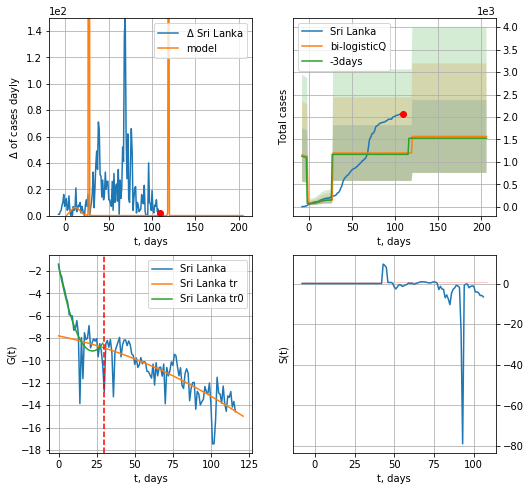

Sri Lanka data at: 2020-07-05
+3 day model MAPE: 0.024954
model: bi-logisticQ
coeffs: [1046.91609747    4.23319634   27.3744674    -1.44044521]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.519772
forecast at the end of period: +97 days
	 deltaDaycases: 0
	 total cases: 1565 ± 813
	 total death: 8 ± 12
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.631123
 intercept_: -7.8032708589323665
 coeffs_: [ 0.         -0.0284332  -0.00025537]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [855]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

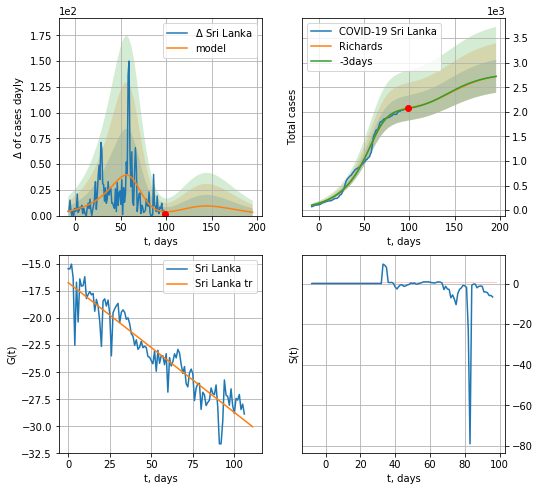

Sri Lanka data at: 2020-07-05
+3 day model MAPE: 0.005153
model: Richards
coeffs: [2.06273632e+03 4.11581967e-02 6.54395143e+01 2.87033351e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.122980
forecast at the end of period: +97 days
	 deltaDaycases: 3
	 total cases: 2723 ± 334
	 total death: 14 ± 5
trend coefficient of determination: 0.879512
 intercept: -16.709559
 slope: -0.120091


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


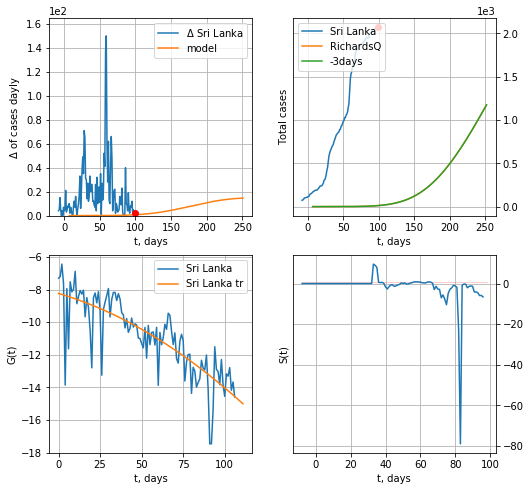

Sri Lanka data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.57221899e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +153 days
	 deltaDaycases: 14


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [856]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,28*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
125 2020-07-01  217809.0  108642  4473.0
126 2020-07-02  221896.0  103722  4551.0
127 2020-07-03  225283.0   95570  4619.0
128 2020-07-04  228474.0   93932  4712.0
129 2020-07-05  231818.0   95407  4762.0


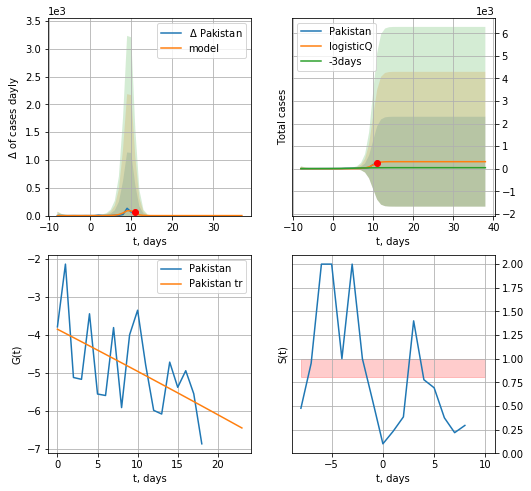

Pakistan data at: 2020-07-05
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


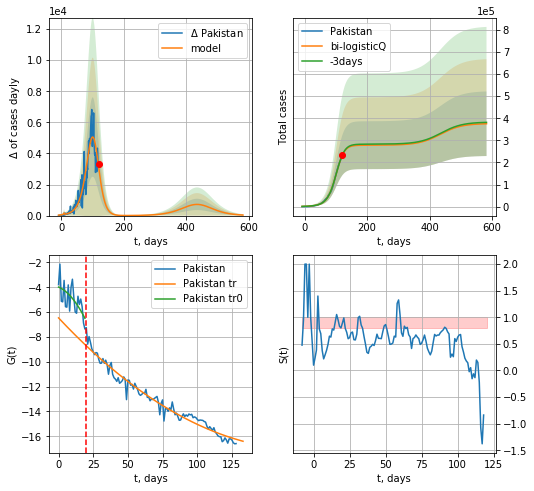

Pakistan data at: 2020-07-05
+3 day model MAPE: 0.006139
model: bi-logisticQ
coeffs: [ 2.77676898e+05  1.85543356e-04  9.95221972e+01 -2.91018854e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.389615
forecast at the end of period: +461 days
	 deltaDaycases: 35
	 total cases: 375189 ± 146179
	 total death: 7707 ± 9008
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.965856
 intercept_: -6.463938258920187
 coeffs_: [ 0.         -0.11915939  0.00033404]


In [857]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


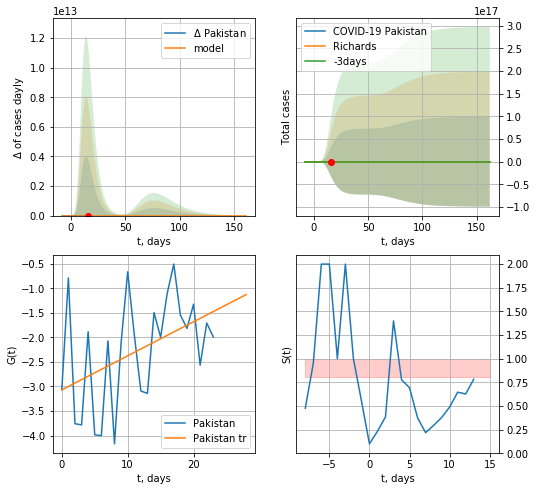

Pakistan data at: 2020-07-05
+3 day model MAPE: 0.118161
model: Richards
coeffs: [ 1.63793589e+03  6.01089634e+00 -3.06352612e+00  3.22292207e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 44401640452651.890625
forecast at the end of period: +146 days
	 deltaDaycases: 0
	 total cases: 2229 ± 98991448132614272
	 total death: 45 ± 5994221461108005
trend coefficient of determination: 0.194246
 intercept: -3.069579
 slope: 0.069356


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


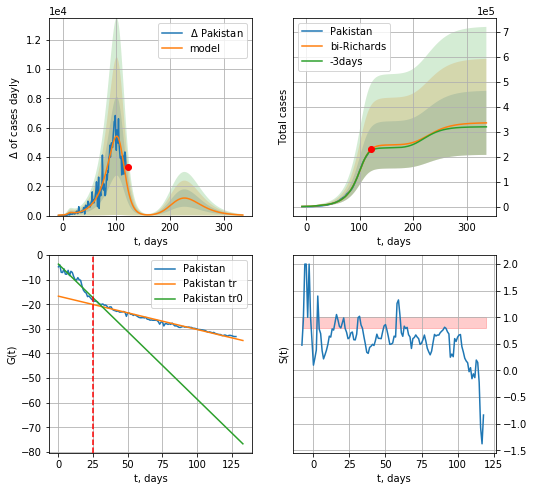

Pakistan data at: 2020-07-05
+3 day model MAPE: 0.023034
model: bi-Richards
coeffs: [2.45462341e+05 5.27689112e-02 1.08053008e+02 2.33813267e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.382161
forecast at the end of period: +216 days
	 deltaDaycases: 37
	 total cases: 335185 ± 128094
	 total death: 6885 ± 7893
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.897099
 intercept: -3.679835
 slope: -0.549099
trend coefficient of determination: 0.975849
 intercept: -16.709863
 slope: -0.135440


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


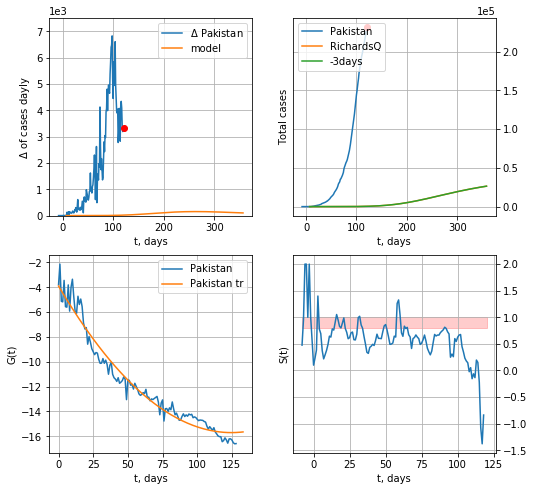

Pakistan data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.68498873e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +237 days
	 deltaDaycases: 101


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [858]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,45*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
115 2020-07-01  149258.0   85262  1888.0
116 2020-07-02  153277.0   84909  1926.0
117 2020-07-03  156391.0   86375  1968.0
118 2020-07-04  159679.0   86961  1997.0
119 2020-07-05  165618.0   87373  2096.0


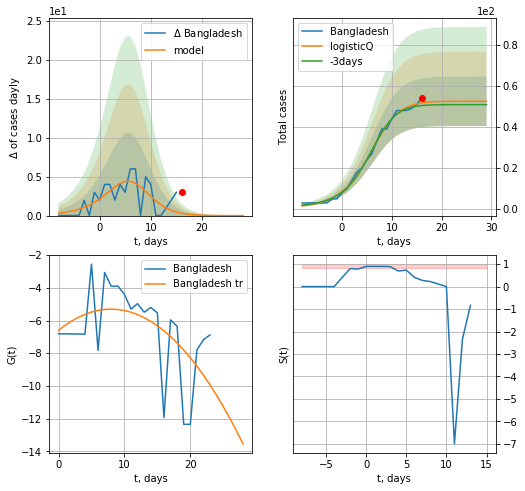

Bangladesh data at: 2020-07-05
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


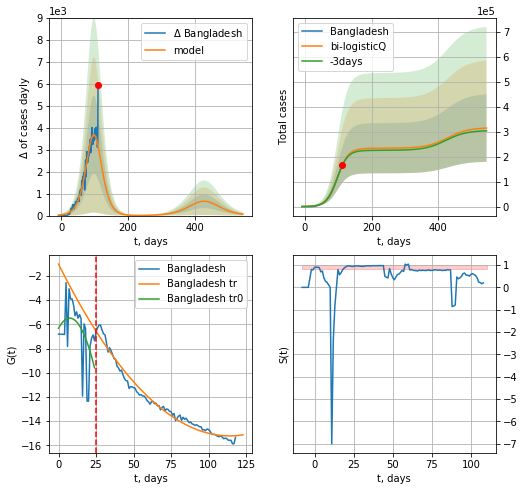

Bangladesh data at: 2020-07-05
+3 day model MAPE: 0.012059
model: bi-logisticQ
coeffs: [ 2.33643082e+05  1.66646858e-06  9.80189271e+01 -3.77143103e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.429489
forecast at the end of period: +433 days
	 deltaDaycases: 62
	 total cases: 314439 ± 135048
	 total death: 3979 ± 5126
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.977144
 intercept_: -1.026215909253727
 coeffs_: [ 0.         -0.2488912   0.00109099]


In [860]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


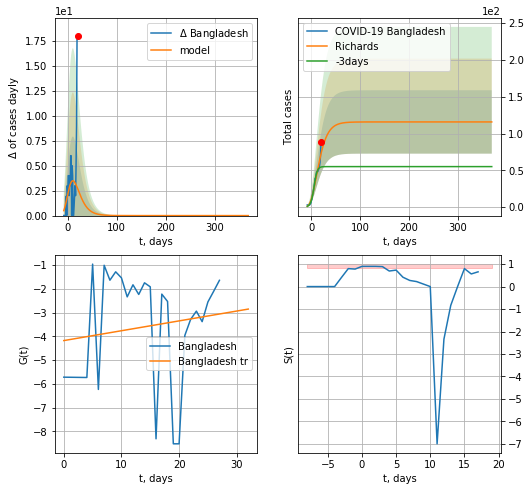

Bangladesh data at: 2020-07-05
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +349 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


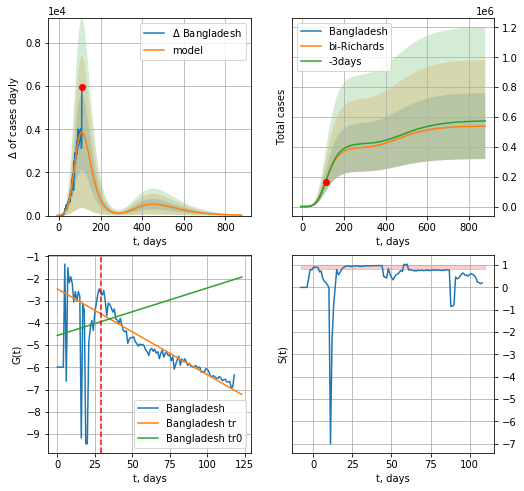

Bangladesh data at: 2020-07-05
+3 day model MAPE: 0.003949
model: bi-Richards
coeffs: [3.97257985e+05 1.18796148e-01 6.39500578e+01 2.50437223e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.410138
forecast at the end of period: +769 days
	 deltaDaycases: 18
	 total cases: 539480 ± 221261
	 total death: 6827 ± 8400
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.006220
 intercept: -4.561614
 slope: 0.021393
trend coefficient of determination: 0.894886
 intercept: -2.461406
 slope: -0.038703


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: operands could not be broadcast together with shapes (120,) (119,) 

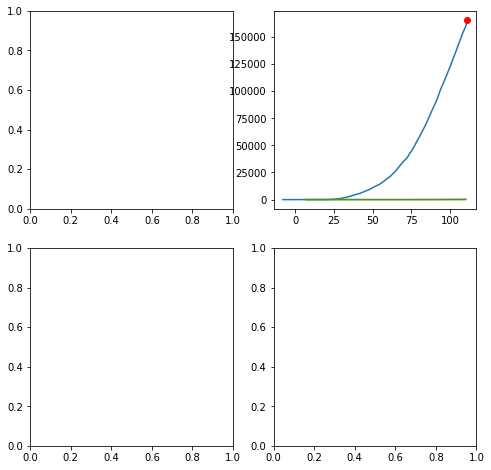

In [861]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,124*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,14*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
128 2020-07-01  46940.0    8867  358.0
129 2020-07-02  47859.0    9110  359.0
130 2020-07-03  48672.0    9036  360.0
131 2020-07-04  49303.0    8995  365.0
132 2020-07-05  49941.0    9110  368.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


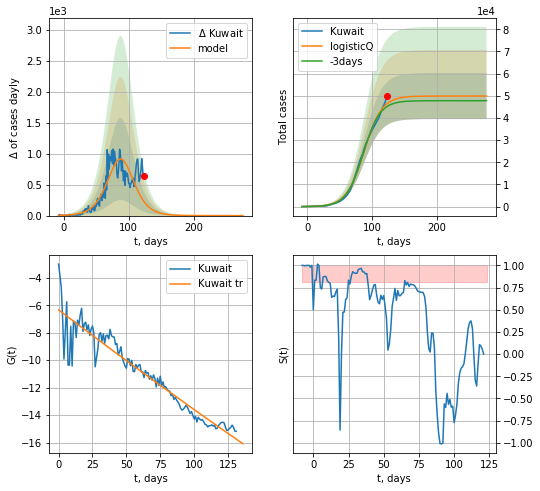

Kuwait data at: 2020-07-05
+3 day model MAPE: 0.029539
model: logisticQ
coeffs: [ 4.98870319e+04  5.35100635e-07  8.79279981e+01 -1.36839982e+05]
rational stdev: 0.208351
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 49886 ± 10394
	 total death: 367 ± 229
trend coefficient of determination: 0.905509
 intercept_: -6.332377971914351
 coeffs_: [ 0.00000000e+00 -7.52127349e-02  2.55058302e-05]


In [862]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


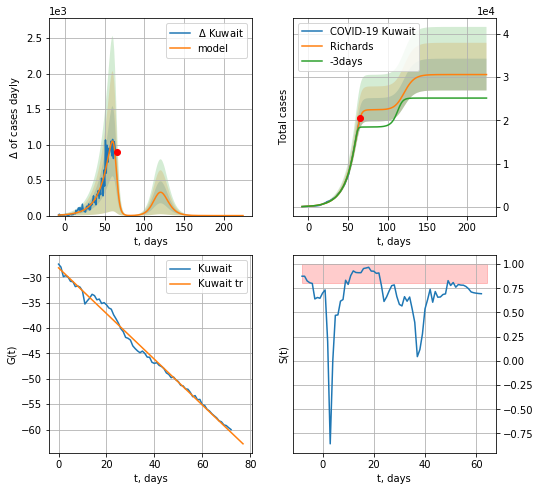

Kuwait data at: 2020-07-05
+3 day model MAPE: 0.136559
model: Richards
coeffs: [2.24365721e+04 7.66634185e-02 6.43548410e+01 5.72971743e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.119998
forecast at the end of period: +160 days
	 deltaDaycases: 0
	 total cases: 30568 ± 3668
	 total death: 225 ± 80
trend coefficient of determination: 0.993036
 intercept: -28.143718
 slope: -0.450232


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


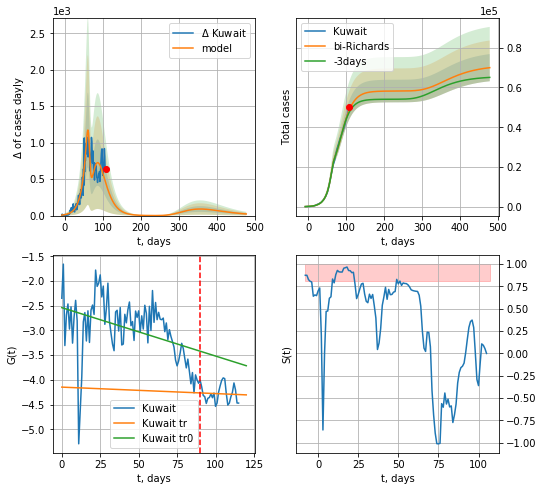

Kuwait data at: 2020-07-05
+3 day model MAPE: 0.024930
model: bi-Richards
coeffs: [3.57905227e+04 5.42376471e+00 4.11156802e+00 1.02205054e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.097699
forecast at the end of period: +370 days
	 deltaDaycases: 22
	 total cases: 69966 ± 6835
	 total death: 515 ± 150
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.169358
 intercept: -2.537551
 slope: -0.009804
trend coefficient of determination: 0.003237
 intercept: -4.147217
 slope: -0.001308


In [864]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,67*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
122 2020-07-01  33387.0   14729  754.0
123 2020-07-02  34197.0   15291  765.0
124 2020-07-03  35148.0   15981  775.0
125 2020-07-04  36184.0   16796  786.0
126 2020-07-05  37425.0   17688  794.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


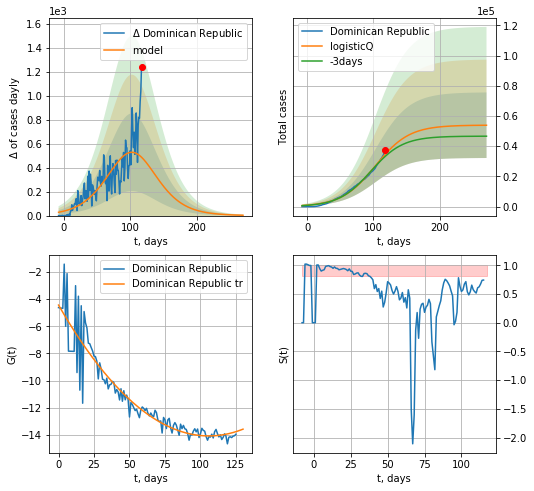

Dominican Republic data at: 2020-07-05
+3 day model MAPE: 0.043743
model: logisticQ
coeffs: [ 5.39375671e+04  3.36327027e-07  1.02857814e+02 -1.16192287e+05]
rational stdev: 0.402764
forecast at the end of period: +153 days
	 deltaDaycases: 2
	 total cases: 53863 ± 21694
	 total death: 1142 ± 1379
trend coefficient of determination: 0.882274
 intercept_: -4.439267294392643
 coeffs_: [ 0.         -0.18174935  0.00085816]


In [865]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


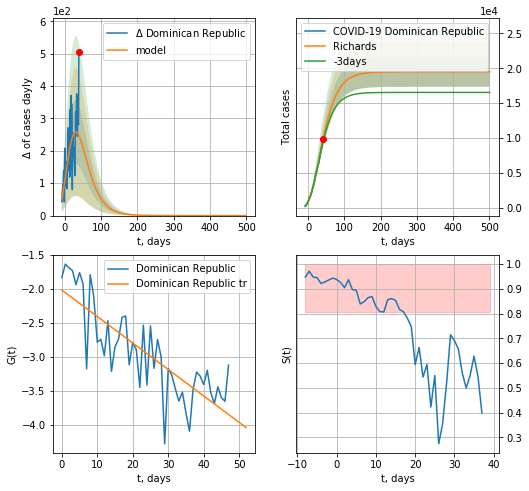

Dominican Republic data at: 2020-07-05
+3 day model MAPE: 0.031616
model: Richards
coeffs: [ 1.94891313e+04  2.23734826e+00 -8.23176807e+01  1.62469201e-02]
rational stdev: 0.109843
forecast at the end of period: +461 days
	 deltaDaycases: 0
	 total cases: 19489 ± 2140
	 total death: 413 ± 136
trend coefficient of determination: 0.650419
 intercept: -2.014545
 slope: -0.039027


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


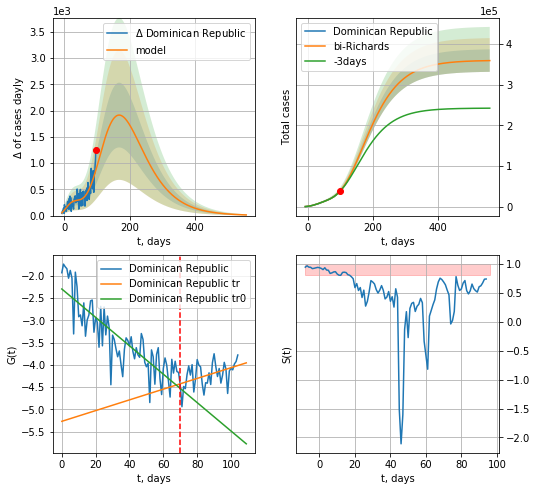

Dominican Republic data at: 2020-07-05
+3 day model MAPE: 0.012168
model: bi-Richards
coeffs: [ 3.40348963e+05  4.38945832e-01 -4.69583267e+01  3.53378385e-02]
rational stdev: 0.076896
forecast at the end of period: +461 days
	 deltaDaycases: 12
	 total cases: 359029 ± 27607
	 total death: 7617 ± 1757
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.717829
 intercept: -2.298698
 slope: -0.031840
trend coefficient of determination: 0.199644
 intercept: -5.265197
 slope: 0.012022


In [866]:
vL = 70+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active  death
116 2020-07-01  16898.0    6755  549.0
117 2020-07-02  17150.0    6744  560.0
118 2020-07-03  17445.0    6780  572.0
119 2020-07-04  17672.0    6696  580.0
120 2020-07-05  17814.0    6511  585.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


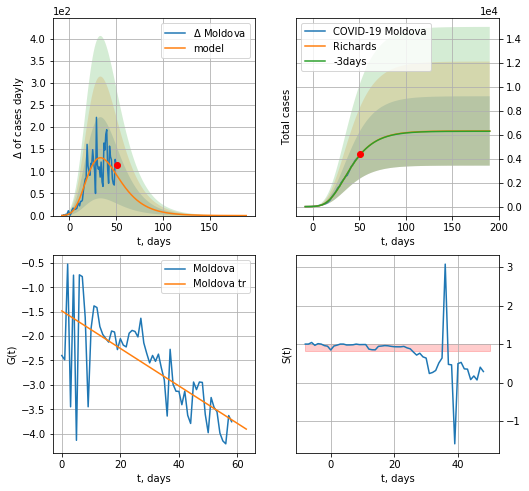

Moldova data at: 2020-07-05
+3 day model MAPE: 0.000788
model: Richards
coeffs: [ 6.30547574e+03  3.98849226e+00 -4.11476415e+01  1.42380272e-02]
rational stdev: 0.458349
forecast at the end of period: +139 days
	 deltaDaycases: 0
	 total cases: 6304 ± 2889
	 total death: 207 ± 284
trend coefficient of determination: 0.512179
 intercept: -1.485671
 slope: -0.038427


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


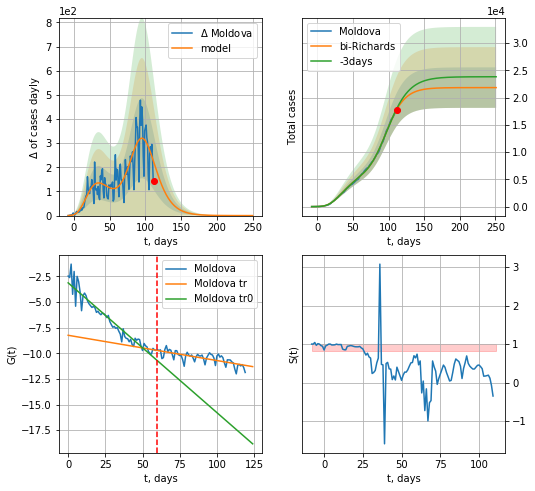

Moldova data at: 2020-07-05
+3 day model MAPE: 0.012460
model: bi-Richards
coeffs: [1.55329230e+04 1.01403281e-01 9.15981169e+01 7.19337052e-01]
rational stdev: 0.170054
forecast at the end of period: +139 days
	 deltaDaycases: 0
	 total cases: 21838 ± 3713
	 total death: 717 ± 365
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.918147
 intercept: -3.129135
 slope: -0.126643
trend coefficient of determination: 0.537018
 intercept: -8.244690
 slope: -0.024639


In [867]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [403]:
#np.diff(dfAF["cases"])

AF
           date     cases  active   death
116 2020-06-29  144264.0   71121  2529.0
117 2020-06-30  151209.0   75009  2657.0
118 2020-07-01  159333.0   80559  2749.0
119 2020-07-02  168061.0   83218  2844.0
120 2020-07-03  177124.0   87874  2952.0


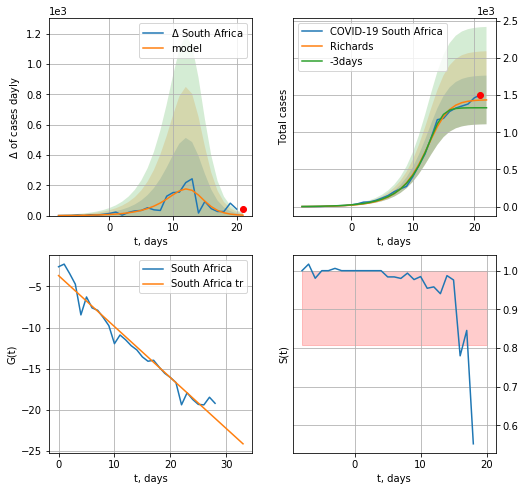

South Africa data at: 2020-07-03
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832007e+03 3.09188728e-01 1.37785508e+01 2.13840807e+00]
rational stdev: 0.227967
forecast at the end of period: +1 days
	 deltaDaycases: 2
	 total cases: 1435 ± 327
	 total death: 23 ± 15
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


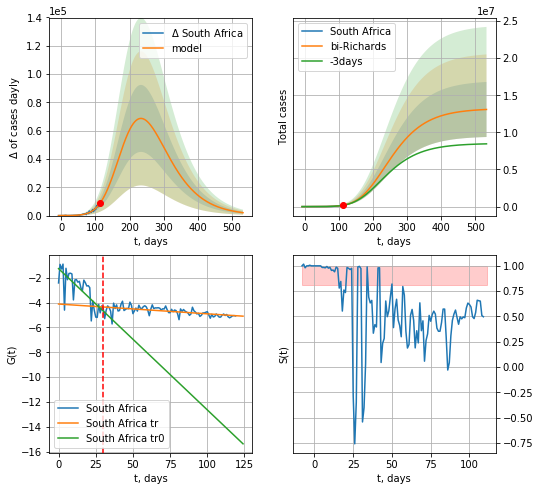

South Africa data at: 2020-07-03
+3 day model MAPE: 0.015333
model: bi-Richards
coeffs: [1.32137024e+07 8.82920026e-02 1.19568614e+02 1.73692859e-01]
rational stdev: 0.283374
forecast at the end of period: +421 days
	 deltaDaycases: 2048
	 total cases: 13081751 ± 3707031
	 total death: 218024 ± 185347
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.547914
 intercept: -1.259318
 slope: -0.113814
trend coefficient of determination: 0.359462
 intercept: -4.113447
 slope: -0.007879


In [404]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [350]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [420]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [421]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"1,748,484",North America,\nNorth America\n,,"+5,976",292,"+3,692",,"19,187",,"3,494,700","175,651","1,570,565",,
1,,\n,,,"865,742",South America,\nSouth America\n,,"+1,226",56,395,,"13,499",,"2,515,360","93,741","1,555,877",,
2,,\n,,,"785,044",Asia,\nAsia\n,,"+14,335",227,"+7,884",,"19,462",,"2,593,787","62,390","1,746,353",,
3,,\n,,,"855,993",Europe,\nEurope\n,,"+7,821",173,"+4,910",,"5,563",,"2,485,393","193,870","1,435,530",,
4,,\n,,,"238,644",Africa,\nAfrica\n,,330,2,113,,945,,"480,175","11,402","230,129",,
5,,\n,,,"1,088",Australia/Oceania,\nOceania\n,,139,2,21,,7,,"10,233",128,"9,017",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,495,050",All,World,68.9,"+29,827",752,"+17,015",,"58,667",,"11,580,369","537,197","6,548,122",,"1,486"
8,1,111,"2,497",9,"1,560,897",North America,USA,400,227,2,123,"331,028,744","16,038","113,593","2,983,155","132,571","1,289,687","37,602,471","9,012"
9,2,132,"3,275",64,"561,070",South America,Brazil,305,,,,"212,578,788","8,318","15,667","1,604,585","64,900","978,615","3,330,562","7,548"


In [422]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,748,484",North America,\nNorth America\n,,"+5,976",292,"+3,692",,"19,187",,"3,494,700","175,651","1,570,565",,
1,,\n,,,"865,742",South America,\nSouth America\n,,"+1,226",56,395,,"13,499",,"2,515,360","93,741","1,555,877",,
2,,\n,,,"785,044",Asia,\nAsia\n,,"+14,335",227,"+7,884",,"19,462",,"2,593,787","62,390","1,746,353",,
3,,\n,,,"855,993",Europe,\nEurope\n,,"+7,821",173,"+4,910",,"5,563",,"2,485,393","193,870","1,435,530",,
4,,\n,,,"238,644",Africa,\nAfrica\n,,330,2,113,,945,,"480,175","11,402","230,129",,


In [423]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
120,113,"1,478","34,448",6,215,Europe,Lithuania,29,5,,2,"2,721,417",15,"162,927","1,841",79,"1,547","443,391",676
353,114,"1,482","34,448",6,212,Europe,Lithuania,29,5,,,"2,721,417",15,"161,847","1,836",79,"1,545","440,453",675
585,114,"1,486","34,448",6,207,Europe,Lithuania,29,3,,6,"2,721,417",15,"161,847","1,831",79,"1,545","440,453",673


In [424]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [425]:
df.head(45)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,748,484",North America,\nNorth America\n,,"+5,976",292,"+3,692",,"19,187",,"3,494,700","175,651","1,570,565",,
1,,\n,,,"865,742",South America,\nSouth America\n,,"+1,226",56,395,,"13,499",,"2,515,360","93,741","1,555,877",,
2,,\n,,,"785,044",Asia,\nAsia\n,,"+14,335",227,"+7,884",,"19,462",,"2,593,787","62,390","1,746,353",,
3,,\n,,,"855,993",Europe,\nEurope\n,,"+7,821",173,"+4,910",,"5,563",,"2,485,393","193,870","1,435,530",,
4,,\n,,,"238,644",Africa,\nAfrica\n,,330,2,113,,945,,"480,175","11,402","230,129",,
5,,\n,,,"1,088",Australia/Oceania,\nOceania\n,,139,2,21,,7,,"10,233",128,"9,017",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,495,050",All,World,68.9,"+29,827",752,"+17,015",,"58,667",,"11,580,369","537,197","6,548,122",,"1,486"
8,1,111,"2,497",9,"1,560,897",North America,USA,400,227,2,123,"331,028,744","16,038","113,593","2,983,155","132,571","1,289,687","37,602,471","9,012"
9,2,132,"3,275",64,"561,070",South America,Brazil,305,,,,"212,578,788","8,318","15,667","1,604,585","64,900","978,615","3,330,562","7,548"


In [426]:
df.at[15, 'TotalRecovered'] = 0
df.at[13, 'TotalRecovered'] = 0
df.at[31, 'TotalRecovered'] = 0
df.at[38, 'TotalRecovered'] = 0
df.at[15,"ActiveCases"] = 0
df.at[13,"ActiveCases"] = 0
df.at[31,"ActiveCases"] = 0
df.at[38,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [427]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1748484,North America,\nNorth America\n,NaN,5976.0,292.0,"+3,692",,19187.0,NaN,3494700,175651.0,1570565.0,NaN,NaN
1,,\n,,,865742,South America,\nSouth America\n,NaN,1226.0,56.0,395,,13499.0,NaN,2515360,93741.0,1555877.0,NaN,NaN
2,,\n,,,785044,Asia,\nAsia\n,NaN,14335.0,227.0,"+7,884",,19462.0,NaN,2593787,62390.0,1746353.0,NaN,NaN
3,,\n,,,855993,Europe,\nEurope\n,NaN,7821.0,173.0,"+4,910",,5563.0,NaN,2485393,193870.0,1435530.0,NaN,NaN
4,,\n,,,238644,Africa,\nAfrica\n,NaN,330.0,2.0,113,,945.0,NaN,480175,11402.0,230129.0,NaN,NaN
5,,\n,,,1088,Australia/Oceania,\nOceania\n,NaN,139.0,2.0,21,,7.0,NaN,10233,128.0,9017.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,4495050,All,World,68.9,29827.0,752.0,"+17,015",,58667.0,NaN,11580369,537197.0,6548122.0,NaN,1486.0
8,1,111,"2,497",9,1560897,North America,USA,400.0,227.0,2.0,123,"331,028,744",16038.0,113593.0,2983155,132571.0,1289687.0,37602471.0,9012.0
9,2,132,"3,275",64,561070,South America,Brazil,305.0,NaN,NaN,,"212,578,788",8318.0,15667.0,1604585,64900.0,978615.0,3330562.0,7548.0


In [428]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,855993,Europe,Total:,NaN,7821.0,173.0,"+4,910",,5563.0,NaN,2485393,193870.0,1435530.0,NaN,NaN
227,,,,,238644,Africa,Total:,NaN,330.0,2.0,113,,945.0,NaN,480175,11402.0,230129.0,NaN,NaN
228,,,,,1088,Australia/Oceania,Total:,NaN,139.0,2.0,21,,7.0,NaN,10233,128.0,9017.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,161088,Europe,European Union,300.439855,594.0,22.0,NaN,NaN,2236.0,66988.025981,1304731,133771.0,630139.0,29826453.0,2930.330138


In [429]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1748484,North America,North America,NaN,5976.0,292.0,"+3,692",,19187.0,NaN,3494700,175651.0,1570565.0,NaN,NaN
1,,\n,,,865742,South America,South America,NaN,1226.0,56.0,395,,13499.0,NaN,2515360,93741.0,1555877.0,NaN,NaN
2,,\n,,,785044,Asia,Asia,NaN,14335.0,227.0,"+7,884",,19462.0,NaN,2593787,62390.0,1746353.0,NaN,NaN
3,,\n,,,855993,Europe,Europe,NaN,7821.0,173.0,"+4,910",,5563.0,NaN,2485393,193870.0,1435530.0,NaN,NaN
4,,\n,,,238644,Africa,Africa,NaN,330.0,2.0,113,,945.0,NaN,480175,11402.0,230129.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [430]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1748484,North America,North America,NaN,5976.0,292.0,"+3,692",,19187.0,NaN,3494700,175651.0,1570565.0,NaN,NaN
1,,\n,,,865742,South America,South America,NaN,1226.0,56.0,395,,13499.0,NaN,2515360,93741.0,1555877.0,NaN,NaN
2,,\n,,,785044,Asia,Asia,NaN,14335.0,227.0,"+7,884",,19462.0,NaN,2593787,62390.0,1746353.0,NaN,NaN
3,,\n,,,855993,Europe,Europe,NaN,7821.0,173.0,"+4,910",,5563.0,NaN,2485393,193870.0,1435530.0,NaN,NaN
4,,\n,,,238644,Africa,Africa,NaN,330.0,2.0,113,,945.0,NaN,480175,11402.0,230129.0,NaN,NaN
5,,\n,,,1088,Australia/Oceania,Oceania,NaN,139.0,2.0,21,,7.0,NaN,10233,128.0,9017.0,NaN,NaN
7,,\n,,,4495050,All,World,68.9,29827.0,752.0,"+17,015",,58667.0,NaN,11580369,537197.0,6548122.0,NaN,1486.0
8,1,111,"2,497",9,1560897,North America,USA,400.0,227.0,2.0,123,"331,028,744",16038.0,113593.0,2983155,132571.0,1289687.0,37602471.0,9012.0
9,2,132,"3,275",64,561070,South America,Brazil,305.0,NaN,NaN,,"212,578,788",8318.0,15667.0,1604585,64900.0,978615.0,3330562.0,7548.0
10,3,"1,973","70,034",138,254625,Asia,India,14.0,1566.0,7.0,179,"1,380,159,707",8944.0,7224.0,699402,19707.0,425070.0,9969662.0,507.0


In [431]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [432]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Netherlands NL
India ID
Philippines PH
Ecuador ED
Argentina AG
Dominican Republic DM
Slovakia SL
Saudi Arabia SA
Serbia SB
Spain SP
Bulgaria BL
South Africa AF
Morocco MR
Moldova MD
Belgium BG
Mexico MX
Switzerland SZ
Panama PM
Norway NG
Belarus BR
Malta MT
S. Korea KR
Singapore SG
Hungary HG
UK GB
Qatar QR
Romania RM
Thailand TH
China CN
Italy IT
Bangladesh BN
Japan JP
Iraq IQ
Australia AS
European Union EU
Croatia CT
USA US
Cyprus CP
Denmark DK
Malaysia ML
Lithuania LT
Kuwait KW
Sweden SW
Slovenia SV
World World
Canada CA
Poland PL
Sri Lanka Sri
New Zealand ZL
Ukraine Ukr
Pakistan PS
Chile CL
Finland FI
UAE UAE
Luxembourg LX
Peru PU
Algeria AR
Turkey TR
Indonesia IE
Israel IS
Czechia CH
Latvia LV
Estonia ES
Egypt EG
Brazil BZ
Germany GR
Portugal PT
Austria AT
Iran IN
Colombia CB
Greece GC
Ireland IR
Iceland IC
Russia RS
France FR


In [433]:
len(countryDic)

75

In [434]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-07-05,3494700,1748484,175651.0
South America
South America 2020-07-05,2515360,865742,93741.0
Asia
Asia 2020-07-05,2593787,785044,62390.0
Europe
Europe 2020-07-05,2485393,855993,193870.0
Africa
Africa 2020-07-05,480175,238644,11402.0
Oceania
Oceania 2020-07-05,10233,1088,128.0
World
World 2020-07-05,11580369,4495050,537197.0
USA
USA 2020-07-05,2983155,1560897,132571.0
Brazil
Brazil 2020-07-05,1604585,561070,64900.0
India
India 2020-07-05,699402,254625,19707.0
Russia
Russia 2020-07-05,687862,223237,10296.0
Peru
Peru 2020-07-05,302718,98172,10589.0
Spain
Spain 2020-07-05,297625,0,28385.0
Chile
Chile 2020-07-05,295532,28192,6308.0
UK
UK 2020-07-05,285416,0,44220.0
Mexico
Mexico 2020-07-05,256848,70605,30639.0
Italy
Italy 2020-07-05,241611,14642,34861.0
Iran
Iran 2020-07-05,240438,27537,11571.0
Pakistan
Pakistan 2020-07-05,231818,95407,4762.0
Saudi Arabia
Saudi Arabia 2020-07-05,209509,62357,1916.0
Turkey
Turkey 2020-07-05,205758,19853,5225.0
Germany
Germany

Fiji
Fiji 2020-07-05,19,1,nan
Laos
Laos 2020-07-05,19,0,nan
Dominica
Dominica 2020-07-05,18,0,nan
Saint Kitts and Nevis
Saint Kitts and Nevis 2020-07-05,16,1,nan
Falkland Islands
Falkland Islands 2020-07-05,13,0,nan
Greenland
Greenland 2020-07-05,13,0,nan
Vatican City
Vatican City 2020-07-05,12,0,nan
Montserrat
Montserrat 2020-07-05,11,0,1.0
Papua New Guinea
Papua New Guinea 2020-07-05,11,3,nan
Western Sahara
Western Sahara 2020-07-05,10,1,1.0
MS Zaandam
MS Zaandam 2020-07-05,9,7,2.0
British Virgin Islands
British Virgin Islands 2020-07-05,8,0,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-07-05,7,0,nan
St. Barth
St. Barth 2020-07-05,6,0,nan
Anguilla
Anguilla 2020-07-05,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-07-05,1,0,nan
China
China 2020-07-05,83557,405,4634.0
Total:
Total: 2020-07-05,3494700,1748484,175651.0
Total:
Total: 2020-07-05,3494700,1748484,175651.0
Total:
Total: 2020-07-05,3494700,1748484,175651.0
Total:
Total: 2020-07-05,3494700,1748484,175651.0
Tota

In [435]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [436]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaNL.csv 2020-07-05,50621,0,6127.0

append data/coronaID.csv 2020-07-05,699402,254625,19707.0

append data/coronaPH.csv 2020-07-05,46333,32845,1303.0

append data/coronaED.csv 2020-07-05,61958,28455,4781.0

append data/coronaAG.csv 2020-07-05,77815,48711,1507.0

append data/coronaDM.csv 2020-07-05,37425,17688,794.0

append data/coronaSL.csv 2020-07-05,1765,271,28.0

append data/coronaSA.csv 2020-07-05,209509,62357,1916.0

append data/coronaSB.csv 2020-07-05,16131,2756,311.0

append data/coronaSP.csv 2020-07-05,297625,0,28385.0

append data/coronaBL.csv 2020-07-05,5740,2579,246.0

append data/coronaAF.csv 2020-07-05,196750,100236,3199.0

append data/coronaMR.csv 2020-07-05,14329,4257,235.0

append data/coronaMD.csv 2020-07-05,17814,6511,585.0

append data/coronaBG.csv 2020-07-05,62016,35154,9771.0

append data/coronaMX.csv 2020-07-05,256848,70605,30639.0

append data/coronaSZ.csv 2020-07-05,32268,1003,1965.0

append data/coronaPM.csv 2020-07-05,38149,19416,747.0

append 

In [32]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [ ]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [397]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

53138.63826331259

In [398]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [399]:
#dfAll

In [400]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

14872.243140359802

In [467]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China"         
]

In [468]:
len(CList)

72

In [469]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5577035987

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400